In [1]:
# Imports
import lsst.daf.butler as dafButler
import lsst.geom as geom

import modelling_research.meas_model as mrMeas
from modelling_research.plot_matches import plot_matches
import numpy as np
import pandas as pd
import sys

In [2]:
# Setup for plotting
plot = True
if plot:
    import matplotlib as mpl
    import matplotlib.pyplot as plt
    import seaborn as sns
    %matplotlib inline
    sns.set_style('darkgrid')
    mpl.rcParams['figure.dpi'] = 160
    mpl.rcParams['image.origin'] = 'lower'
    sns.set(rc={'axes.facecolor': '0.85', 'figure.facecolor': 'w'})

In [3]:
# Load data and setup column lists
weekly = 'w_2022_26'
ticket = 'DM-35344'

butler = dafButler.Butler(
    '/repo/dc2',
    collections=[
        '2.2i/truth_summary',
        f'2.2i/runs/test-med-1/{weekly}/{ticket}',
    ],
    skymap="DC2",
)

tracts = (3828, 3829)
band_ref = 'r'
mag_tot_min, mag_tot_max = 0., 27.
mag_zeropoint = 31.4
name_bands = 'ugrizy'
bands = tuple(x for x in name_bands)
model_target = 'cModel'

use_fluxes = True

columns_fluxes_target = [f'{band}_{model_target}Flux' for band in bands]
columns_data_target = ['x', 'y']
if use_fluxes:
    columns_data_target.extend(columns_fluxes_target)
columns_errors_target = [f'{col}Err' for col in columns_data_target]
columns_all_target = ['objectId', 'merge_peak_sky', 'detect_isPrimary', 'patch']
columns_all_target.extend(columns_data_target)
columns_all_target.extend(columns_errors_target)
if not use_fluxes:
    columns_all_target.extend(columns_all_target)

columns_fluxes_ref = [f'flux_{band}' for band in bands]
columns_data_ref = ['ra', 'dec']
if use_fluxes:
    columns_data_ref += columns_fluxes_ref
columns_all_ref = ['id']
columns_all_ref.extend(columns_data_ref)
columns_all_ref.extend(columns_fluxes_ref)

if plot:
    columns_all_ref.append('is_pointsource')
    columns_all_target.append('refExtendedness')
    columns_all_target.extend([f'{band}_psfFlux{suffix}' for band in bands for suffix in ('', 'Err')])

# We only measure chi^2 from x, y because we don't have ra, dec errors (yet)
columns_data_ref[:2] = 'x', 'y'

match_dist_max = geom.Angle(0.5, geom.arcseconds)
# Two coordinates and one band
n_finite_min = 2 + use_fluxes

print(f'n_columns_ref: {len(columns_all_ref)}, n_columns_target: {len(columns_all_target)}')

n_columns_ref: 16, n_columns_target: 33


In [4]:
# Load matched catalogs
def get_xy(ras, decs, wcs):
    radec_true = [geom.SpherePoint(ra, dec, geom.degrees) for ra, dec in zip(ras, decs)]
    xy_true = wcs.skyToPixel(radec_true)
    return np.array([xy[0] for xy in xy_true]), np.array([xy[1] for xy in xy_true])

name_skymap = 'DC2'
skymap = butler.get('skyMap', name=name_skymap)

cats_in, cats_out = {}, {}

columns_match_ref = ('match_row', 'match_candidate', 'match_chisq', 'match_n_chisq_finite')

n_target = 0

for tract in tracts:
    print(f'Getting tract {tract}')
    cat_target, cat_ref, cat_match_ref = (
        butler.get(
            dataset,
            tract=tract,
            skymap=name_skymap,
            parameters={"columns": columns},
        )
        for dataset, columns in (
            ('objectTable_tract', columns_all_target),
            ('truth_summary', columns_all_ref),
            ('match_ref_truth_summary_objectTable_tract', columns_match_ref),
        )
    )
    x, y = get_xy(cat_ref['ra'], cat_ref['dec'], wcs=skymap[tract].getWcs())
    cat_ref['x'], cat_ref['y'] = x, y
    for column in columns_match_ref:
        cat_ref[column] = cat_match_ref[column]
    
    if n_target > 0:
        cat_ref.loc[cat_ref['match_row'] >= 0, 'match_row'] += n_target
        cat_ref_all = pd.concat([cat_ref_all, cat_ref], axis=0, ignore_index=True)
        cat_target_all = pd.concat([cat_target_all, cat_target], axis=0, ignore_index=True)
    else:
        cat_ref_all = cat_ref
        cat_target_all = cat_target
        
    n_target += len(cat_target)
    
del cat_target, cat_ref, cat_match_ref, x, y
match_max = np.max(cat_ref_all['match_row'])
if match_max >= len(cat_target_all):
    raise RuntimeError(f'match_max={match_max} >= len(cat_target_all)={len(cat_target_all)}')

Getting tract 3828
Getting tract 3829


In [5]:
# Concat tracts

select_target=(~cat_target_all['merge_peak_sky'] & cat_target_all['detect_isPrimary']).values,

n_matched = np.sum(cat_ref_all['match_row'] >= 0)
n_matched_uniq = len(set(cat_ref_all['match_row']))

# There's always a min_int sentinel, unless everything was matched (that would be strange!)
if n_matched_uniq != n_matched + 1:
    print(np.where(np.unique(cat_ref_all['match_row'], return_counts=True)[1] > 1)[0])
    raise RuntimeError(f'n_matched={n_matched} != n_matched_uniq={n_matched_uniq}')
print(f'Matched {n_matched}/{len(cat_ref_all)}')

Matched 1371441/9319605


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_415004/2100367192.py:25: RuntimeWarning: invalid value encountered in log10
  mag_psf_ref = -2.5*np.log10(cat_target_all[f'{band_ref}_psfFlux'].values) + mag_zeropoint
/tmp/ipykernel_415004/2100367192.py:38: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(bins[:-1], n_matched/n_obj)


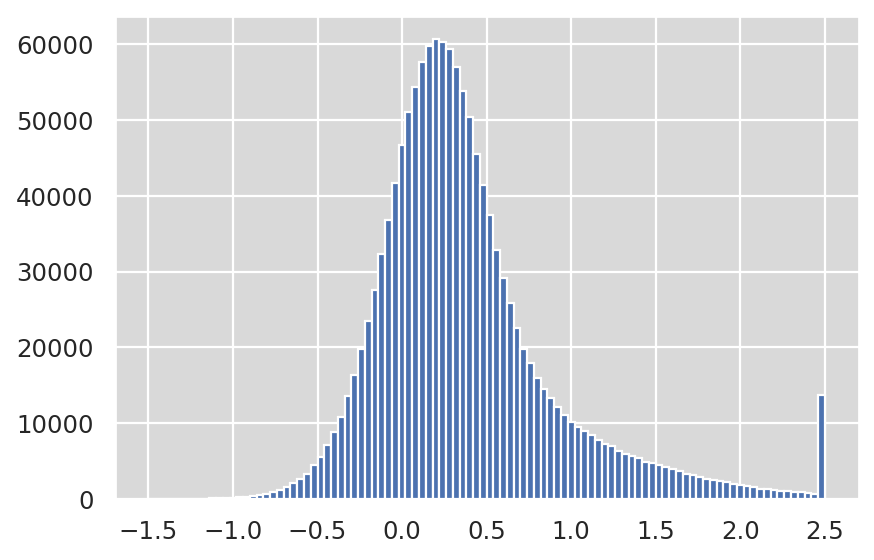

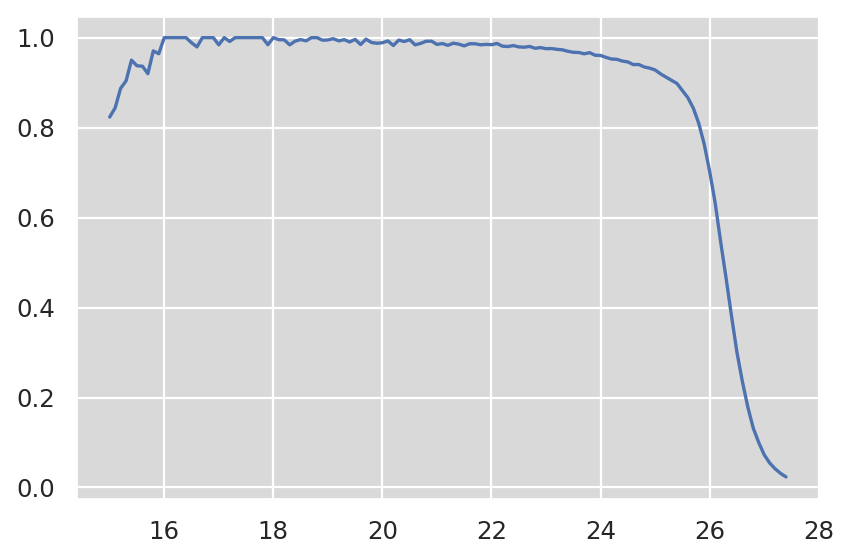

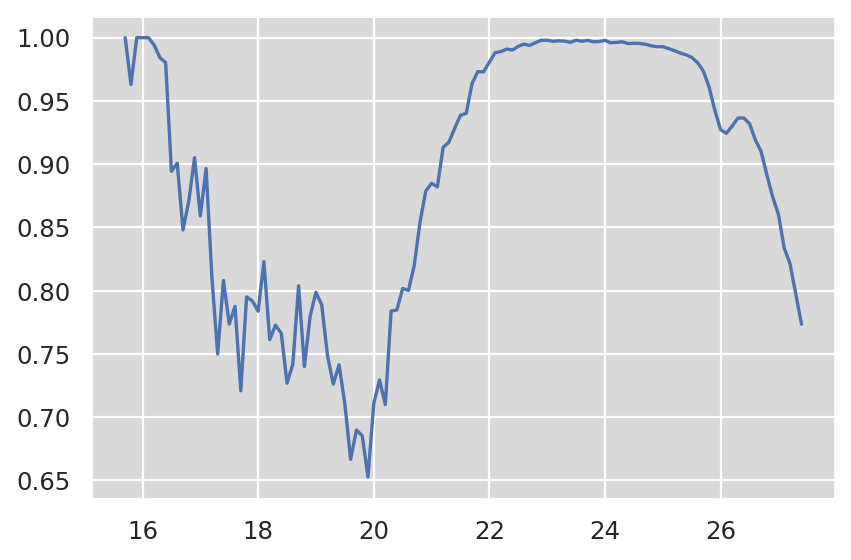

In [6]:
# Plot basics
import matplotlib.pyplot as plt
chisq = cat_ref_all['match_chisq']
n_match = cat_ref_all['match_n_chisq_finite']
mag_ref = -2.5*np.log10(cat_ref_all[f'flux_{band_ref}']) + mag_zeropoint

_ = plt.hist(np.clip(np.log10((chisq[chisq > 0]/n_match[chisq > 0])), -1.5, 2.5), bins=100)

mag_plot_min, mag_plot_max = 15, mag_tot_max + 0.5
n_bins = int(np.round(10*(mag_plot_max - mag_plot_min)))
bins = np.linspace(mag_plot_min, mag_plot_max, num=n_bins + 1)
n_obj = np.zeros(n_bins, dtype=int)
n_matched = np.zeros(n_bins, dtype=int)

for idx in range(n_bins):
    within = (mag_ref > bins[idx]) & (mag_ref < bins[idx+1])
    n_obj[idx] = np.sum(within)
    n_matched[idx] = np.sum(chisq[within] > 0)

plt.figure()
plt.plot(bins[:-1], n_matched/n_obj)

del chisq, n_match, mag_ref

mag_psf_ref = -2.5*np.log10(cat_target_all[f'{band_ref}_psfFlux'].values) + mag_zeropoint
matched = np.zeros(len(cat_target_all), dtype=bool)
matched[cat_ref_all['match_row'].values[cat_ref_all['match_row'] >= 0]] = True
is_primary = cat_target_all['detect_isPrimary'] & ~cat_target_all['merge_peak_sky']

for idx in range(n_bins):
    within = (mag_psf_ref > bins[idx]) & (mag_psf_ref < bins[idx+1]) & is_primary
    n_obj[idx] = np.sum(within)
    n_matched[idx] = np.sum(matched[within])

del matched, within, mag_psf_ref, is_primary
    
plt.figure()
plt.plot(bins[:-1], n_matched/n_obj)


In [7]:
# Check memory usage

# These are the usual ipython objects, including this one you are creating
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
memusg = list(sorted(
    [
        (x, sys.getsizeof(globals().get(x))) for x in dir()
        if not x.startswith('_') and x not in sys.modules and x not in ipython_vars
    ],
    key=lambda x: x[1], reverse=True
))
print(memusg)

[('cat_ref_all', 1379361873), ('cat_target_all', 681743466), ('n_matched', 1104), ('n_obj', 1104), ('columns_all_target', 344), ('columns_all_ref', 184), ('get_xy', 144), ('plot_matches', 144), ('columns_data_ref', 120), ('columns_data_target', 120), ('columns_errors_target', 120), ('columns_fluxes_ref', 120), ('columns_fluxes_target', 120), ('bins', 104), ('bands', 88), ('columns_match_ref', 72), ('dafButler', 72), ('geom', 72), ('mpl', 72), ('mrMeas', 72), ('np', 72), ('pd', 72), ('plt', 72), ('sns', 72), ('column', 69), ('cats_in', 64), ('cats_out', 64), ('weekly', 58), ('ticket', 57), ('match_dist_max', 56), ('tracts', 56), ('model_target', 55), ('name_bands', 55), ('name_skymap', 52), ('band_ref', 50), ('butler', 48), ('select_target', 48), ('skymap', 48), ('idx', 28), ('mag_plot_min', 28), ('match_max', 28), ('n_bins', 28), ('n_finite_min', 28), ('n_matched_uniq', 28), ('n_target', 28), ('plot', 28), ('tract', 28), ('use_fluxes', 28), ('mag_plot_max', 24), ('mag_tot_max', 24), ('

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


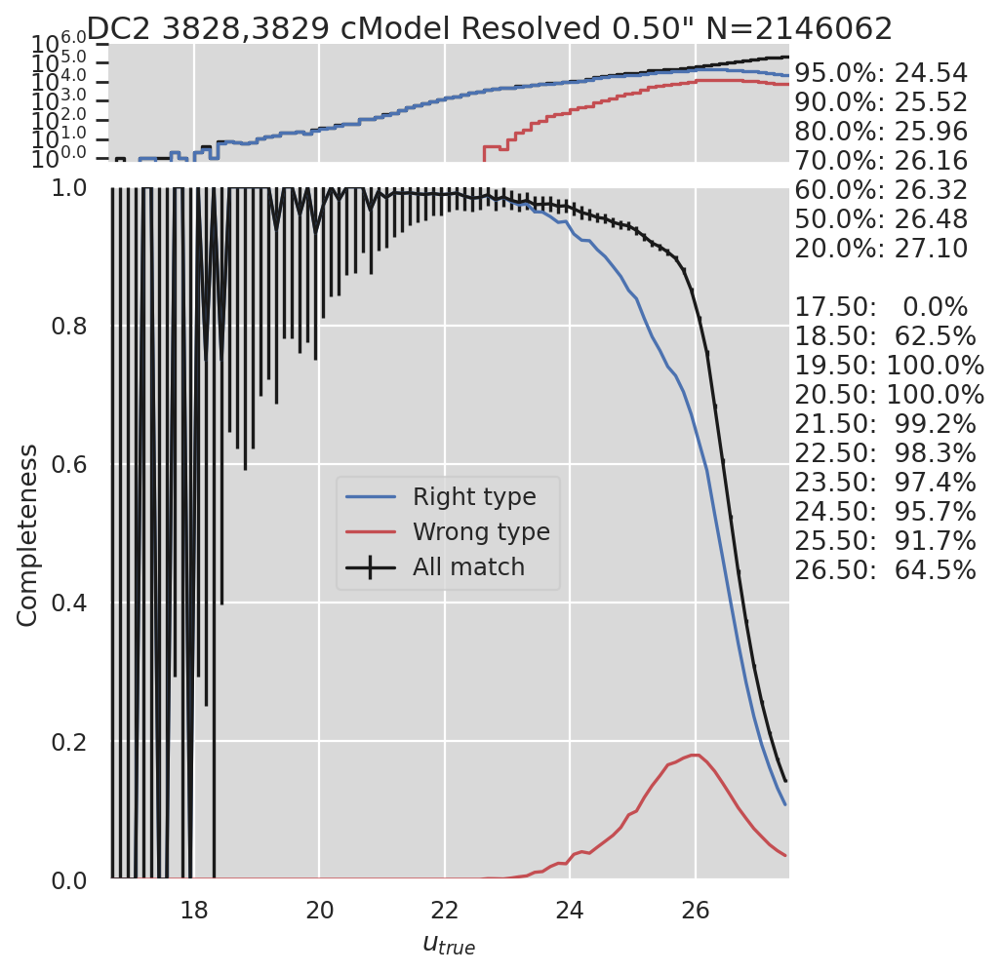

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


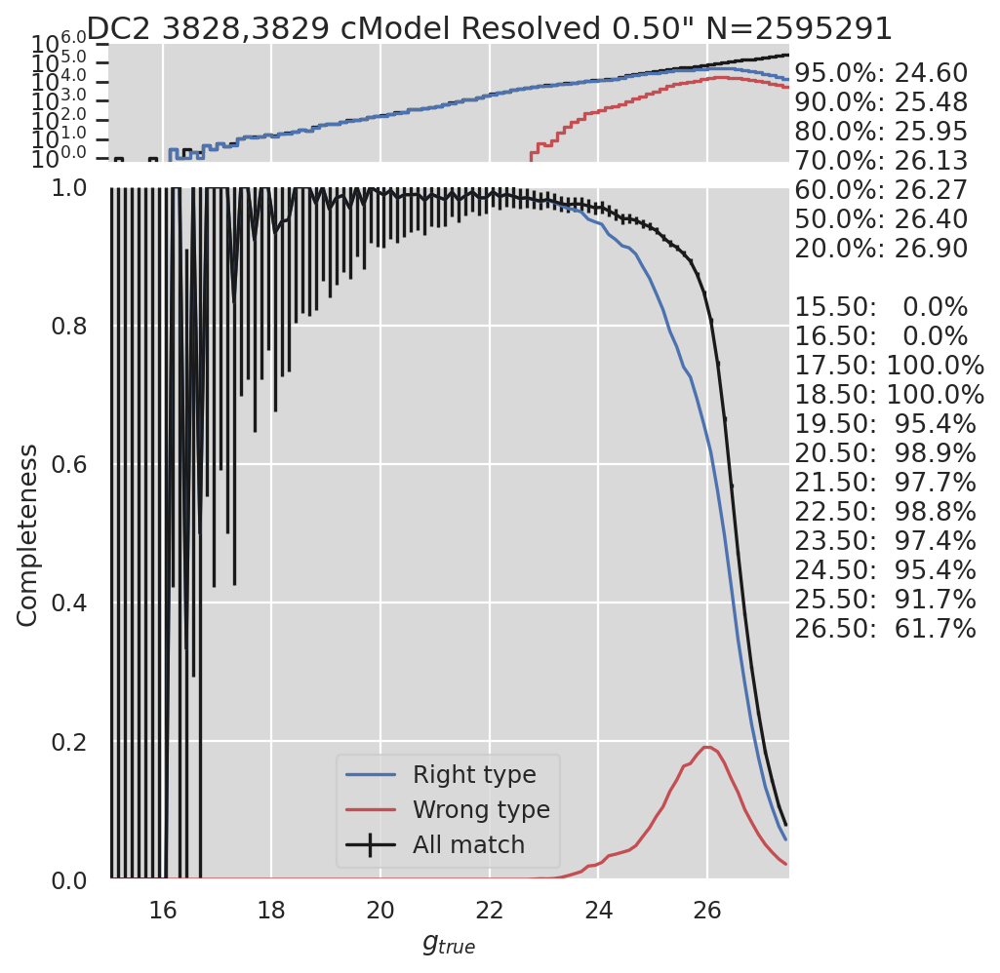

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


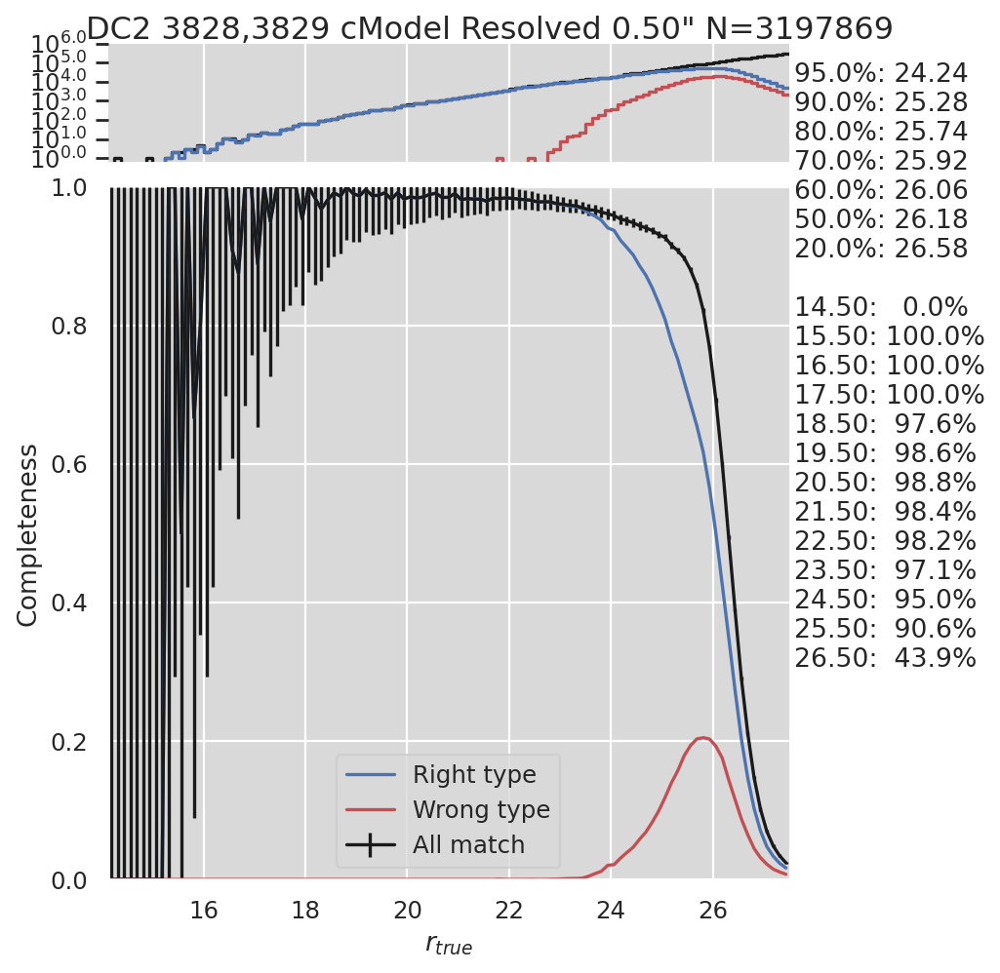

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


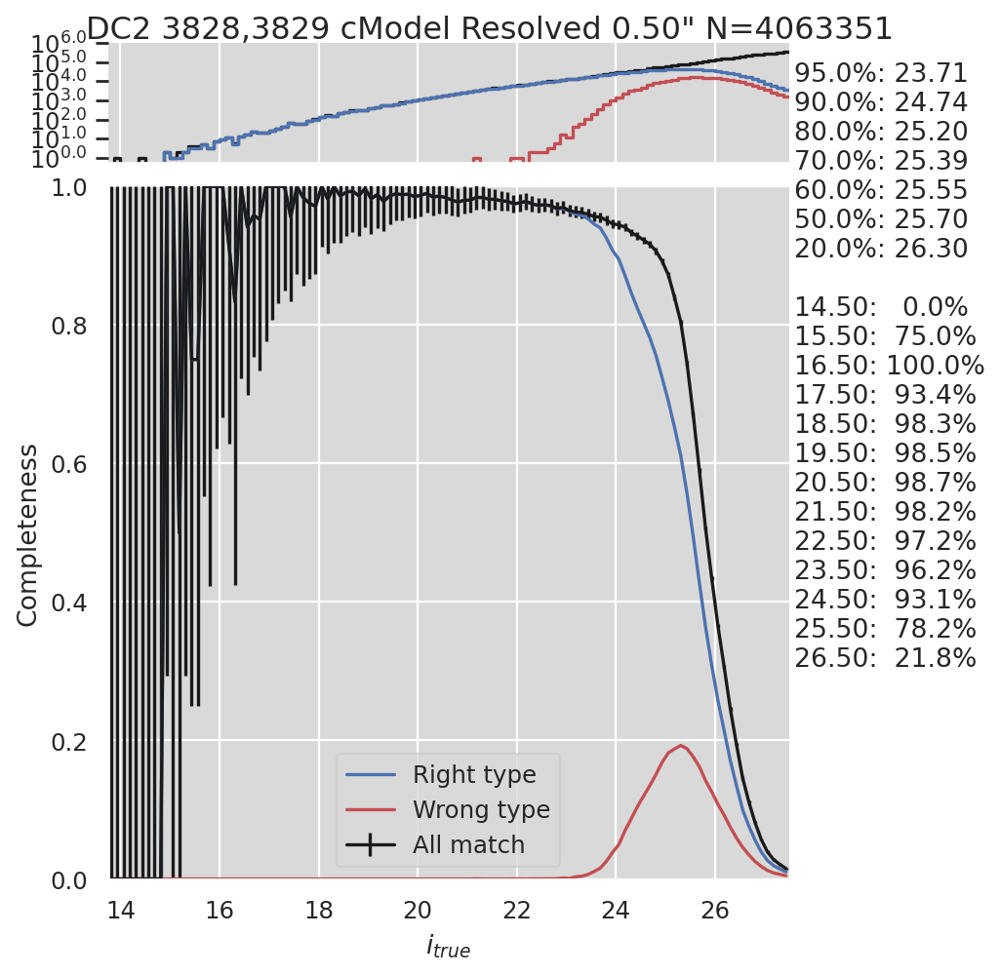

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


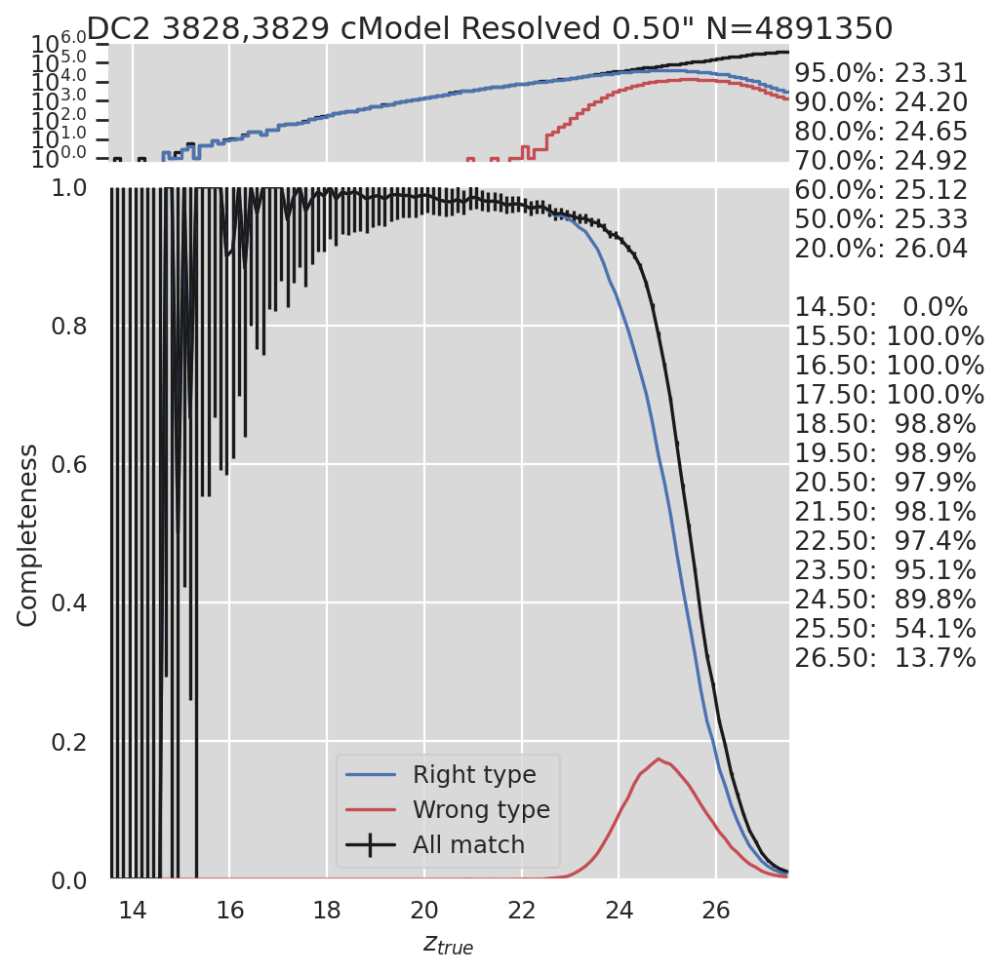

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


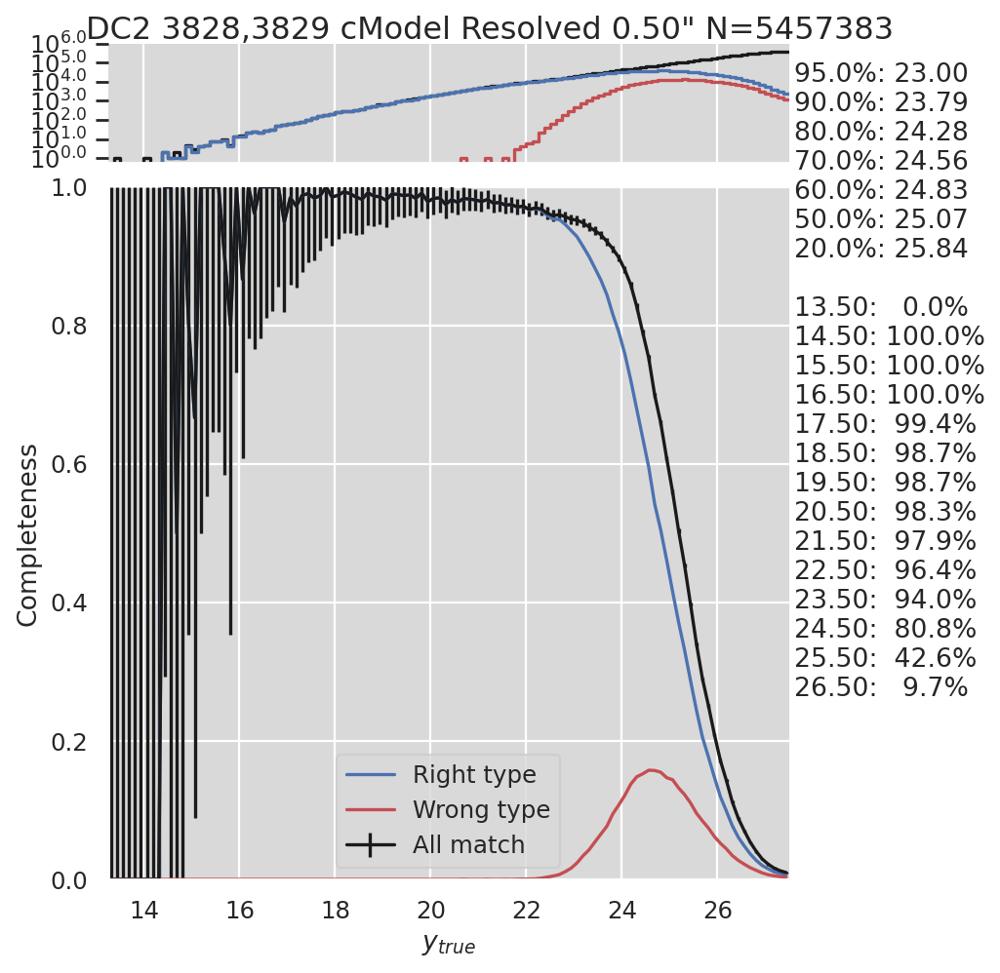

Measuring purity for 1475610/2913433 sources


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


1088435 matched and 845086 mag < 27.5; 817099 both and 166705 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


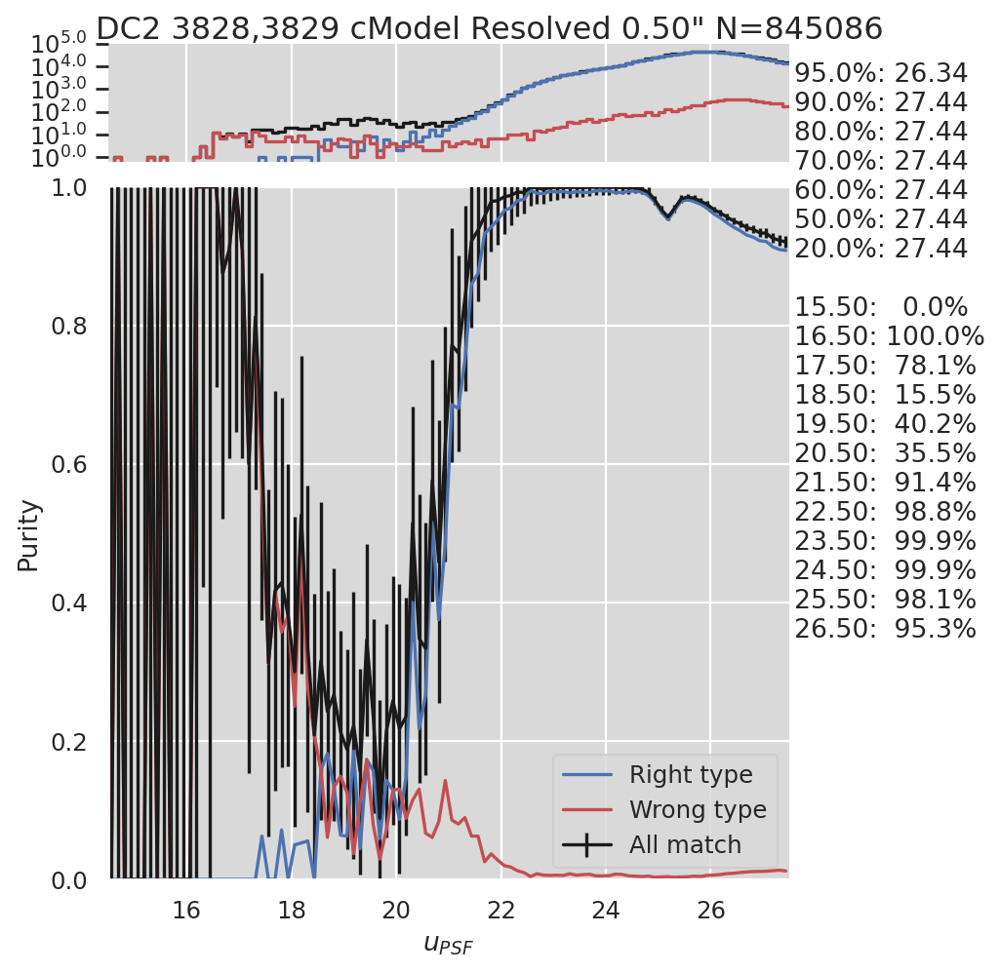

1088435 matched and 1042734 mag < 27.5; 1009876 both and 19342 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


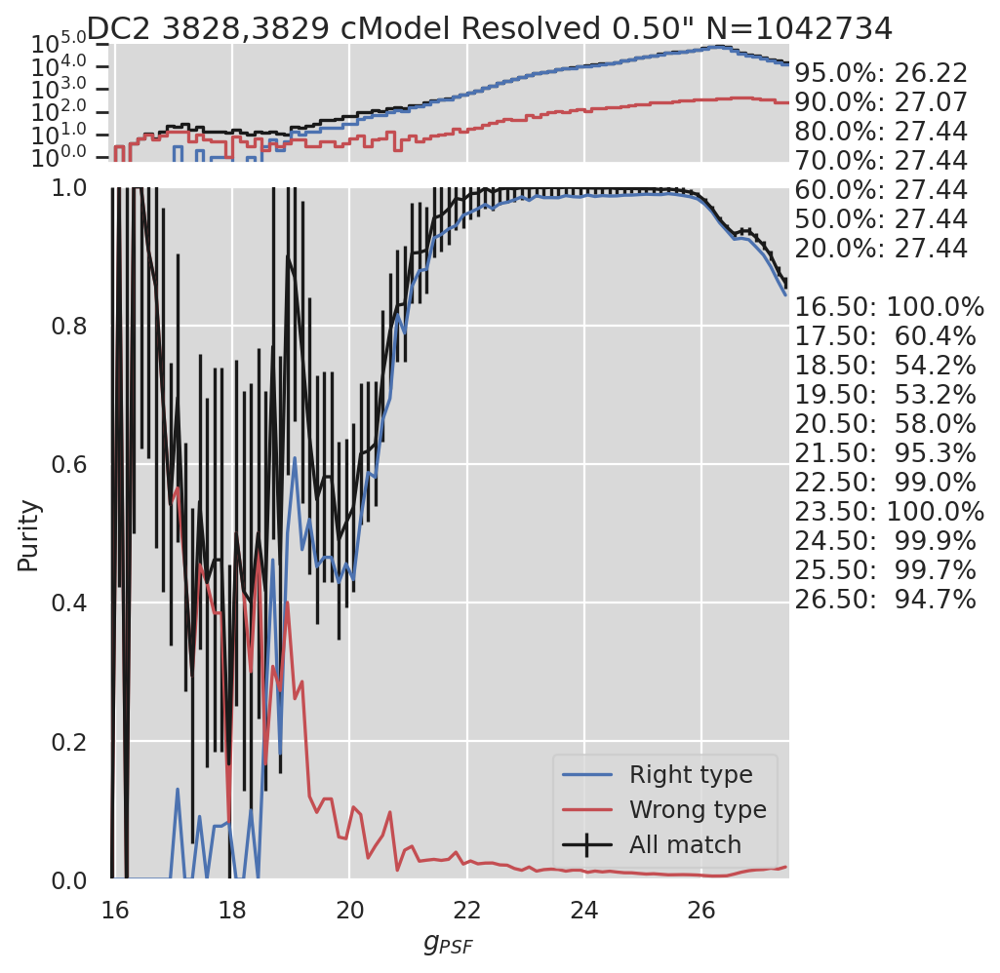

1088435 matched and 1098702 mag < 27.5; 1055321 both and 12563 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


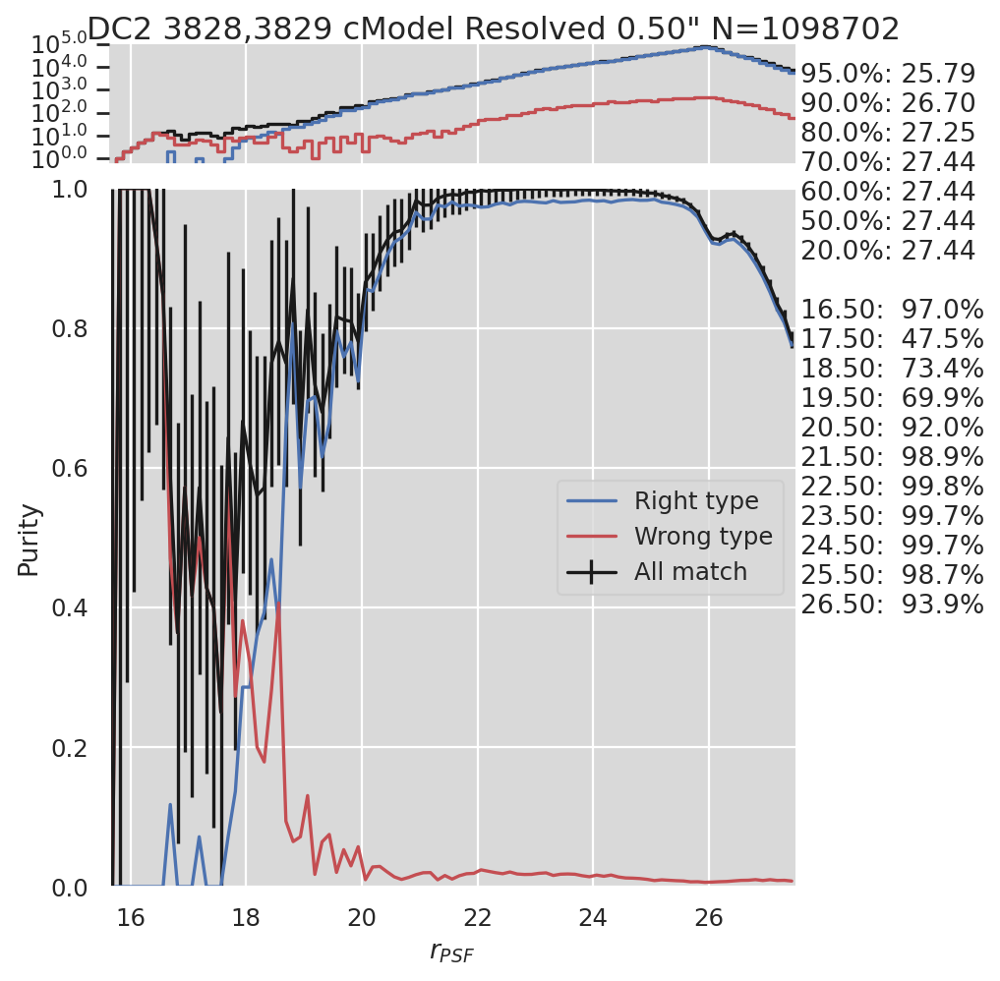

1088435 matched and 1098578 mag < 27.5; 1050808 both and 18899 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


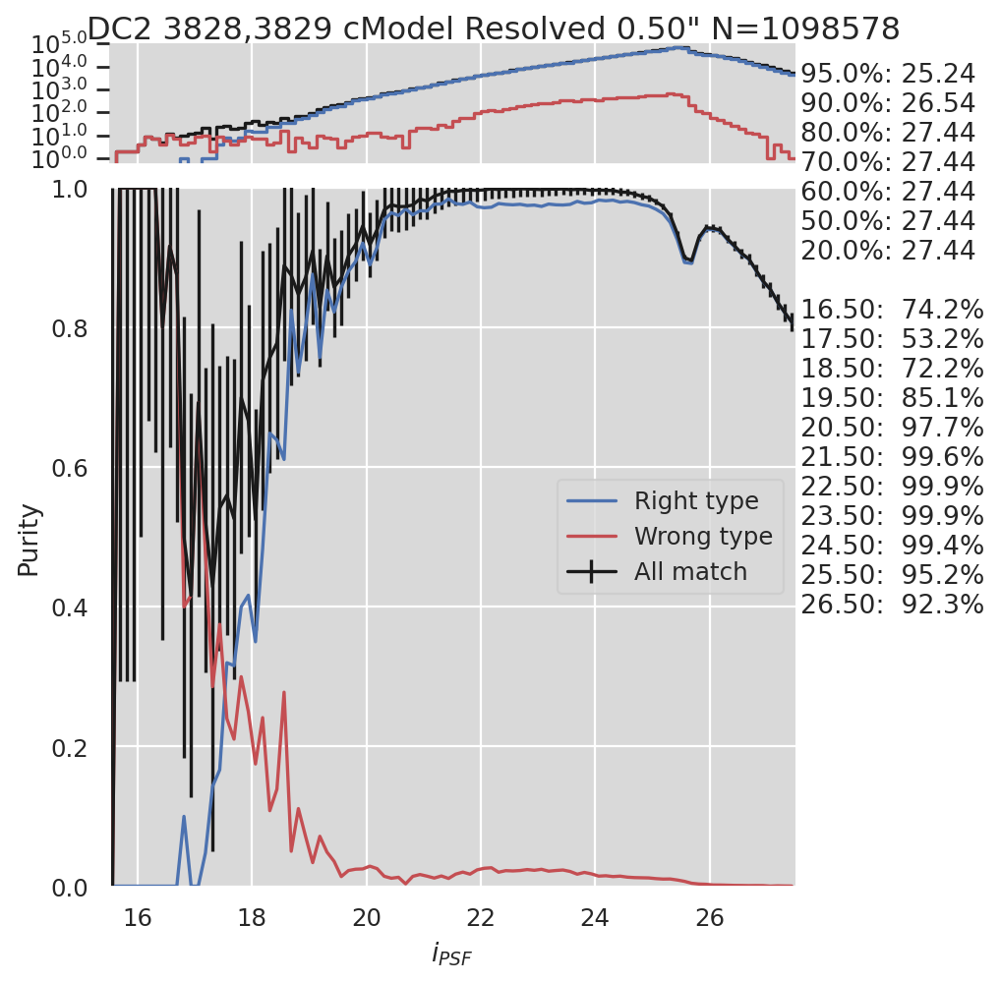

1088435 matched and 1015816 mag < 27.5; 970179 both and 94561 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


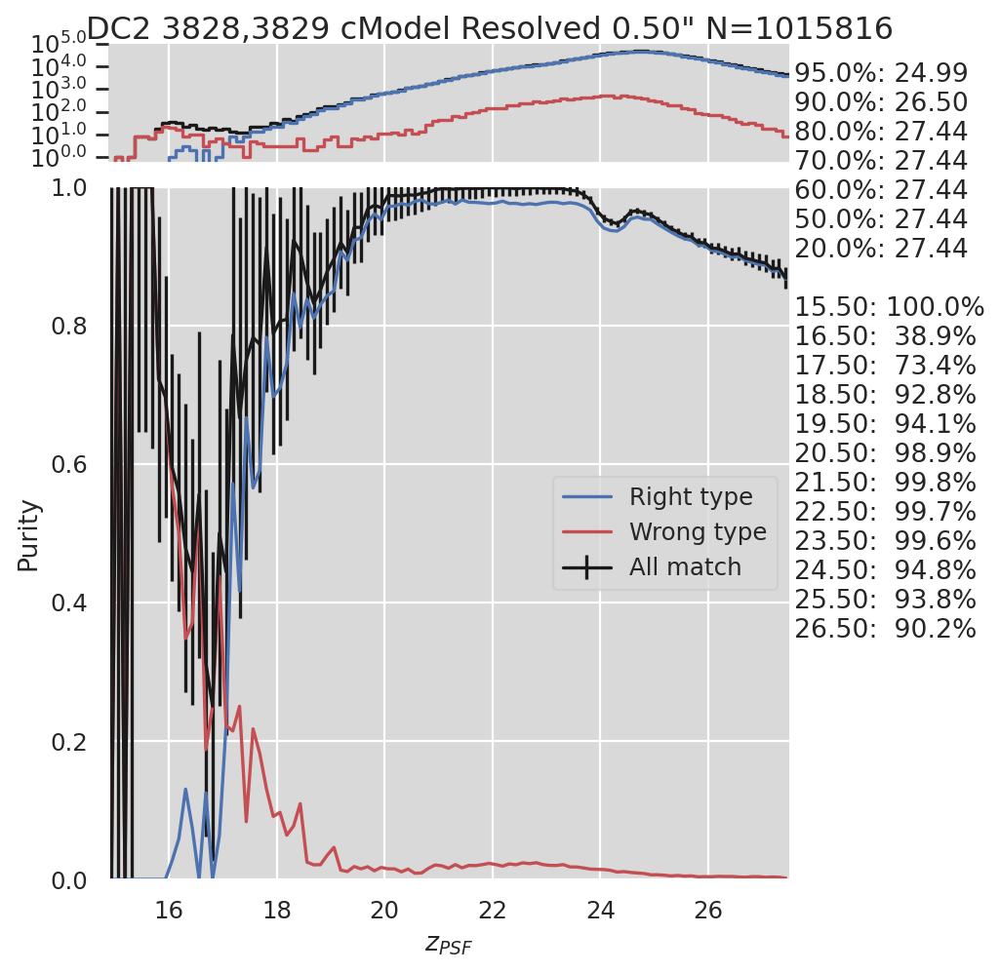

1088435 matched and 1003967 mag < 27.5; 957809 both and 115114 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


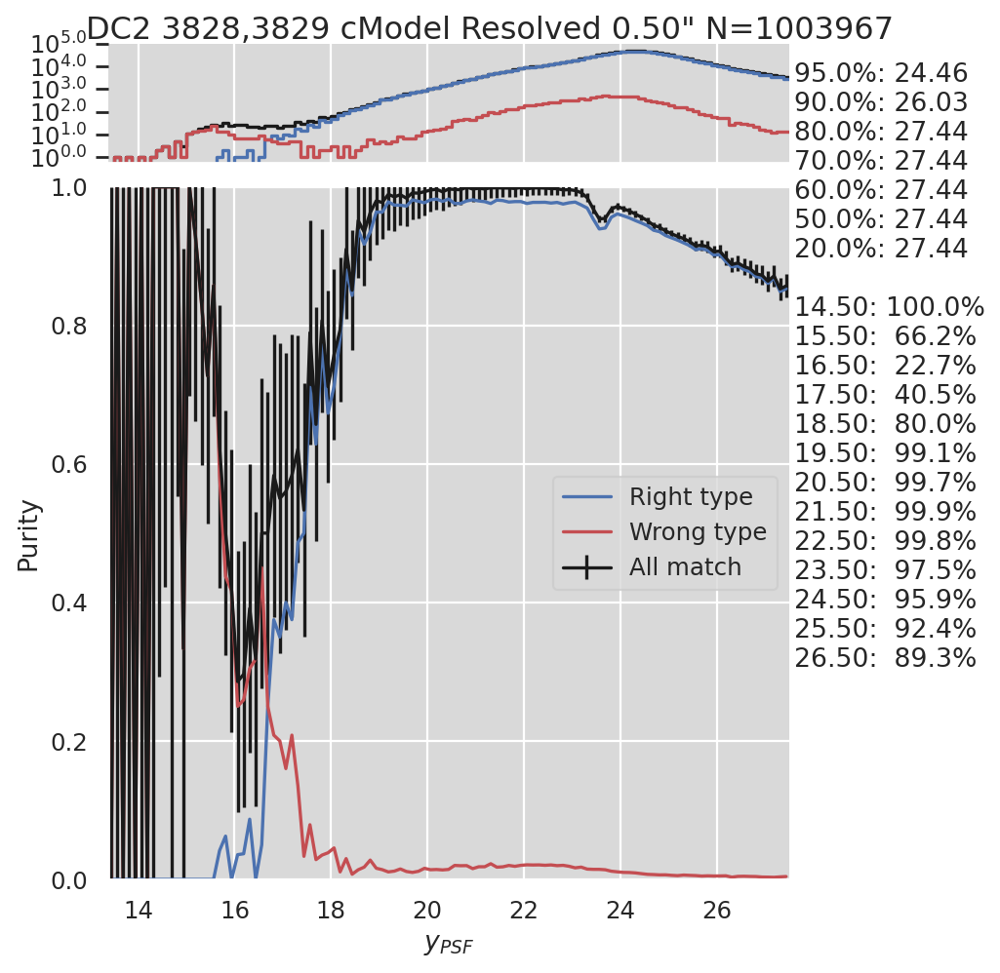

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


1088435 matched and 874634 mag < 27.5; 842199 both and 162186 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


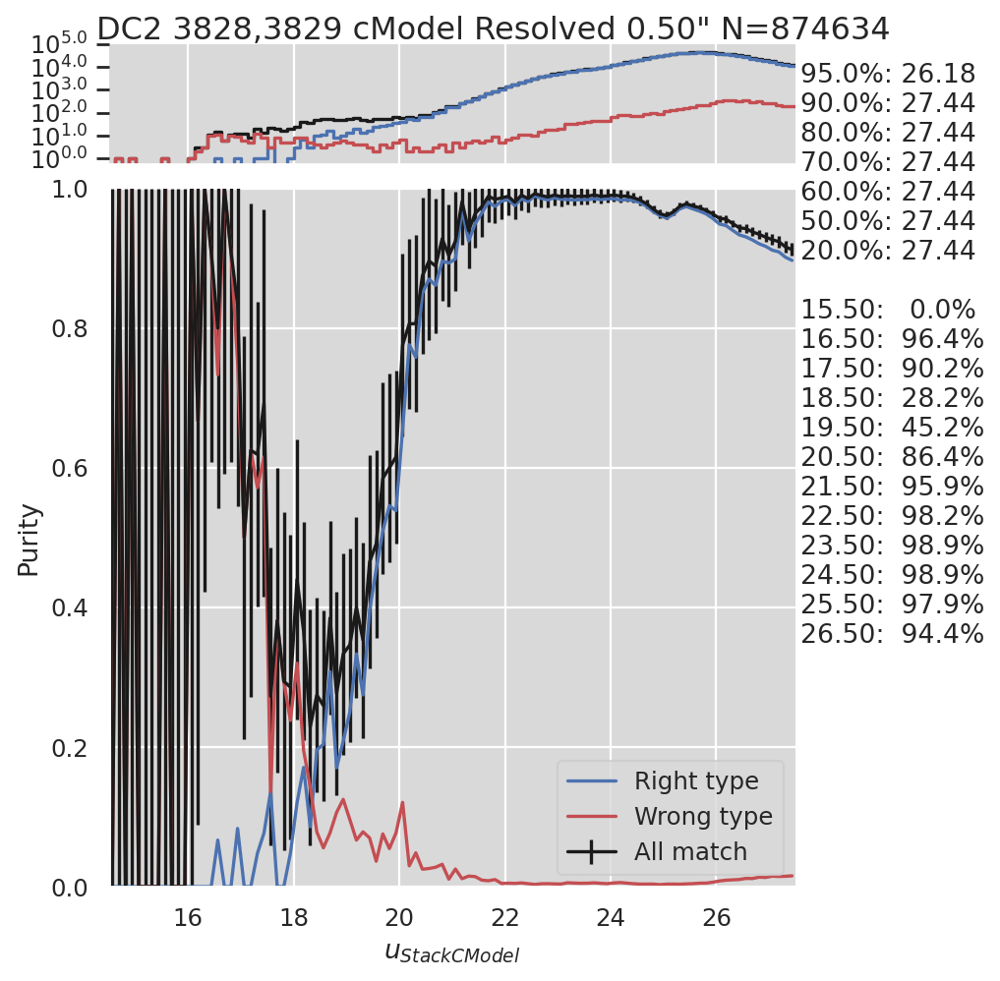

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


1088435 matched and 1070191 mag < 27.5; 1030558 both and 21370 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


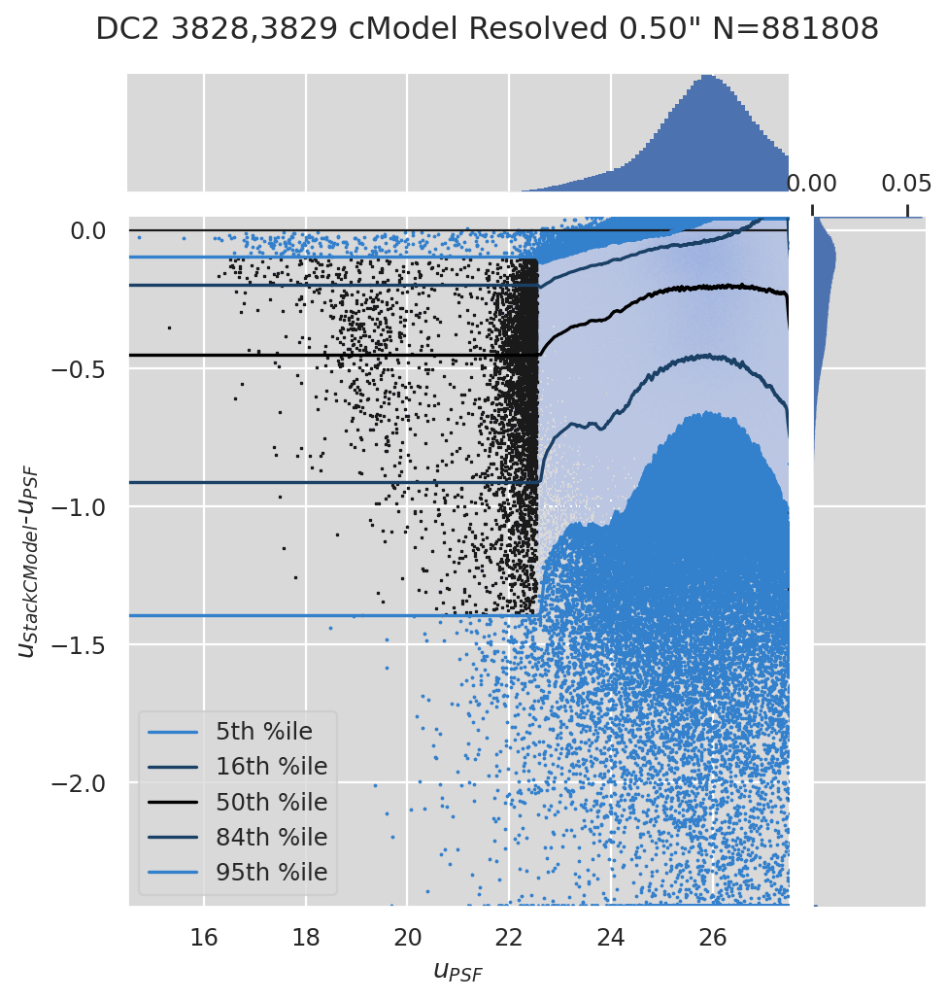

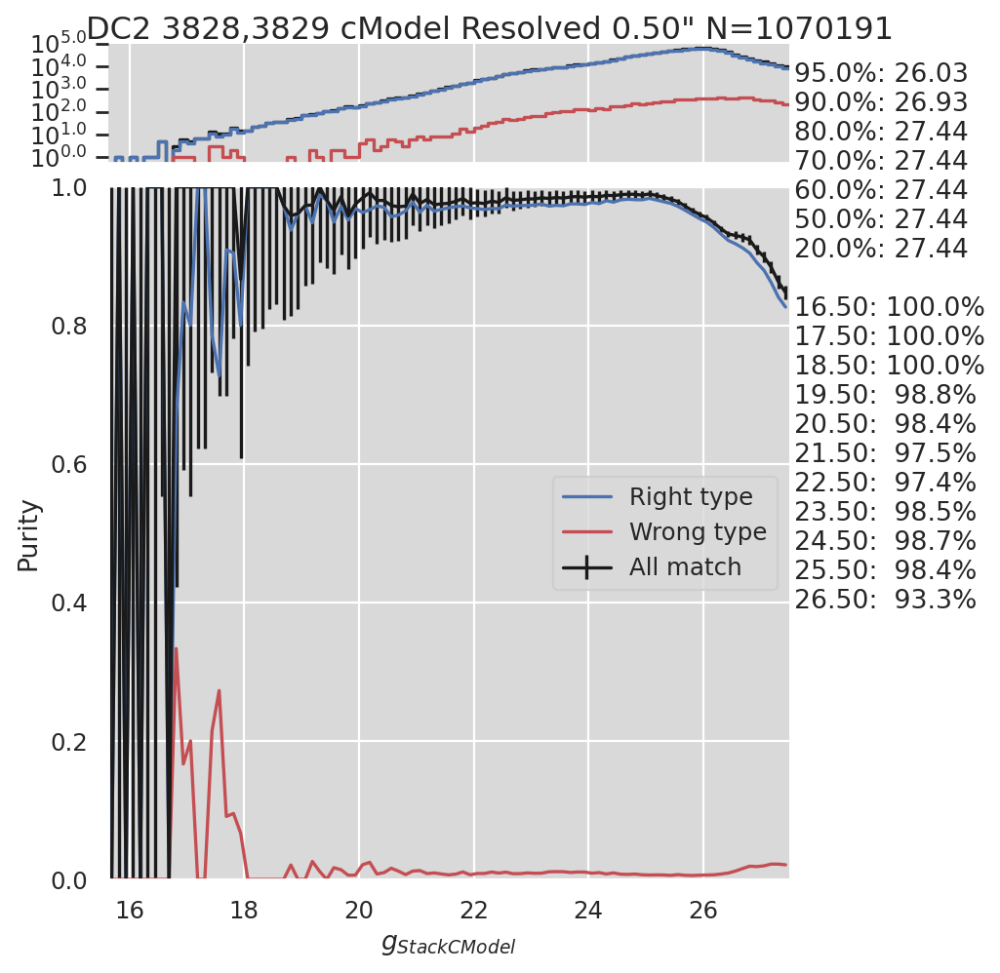

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


1088435 matched and 1109124 mag < 27.5; 1062475 both and 14370 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of da

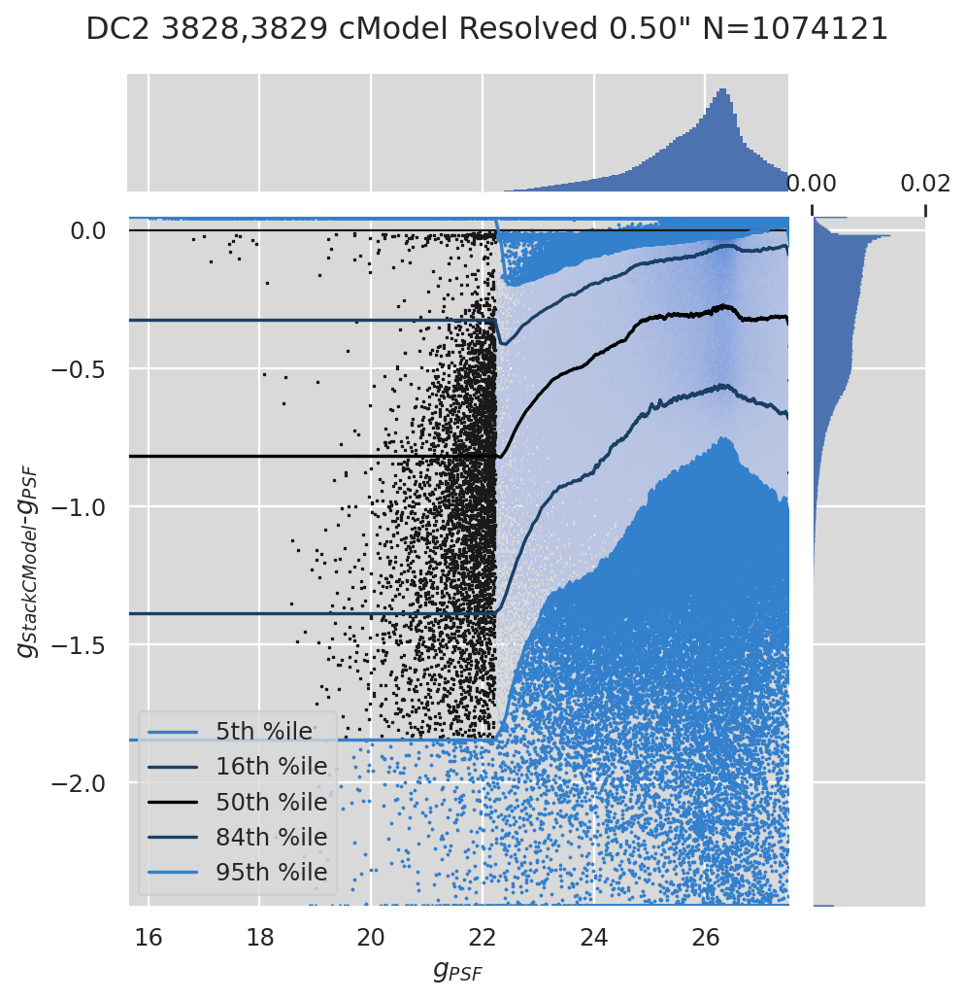

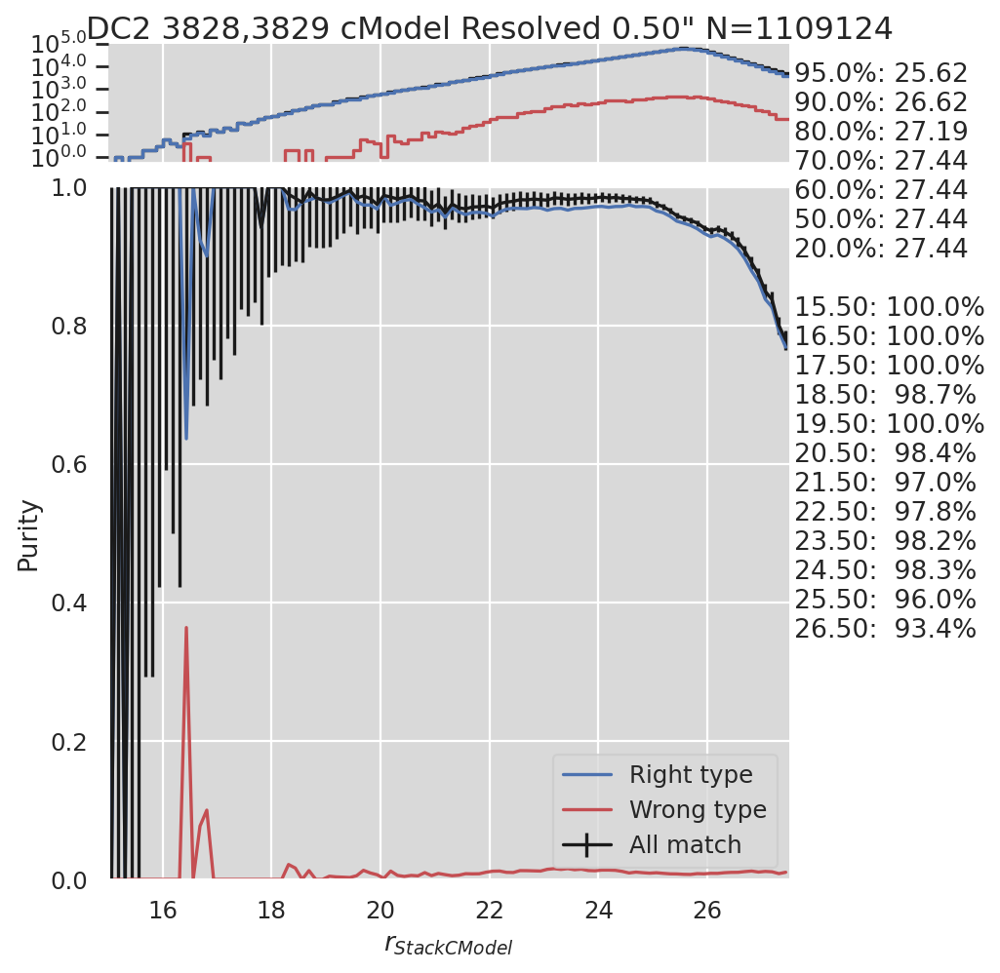

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


1088435 matched and 1107460 mag < 27.5; 1057444 both and 19555 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of da

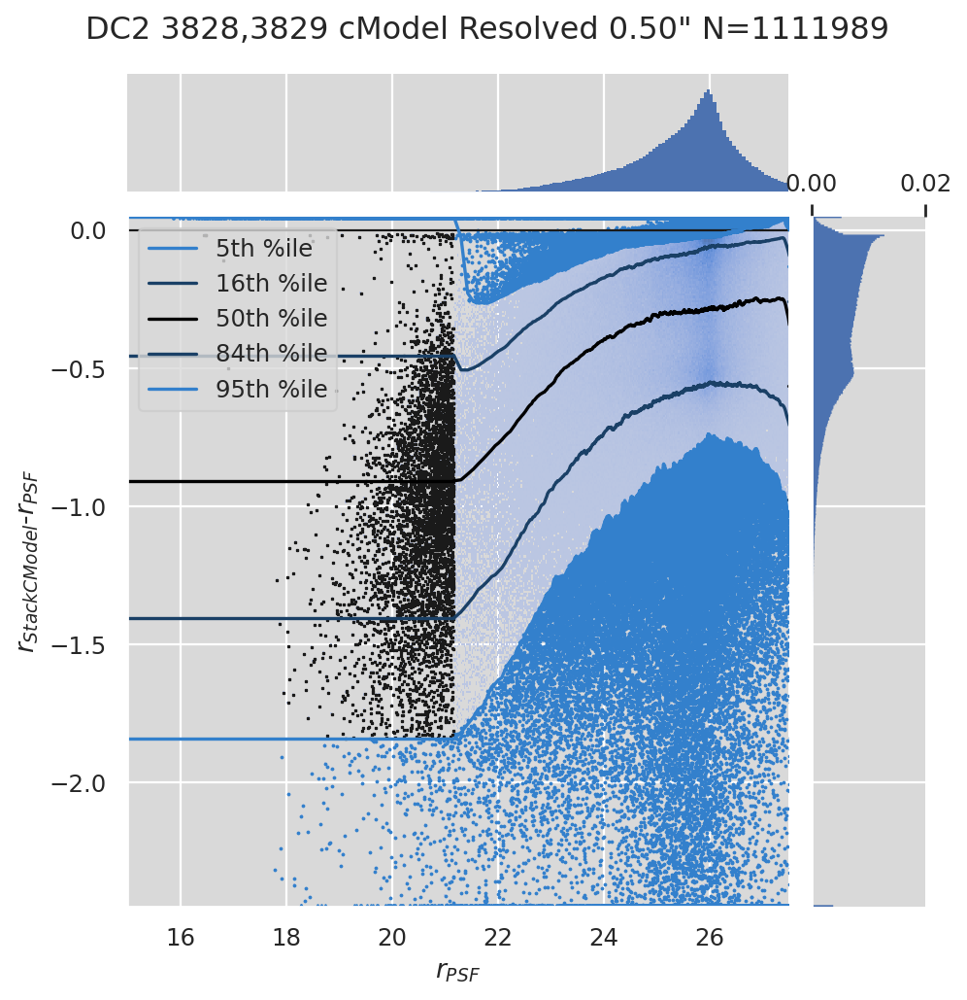

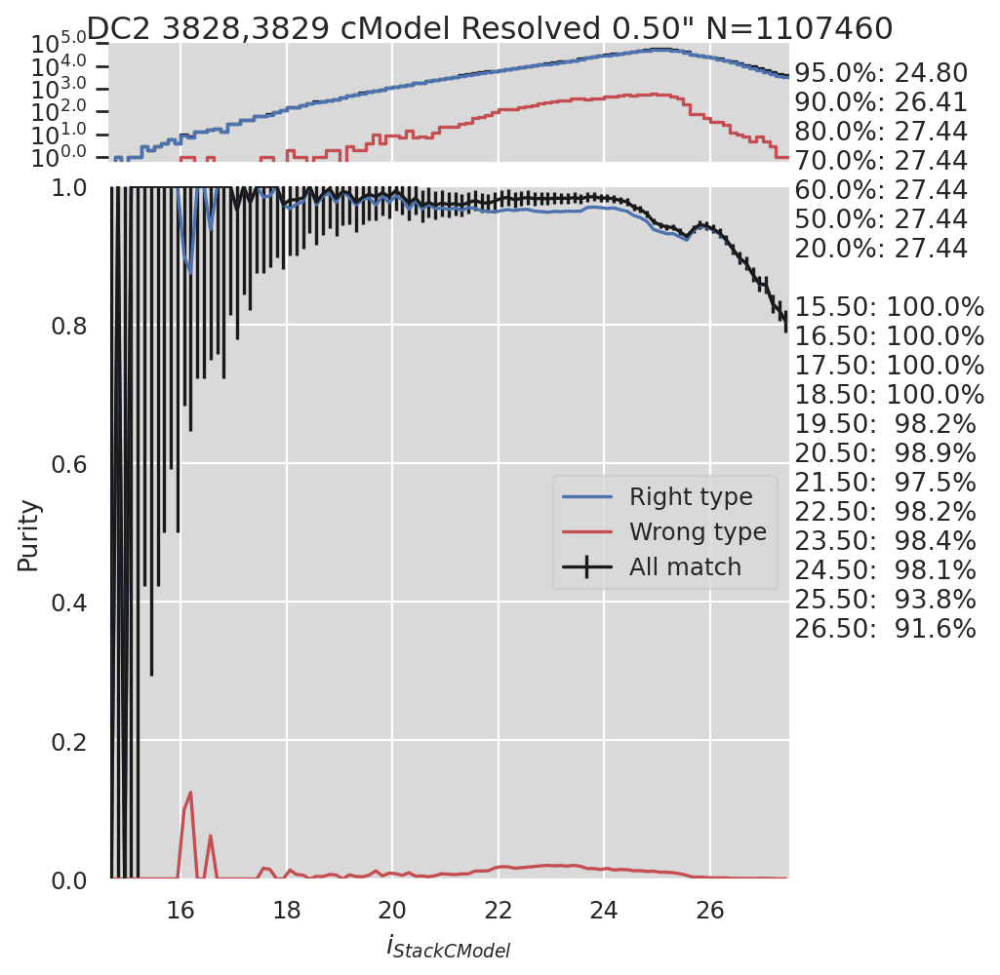

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


1088435 matched and 1026822 mag < 27.5; 978699 both and 93296 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of da

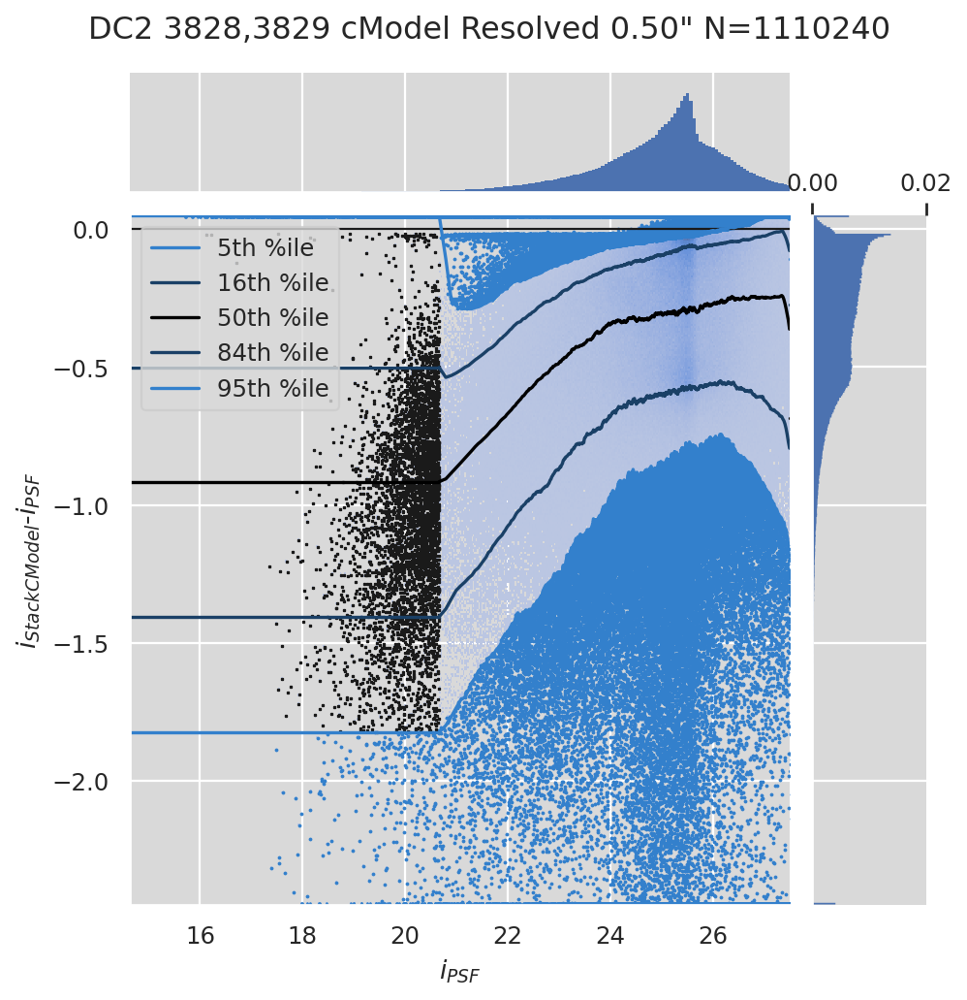

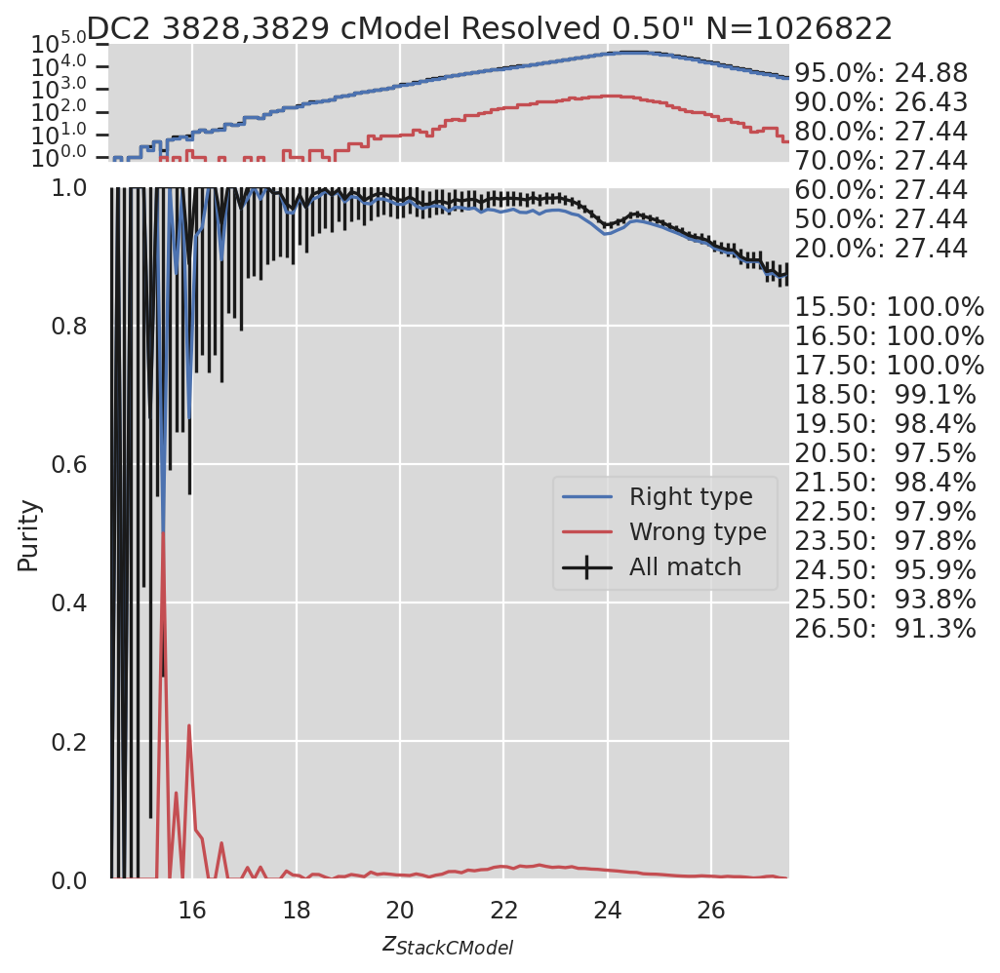

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


1088435 matched and 1009518 mag < 27.5; 961882 both and 115061 non-finite; 1155227/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of da

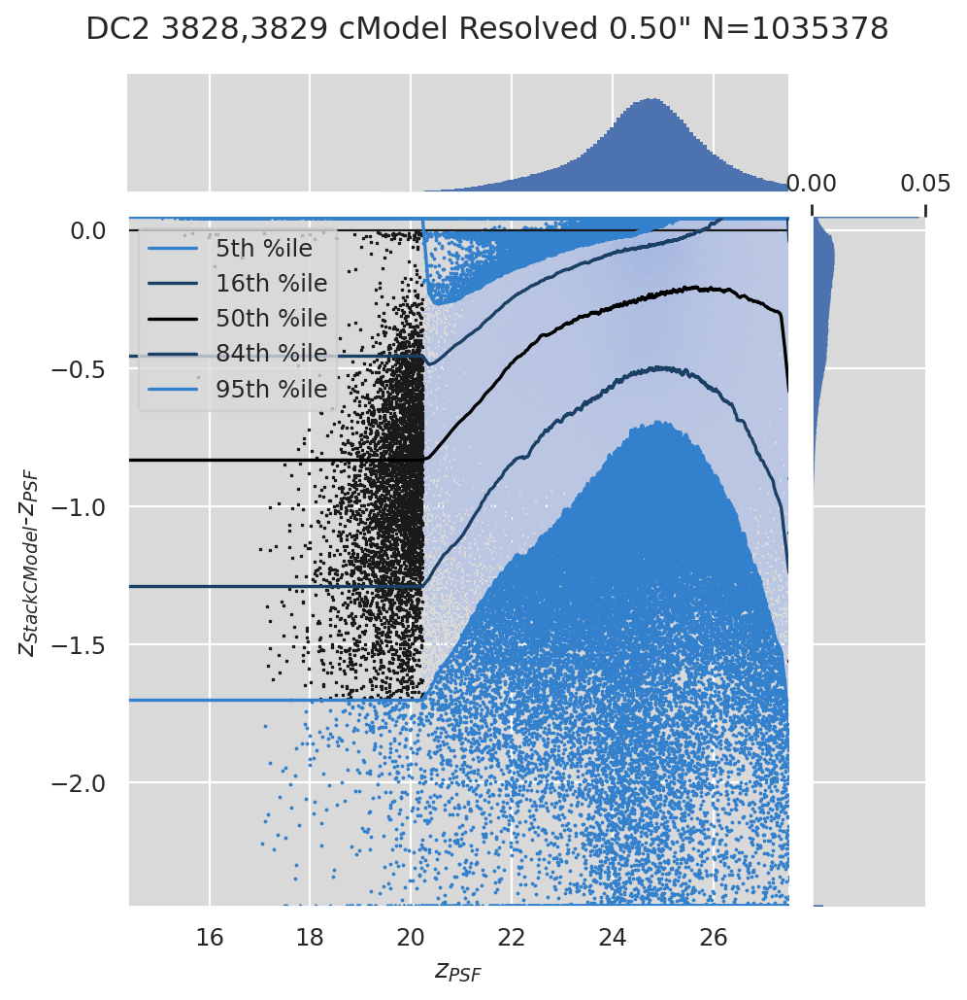

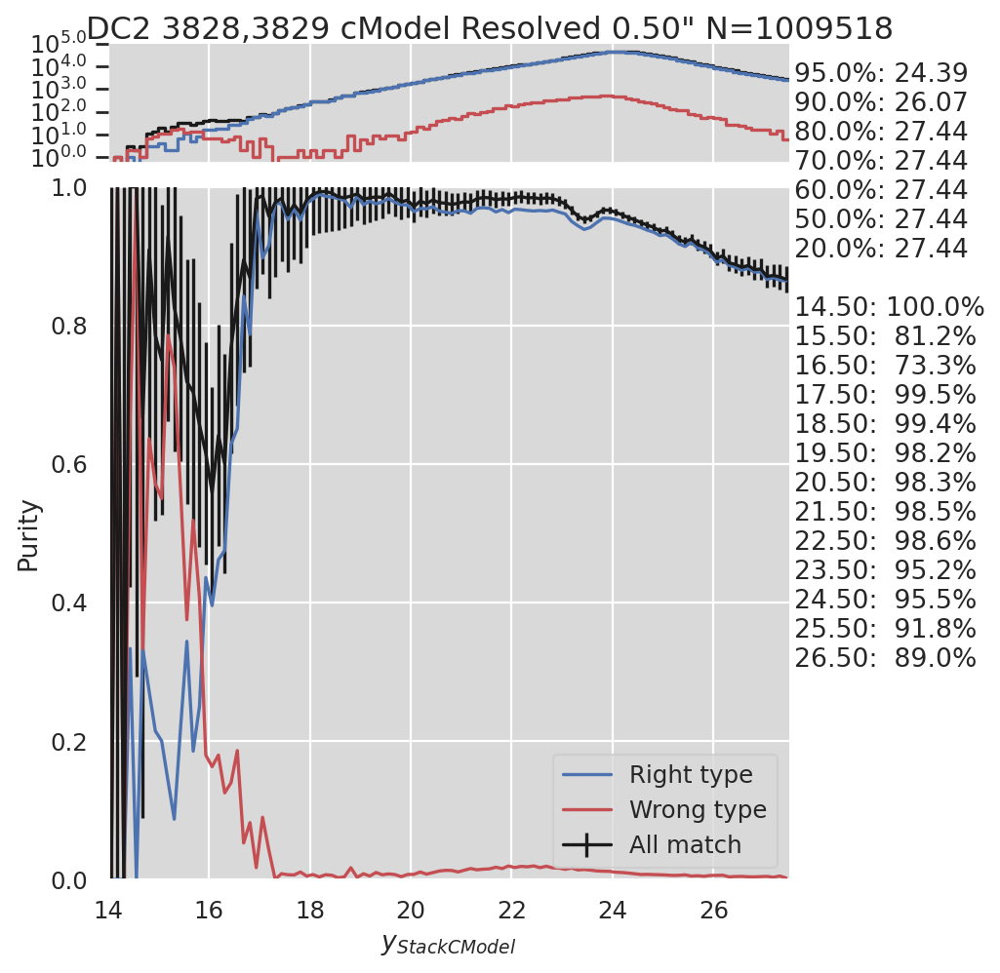

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Resolved u, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


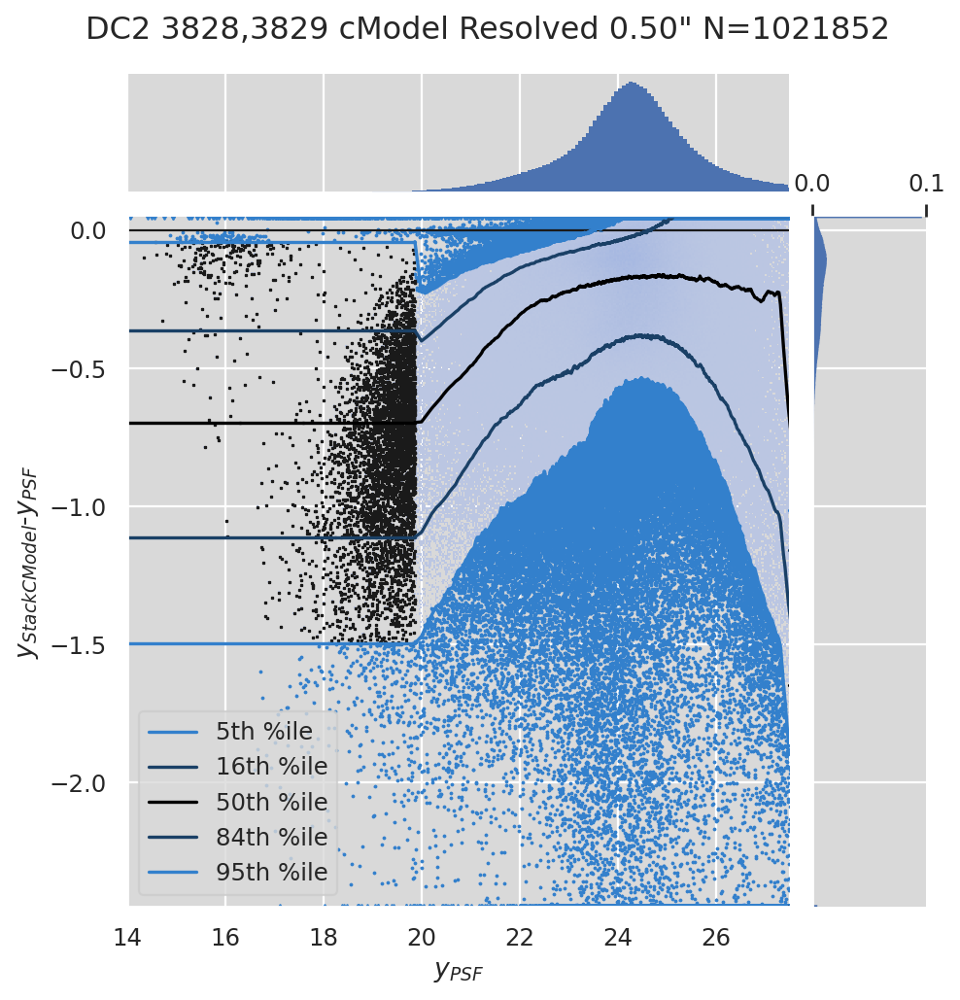

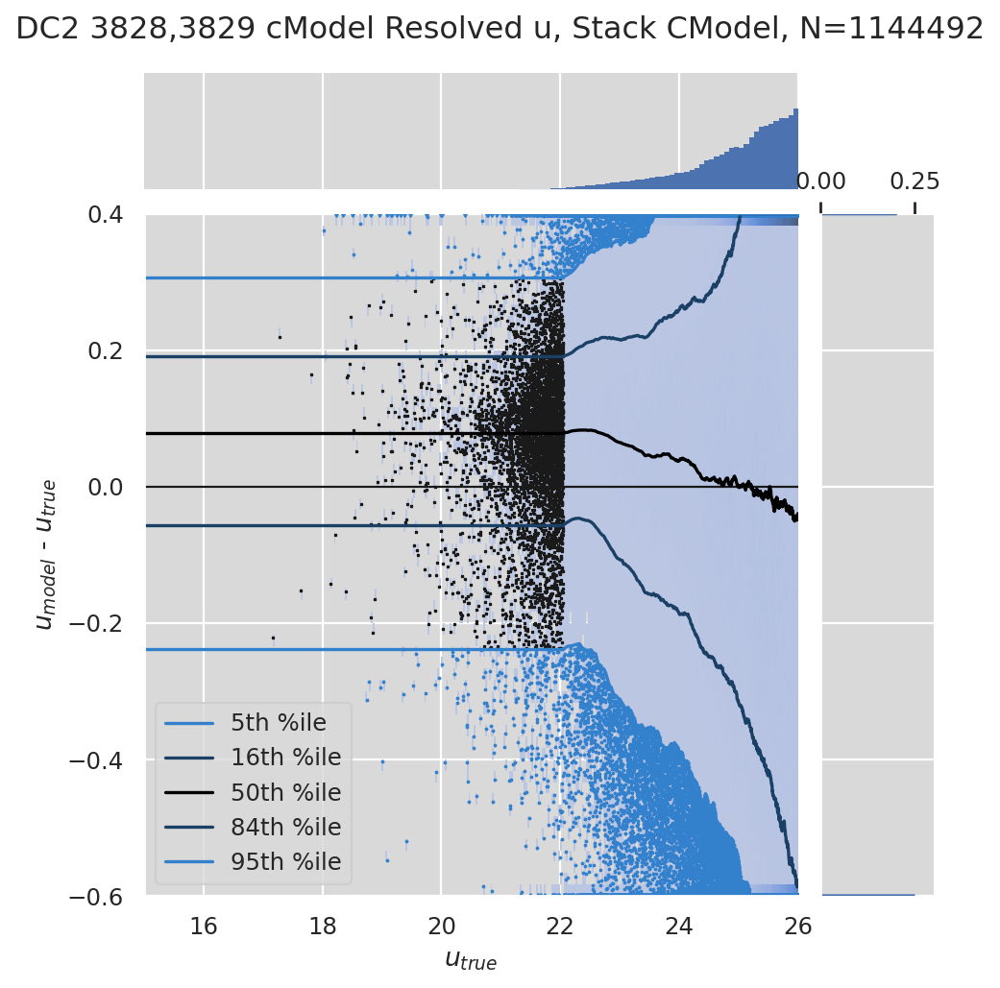

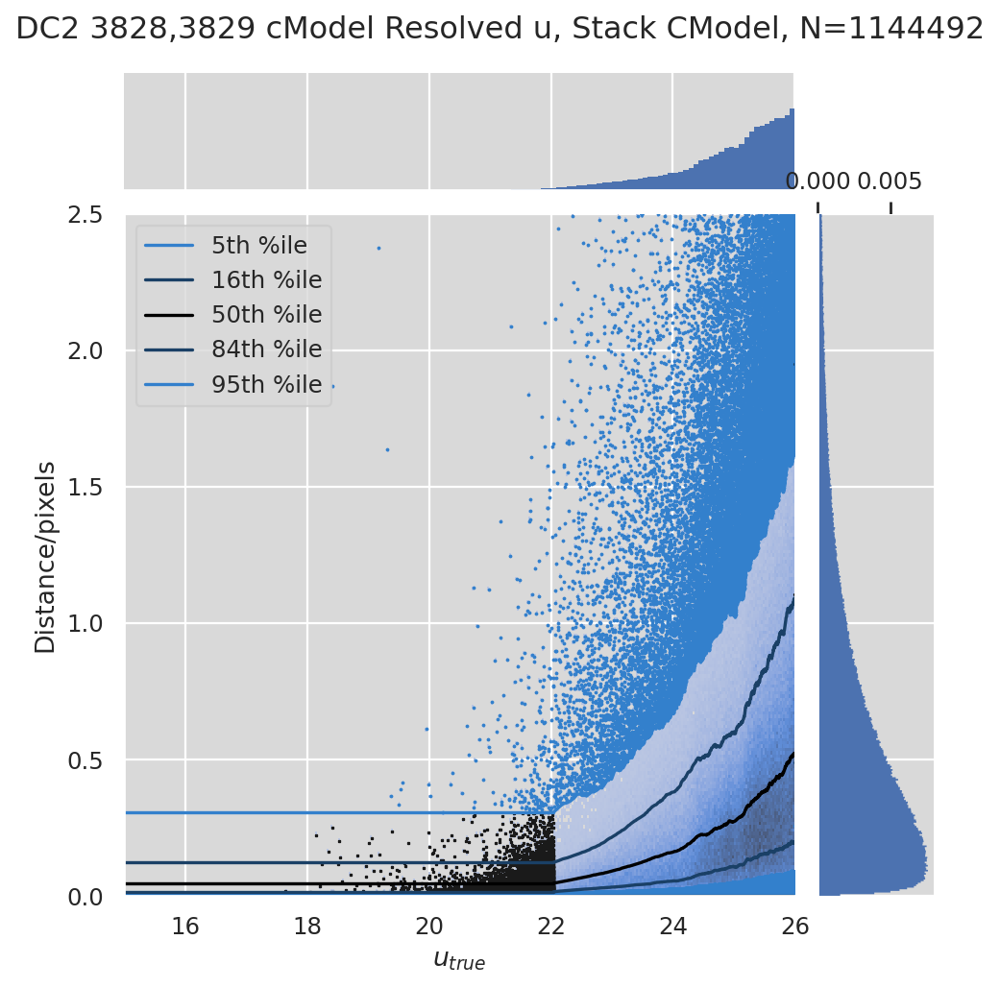

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Resolved u, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


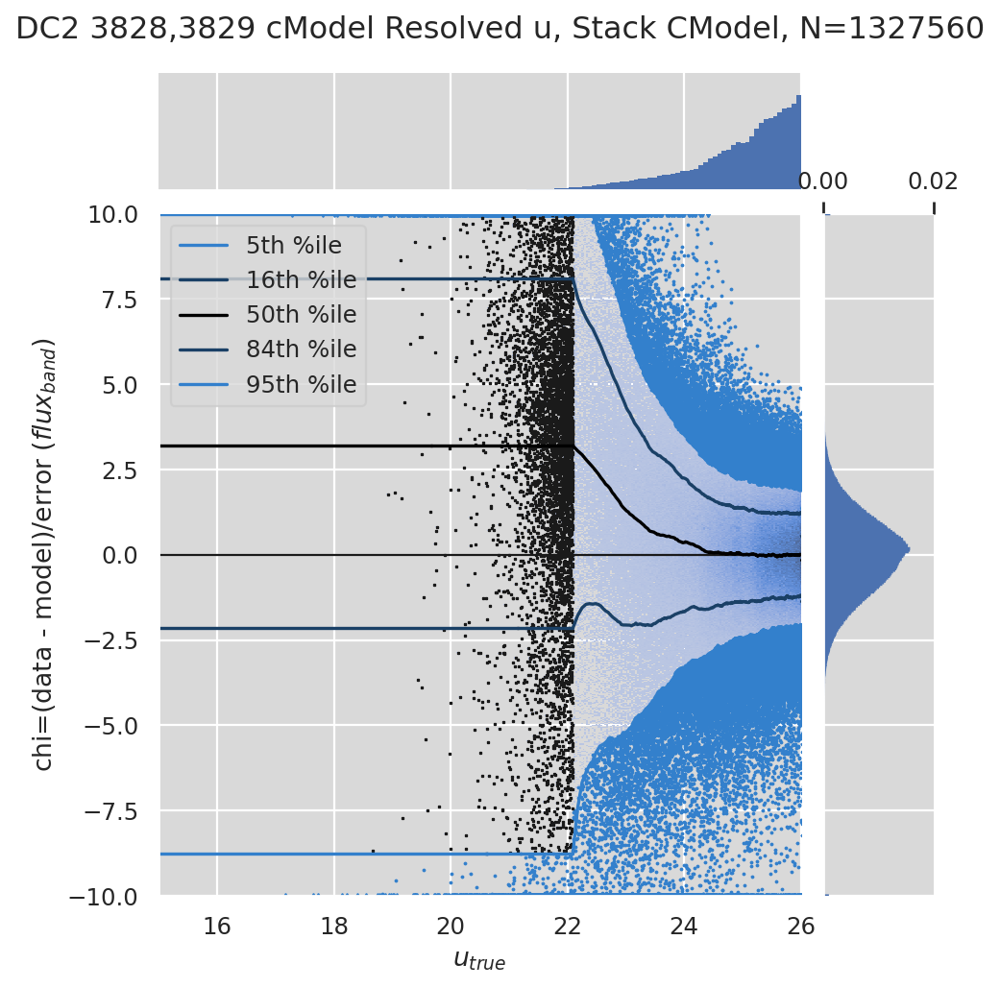

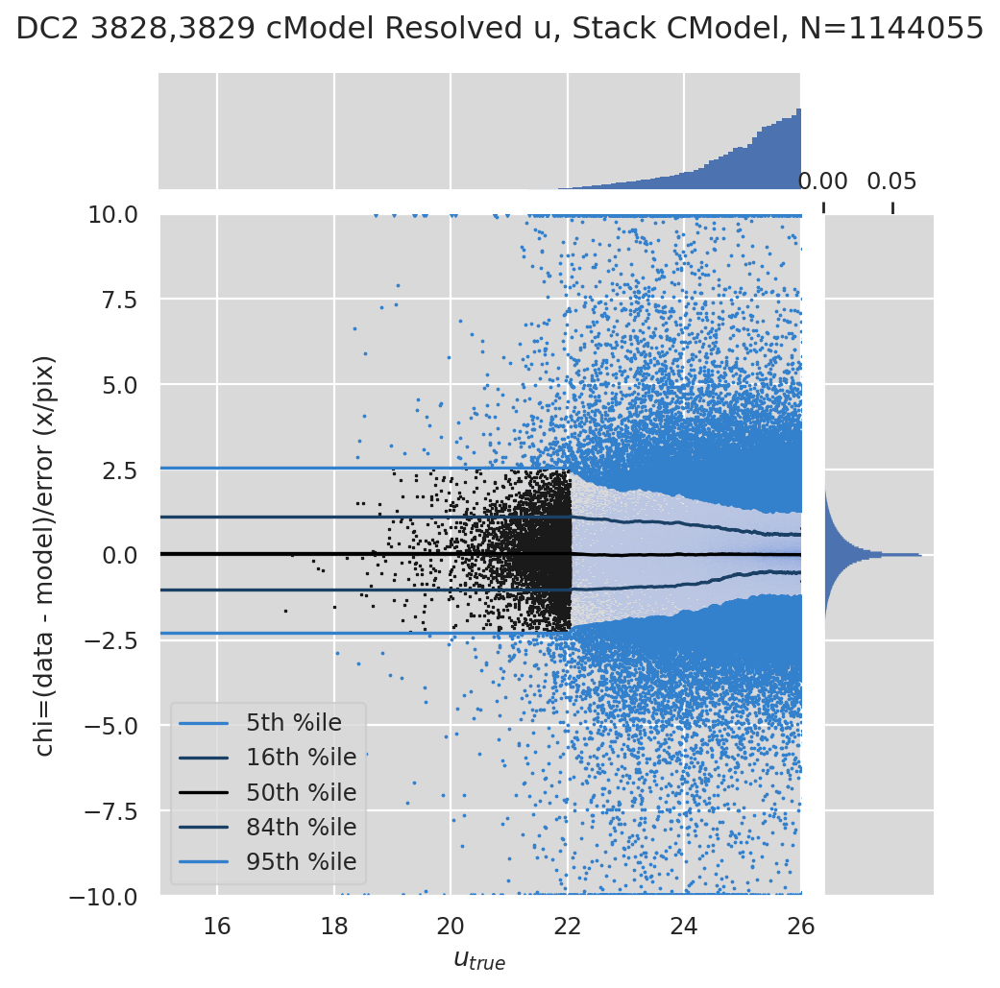

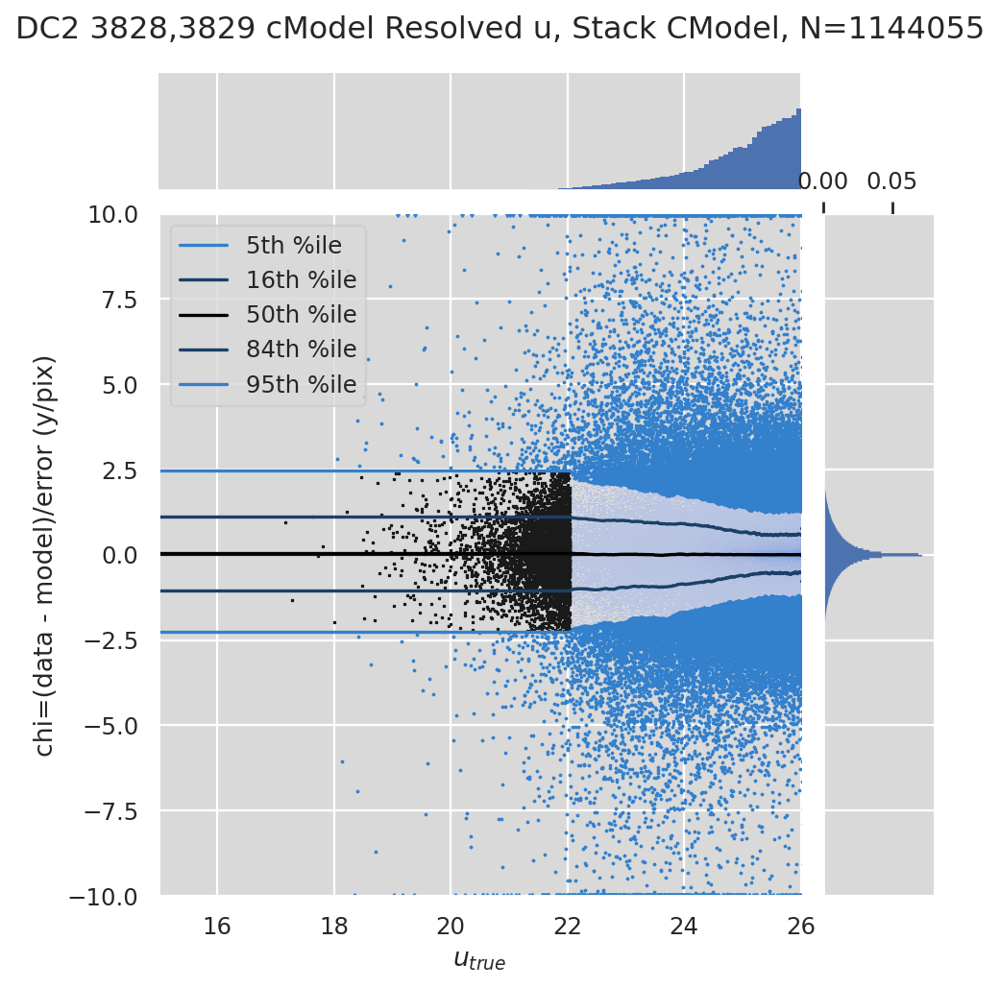

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Resolved g, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


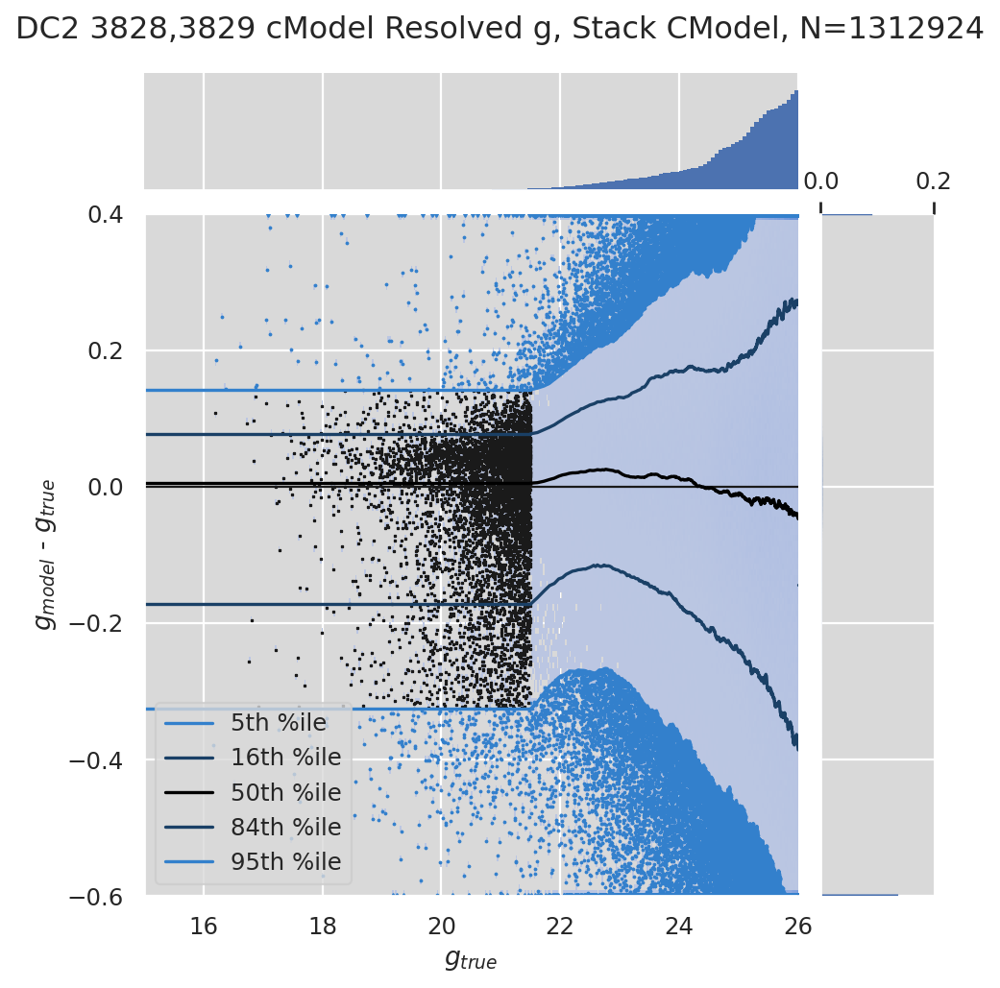

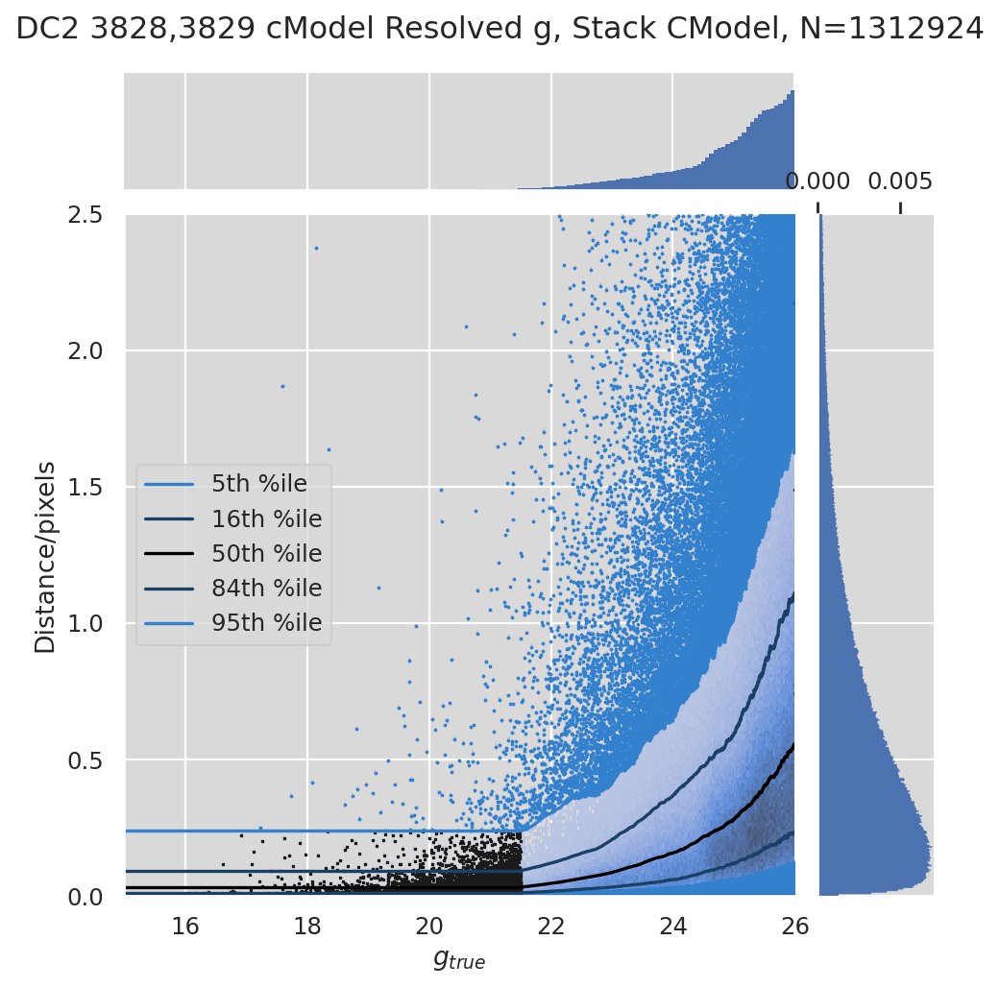

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Resolved g, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


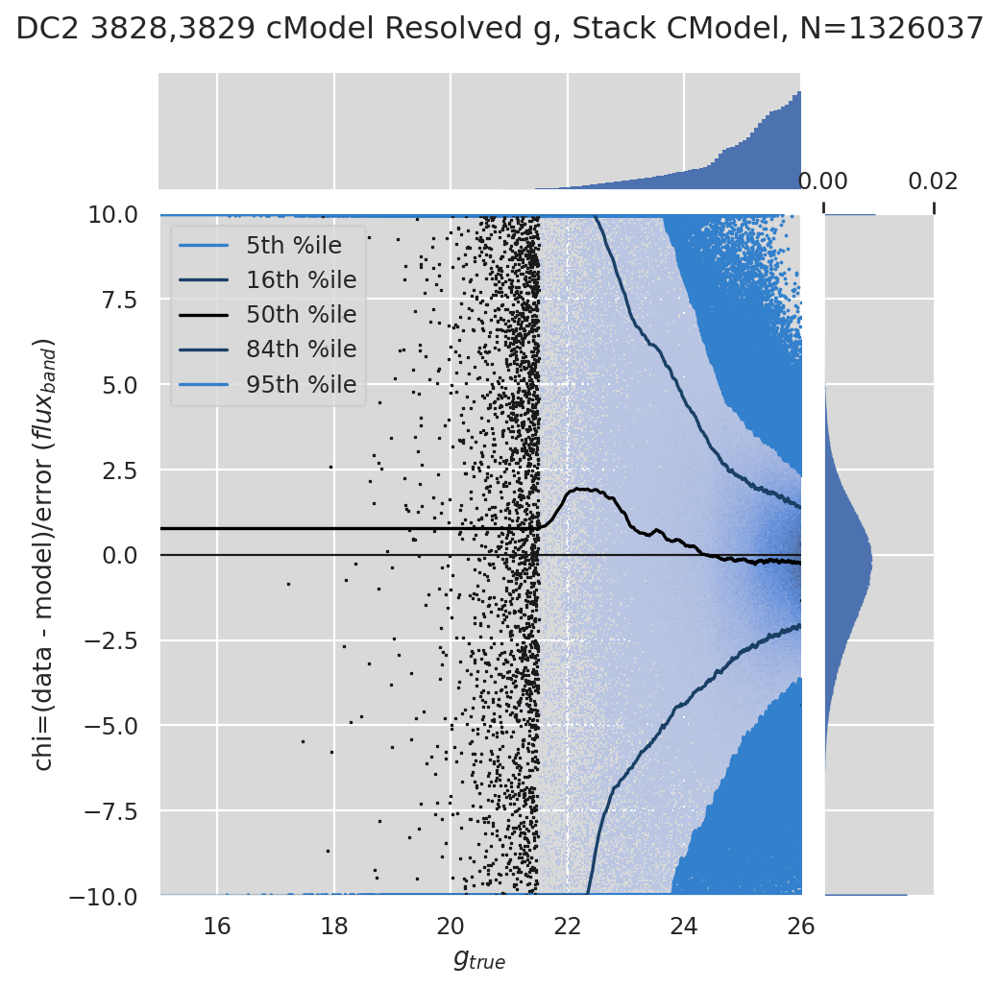

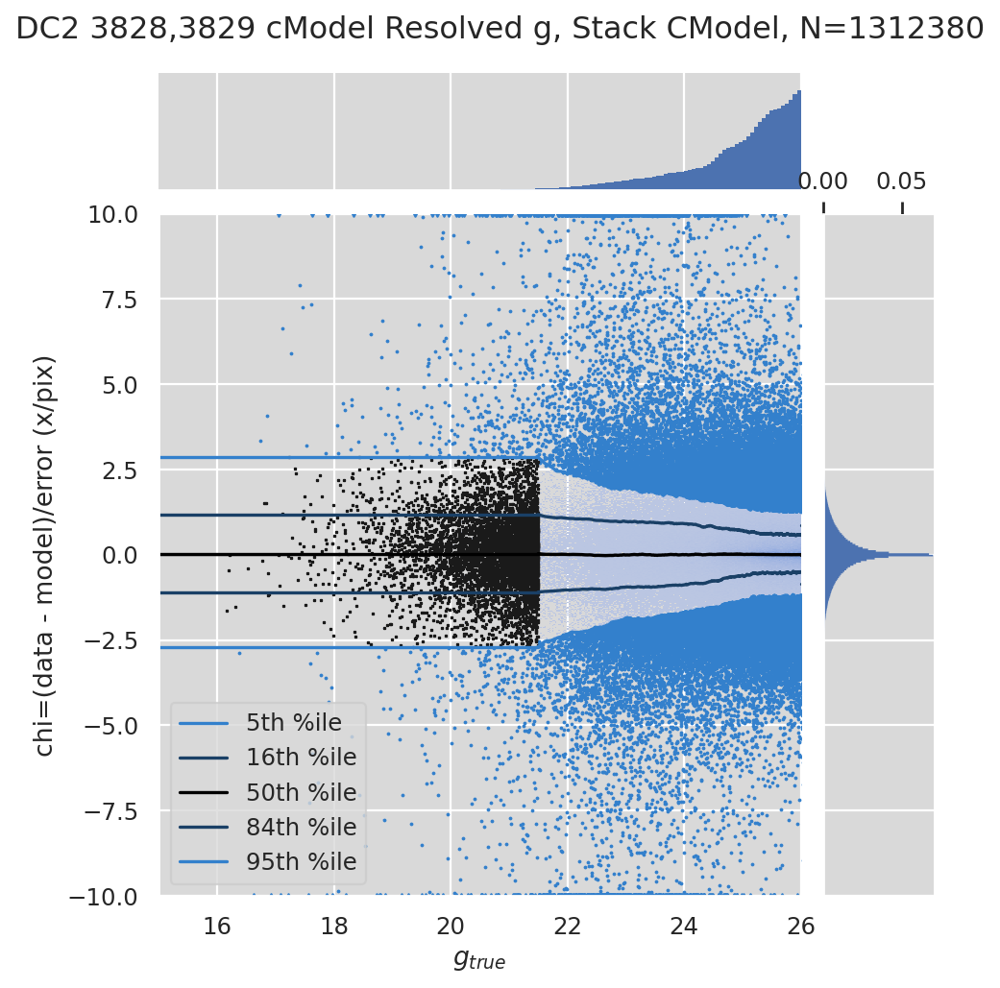

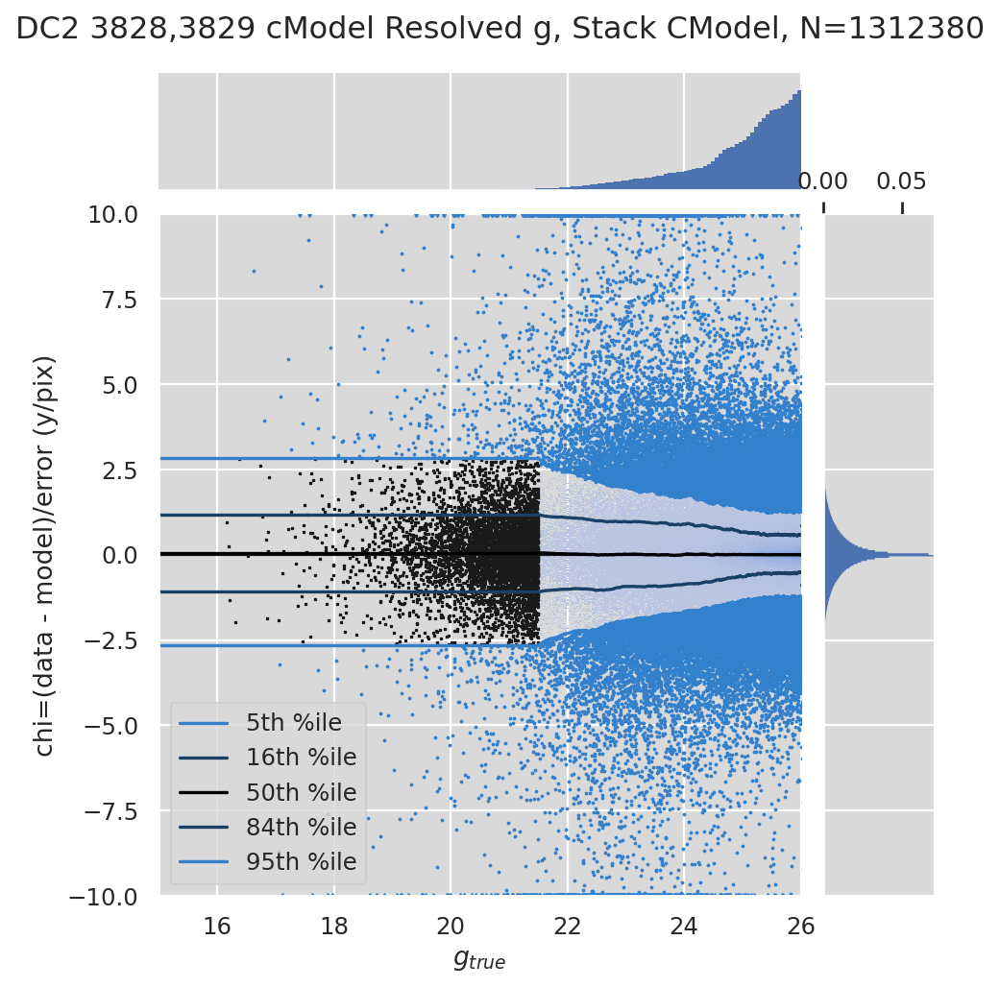

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Resolved r, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


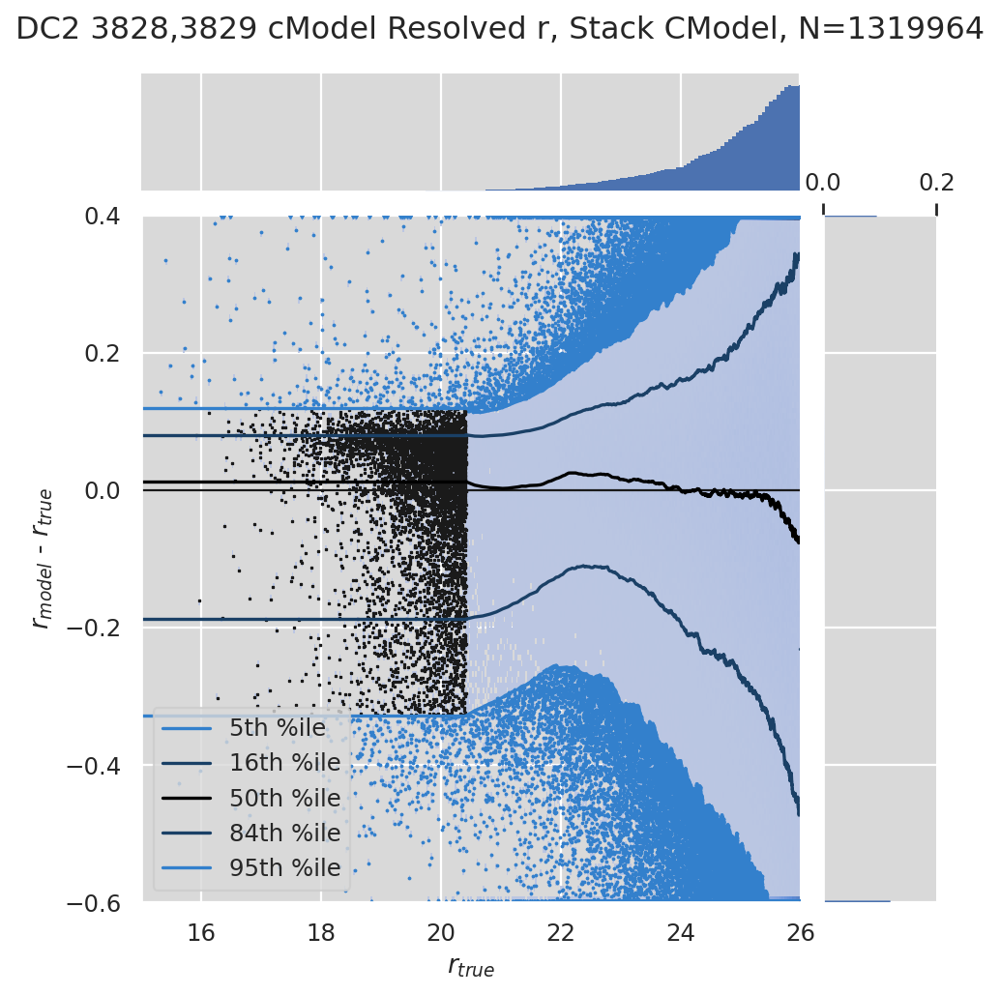

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


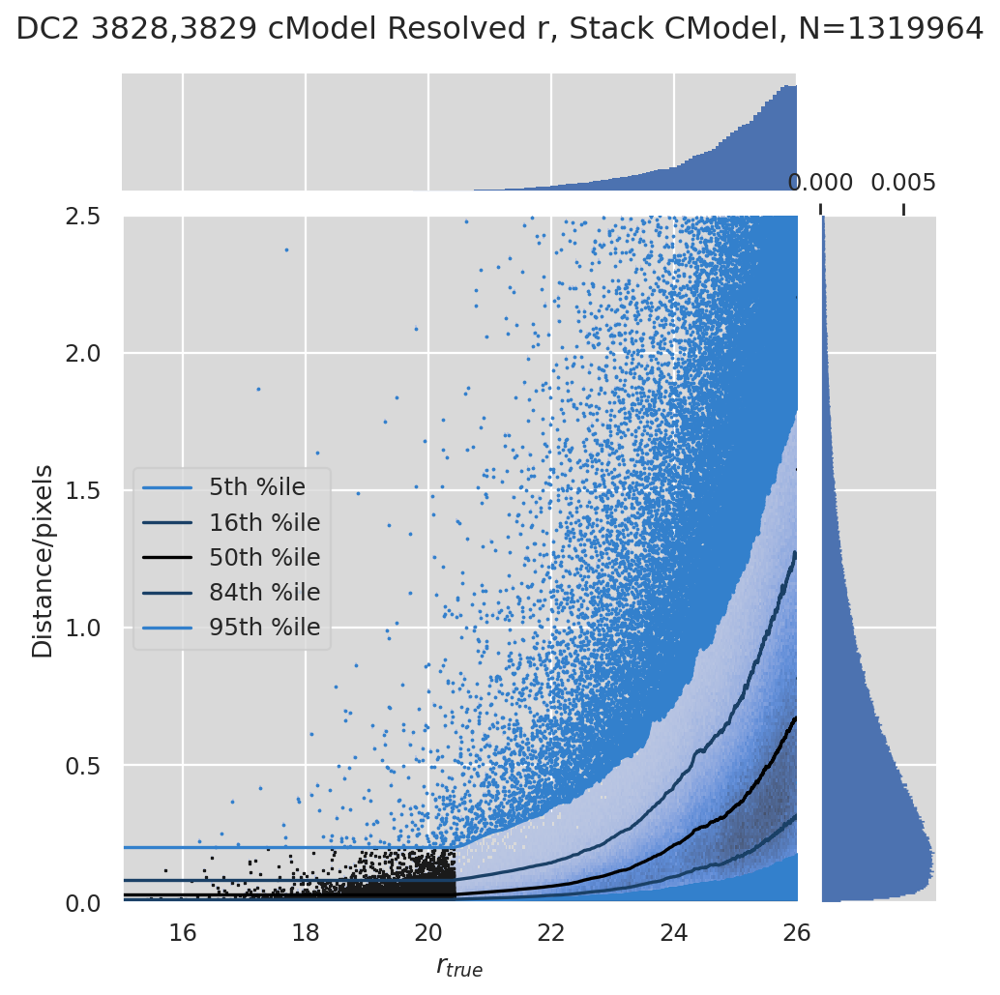

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Resolved r, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


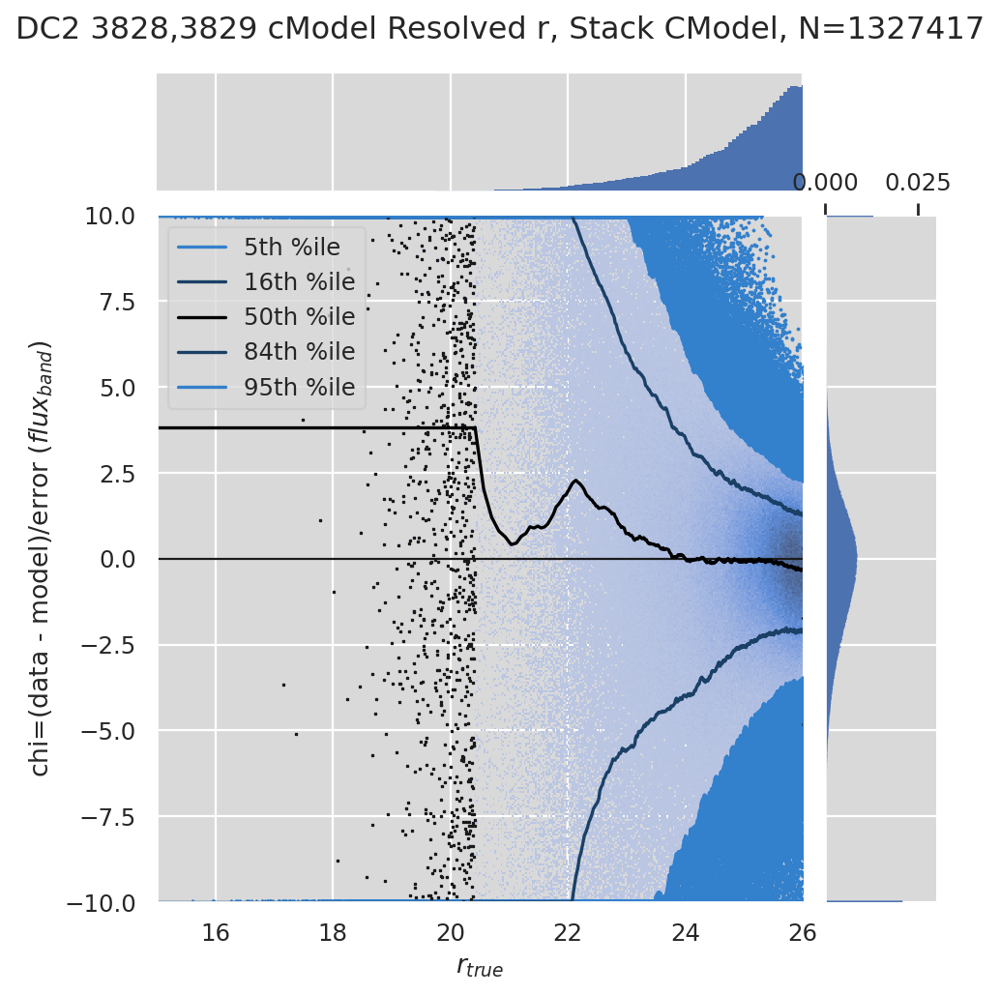

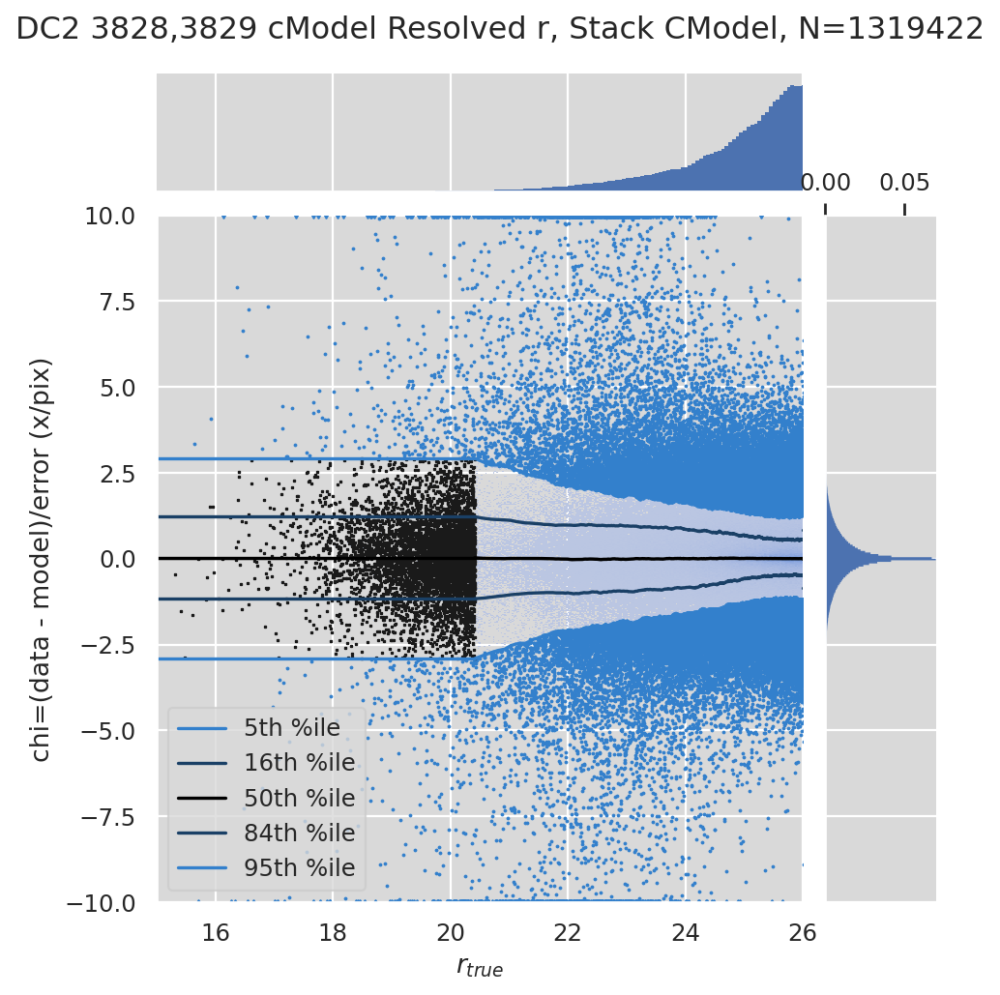

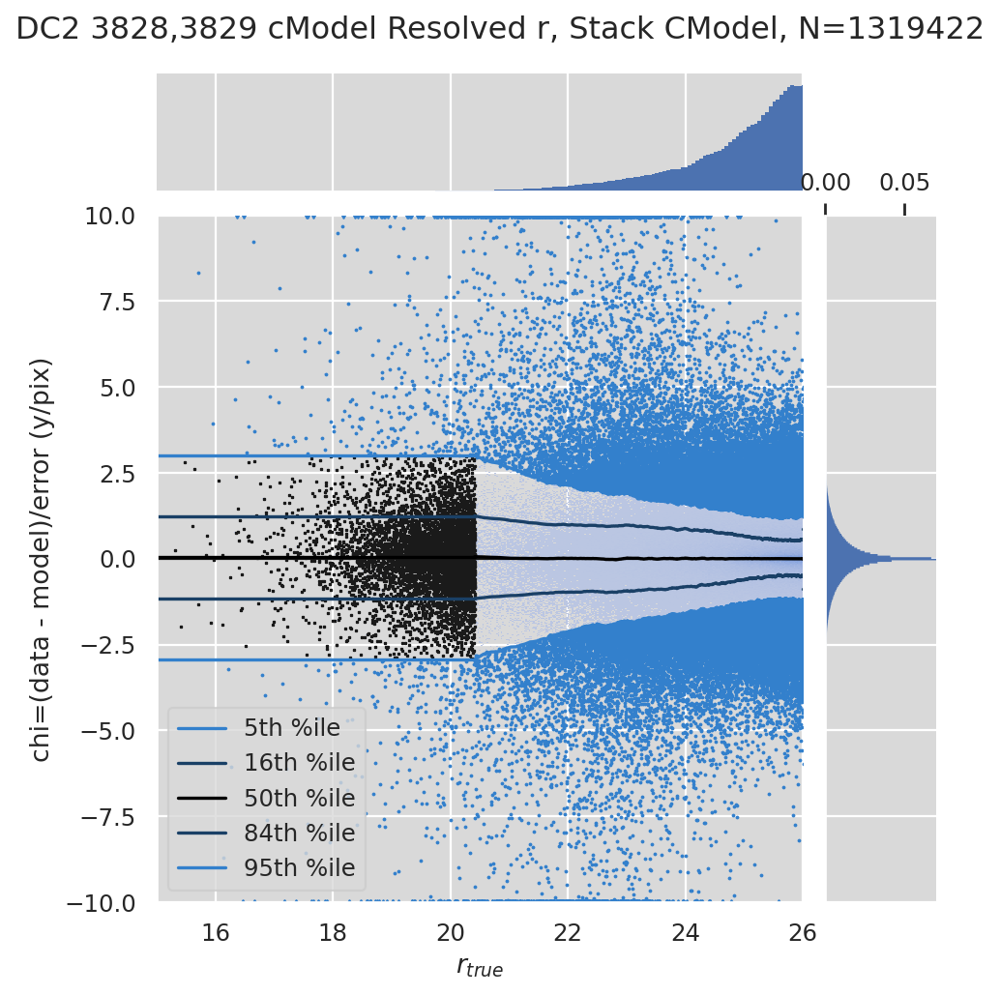

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Resolved i, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


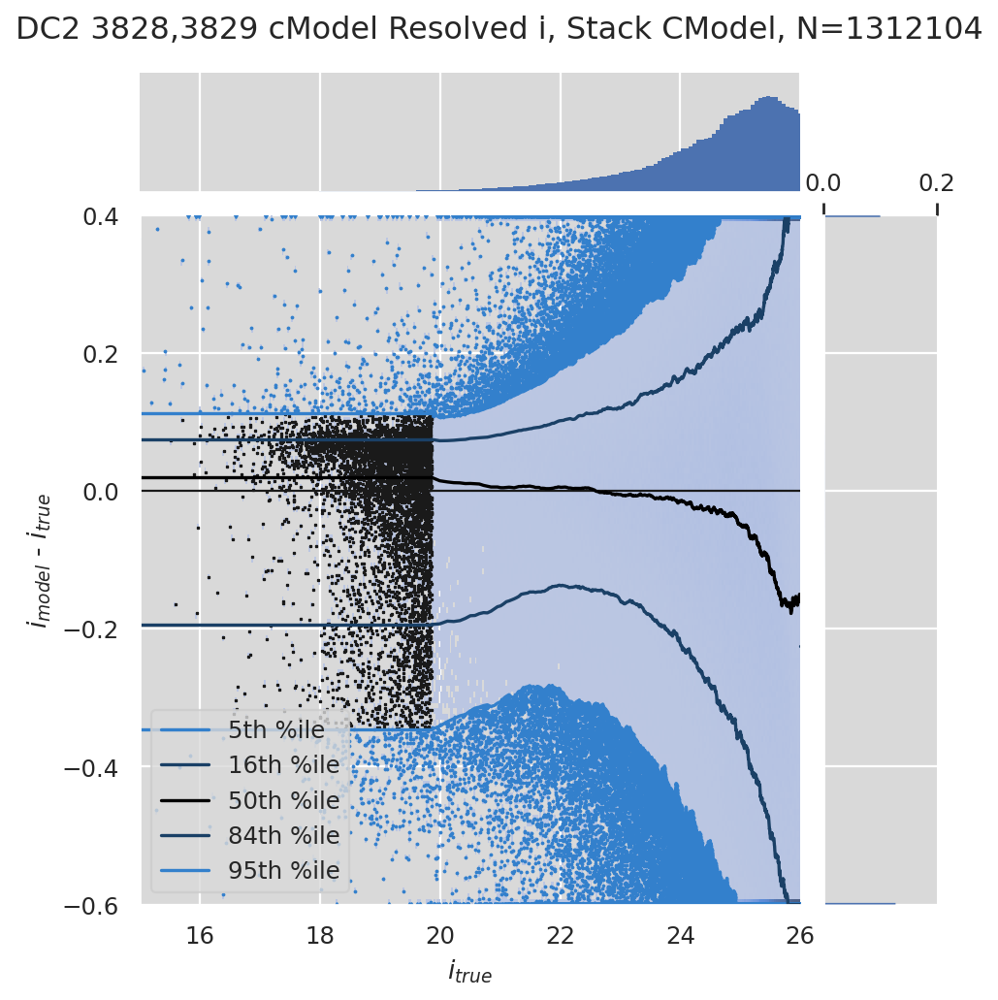

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


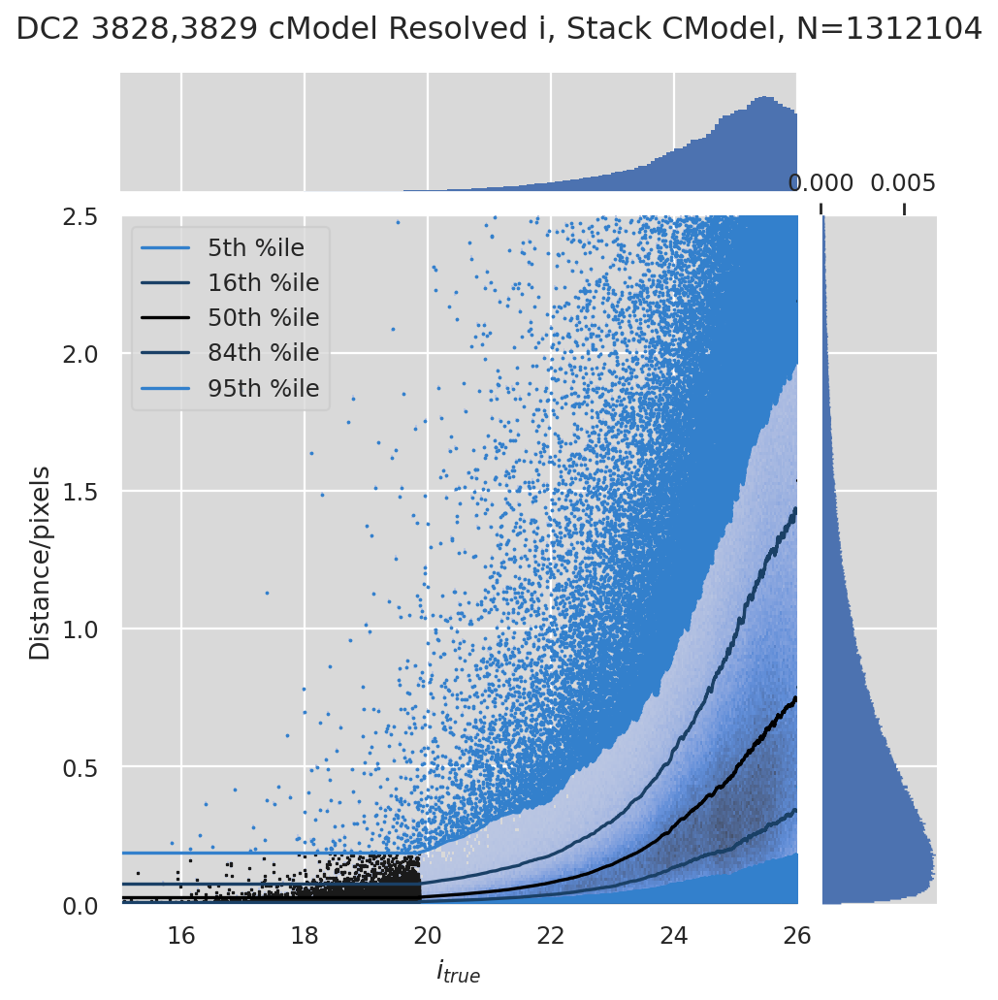

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Resolved i, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


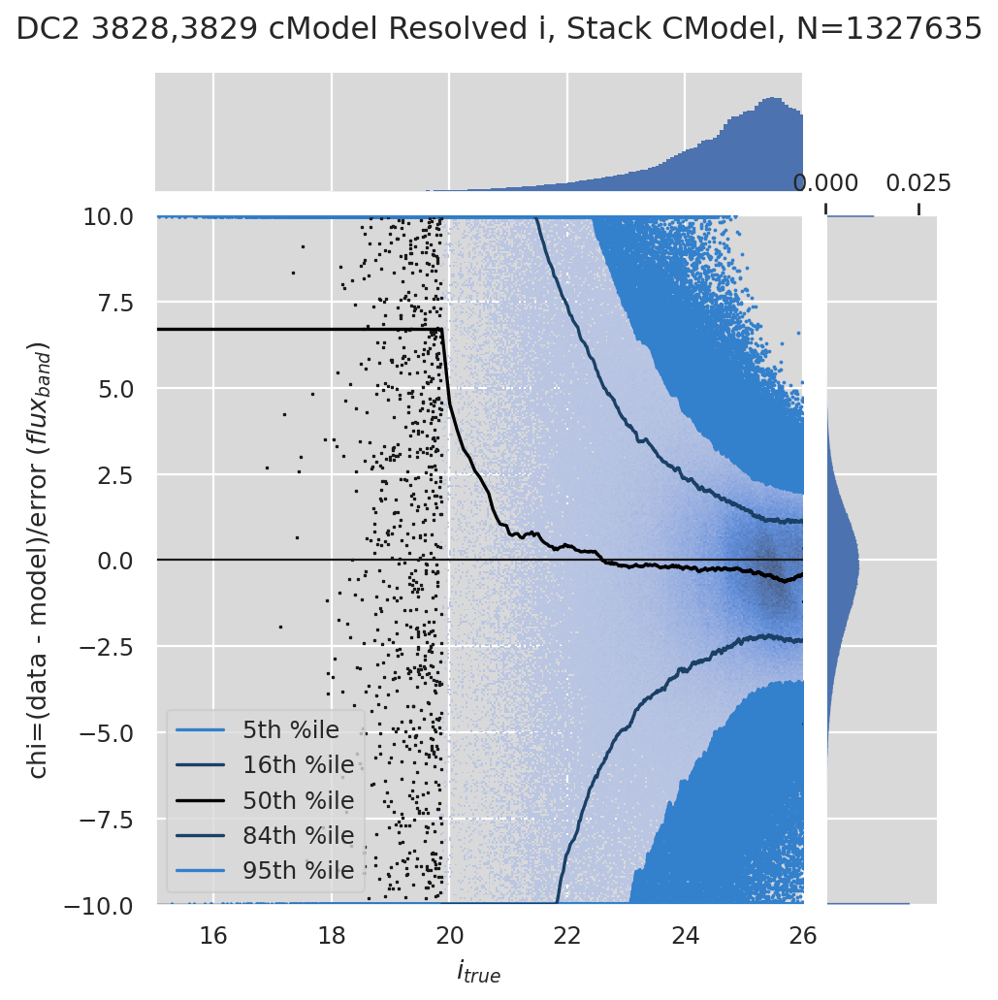

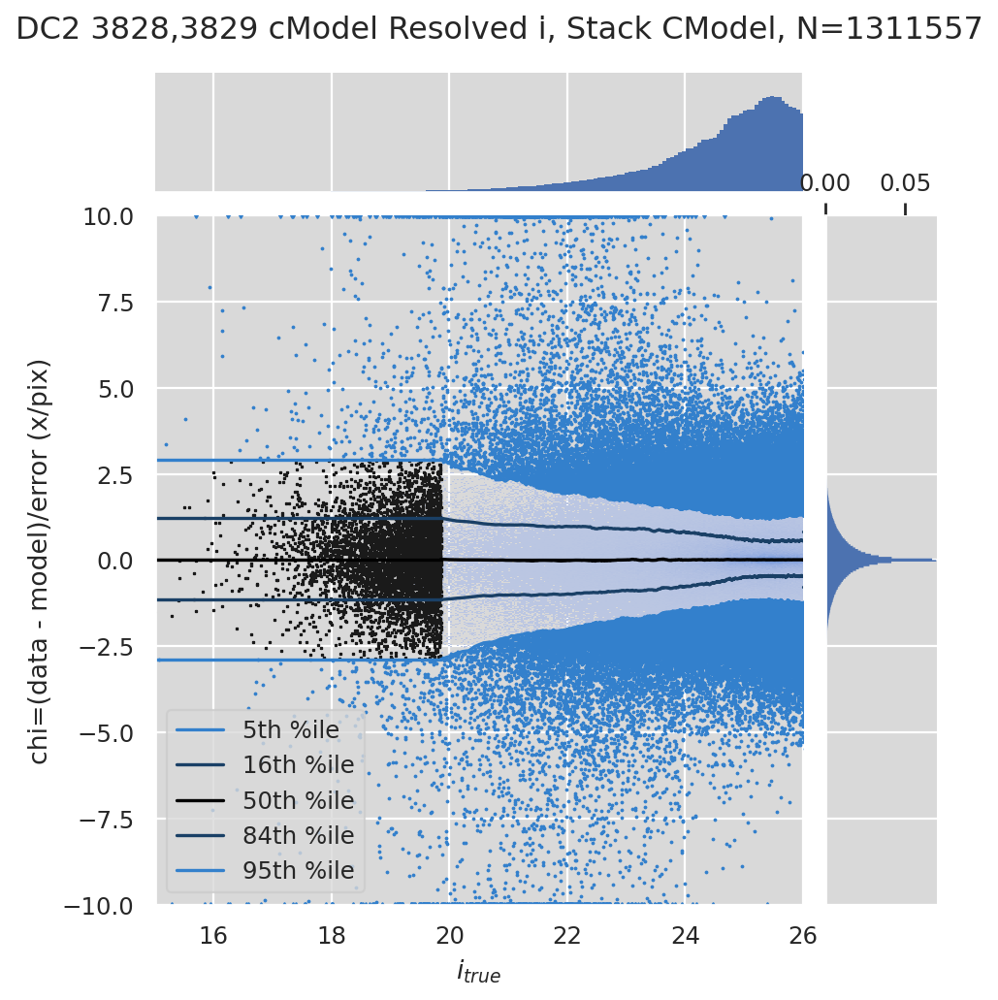

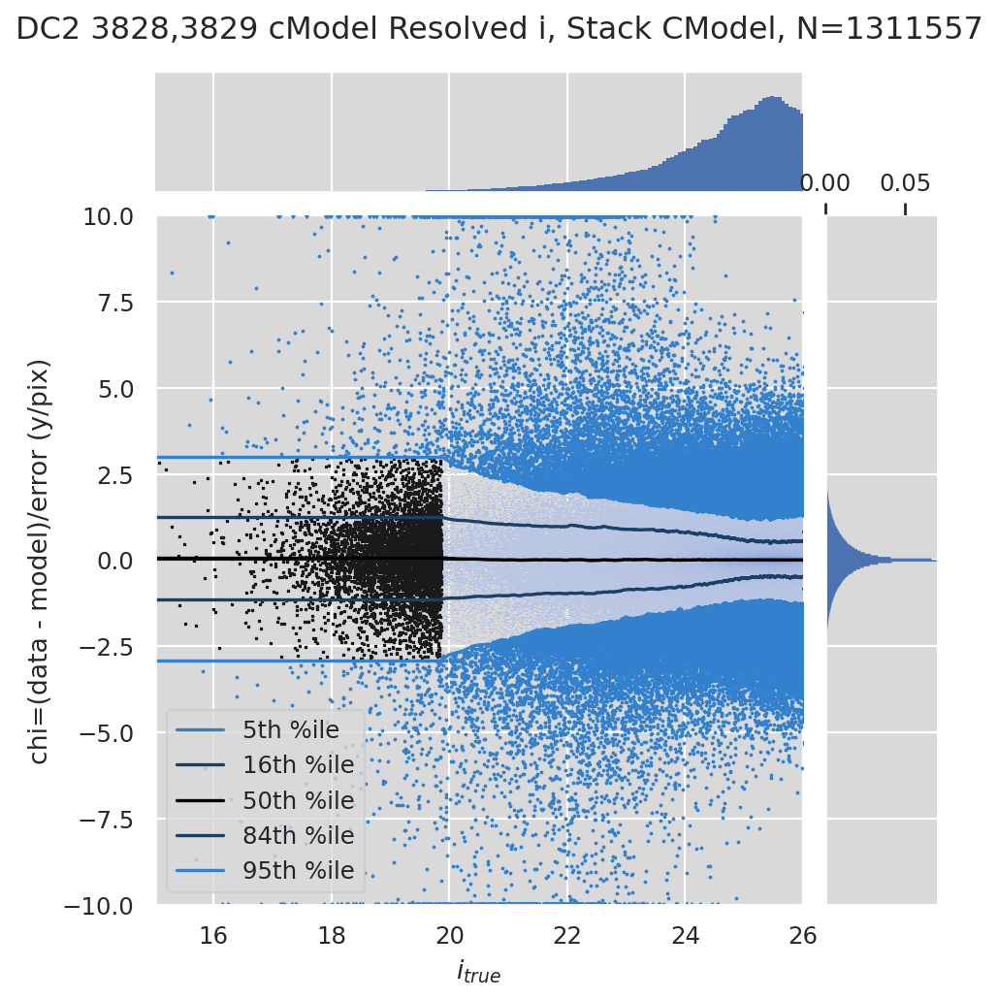

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Resolved z, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


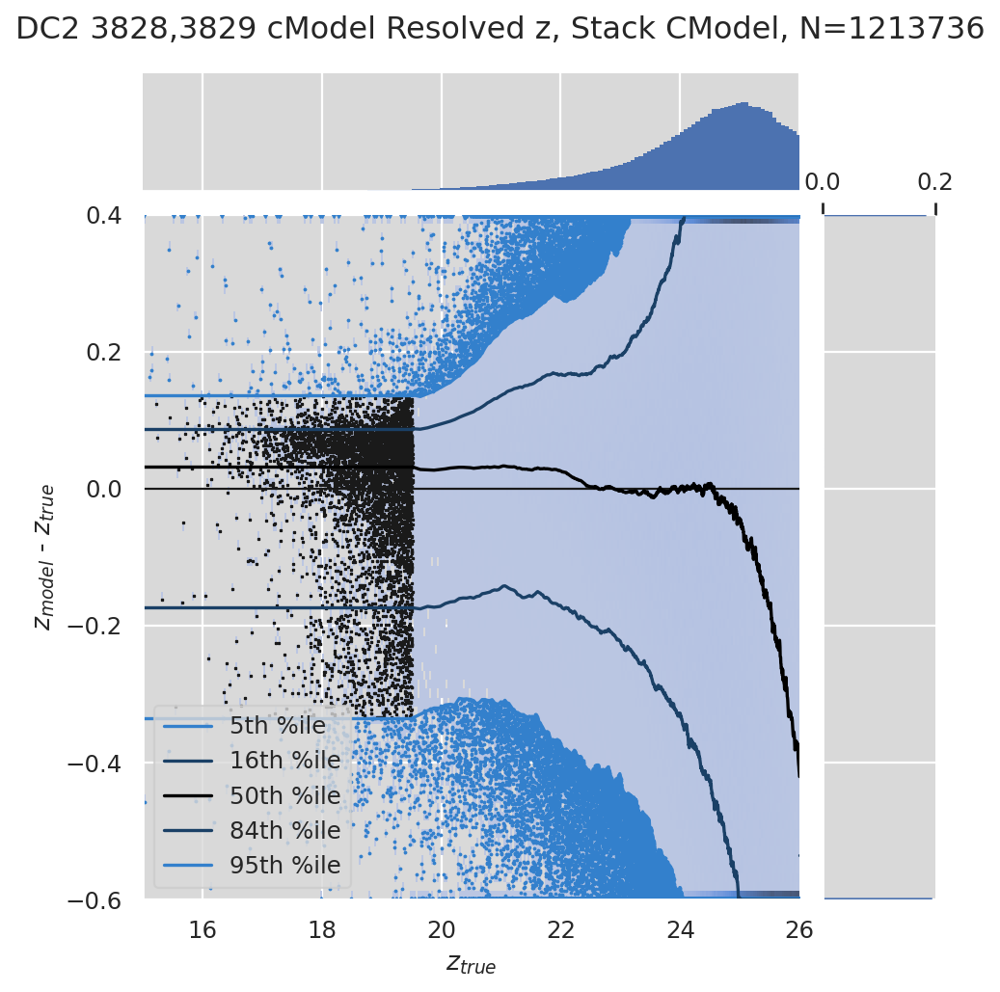

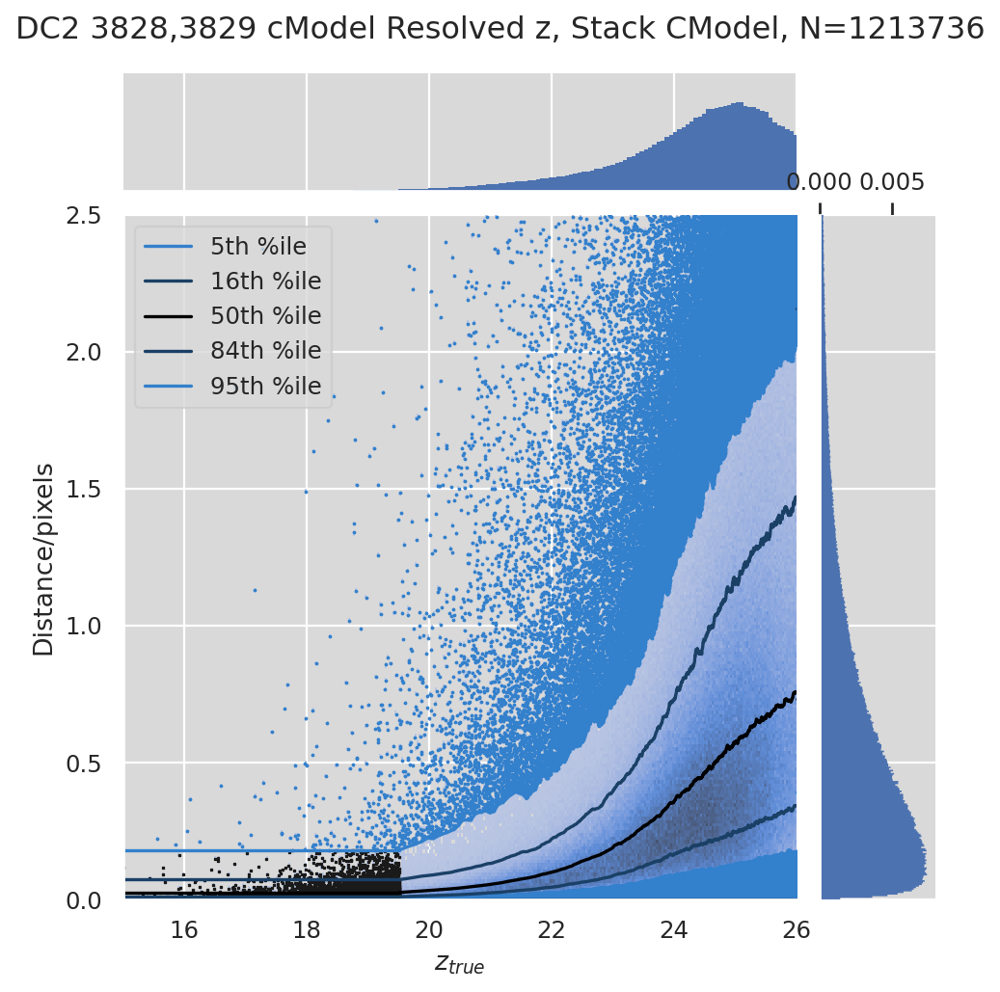

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Resolved z, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


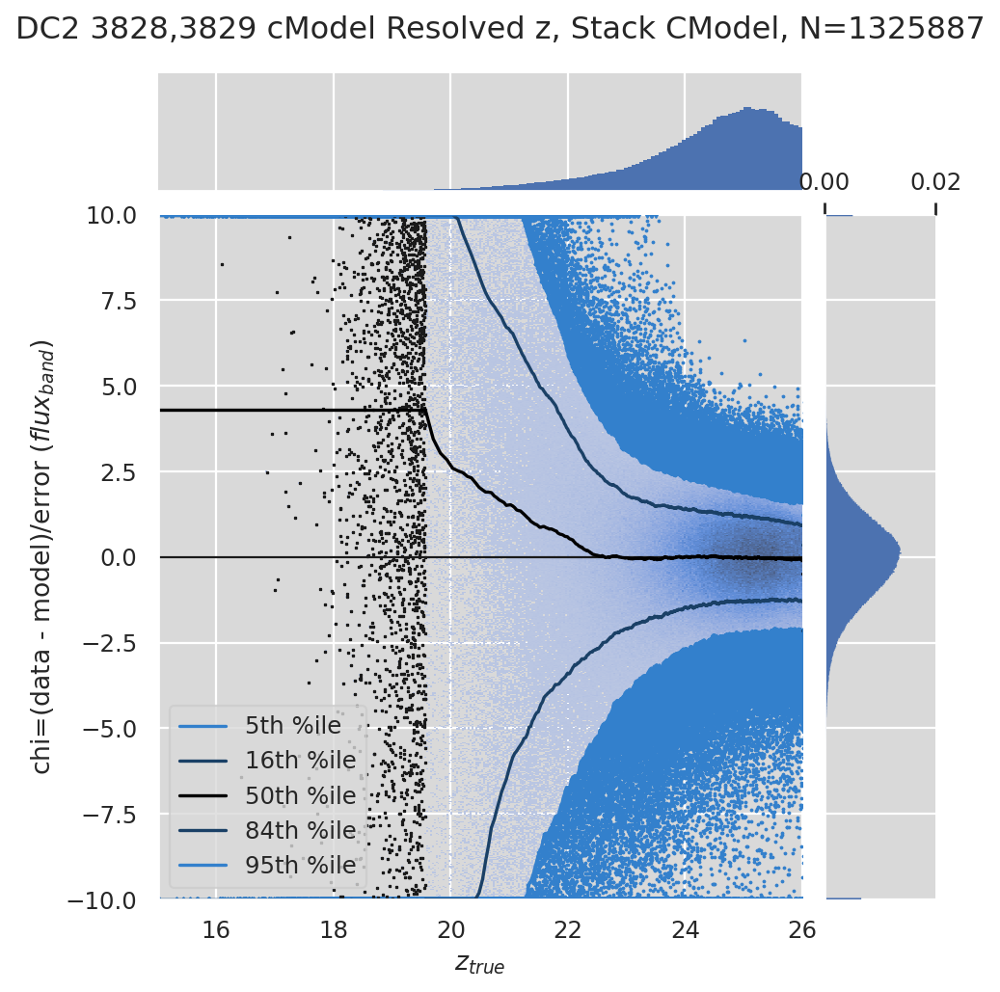

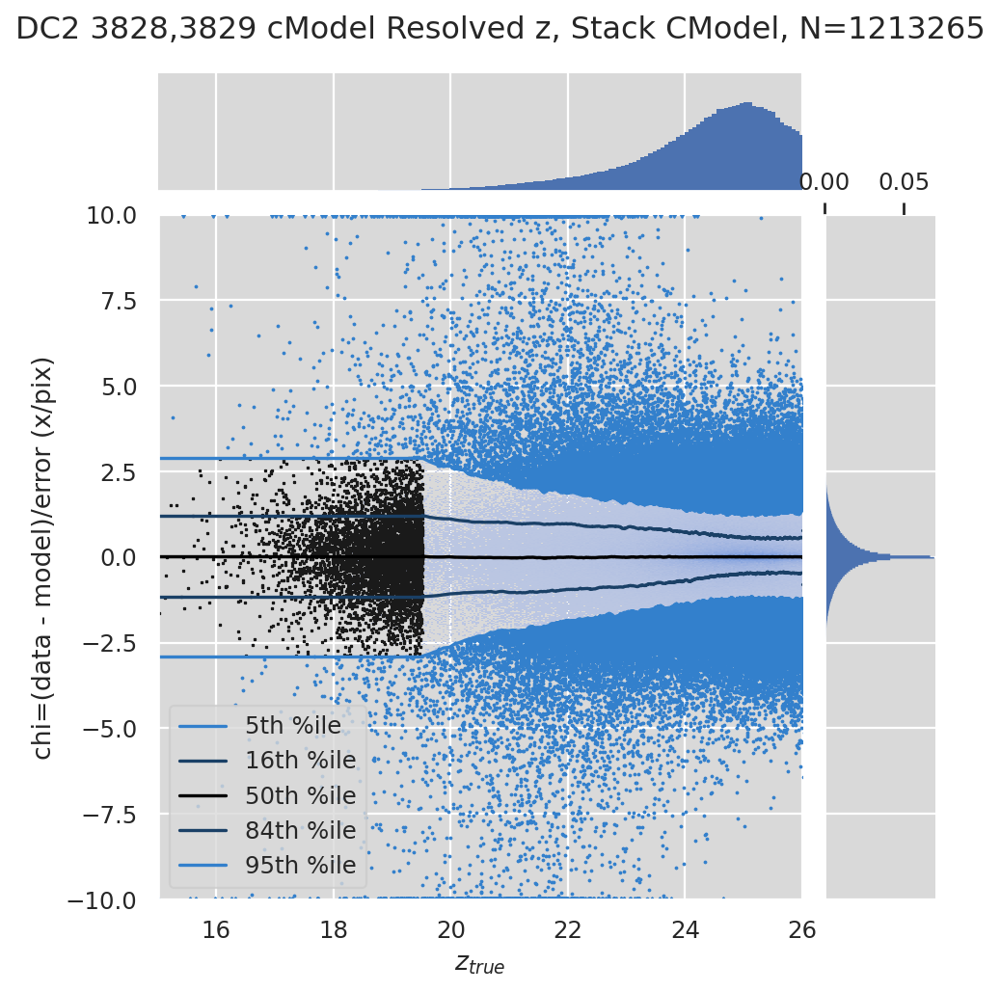

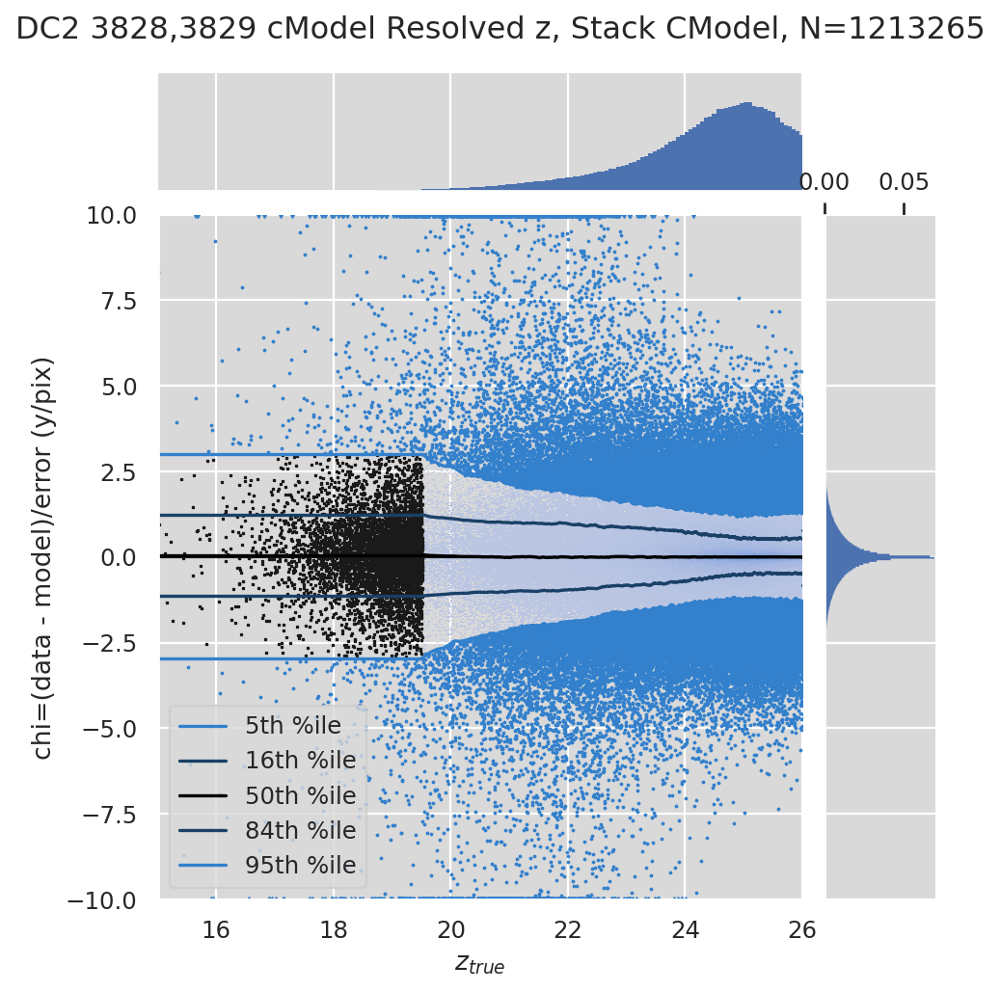

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Resolved y, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


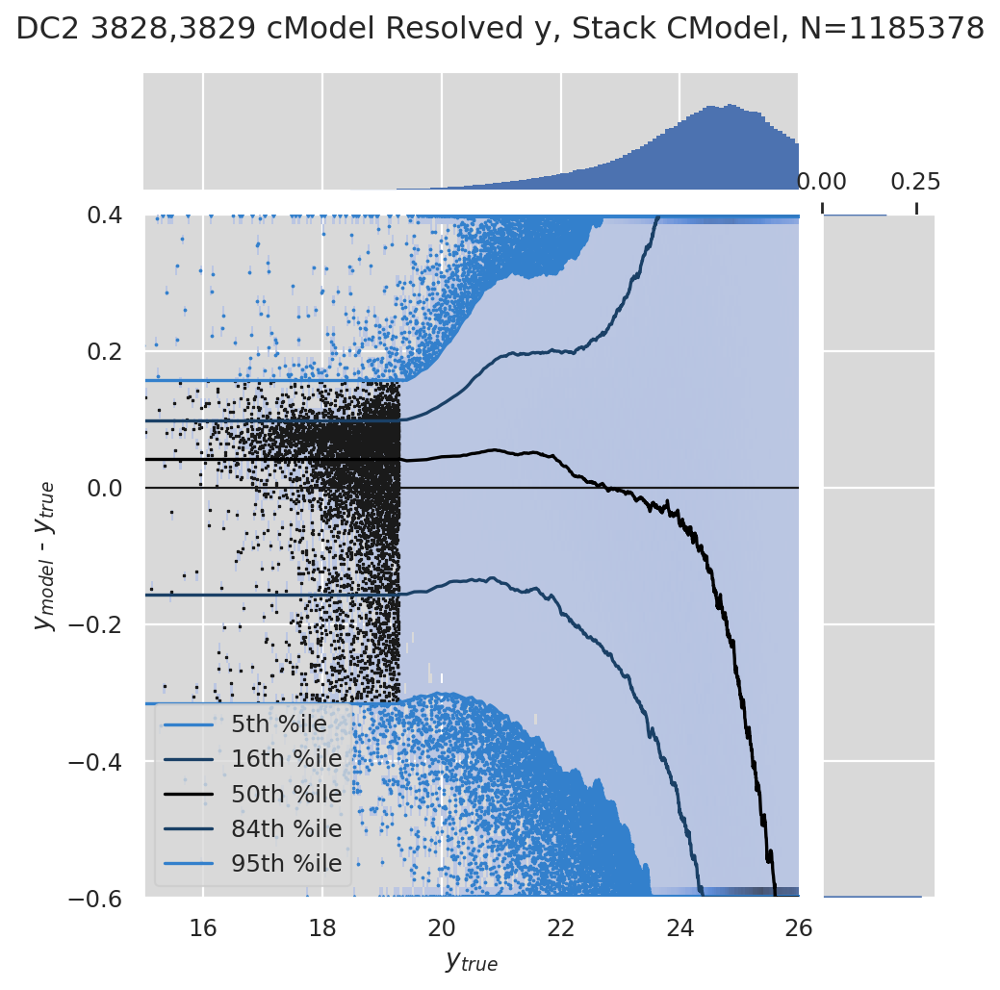

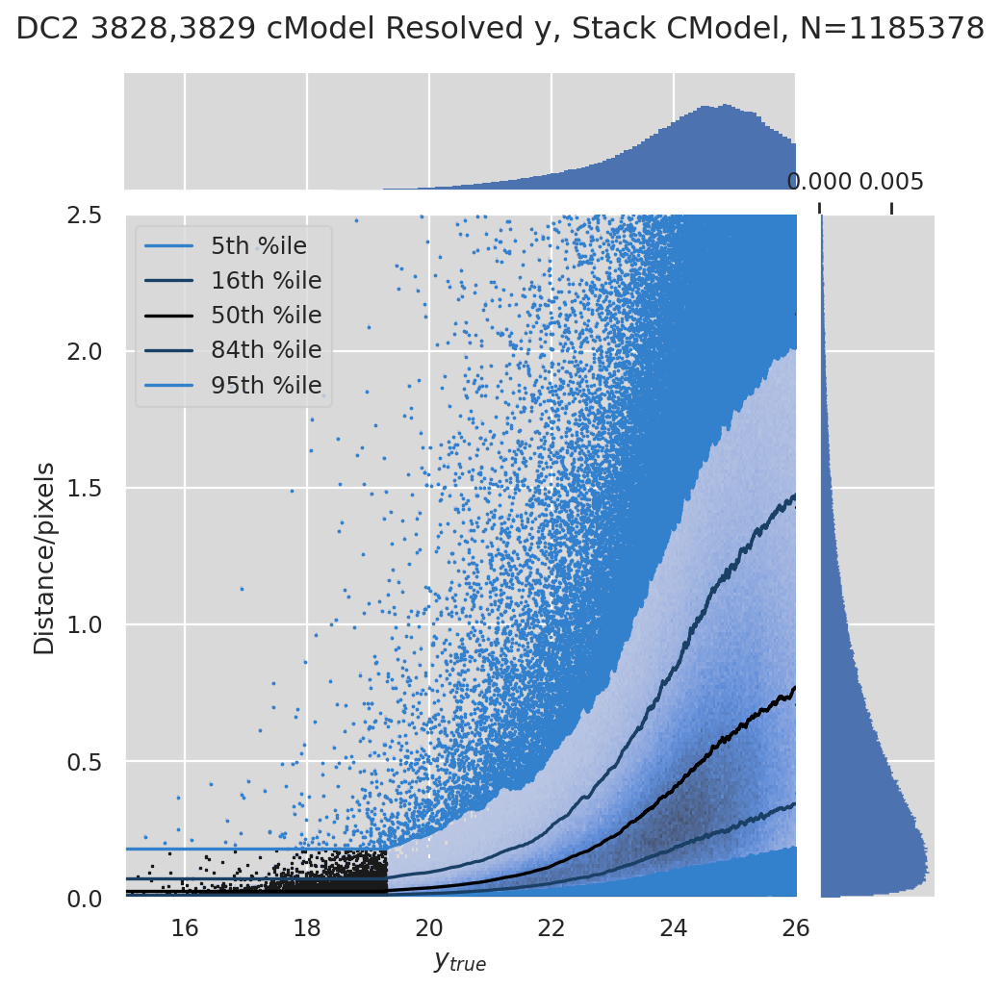

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Resolved y, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


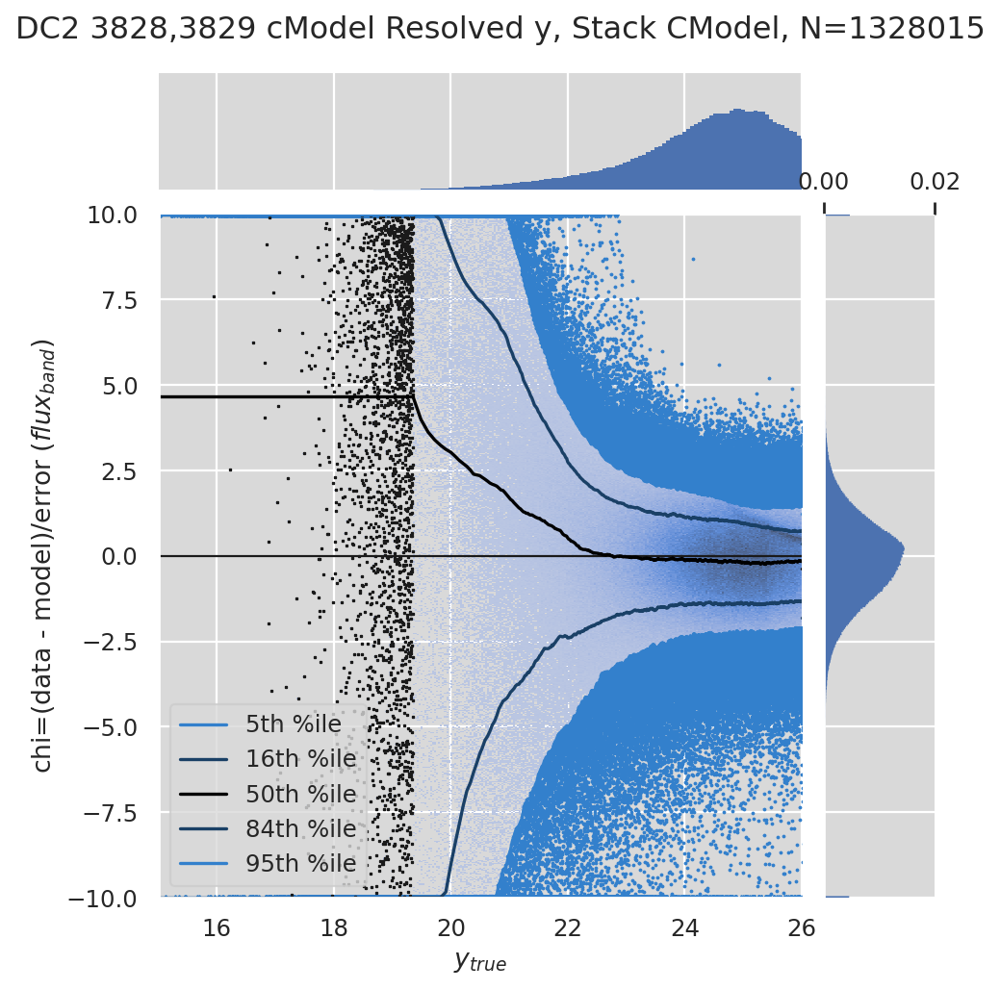

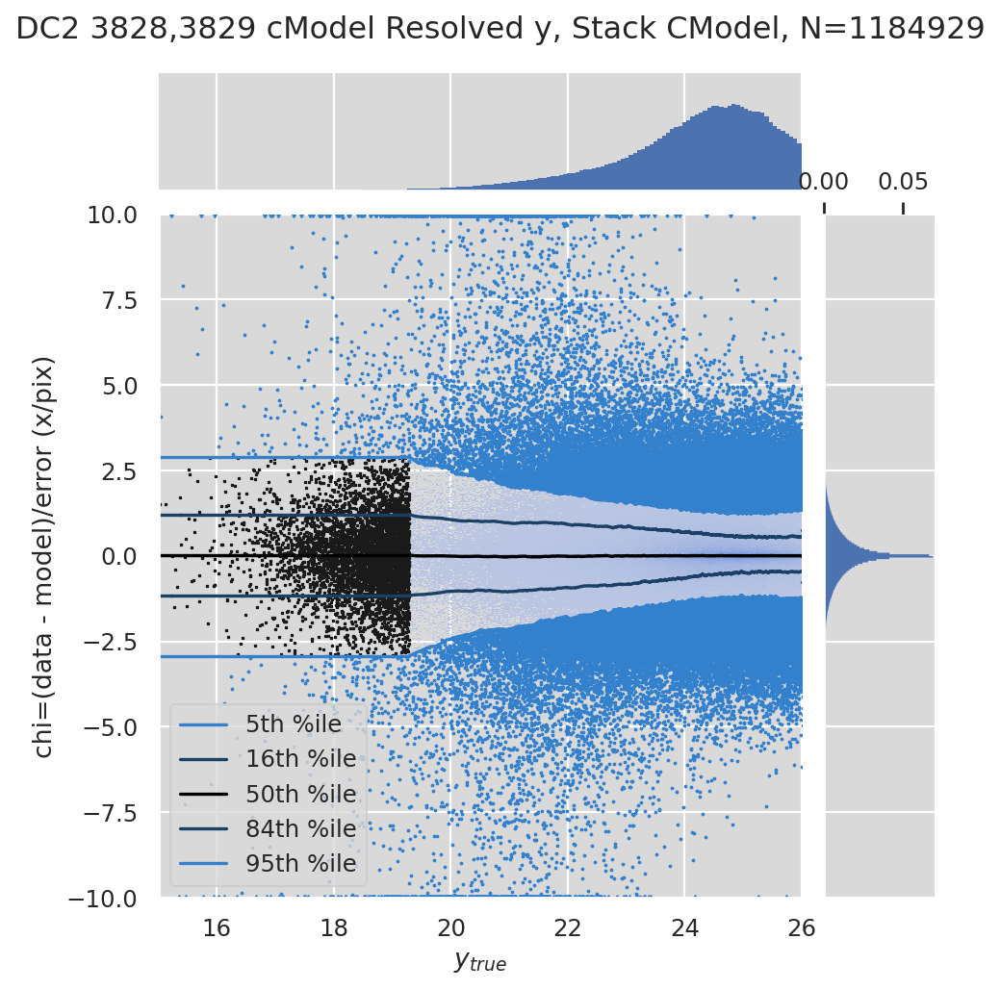

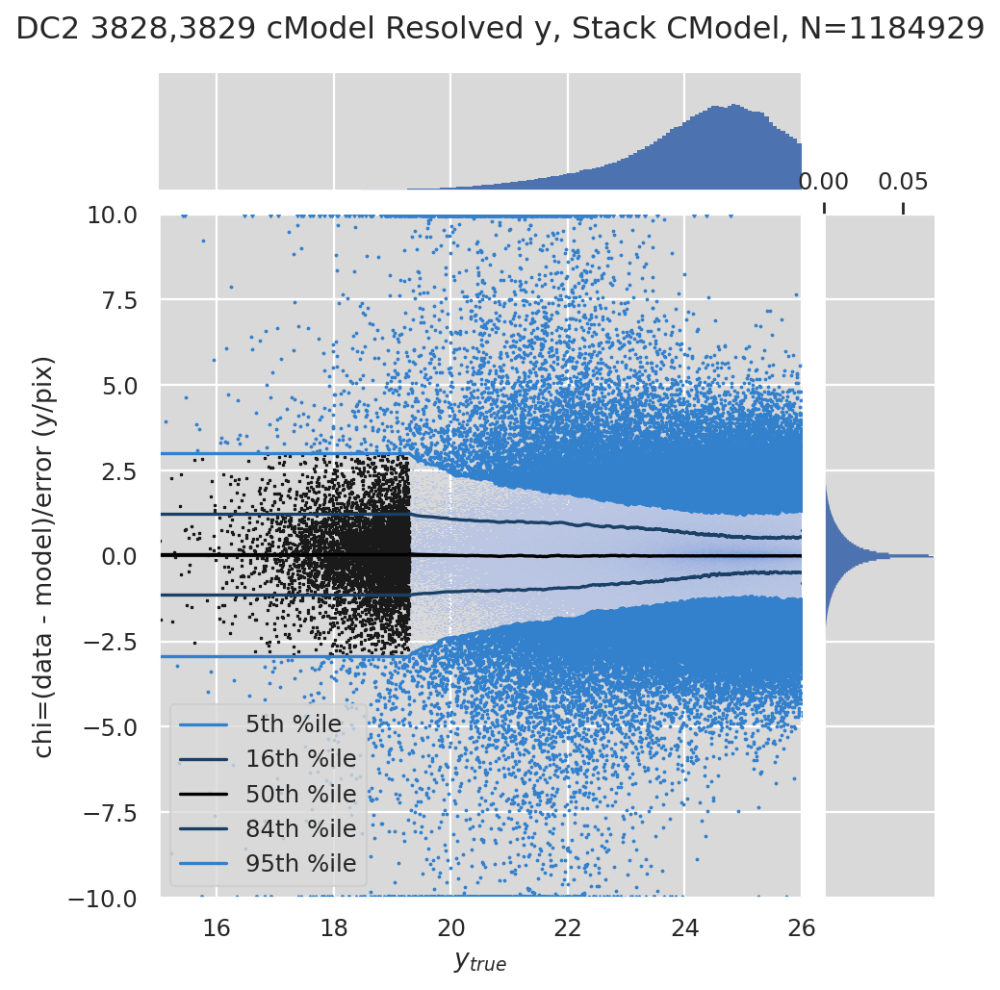

/home/dtaranu/src/mine/modelling_research/plot_matches.py:447: RuntimeWarning: invalid value encountered in subtract
  y = mags_band[b1][1] - mags_band[b2][1]


Plotting color diffs: DC2 3828,3829 cModel Resolved u-g, Stack CModel


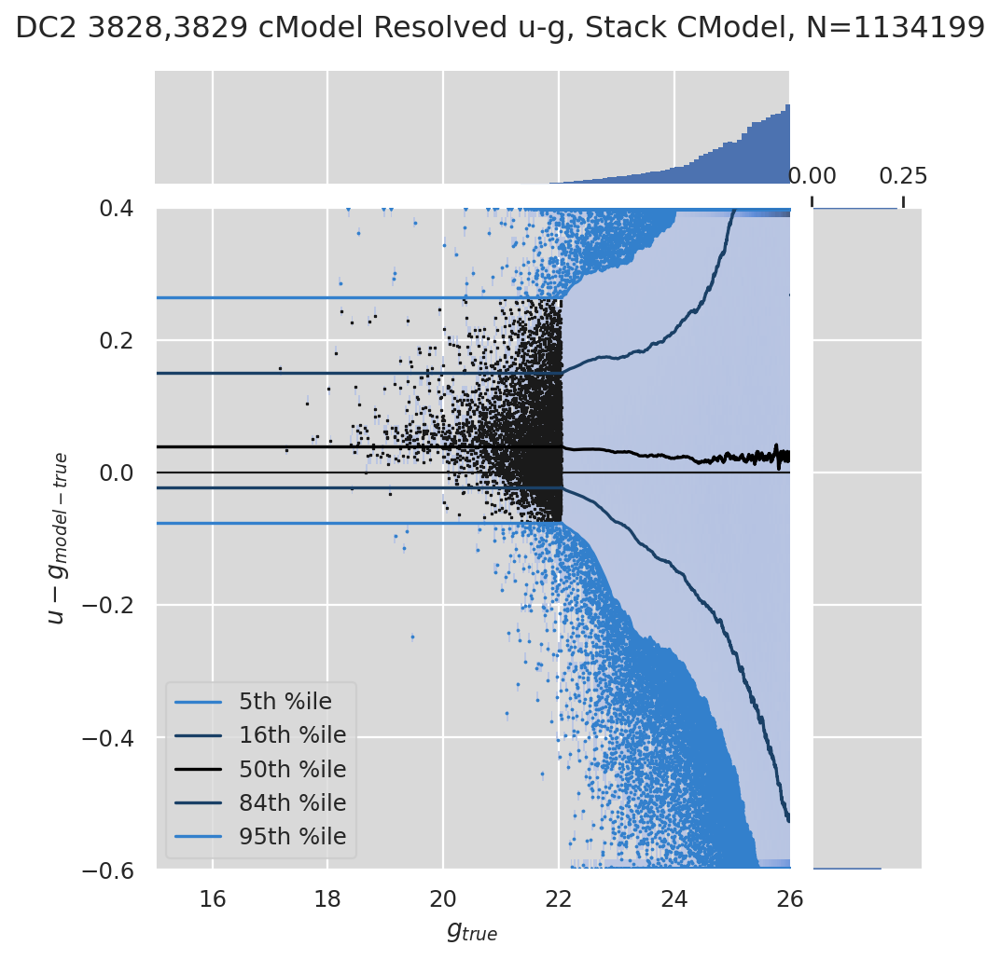

/home/dtaranu/src/mine/modelling_research/plot_matches.py:460: RuntimeWarning: divide by zero encountered in true_divide
  chi = y/sigma


Plotting color chis: DC2 3828,3829 cModel Resolved u-g, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


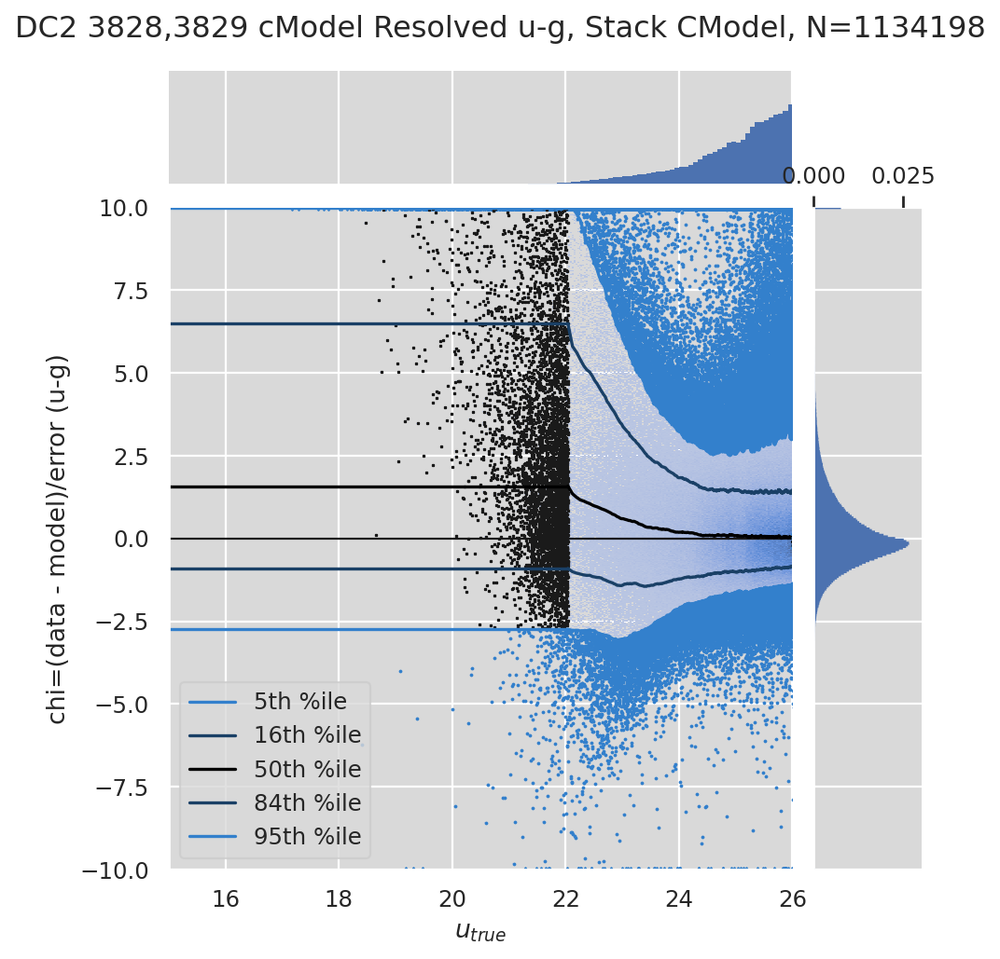

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


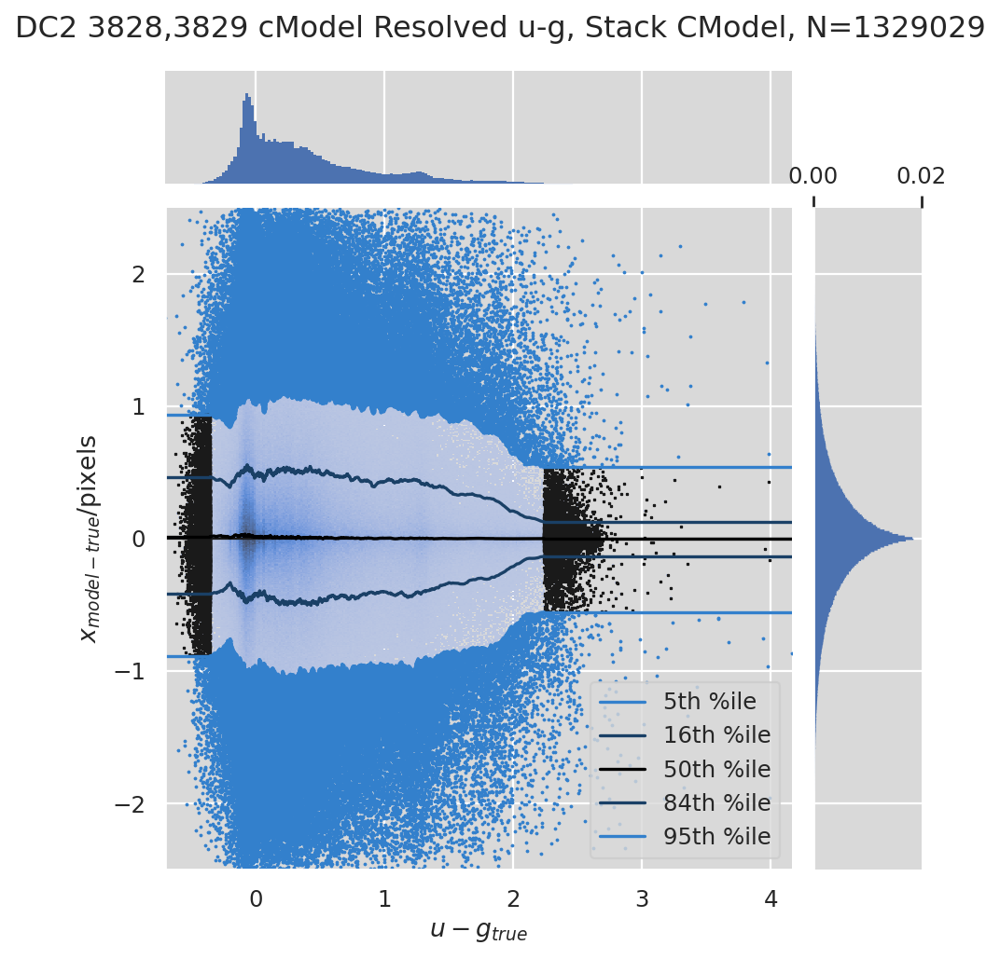

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


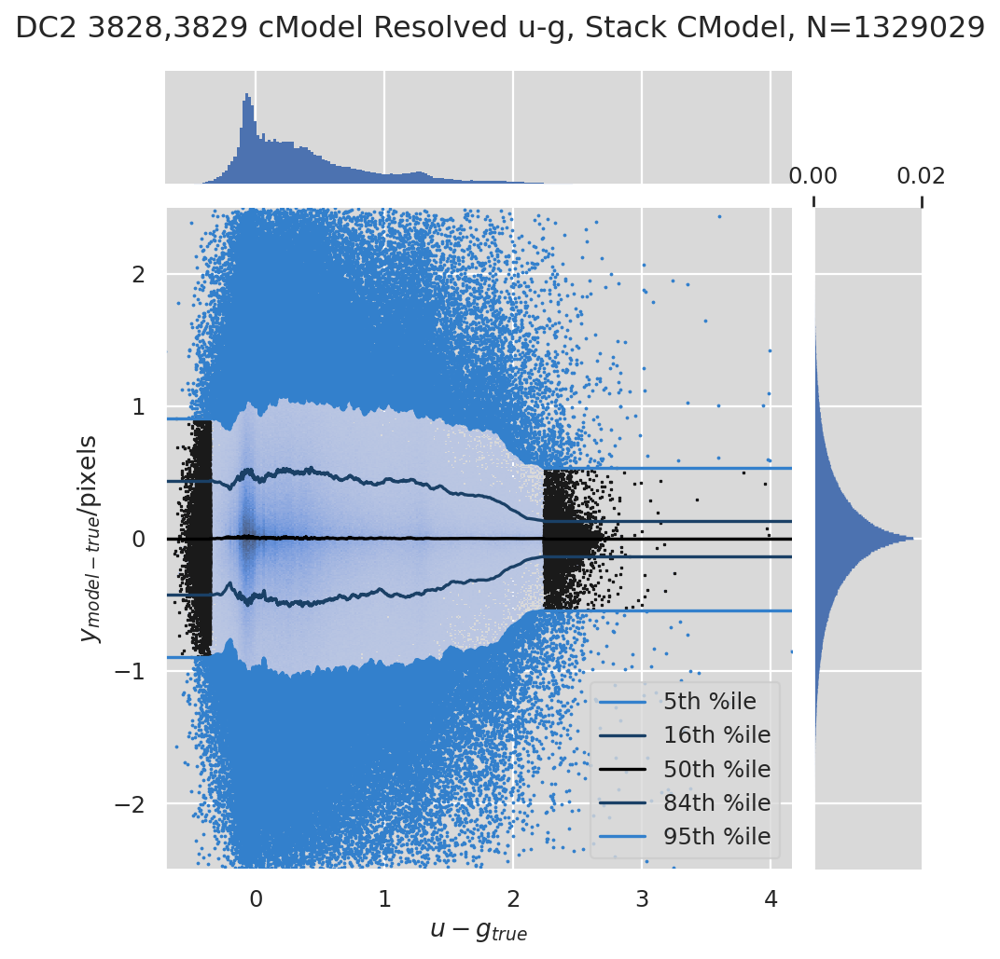

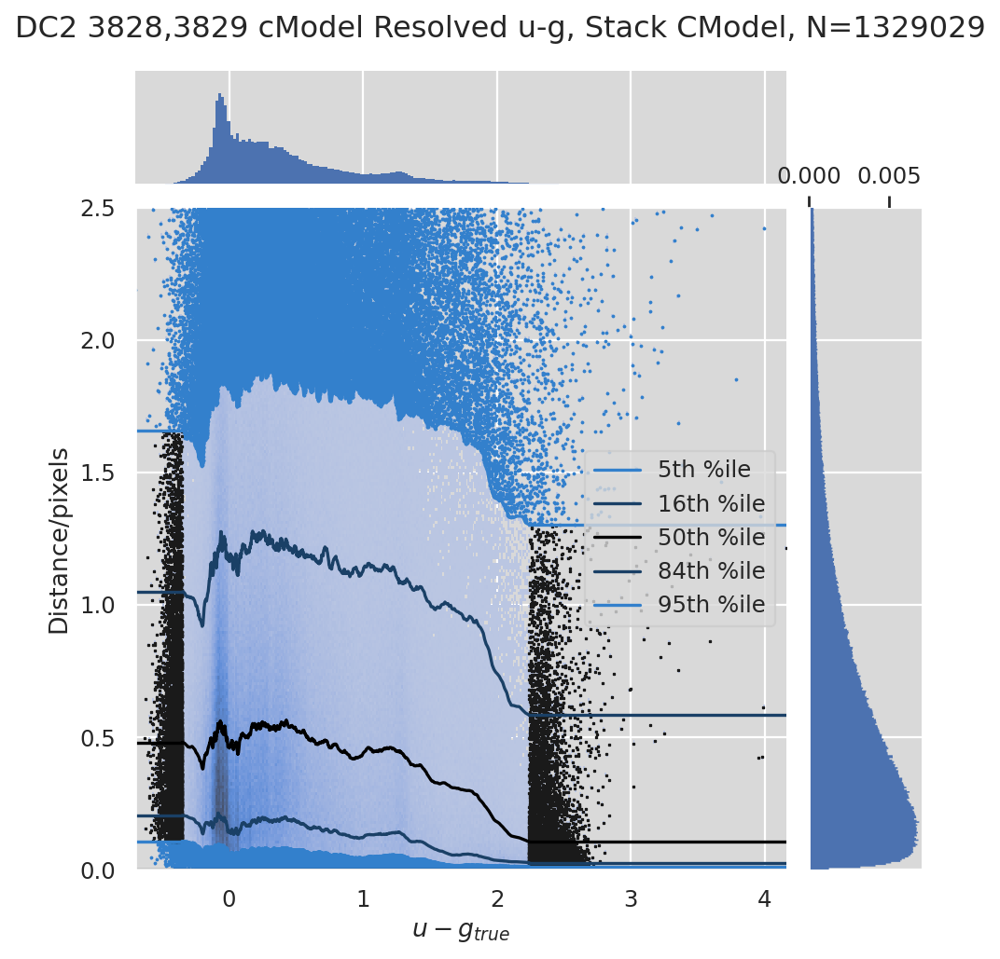

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


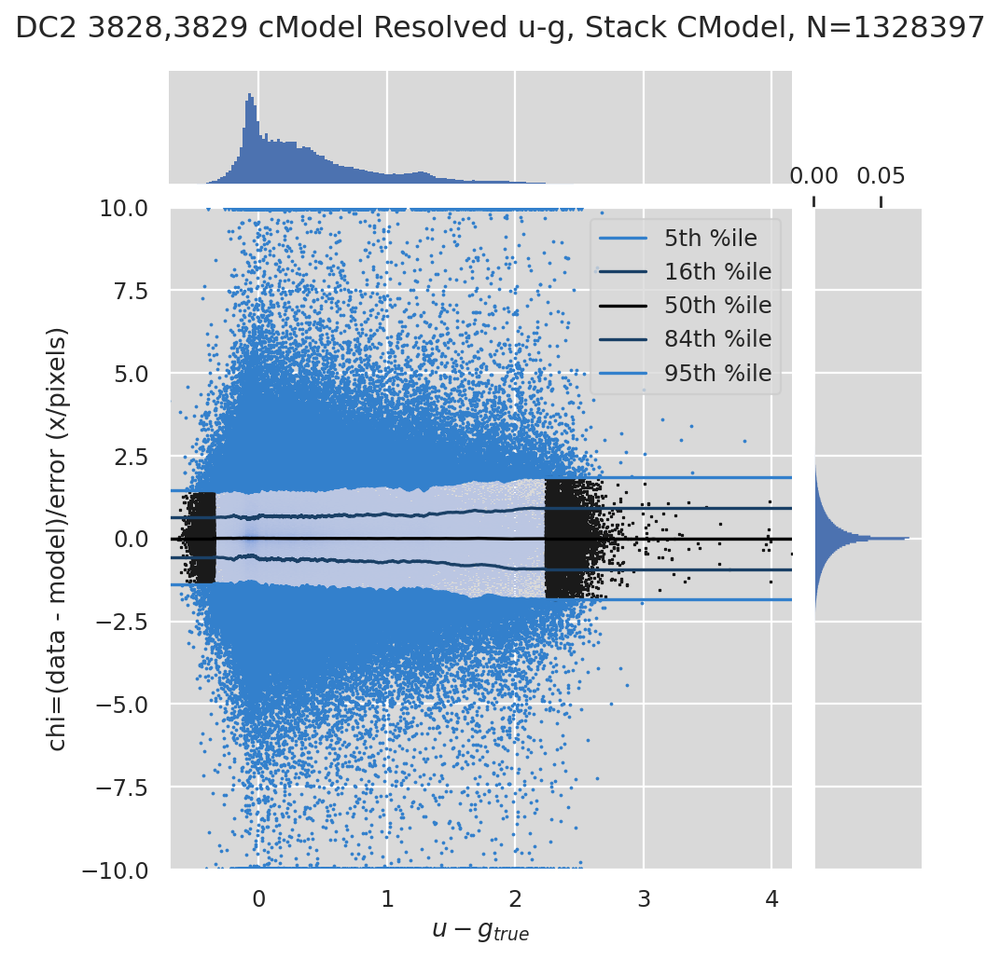

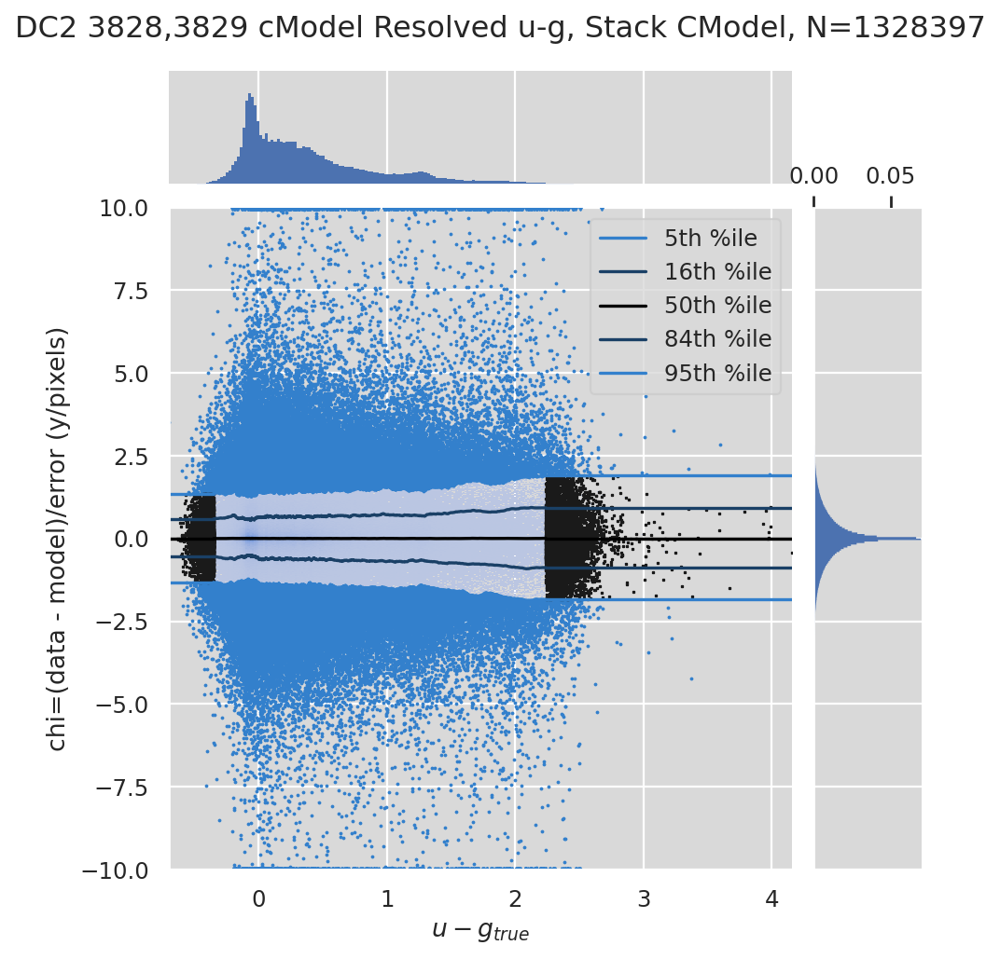

Plotting color diffs: DC2 3828,3829 cModel Resolved g-r, Stack CModel


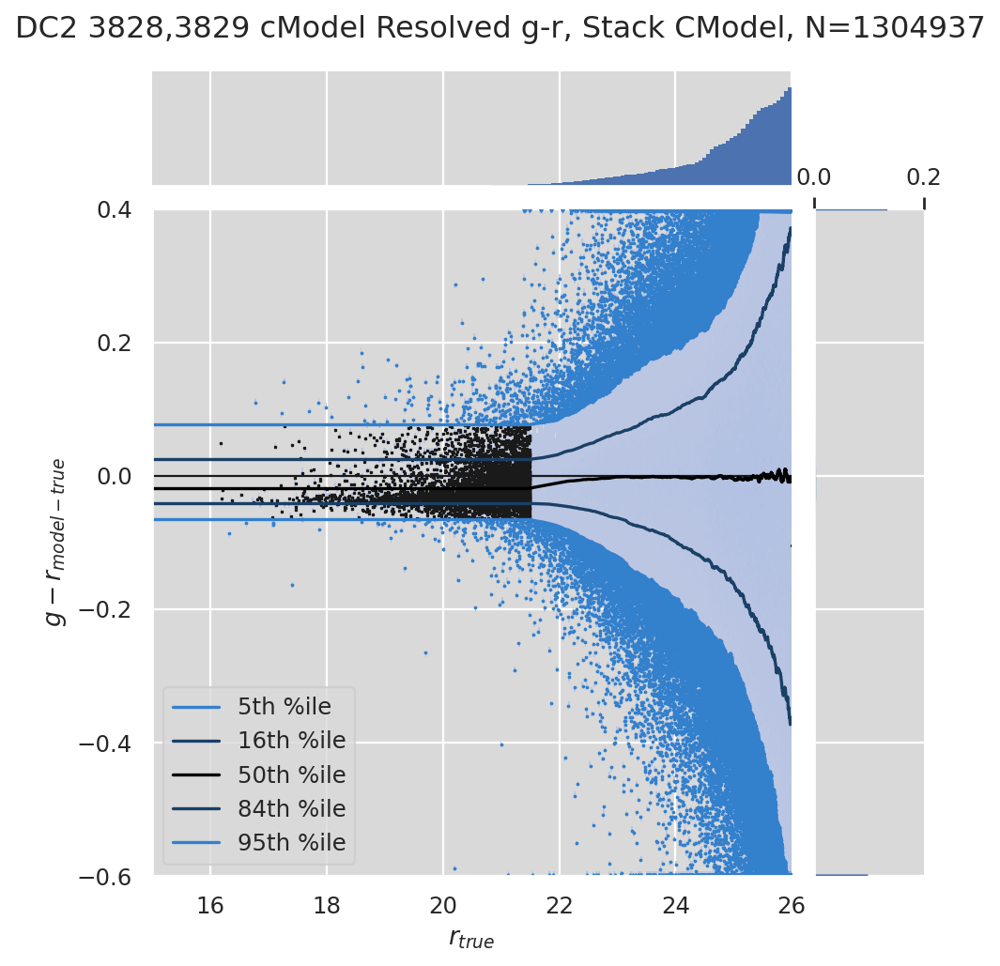

Plotting color chis: DC2 3828,3829 cModel Resolved g-r, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


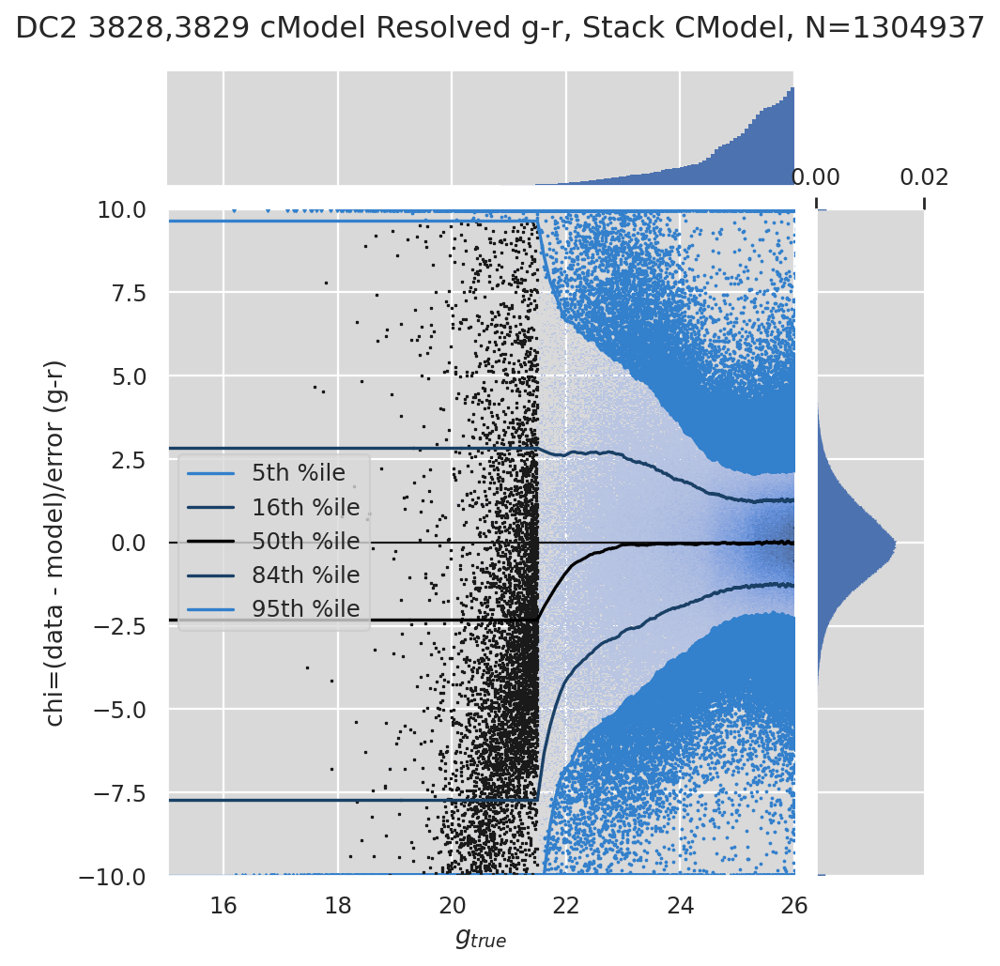

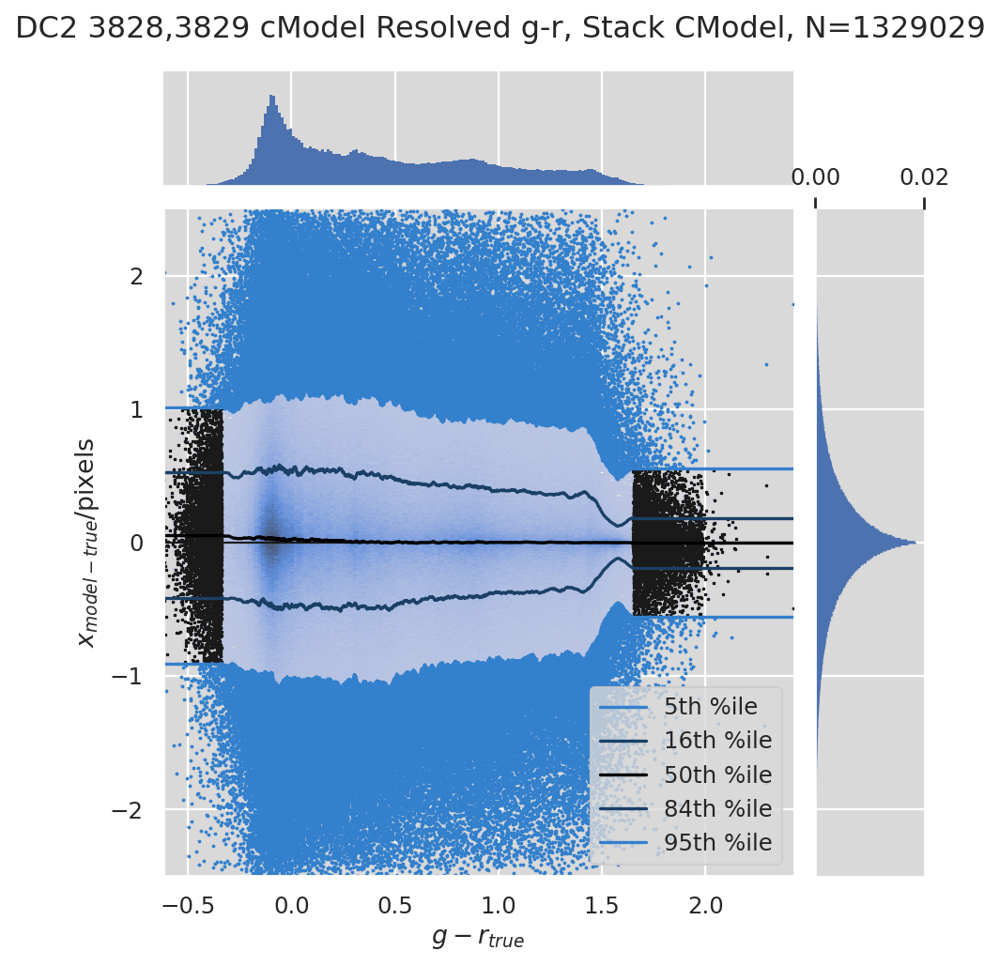

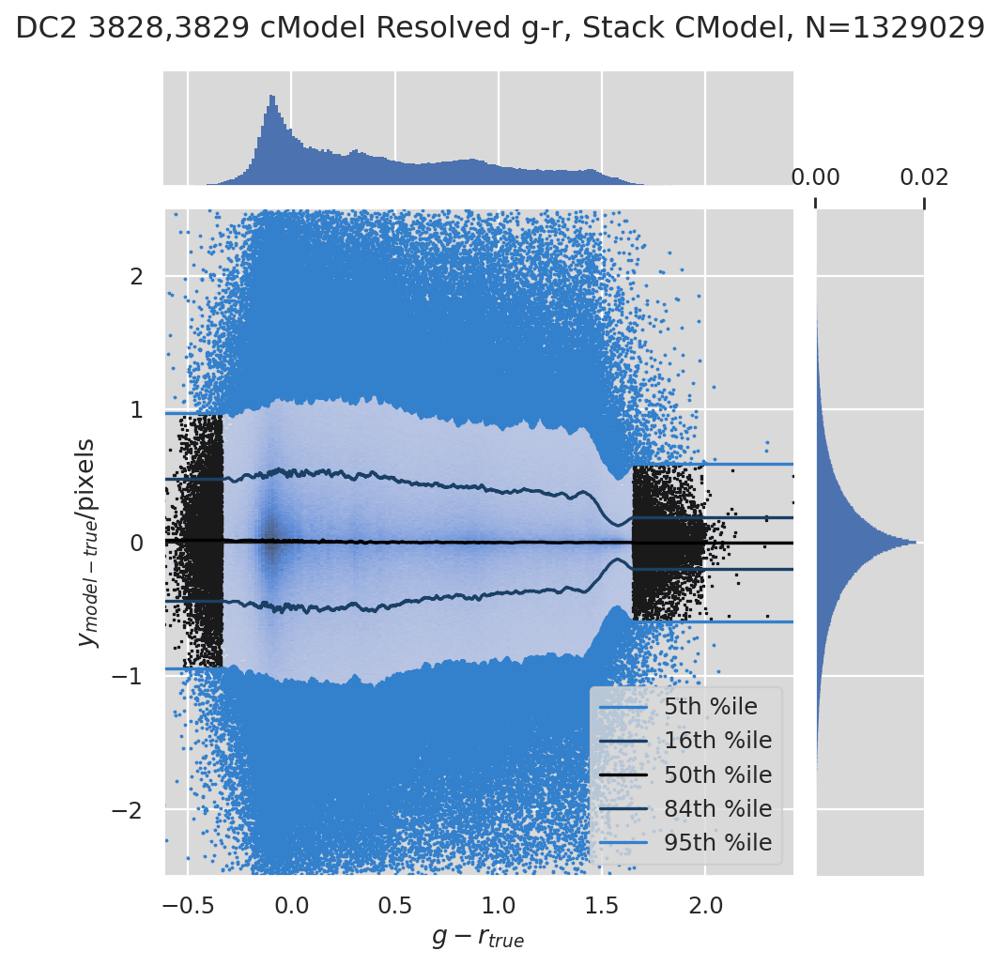

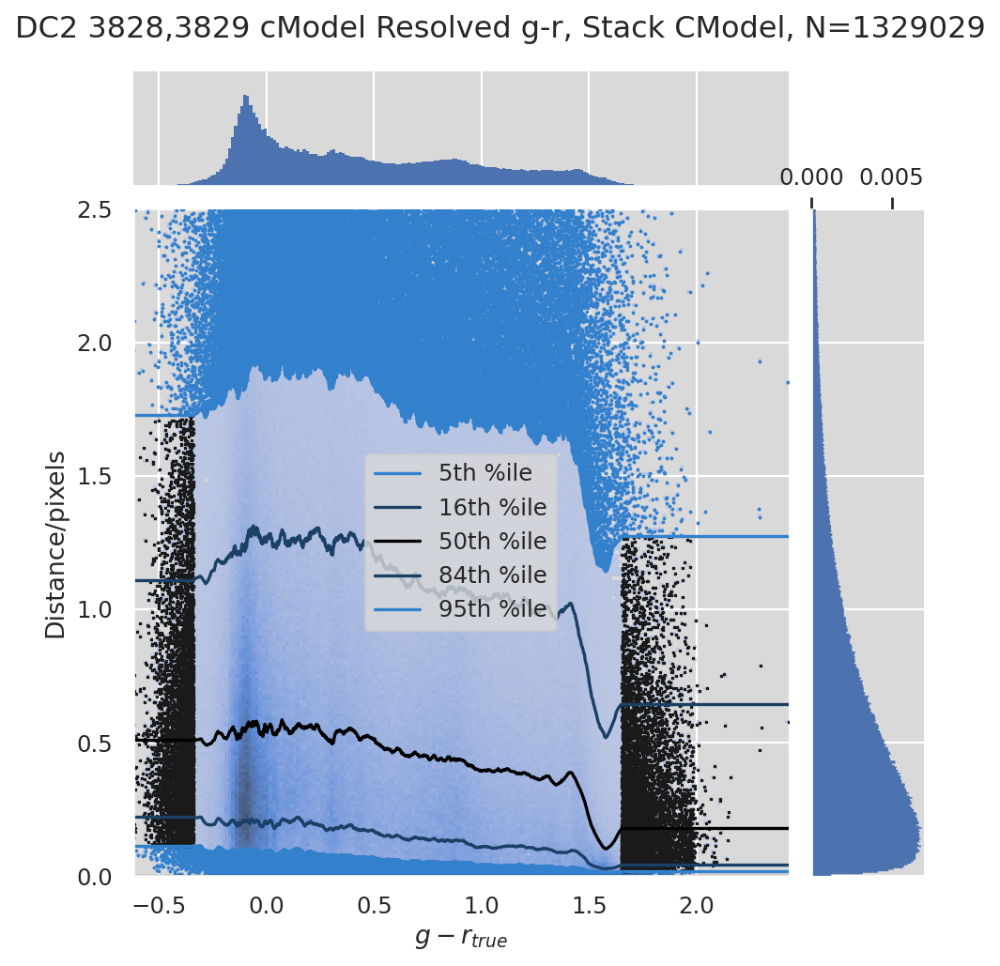

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


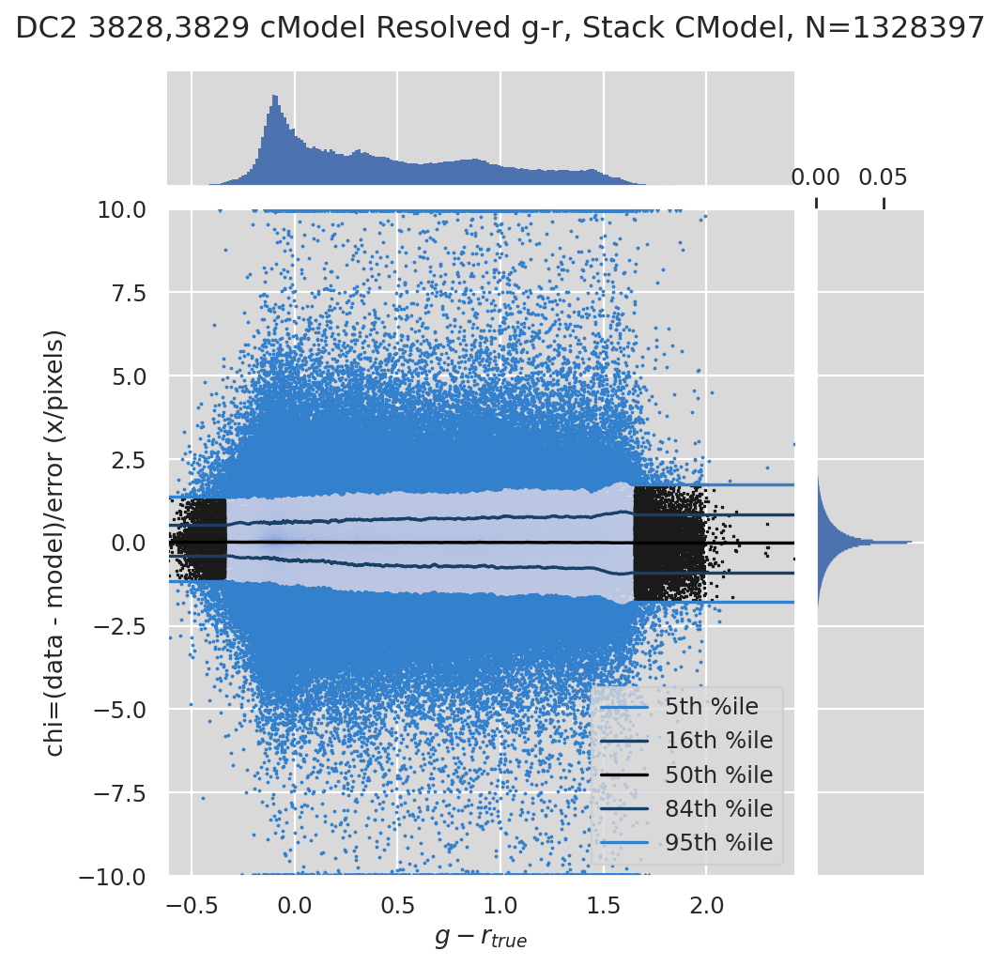

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


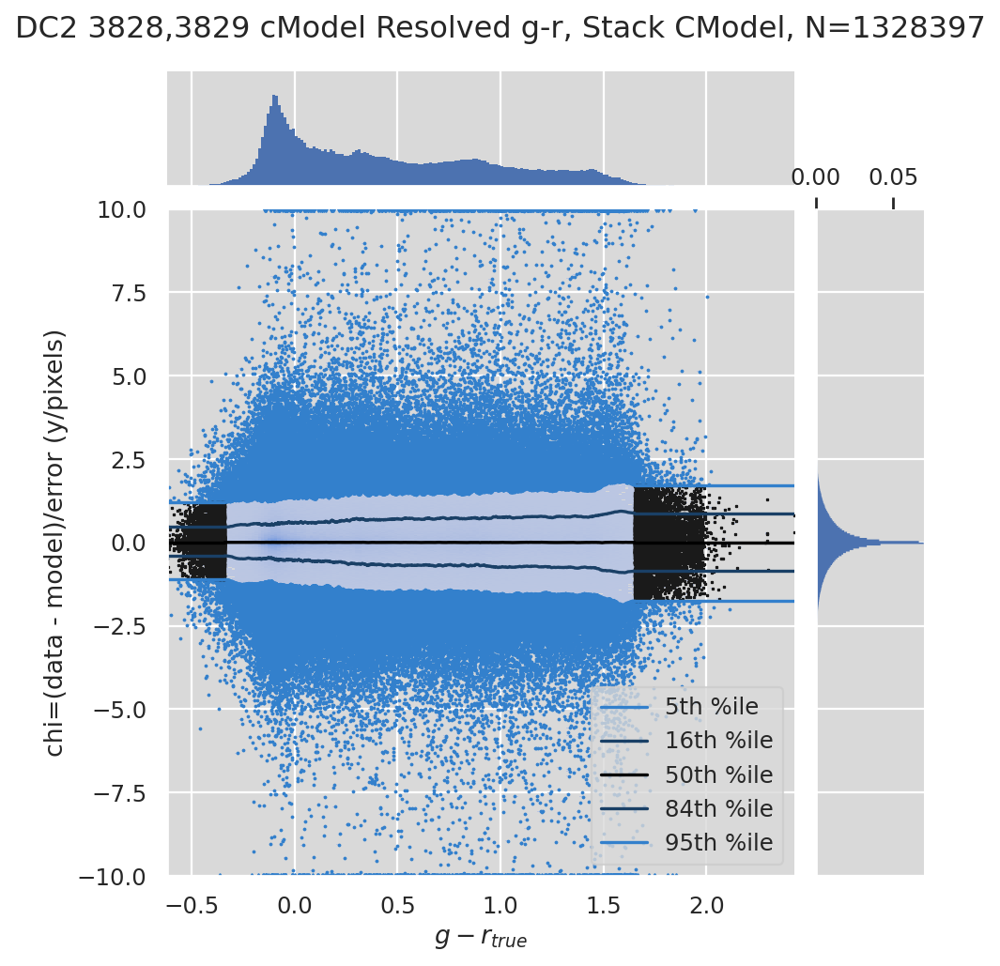

Plotting color diffs: DC2 3828,3829 cModel Resolved r-i, Stack CModel


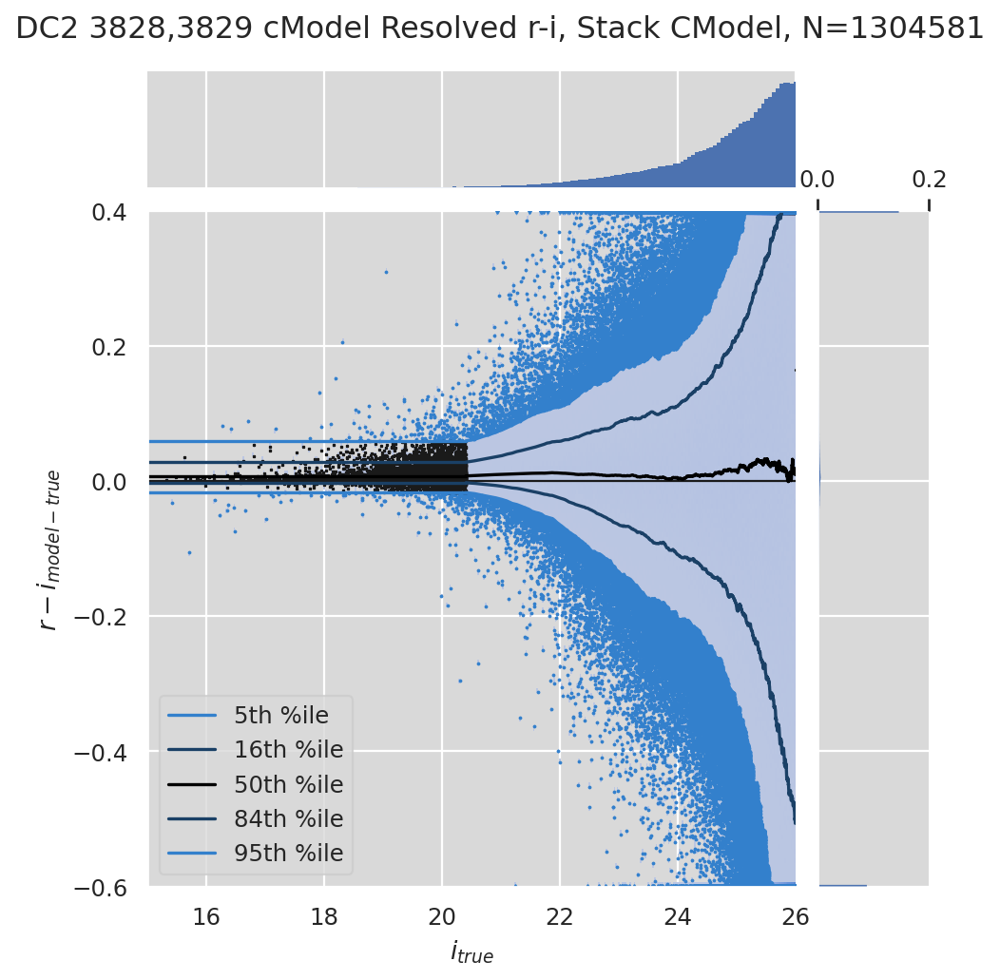

Plotting color chis: DC2 3828,3829 cModel Resolved r-i, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


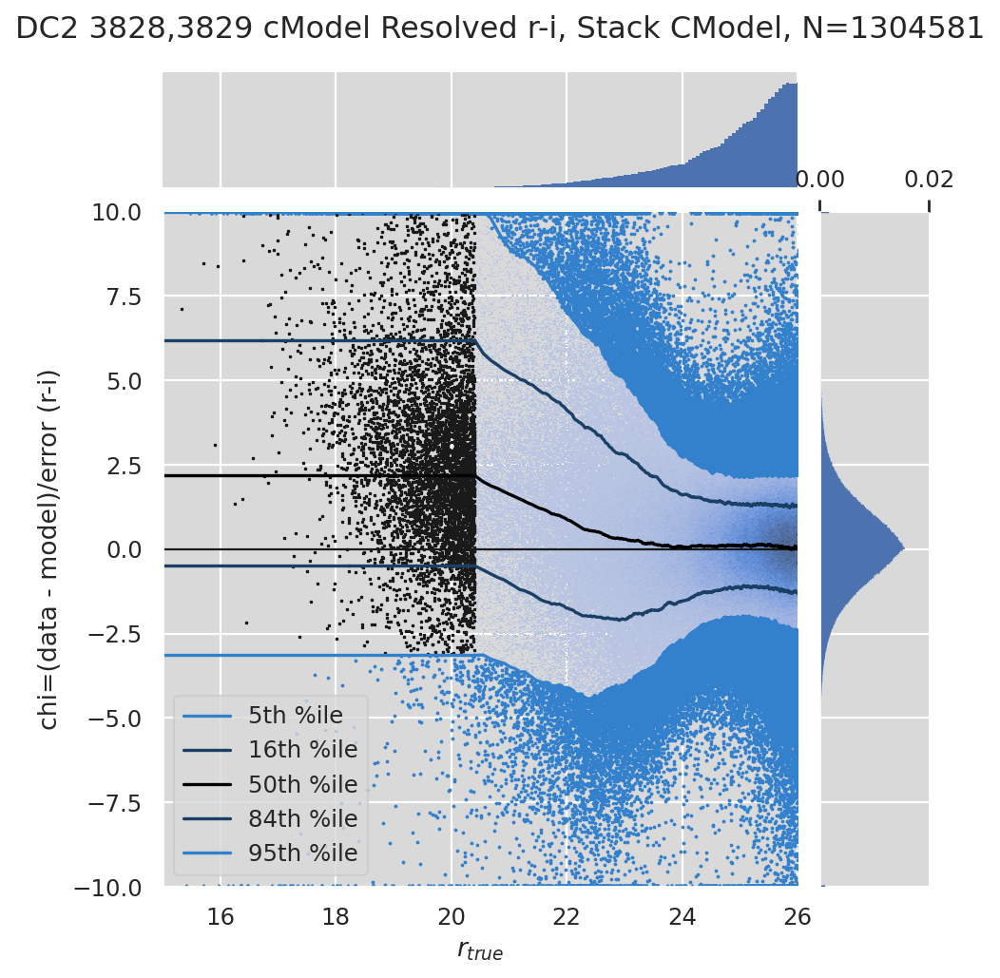

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


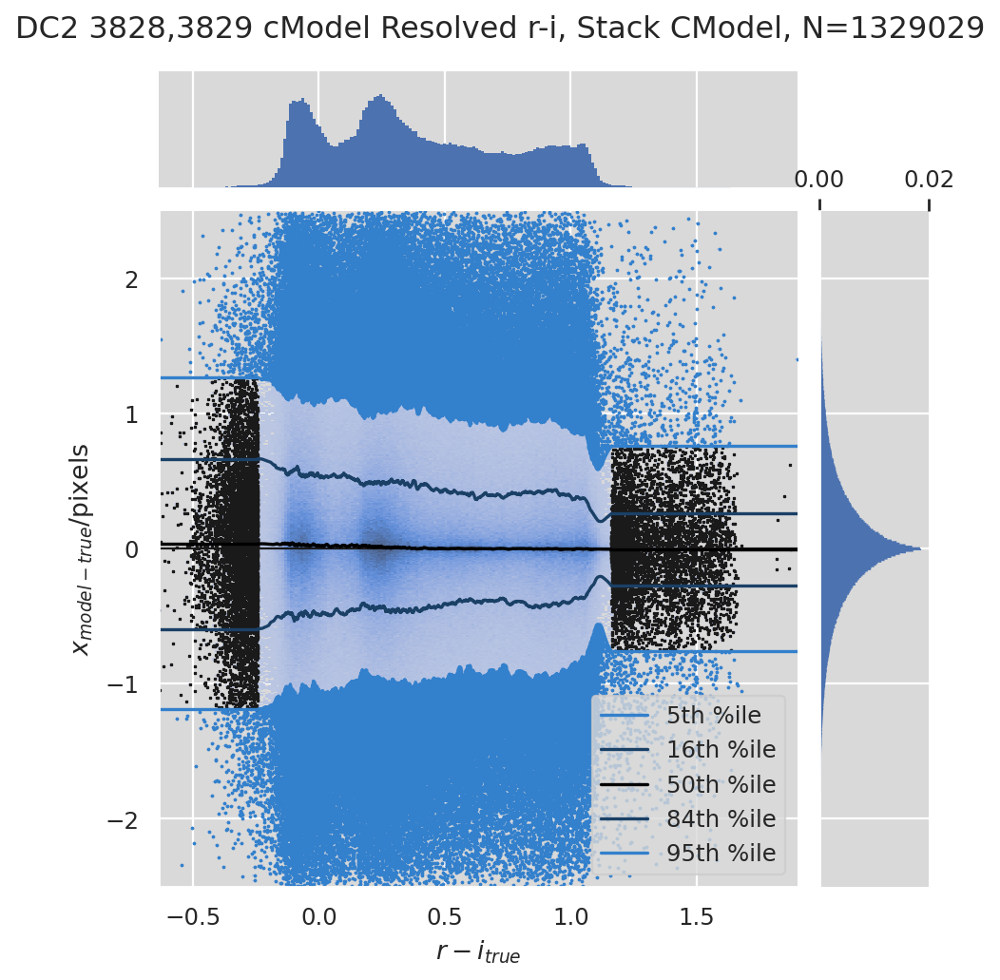

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


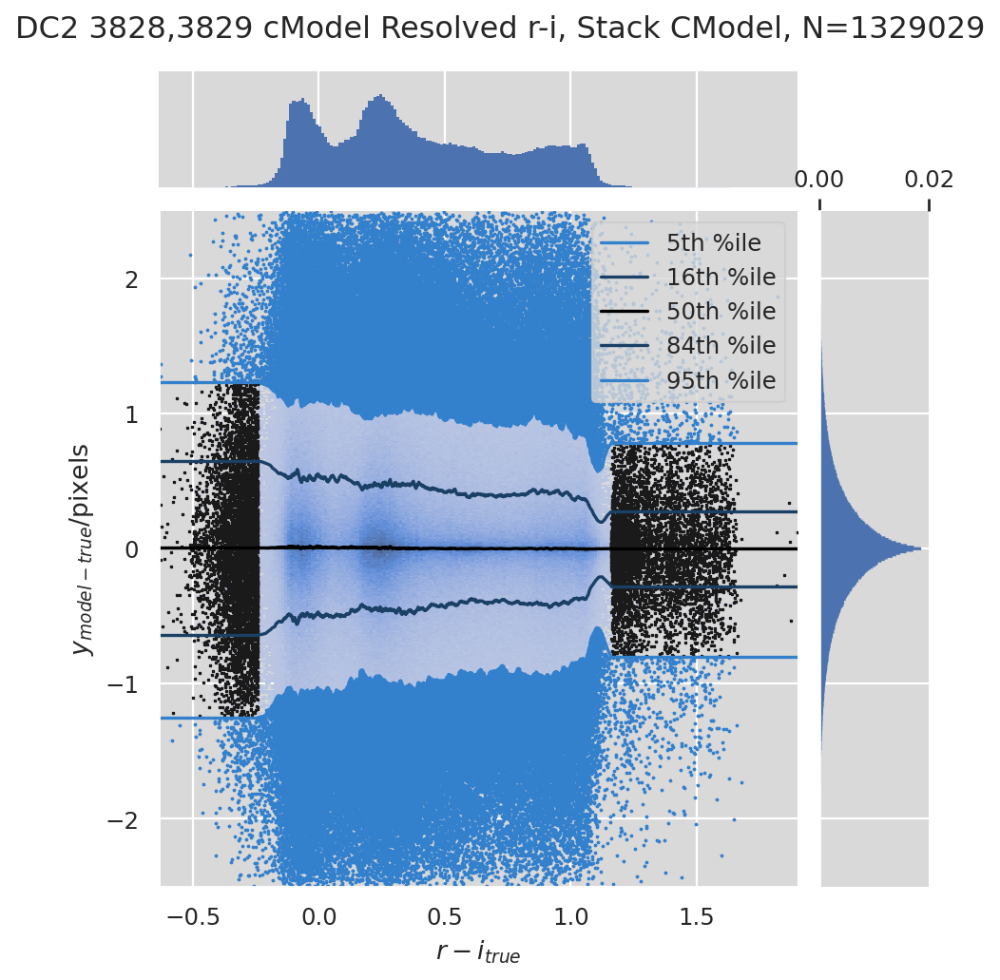

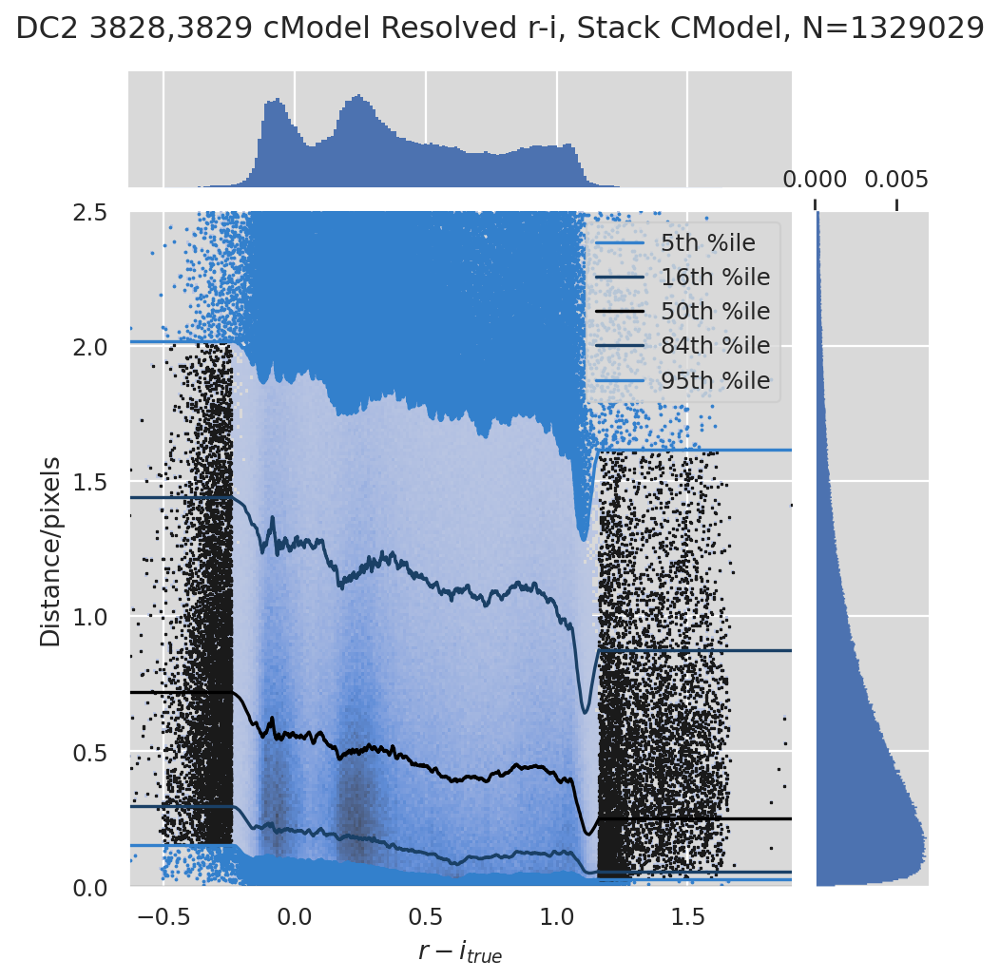

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


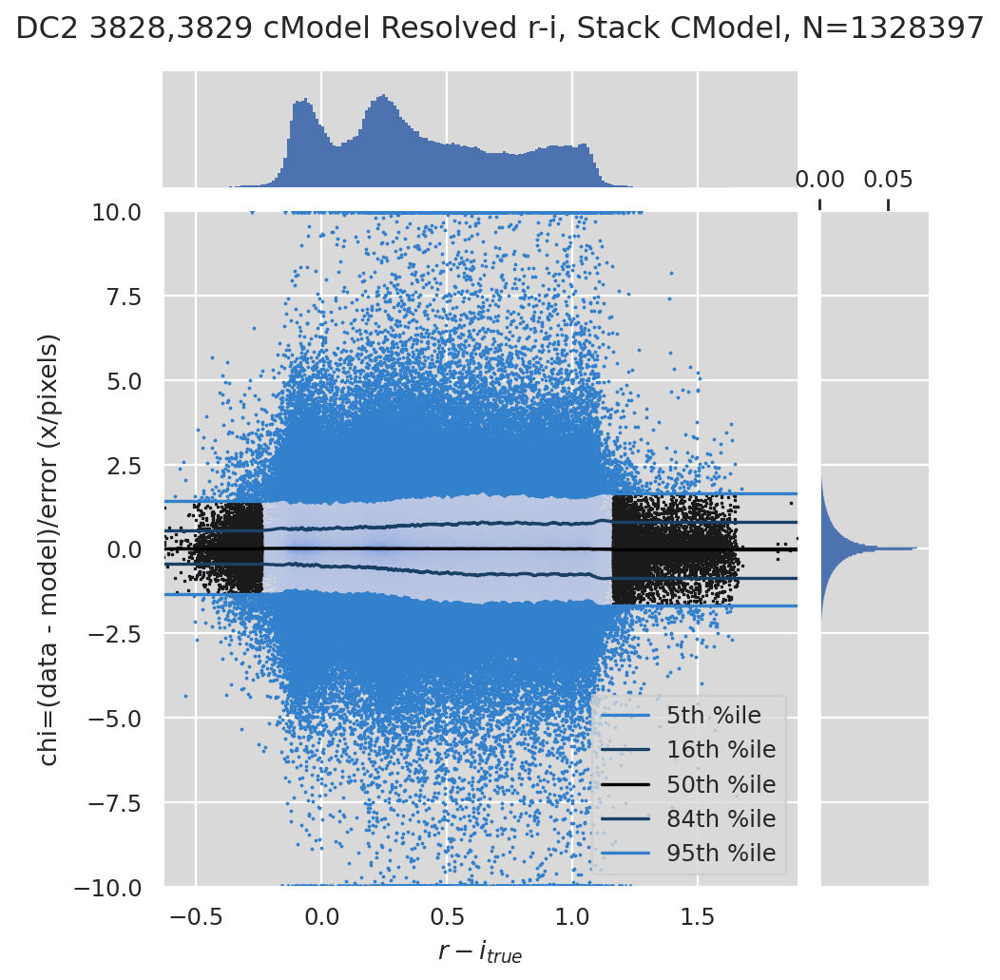

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


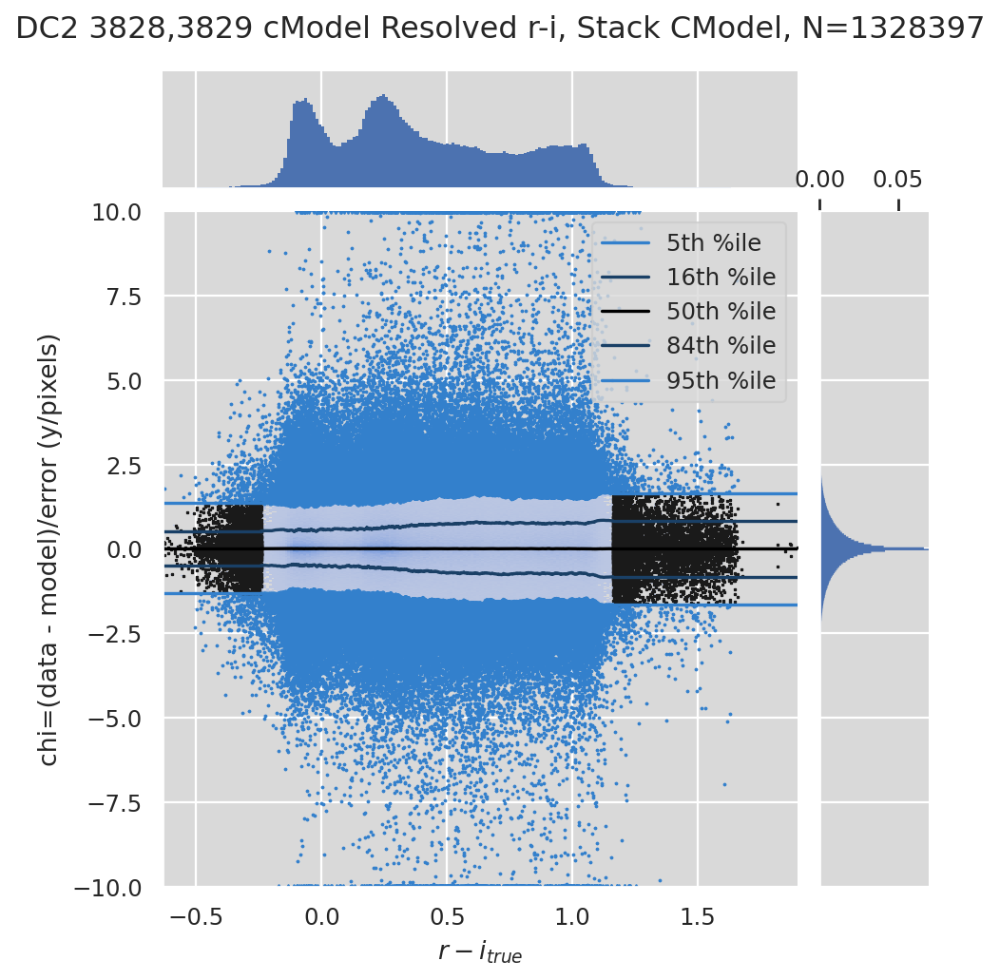

/home/dtaranu/src/mine/modelling_research/plot_matches.py:447: RuntimeWarning: invalid value encountered in subtract
  y = mags_band[b1][1] - mags_band[b2][1]


Plotting color diffs: DC2 3828,3829 cModel Resolved i-z, Stack CModel


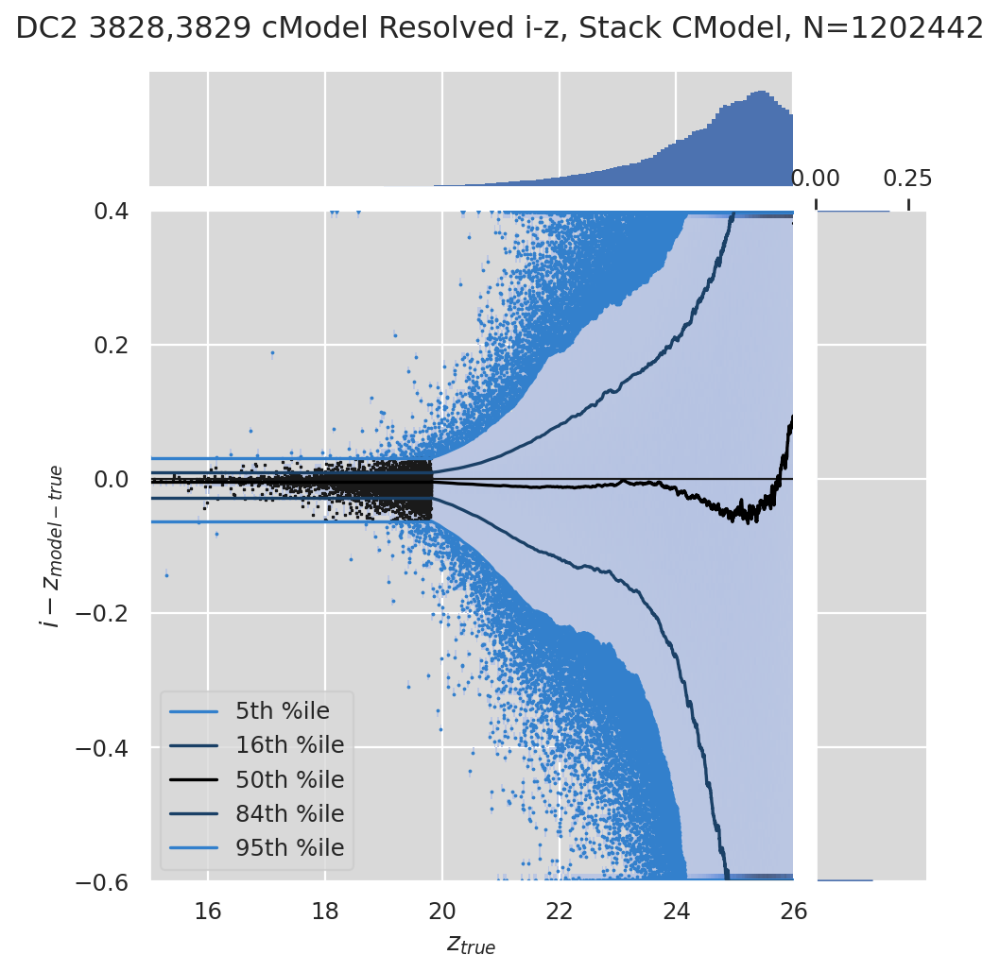

Plotting color chis: DC2 3828,3829 cModel Resolved i-z, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


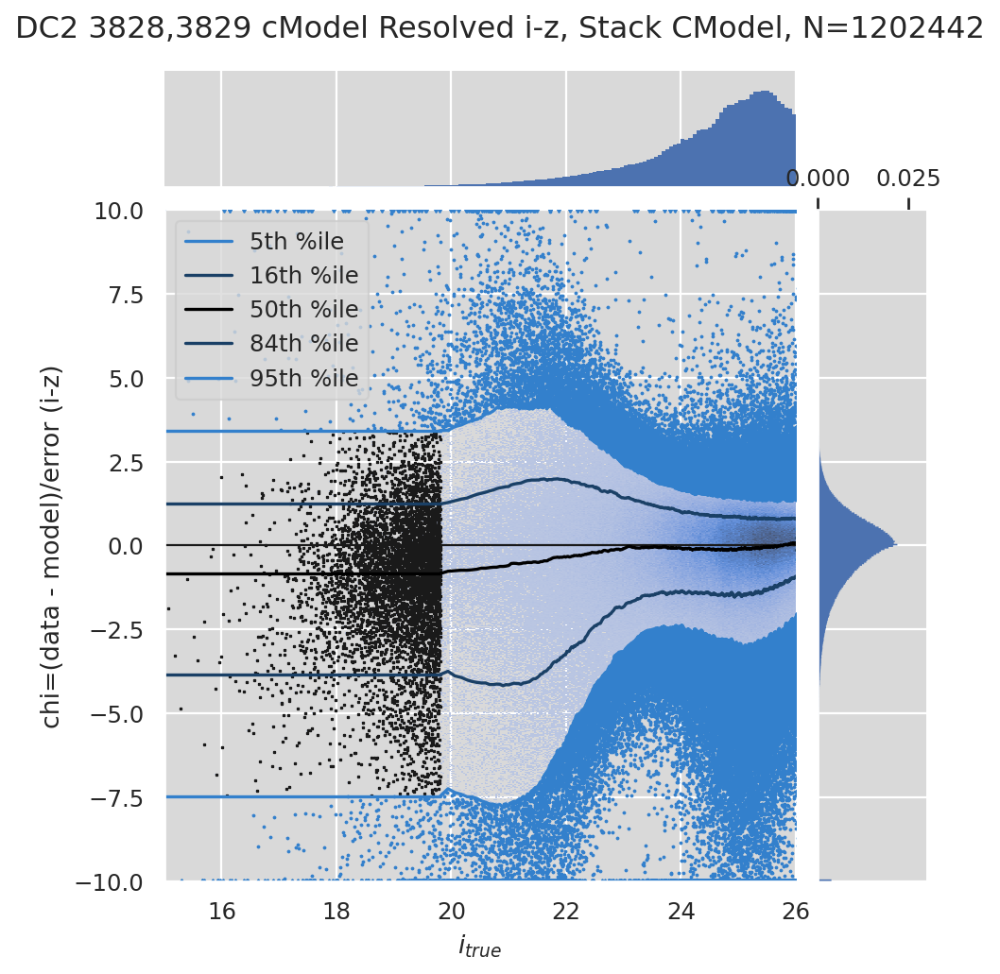

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


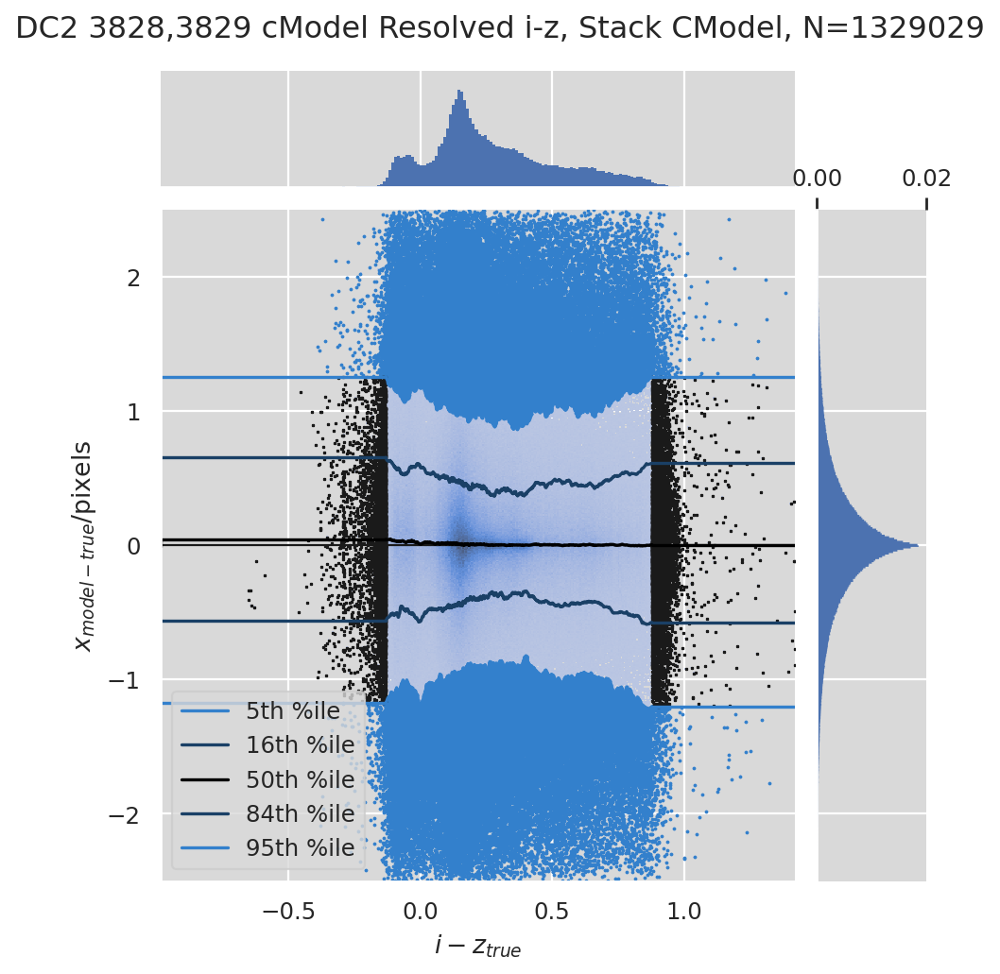

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


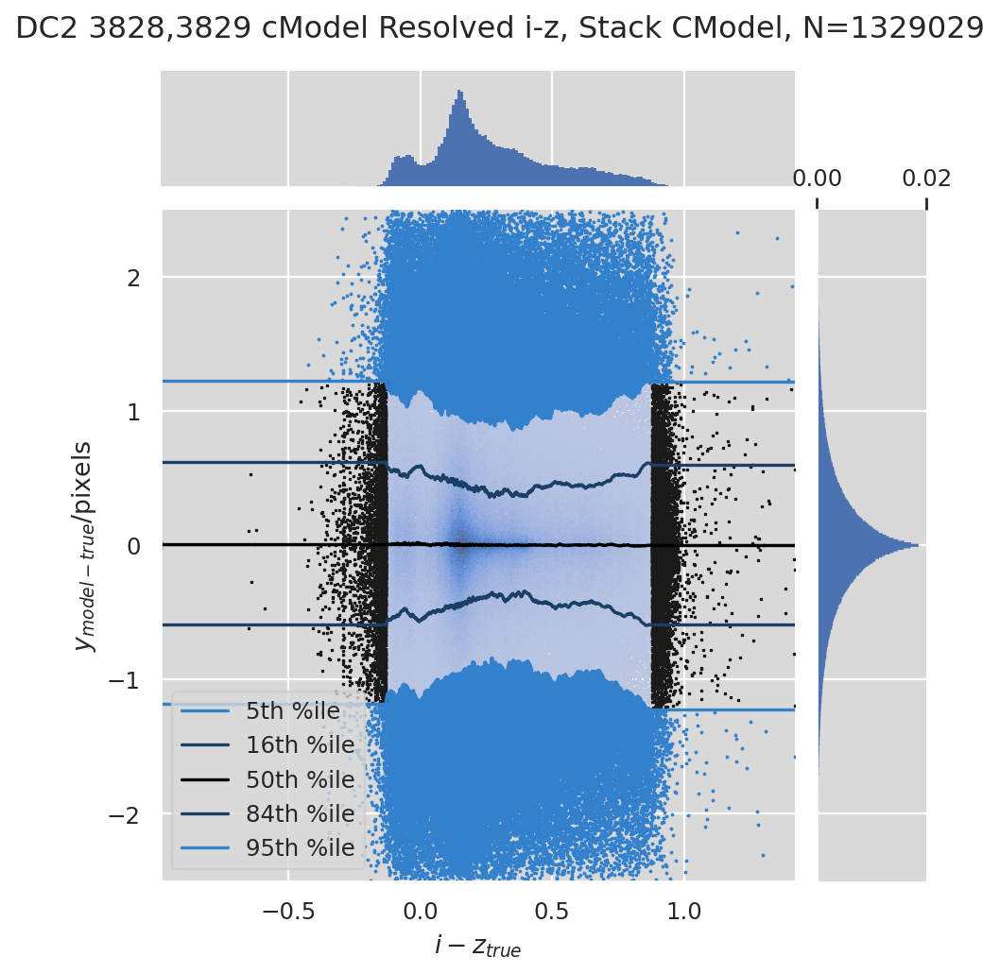

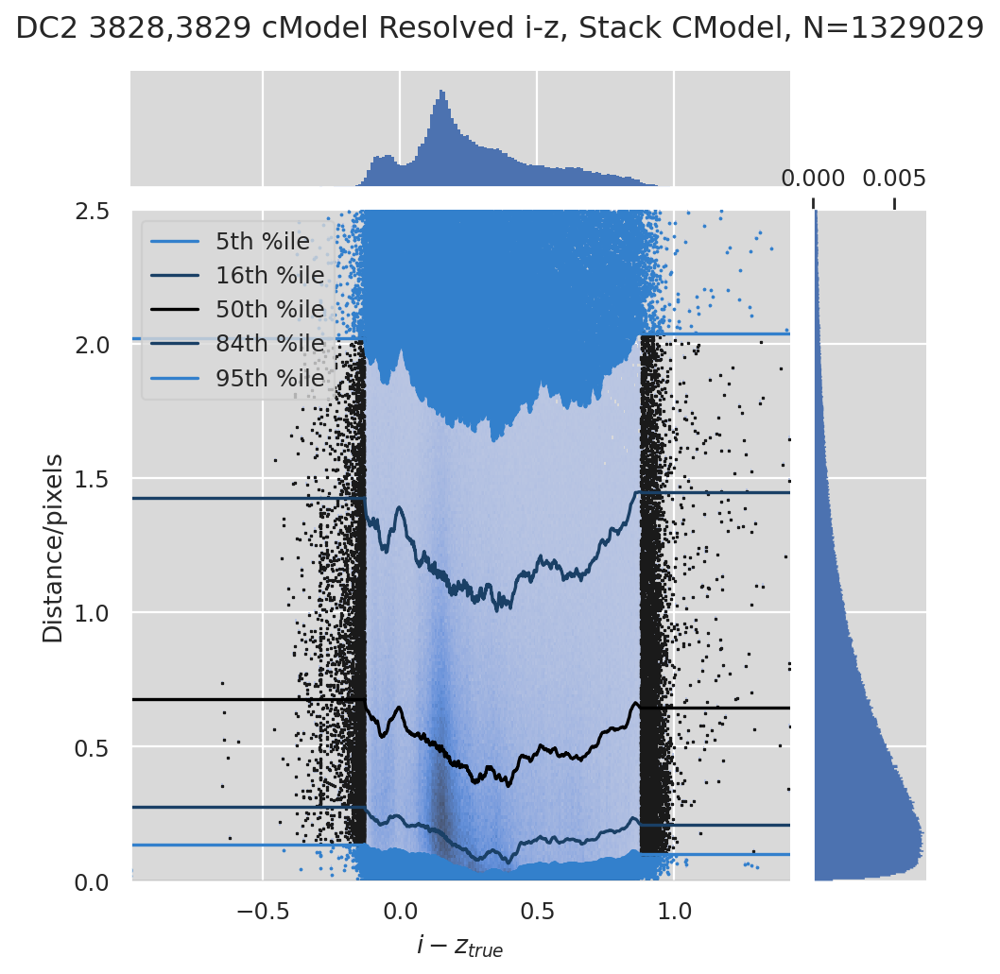

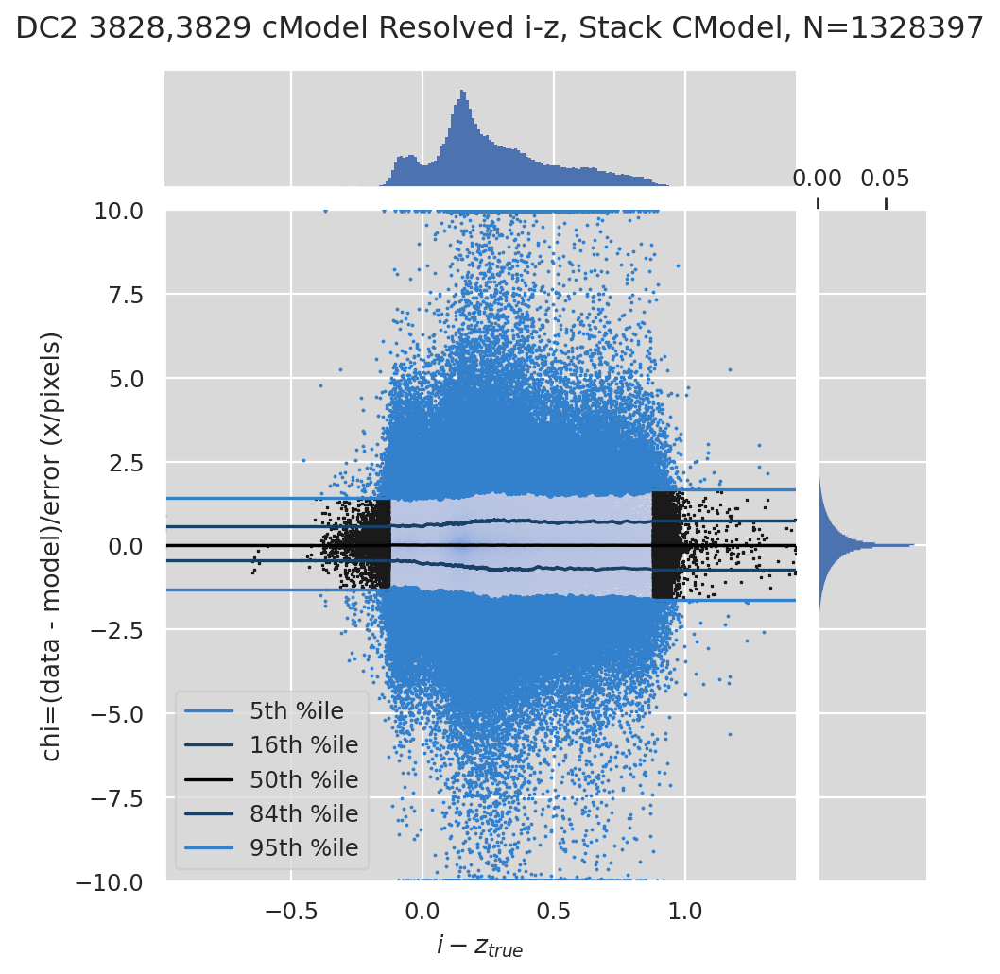

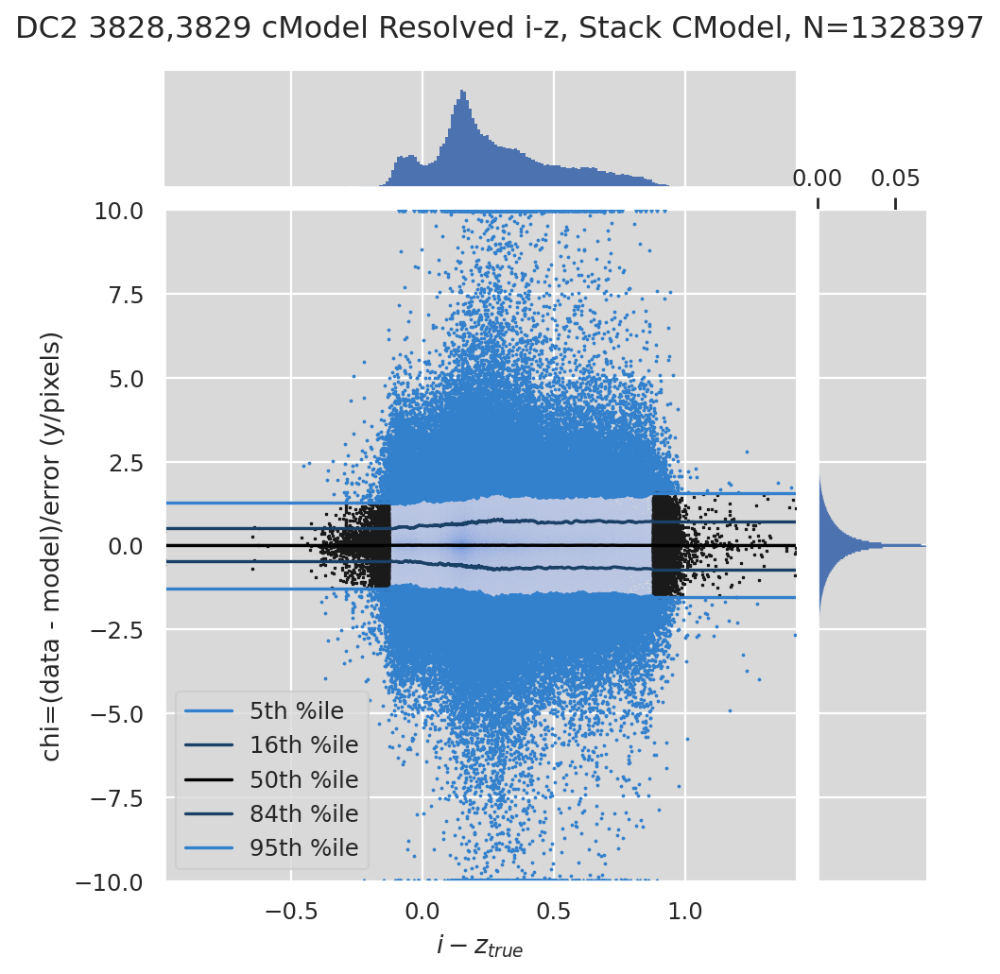

/home/dtaranu/src/mine/modelling_research/plot_matches.py:447: RuntimeWarning: invalid value encountered in subtract
  y = mags_band[b1][1] - mags_band[b2][1]


Plotting color diffs: DC2 3828,3829 cModel Resolved z-y, Stack CModel


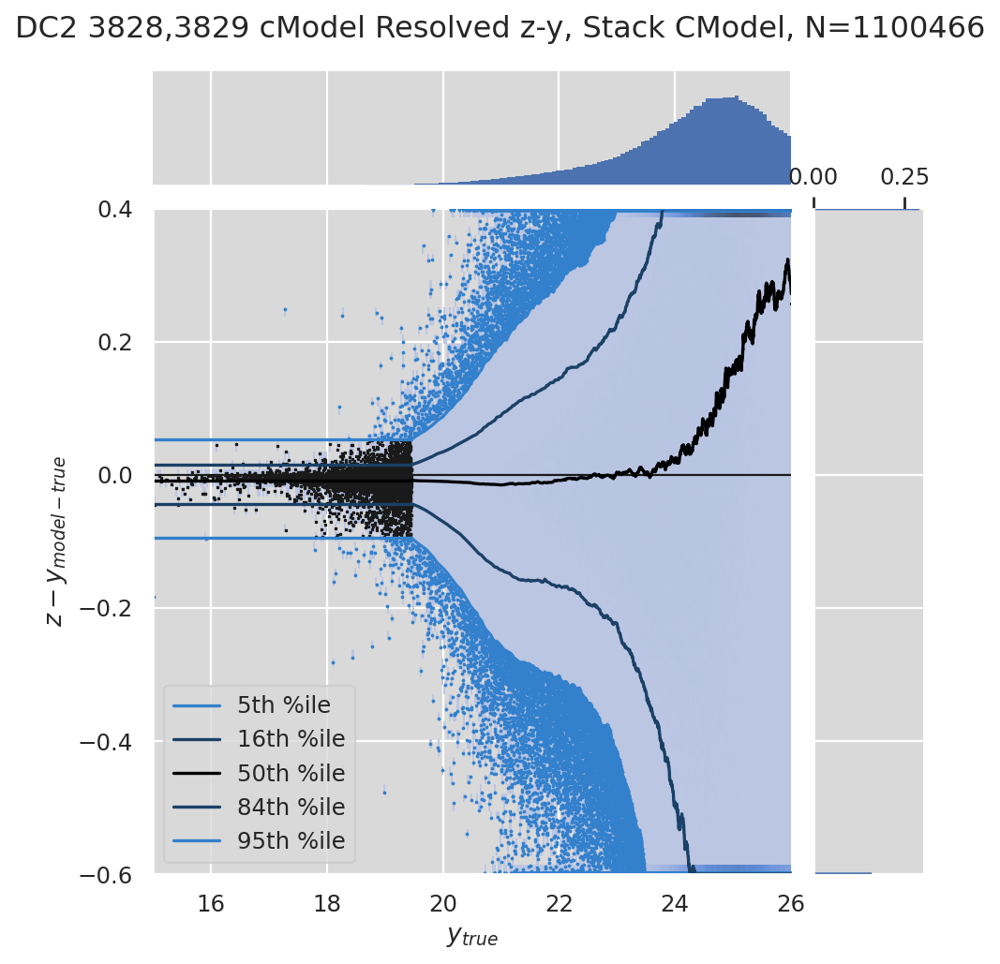

/home/dtaranu/src/mine/modelling_research/plot_matches.py:460: RuntimeWarning: divide by zero encountered in true_divide
  chi = y/sigma


Plotting color chis: DC2 3828,3829 cModel Resolved z-y, Stack CModel


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


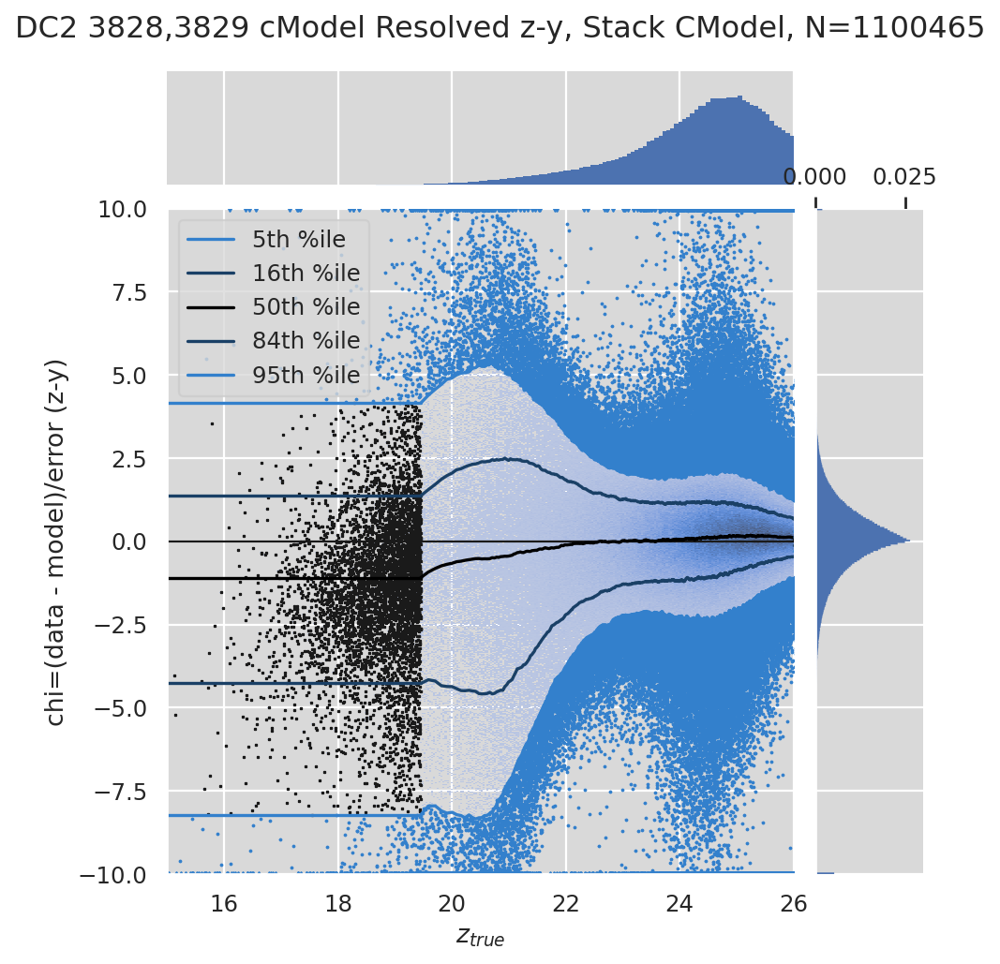

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


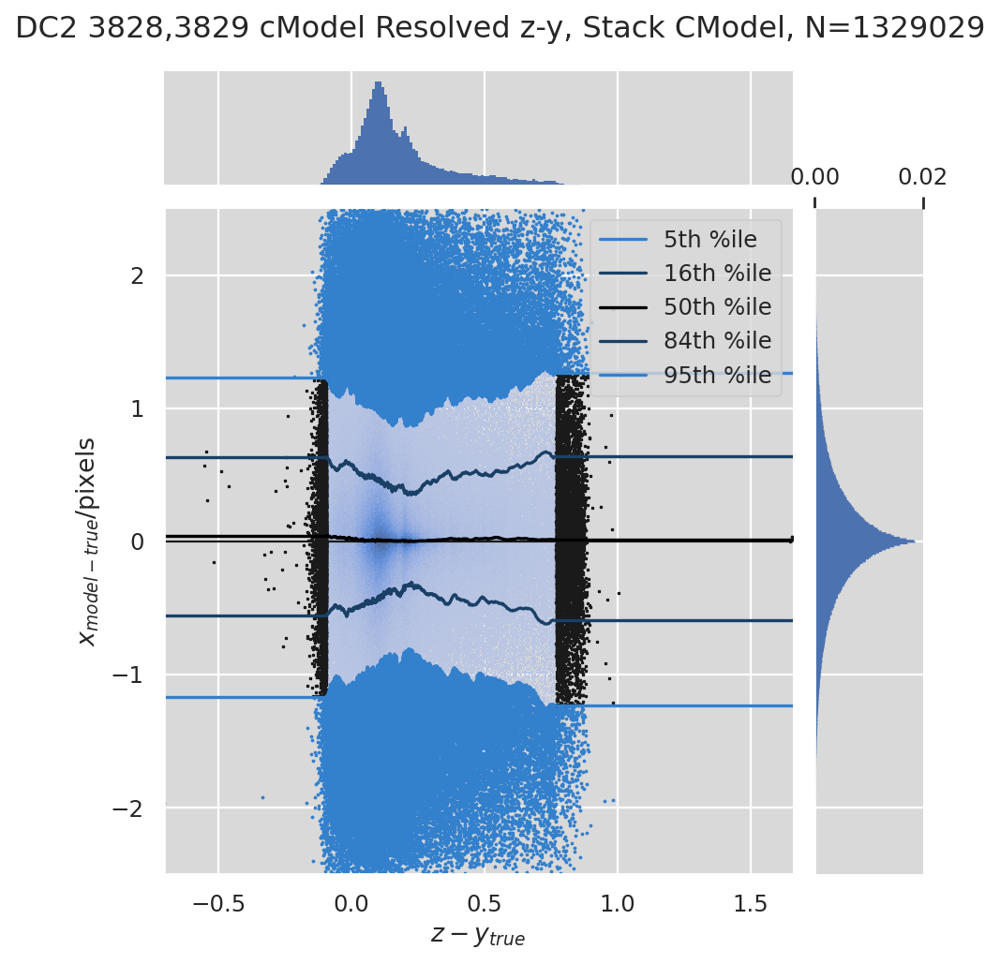

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


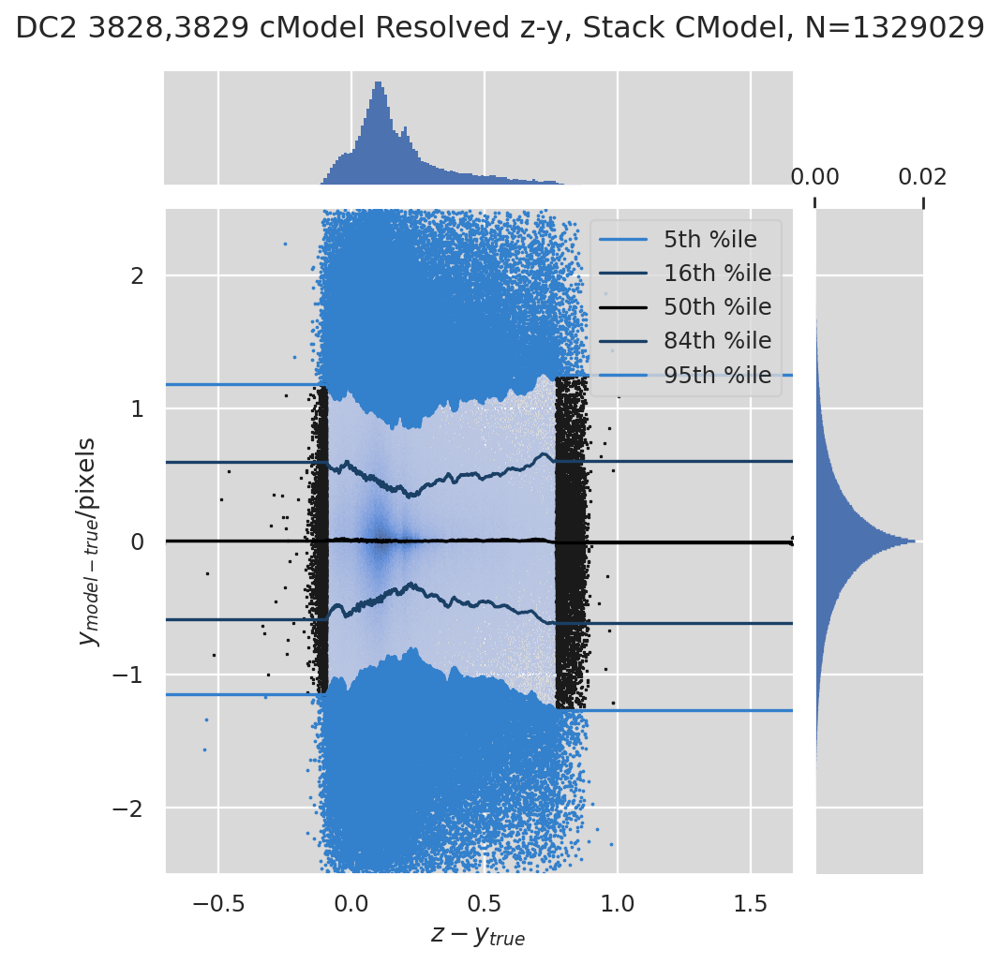

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


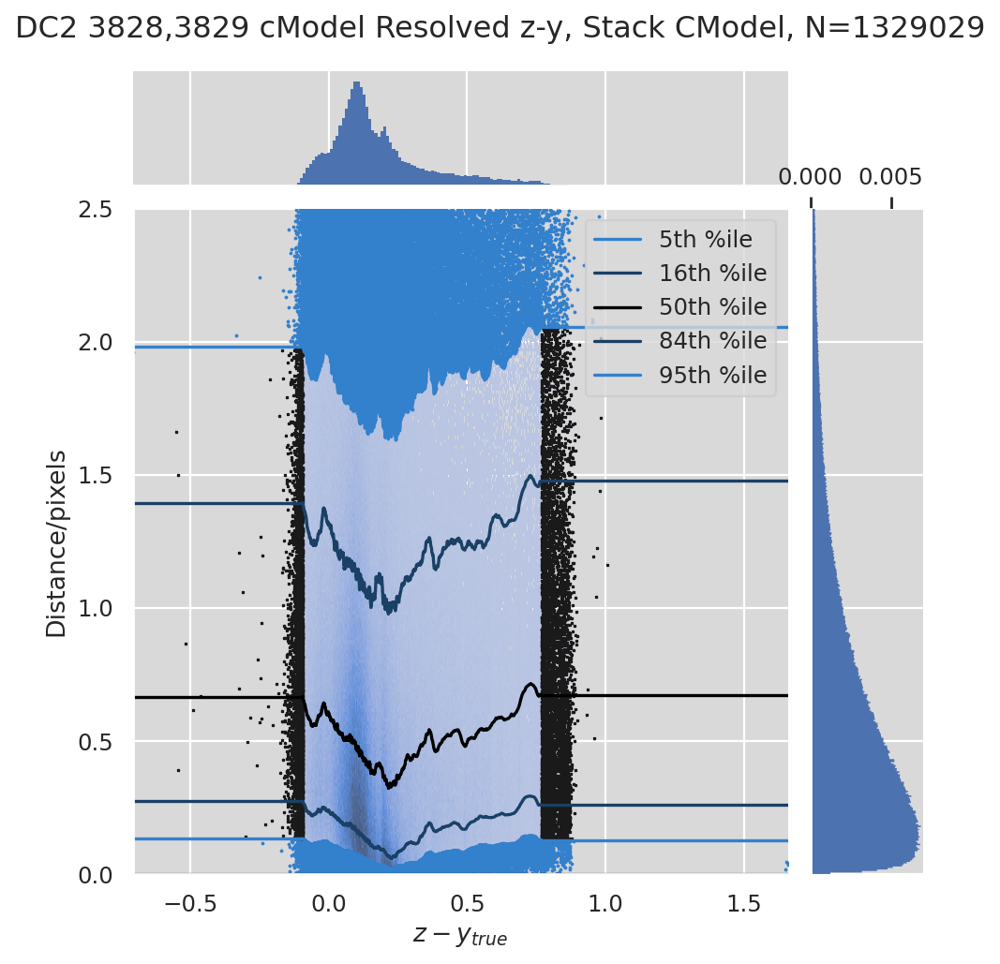

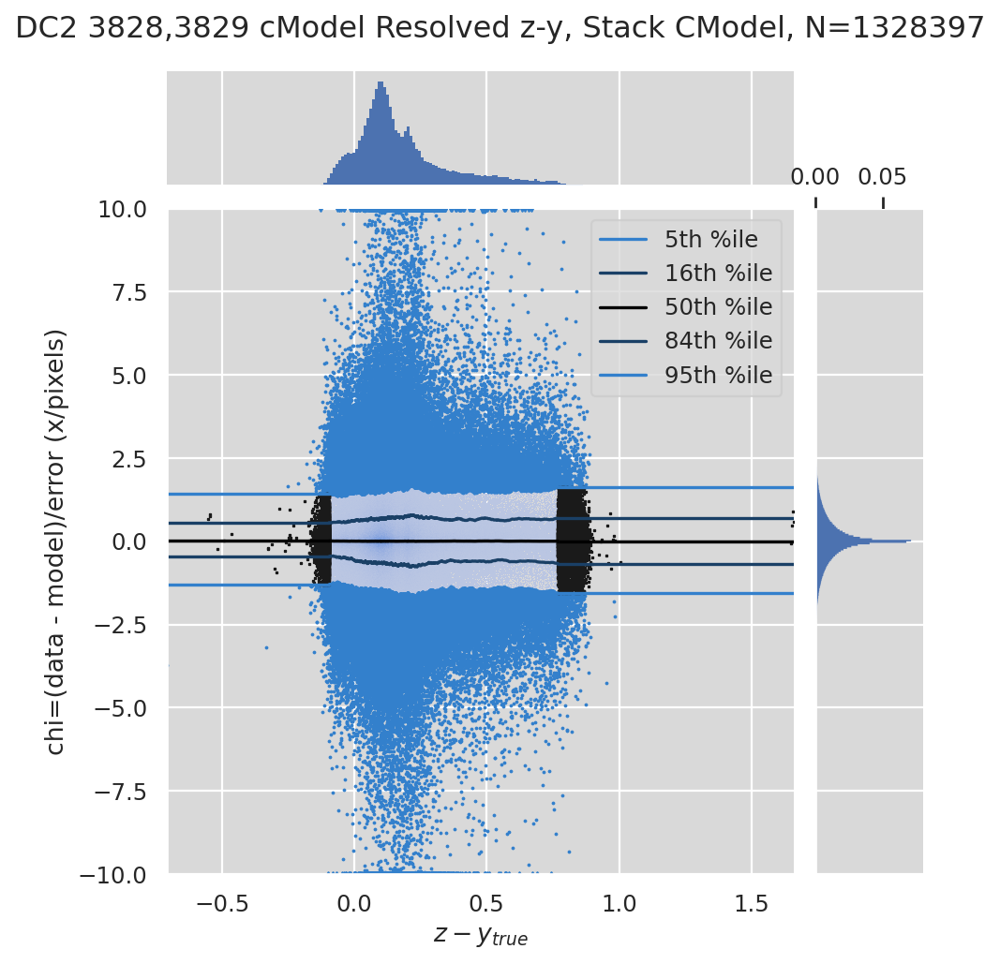

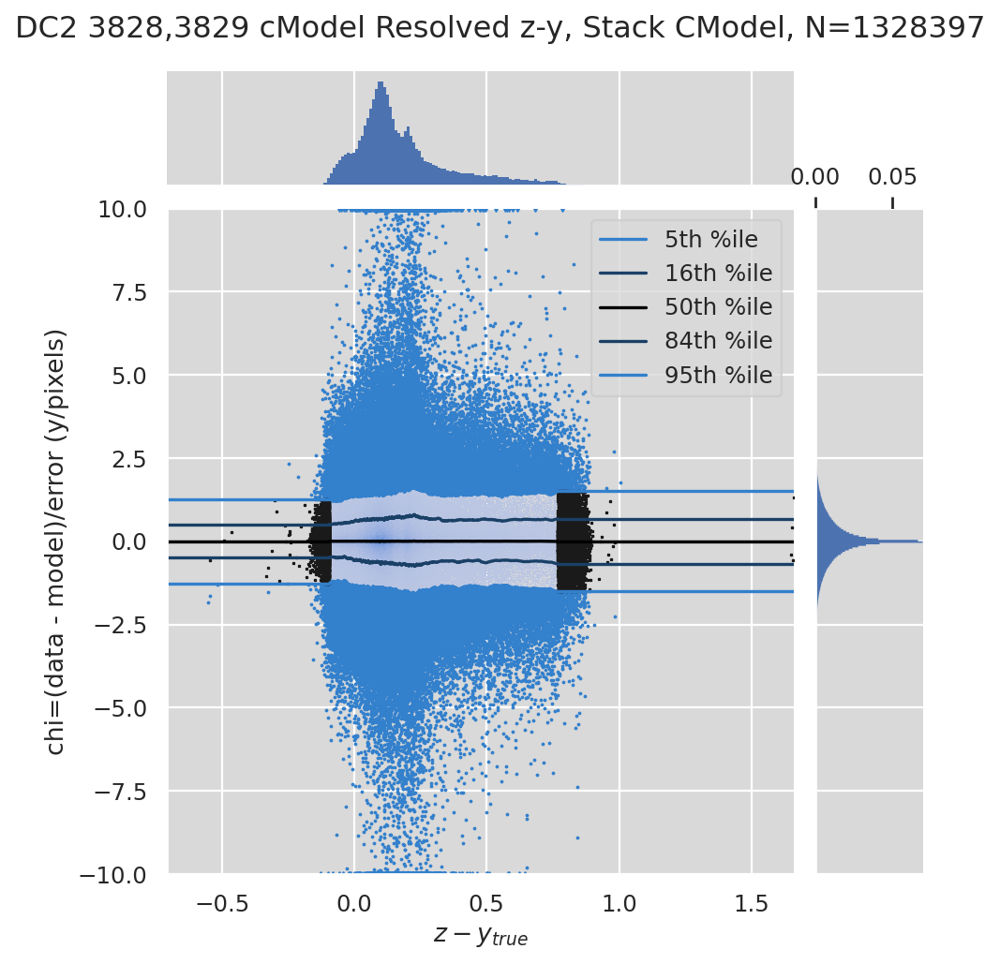

In [8]:
# Plot matches nicely
models = {
    desc: mrMeas.Model(
        desc, field, n_comps,
        column_flux='Flux',
        column_separator='',
        column_band_prefixed=True,
        prefix_centroid_default='',
    )
    for desc, field, n_comps in [
        ('PSF', 'psf', 1),
        ('Stack CModel', 'cModel', 2),
    ]
}

select_target = ~cat_target_all['merge_peak_sky'].values & cat_target_all['detect_isPrimary'].values
select_ref = cat_ref_all['match_candidate']

kwargs = {
    'scatterleft': True,
    'scatterright': True,
    'fluxes_true': {band: cat_ref_all.loc[select_ref, f'flux_{band}'].values for band in bands},
    'centroids_ref': {'x': 'x', 'y': 'y'},
    'limx': (mag_plot_min, mag_tot_max - 1),
    'limits_y_chi': (-10., 10.),
    'limits_y_dist': (0., 2.5),
    'match_dist_asec': match_dist_max.asArcseconds(),
    'mag_bin_complete': 0.125,
    'mag_zeropoint_ref': mag_zeropoint,
    'mag_max': mag_plot_max,
    'models': models,
    'models_purity': ('PSF', 'Stack CModel'),
    'models_diff': ('Stack CModel',),
    'models_dist': ('Stack CModel',),
    'select_target': select_target,
    'title': f'DC2 {",".join(str(tract) for tract in tracts) } {model_target}',
    'compare_mags_psf_lim': (-2.45, 0.05),
    'kwargs_get_mag': {'zeropoint': mag_zeropoint},
}

lim_y = {
    "resolved": (-0.6, 0.4),
    "unresolved": (-0.1, 0.05),
}

_ = plot_matches(
    cat_ref_all[select_ref],
    cat_target_all,
    resolved=True,
    plot_chi=True,
    limits_y_diff=lim_y['resolved'],
    limits_y_color_diff=lim_y['resolved'],
    **kwargs
)

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


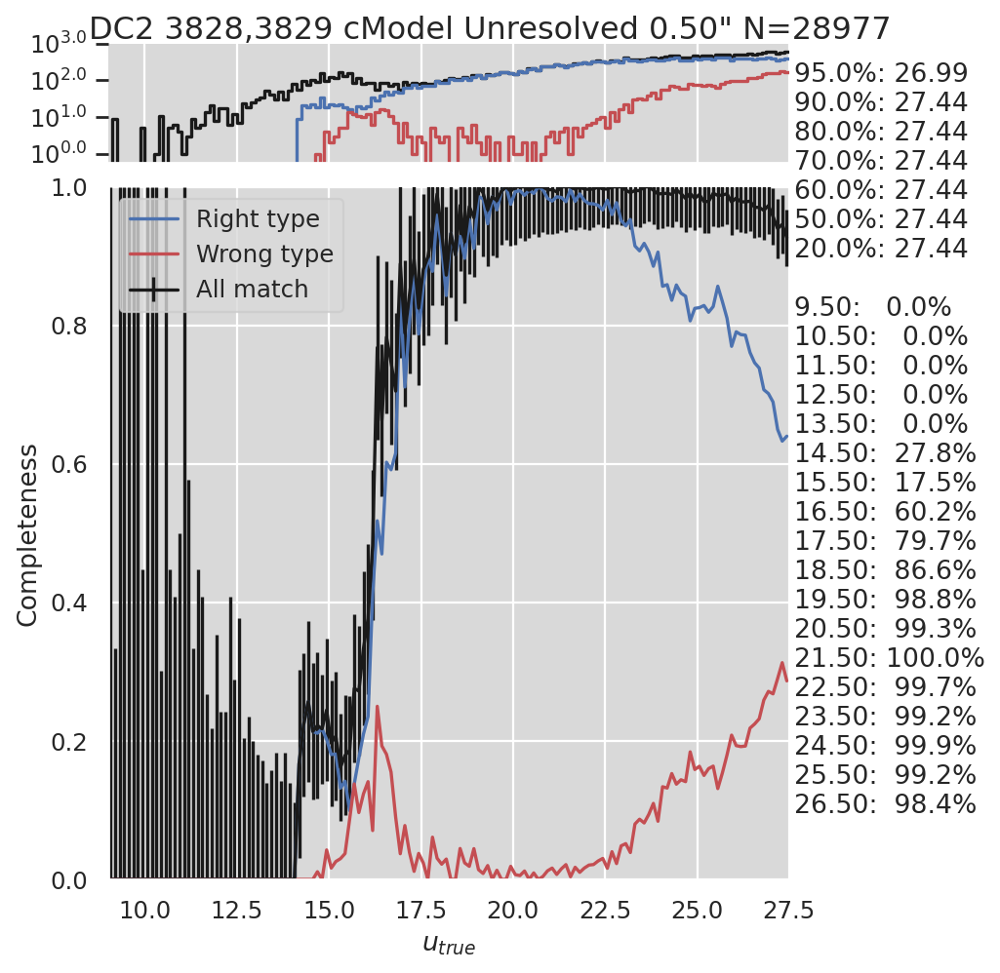

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


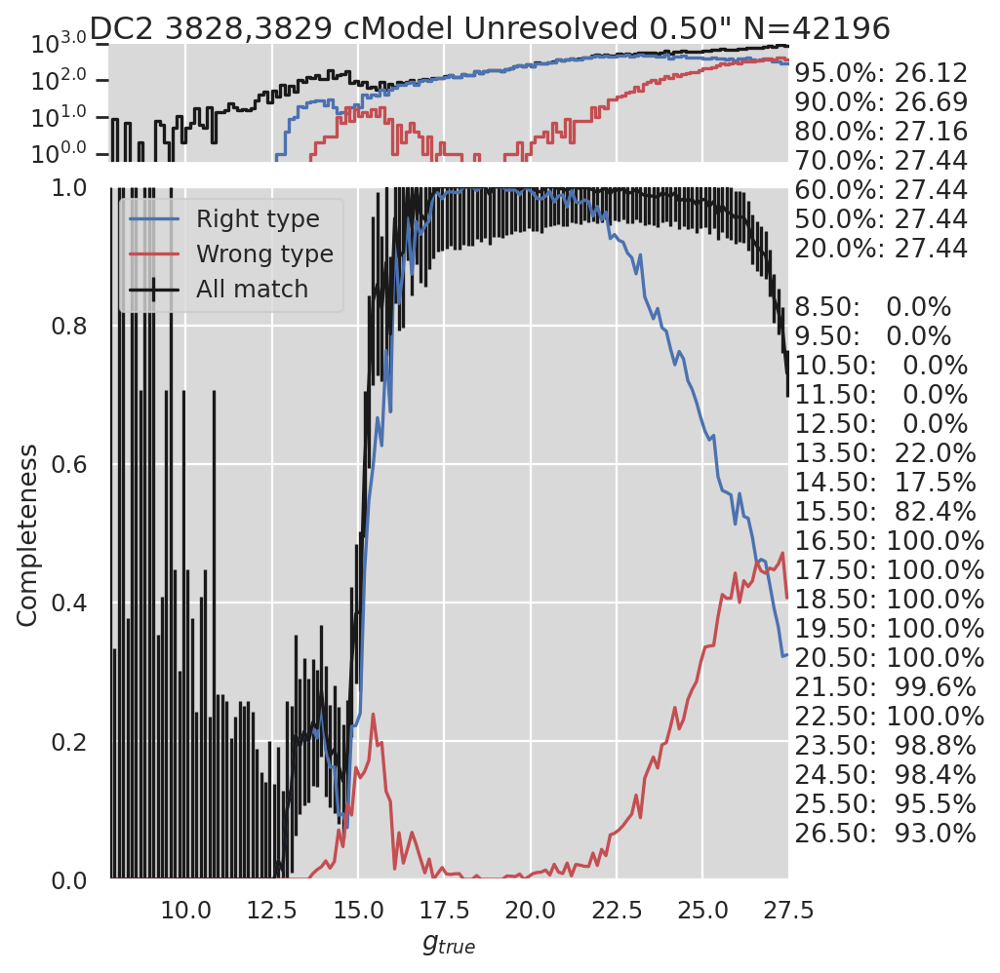

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


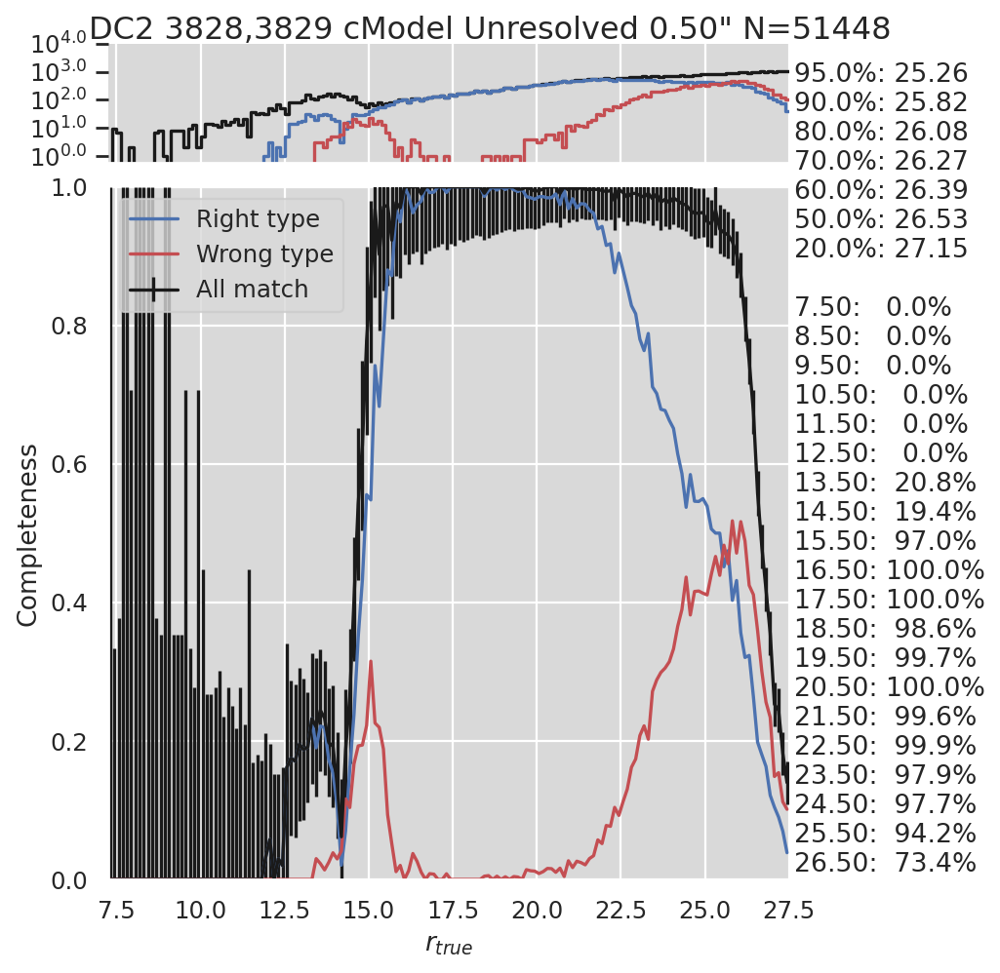

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


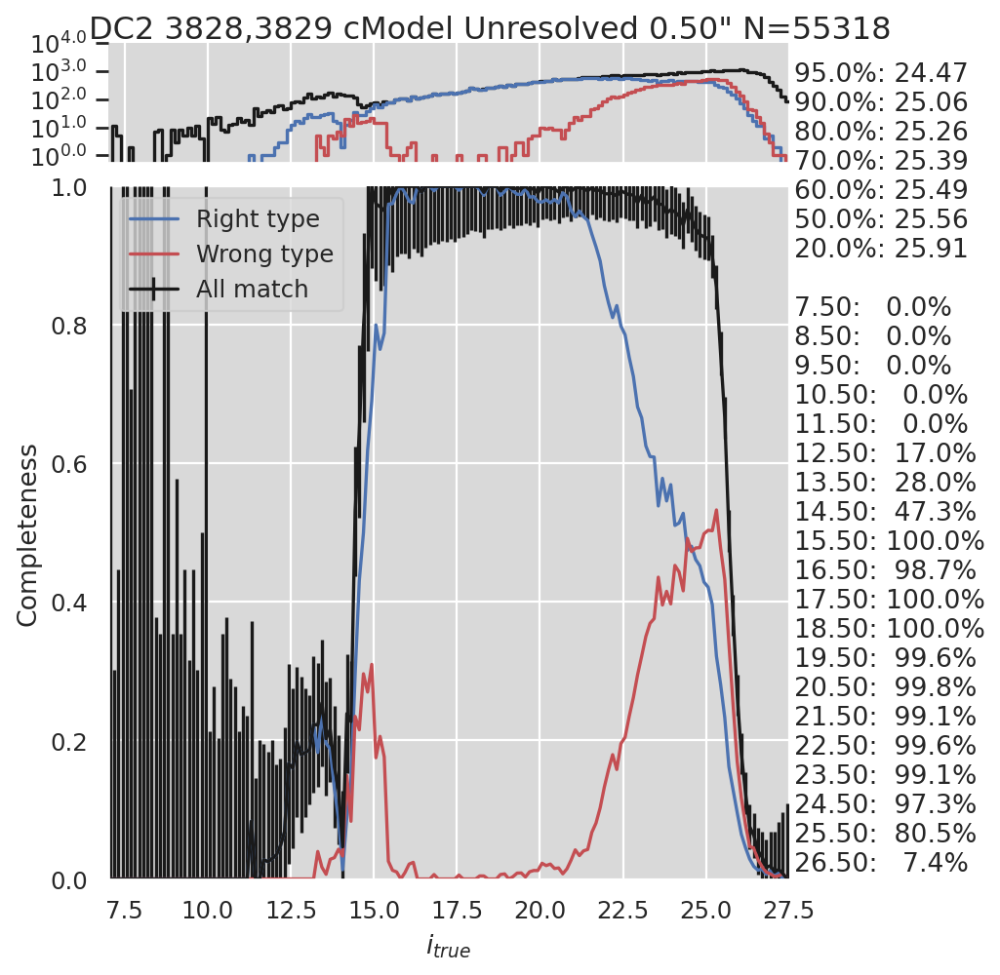

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


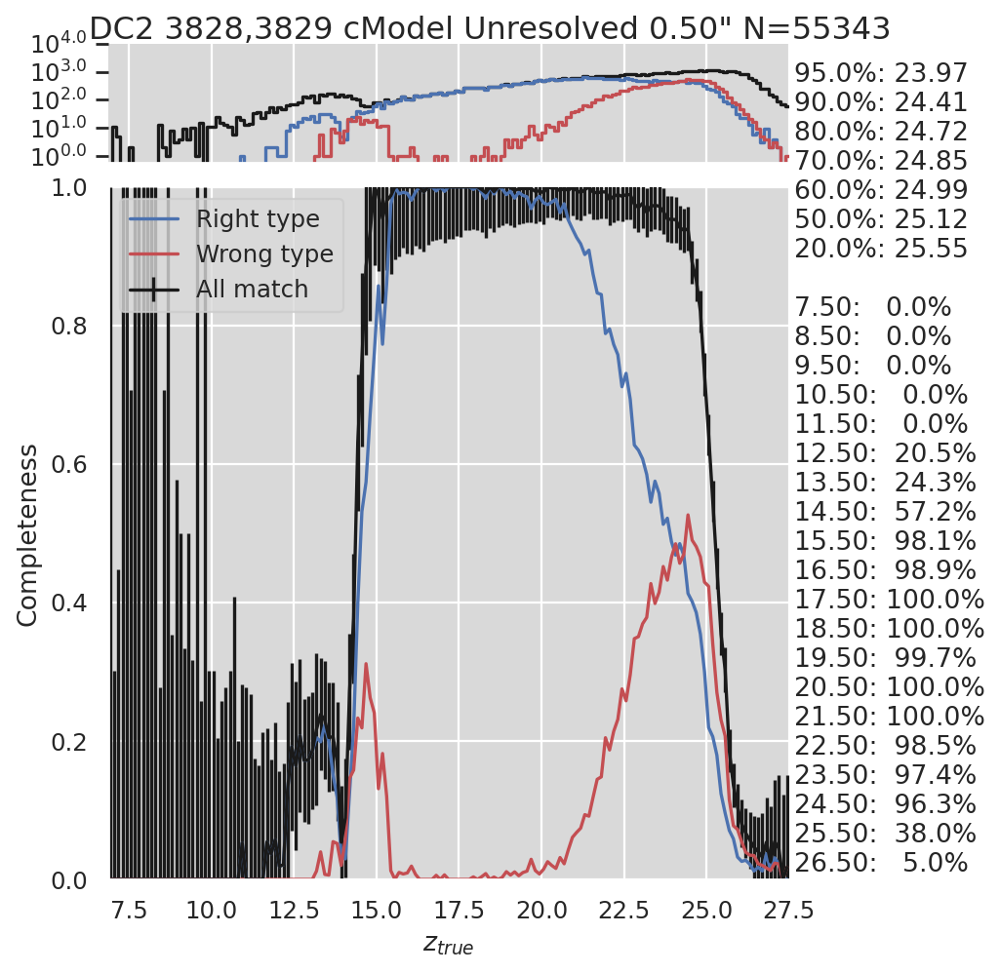

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


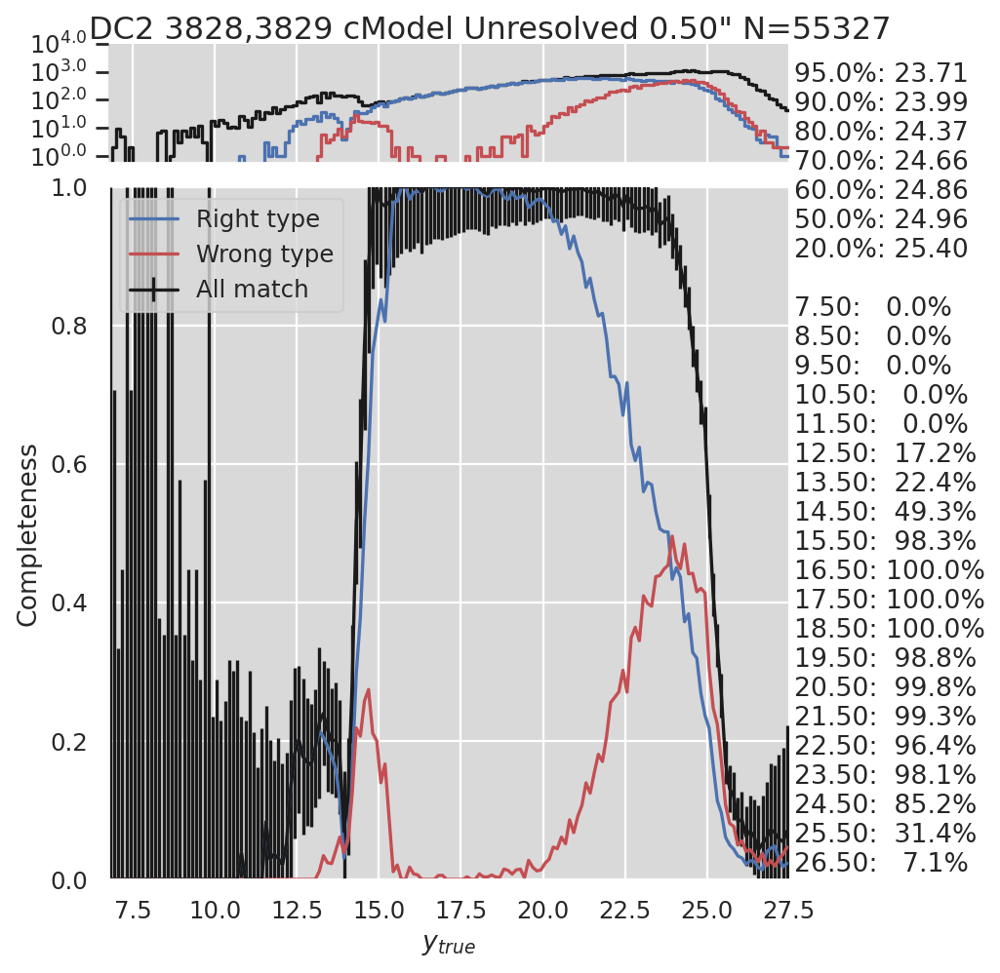

Measuring purity for 1475610/2913433 sources


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


282059 matched and 206250 mag < 27.5; 194295 both and 57007 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


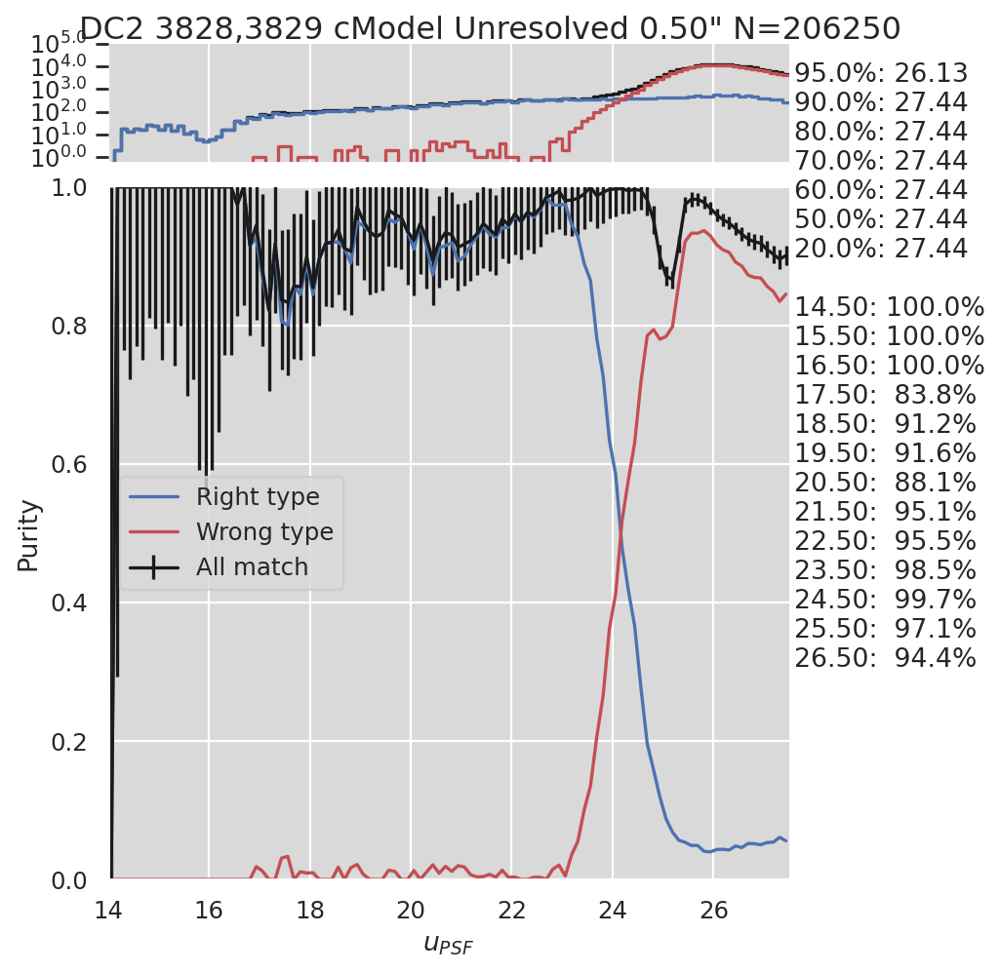

282059 matched and 263075 mag < 27.5; 252197 both and 9436 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


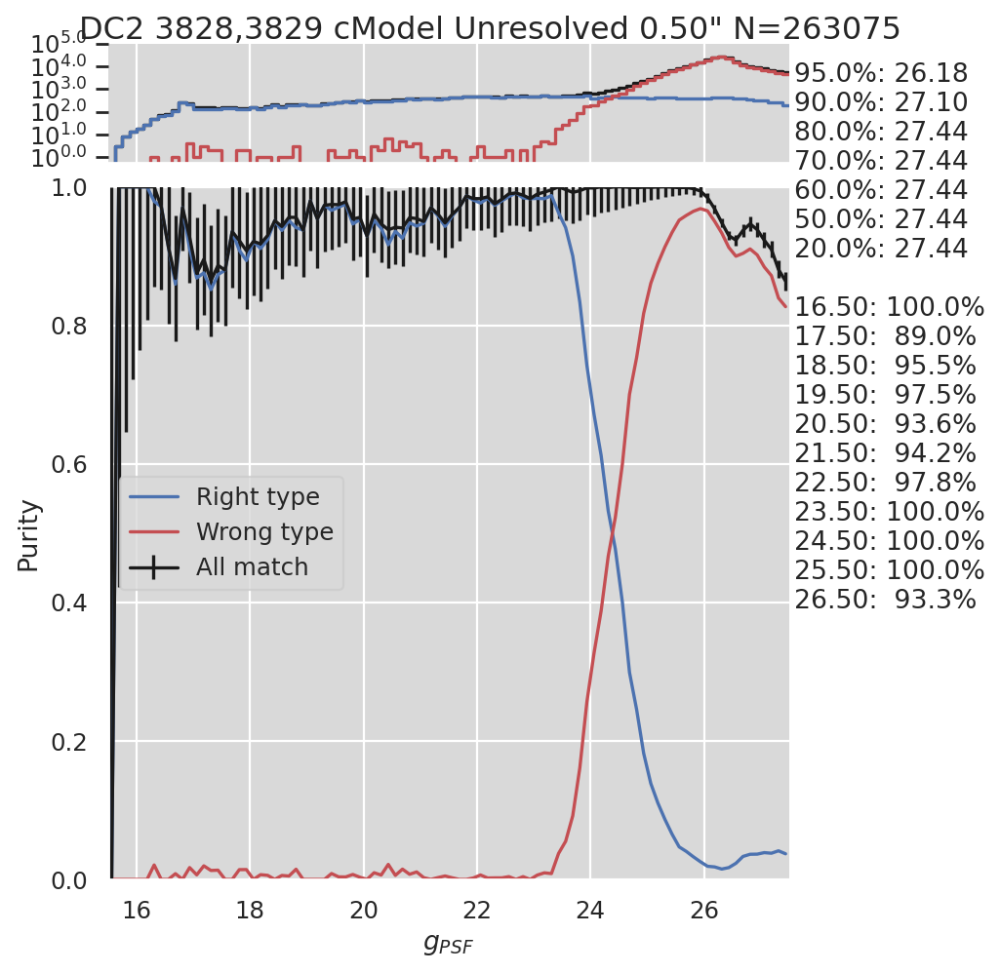

282059 matched and 279609 mag < 27.5; 265671 both and 7611 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


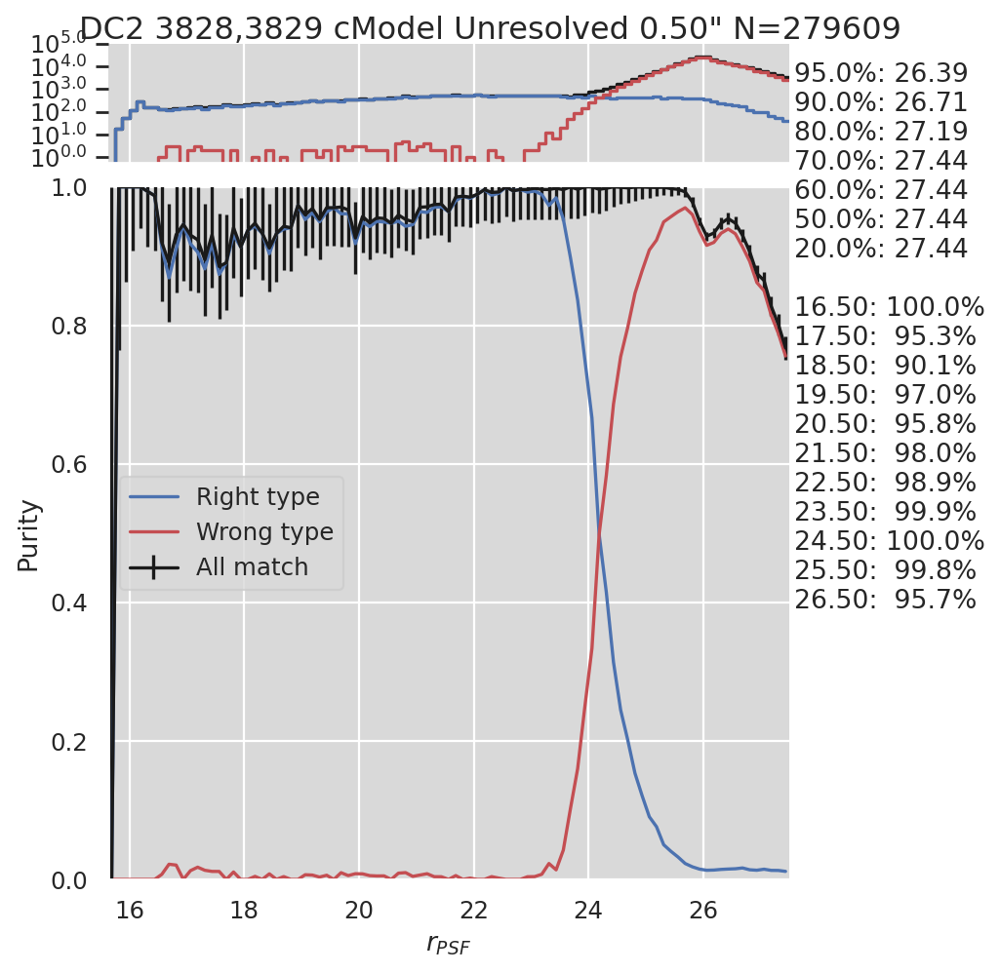

282059 matched and 280328 mag < 27.5; 263440 both and 10407 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


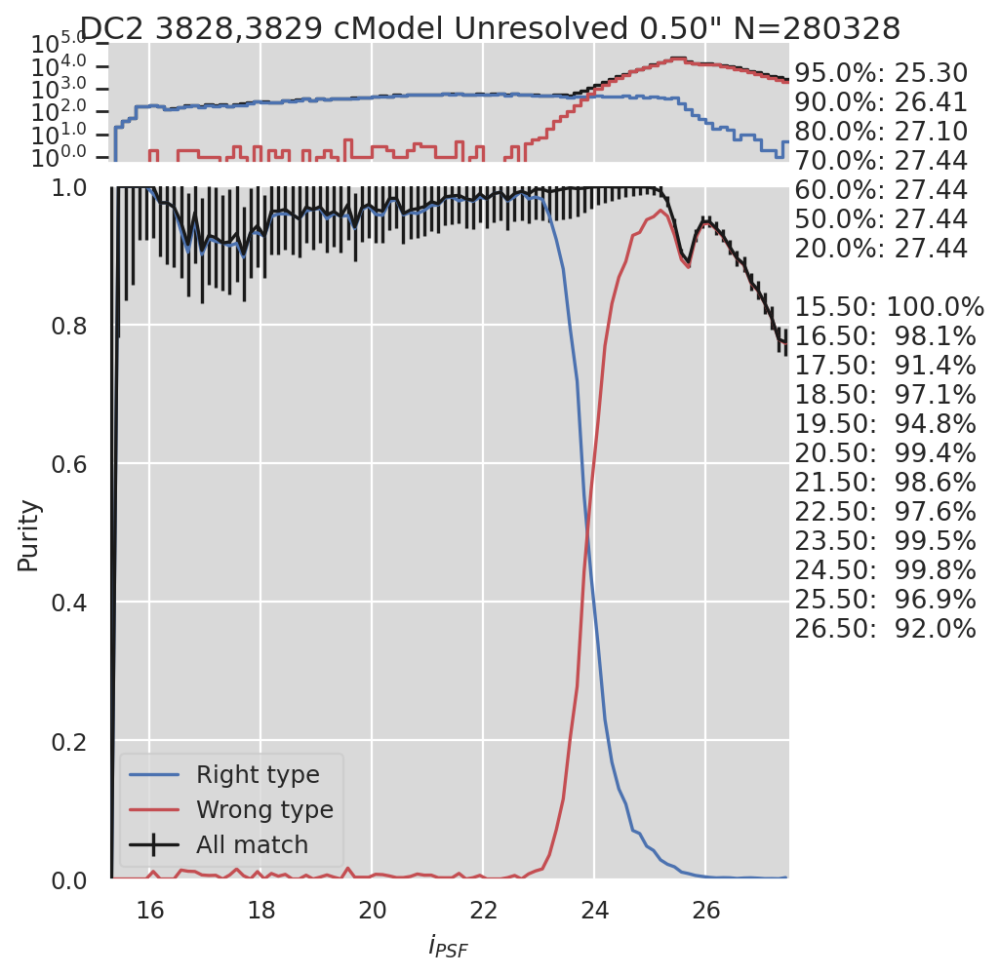

282059 matched and 250059 mag < 27.5; 232040 both and 41014 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


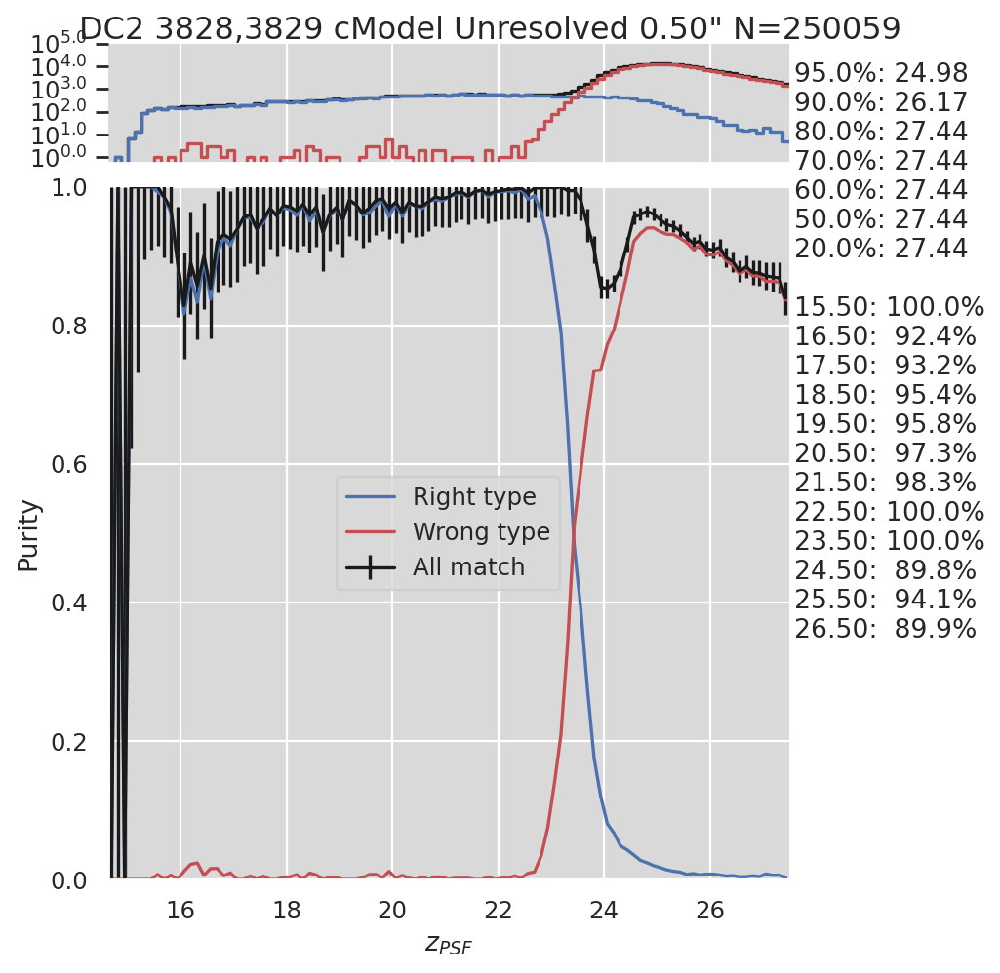

282059 matched and 246275 mag < 27.5; 228087 both and 49707 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


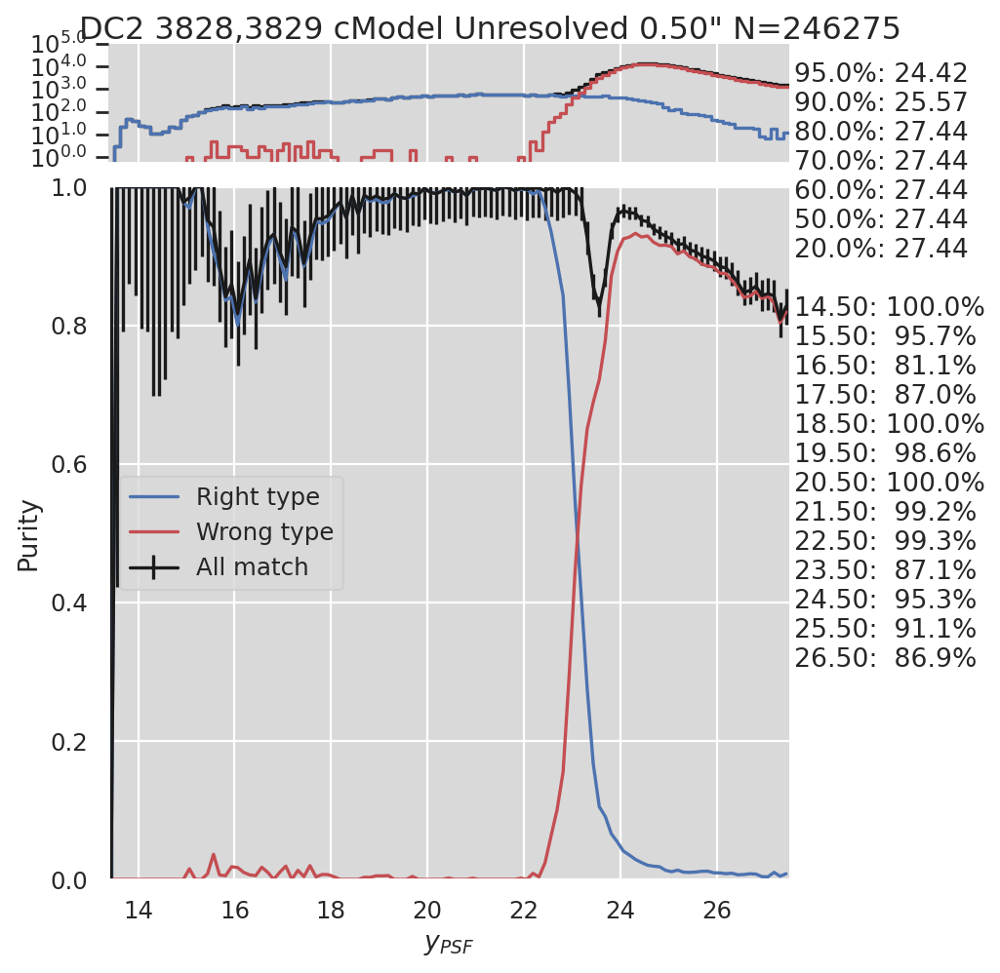

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


282059 matched and 206085 mag < 27.5; 194134 both and 58457 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


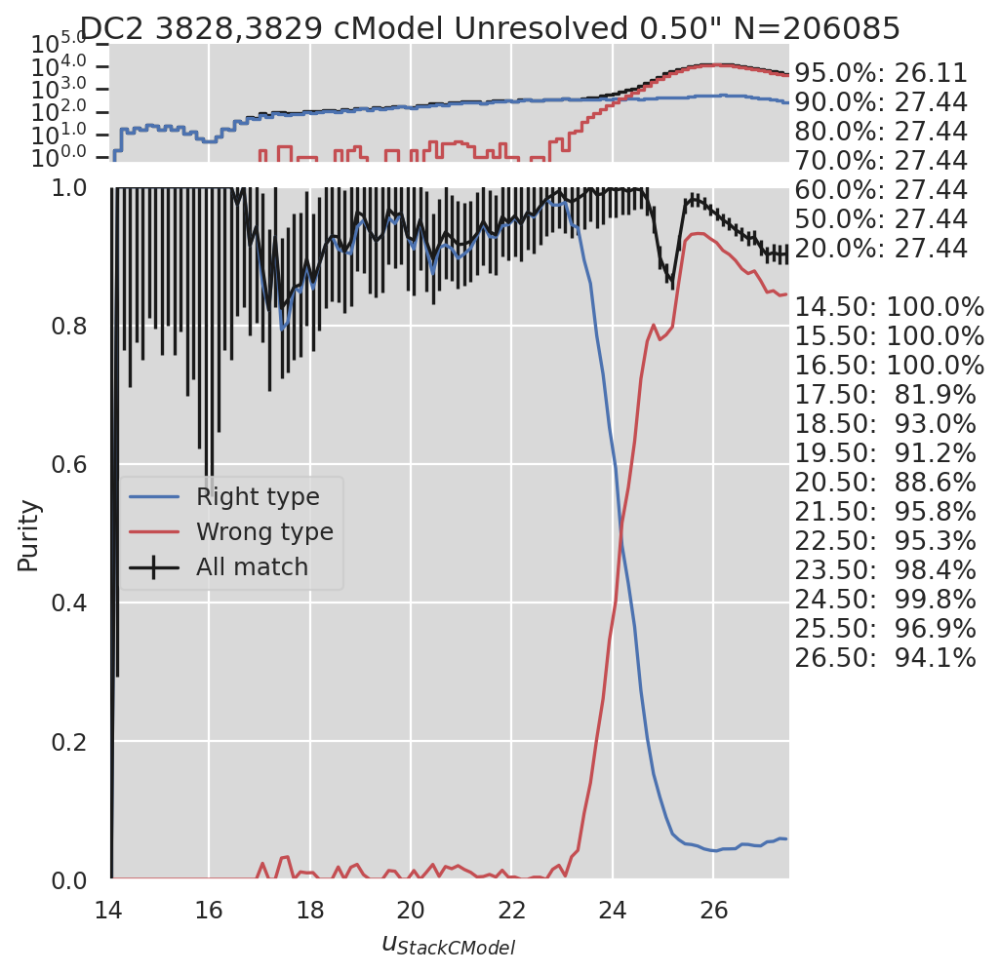

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.

282059 matched and 261153 mag < 27.5; 250935 both and 12242 non-finite; 310980/len(cat)=1475610


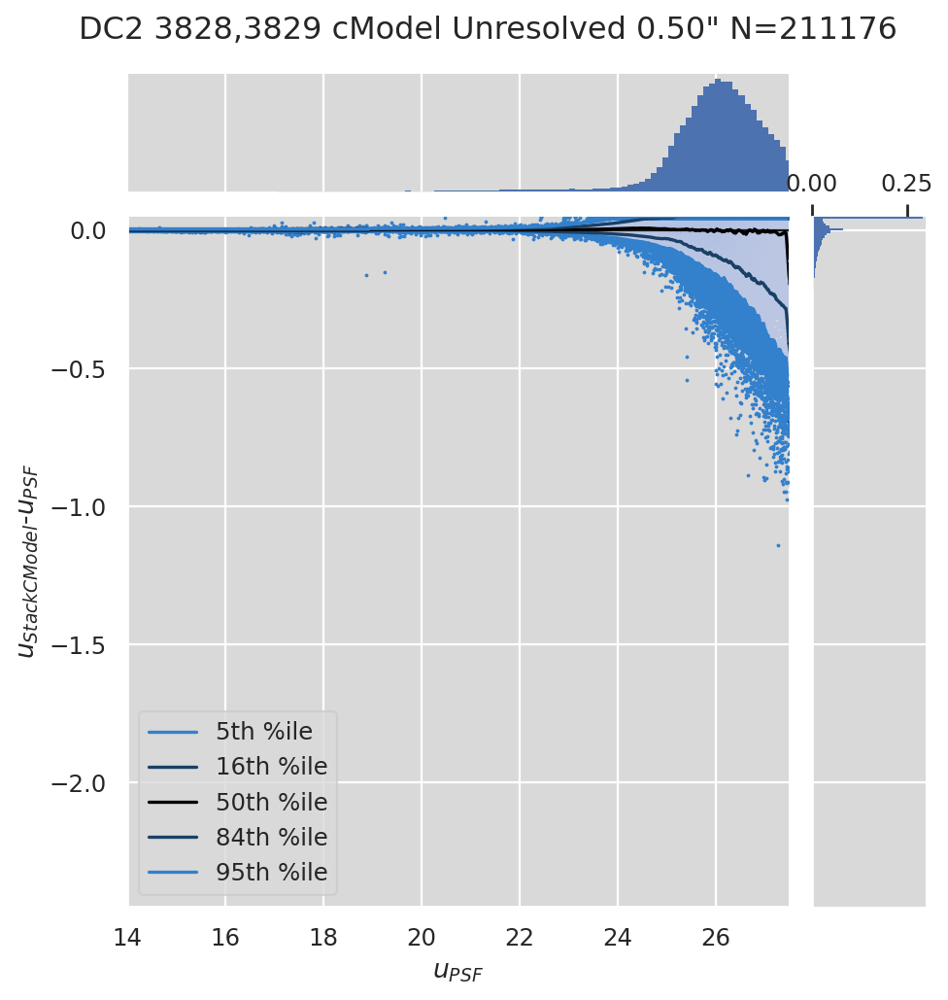

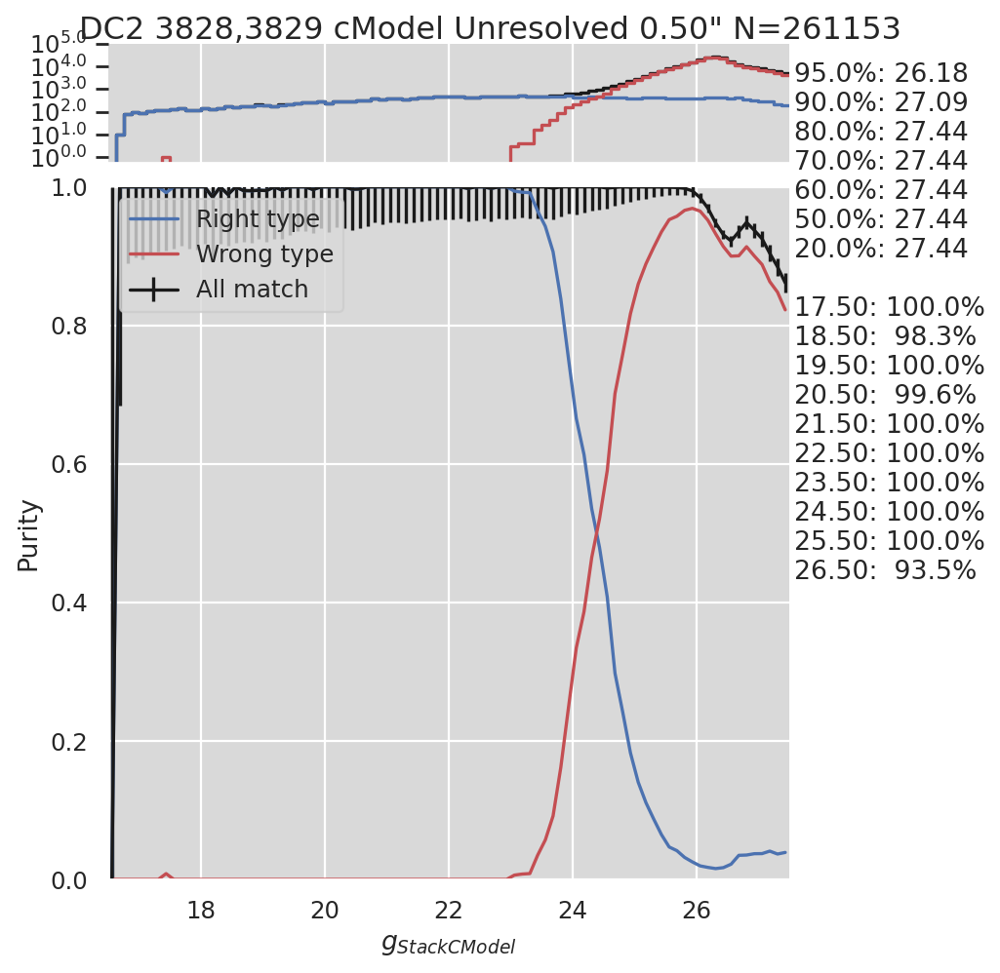

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


282059 matched and 277656 mag < 27.5; 264413 both and 10190 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


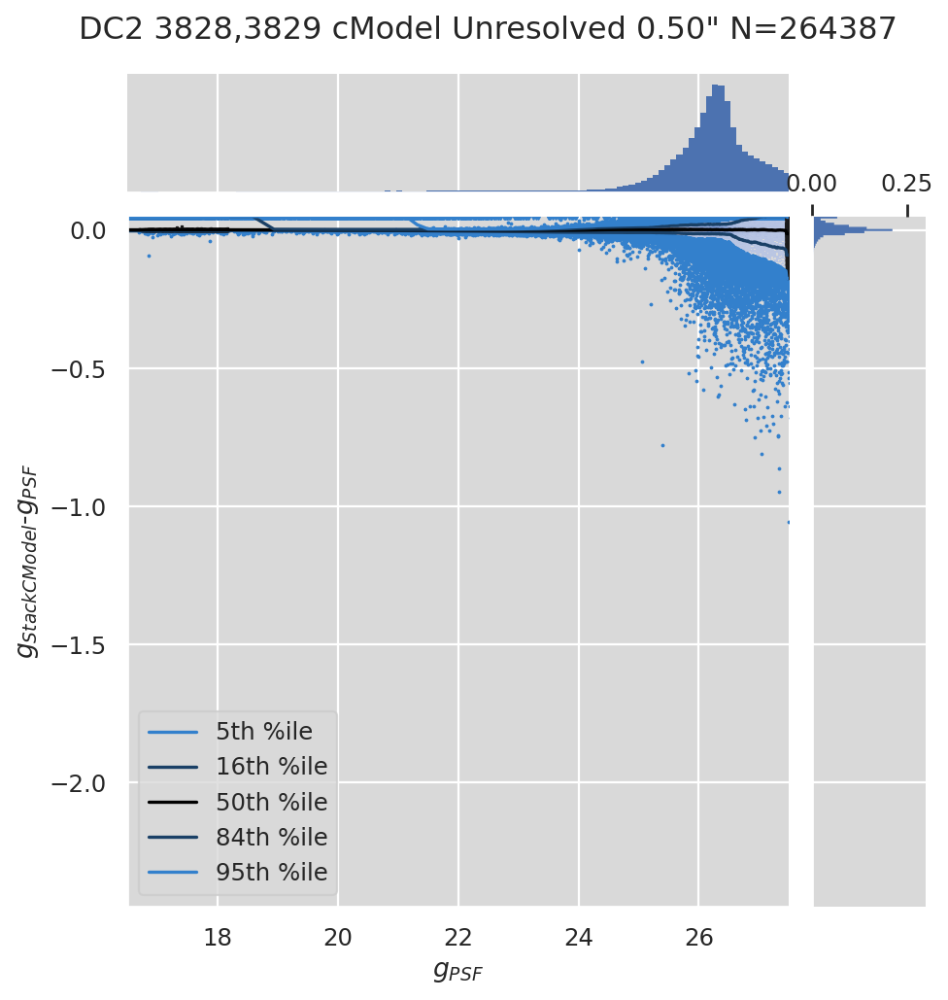

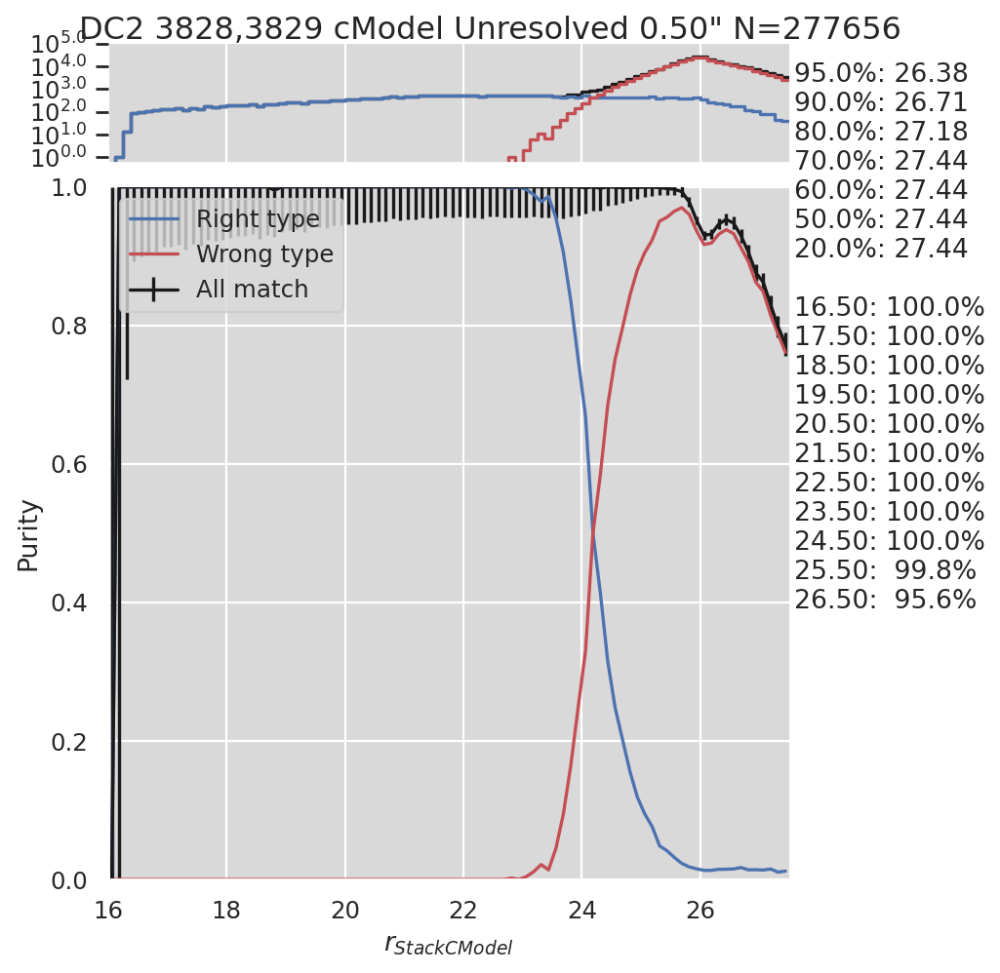

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.

282059 matched and 278436 mag < 27.5; 262191 both and 12933 non-finite; 310980/len(cat)=1475610


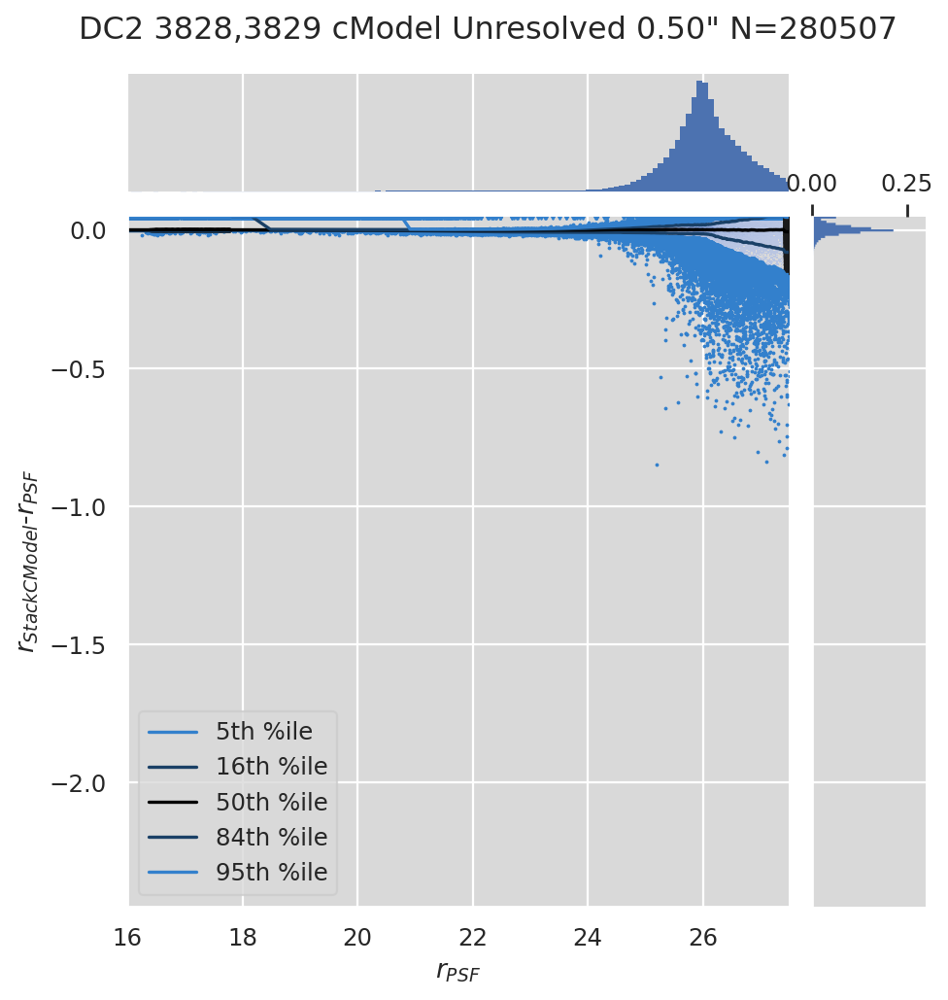

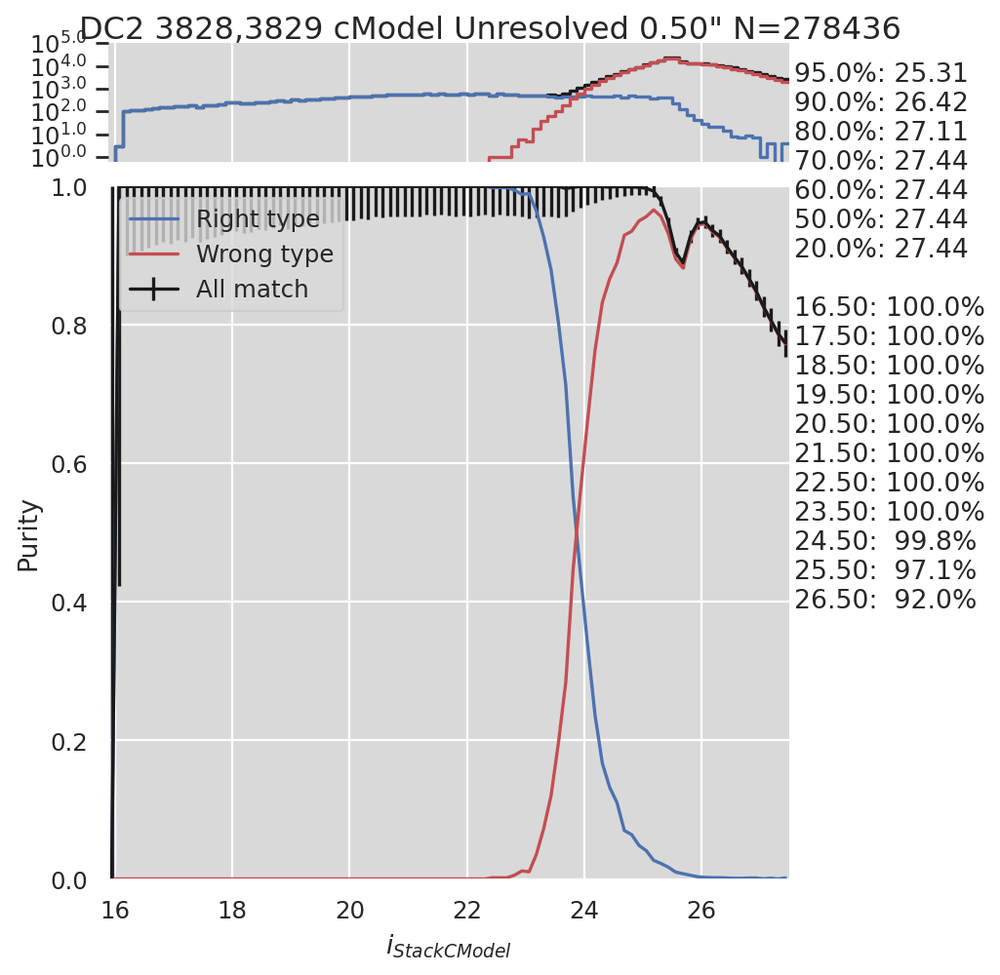

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


282059 matched and 248132 mag < 27.5; 230786 both and 43653 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


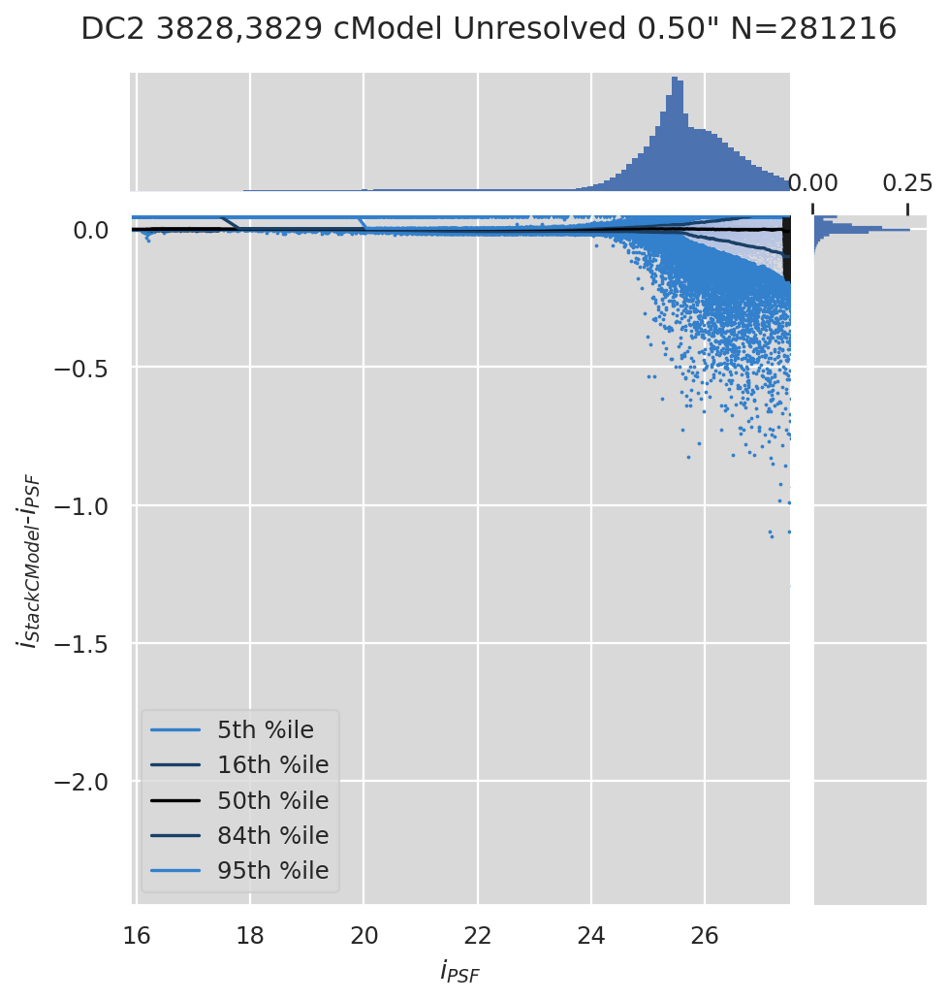

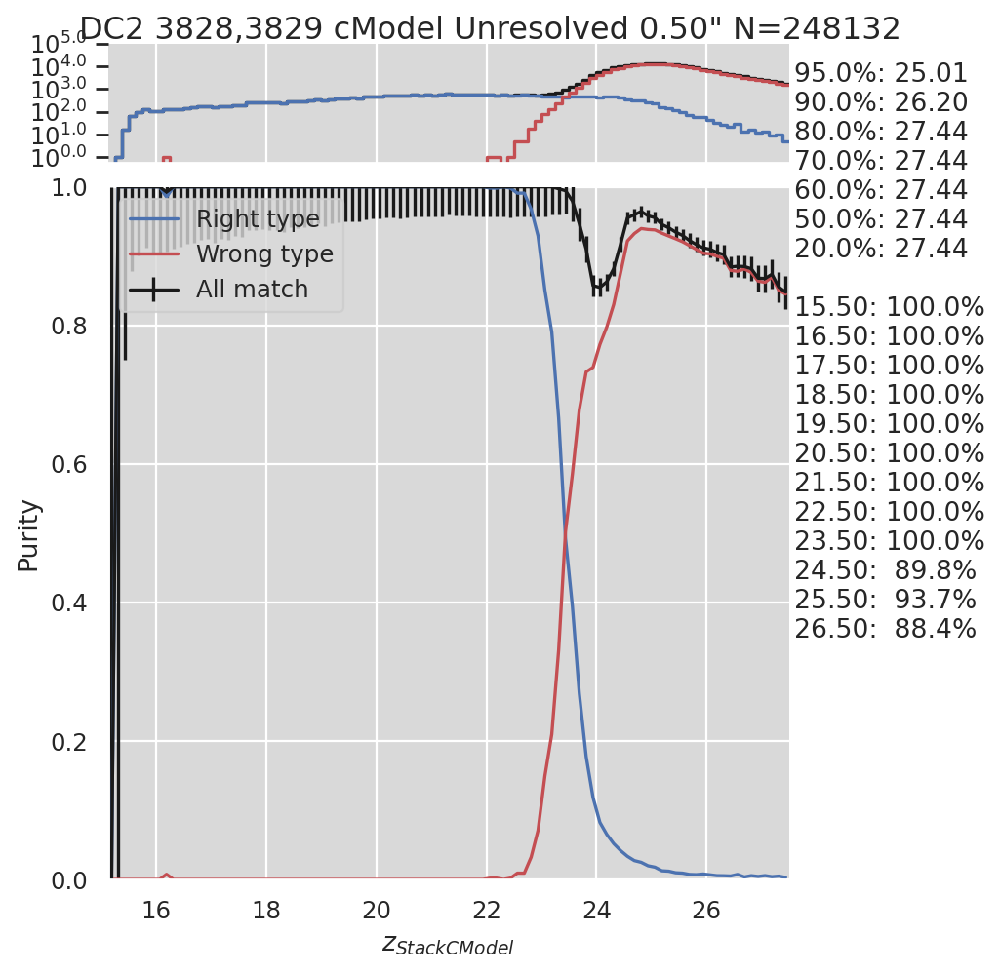

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


282059 matched and 243566 mag < 27.5; 226302 both and 51611 non-finite; 310980/len(cat)=1475610


/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


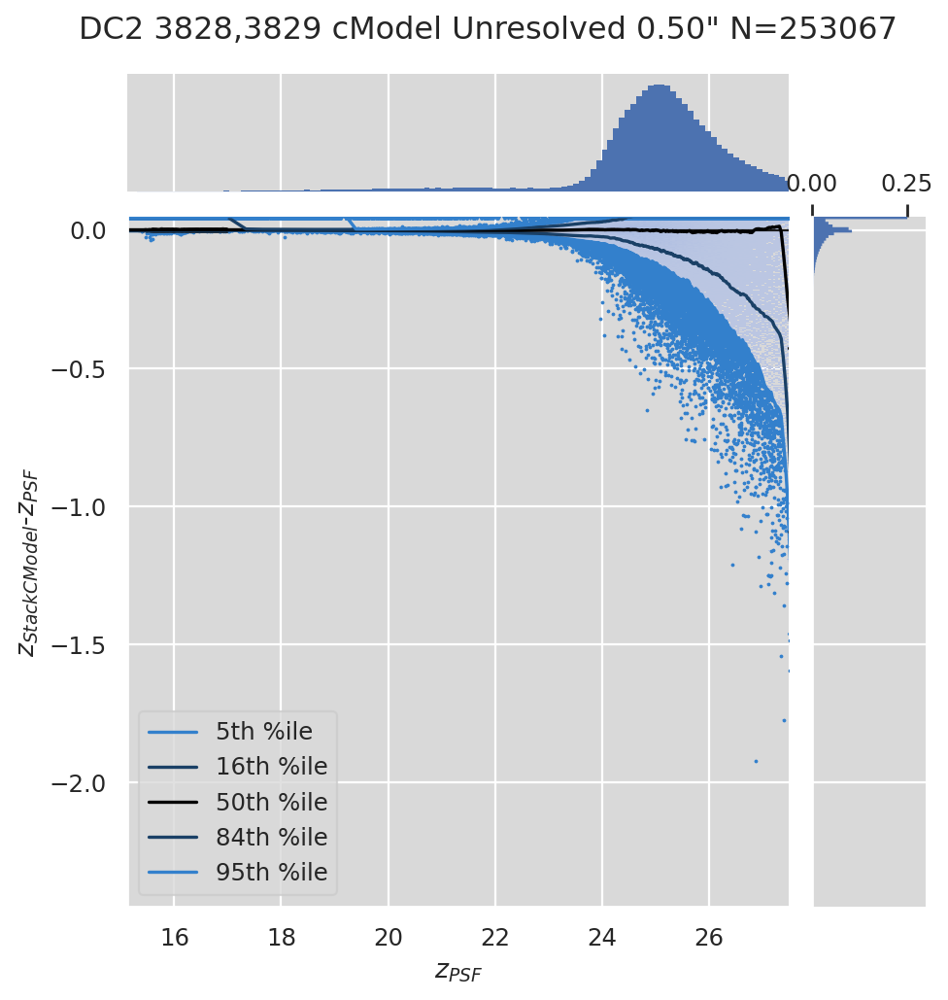

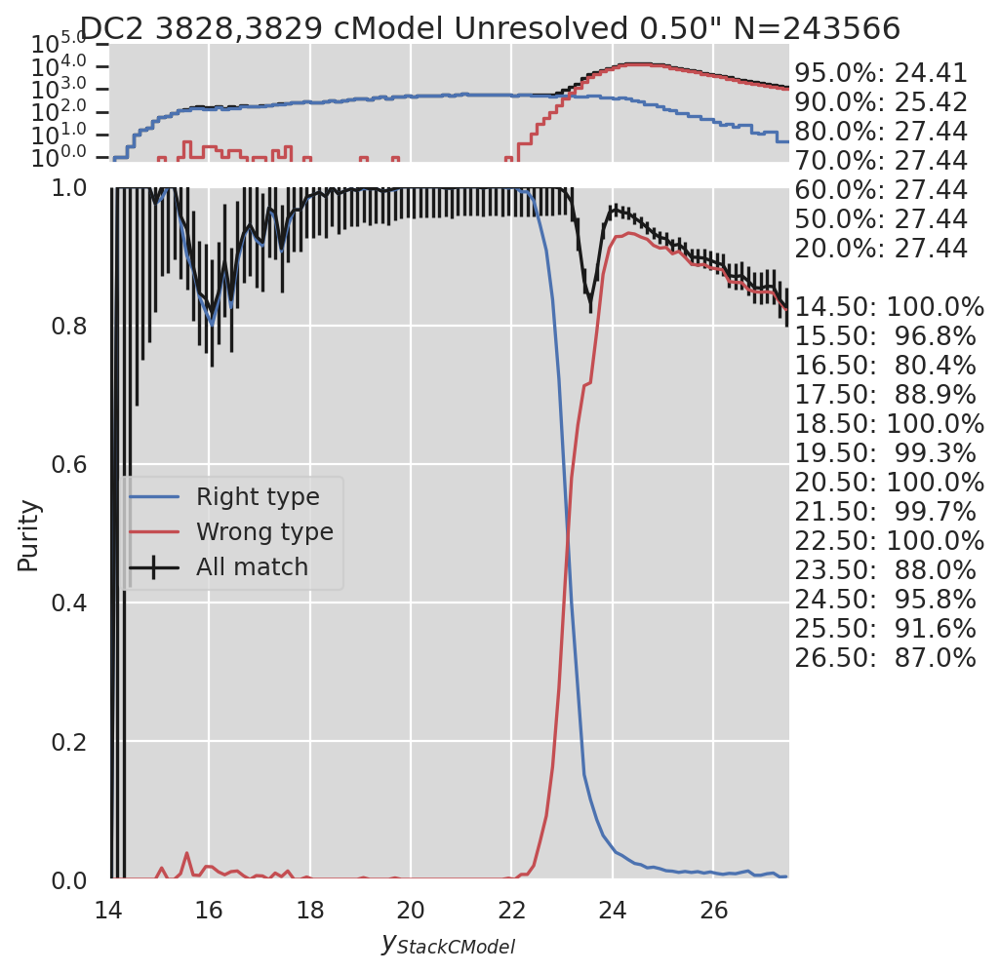

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Unresolved u, Stack CModel


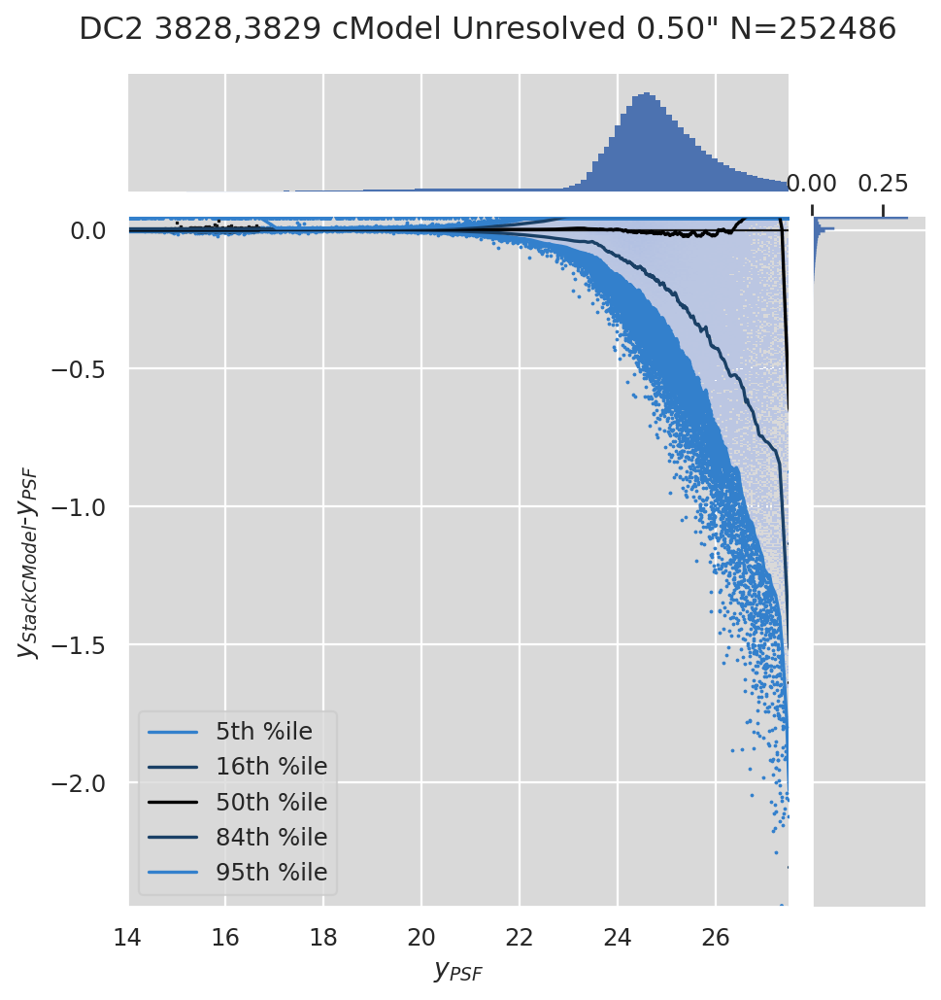

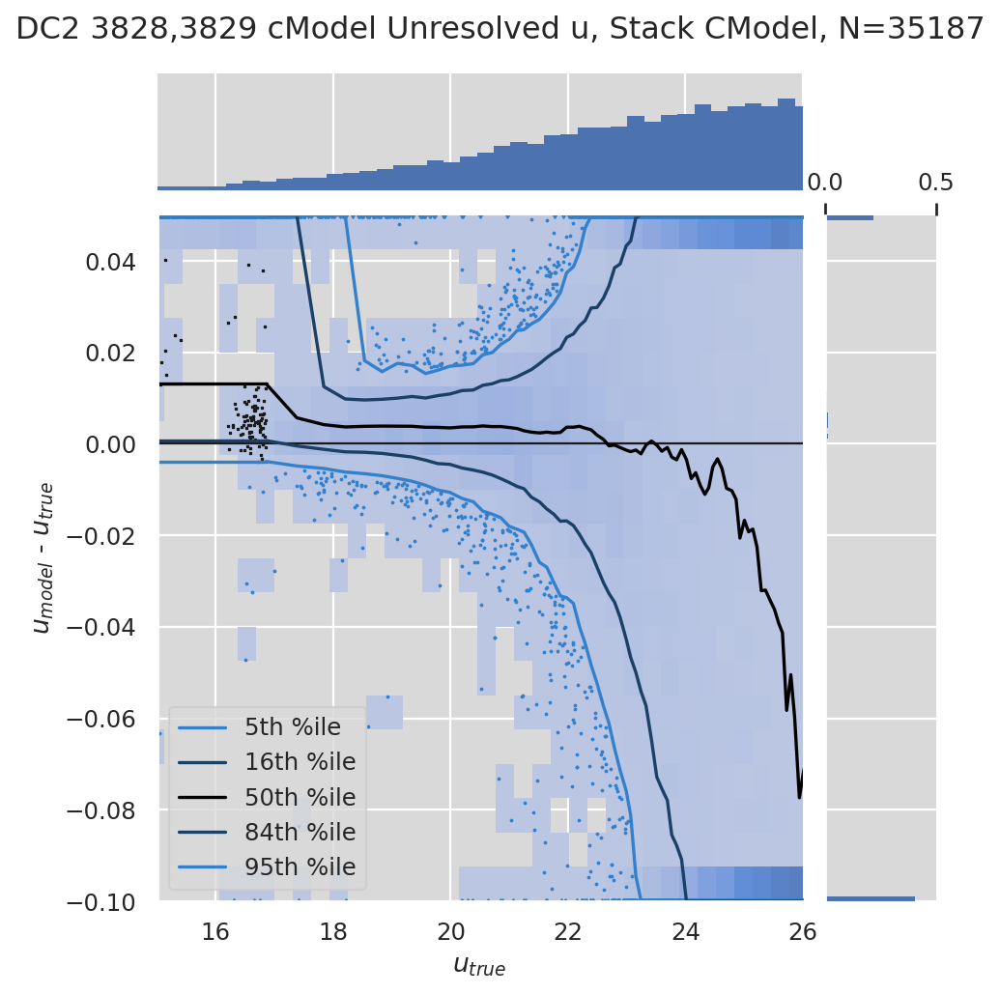

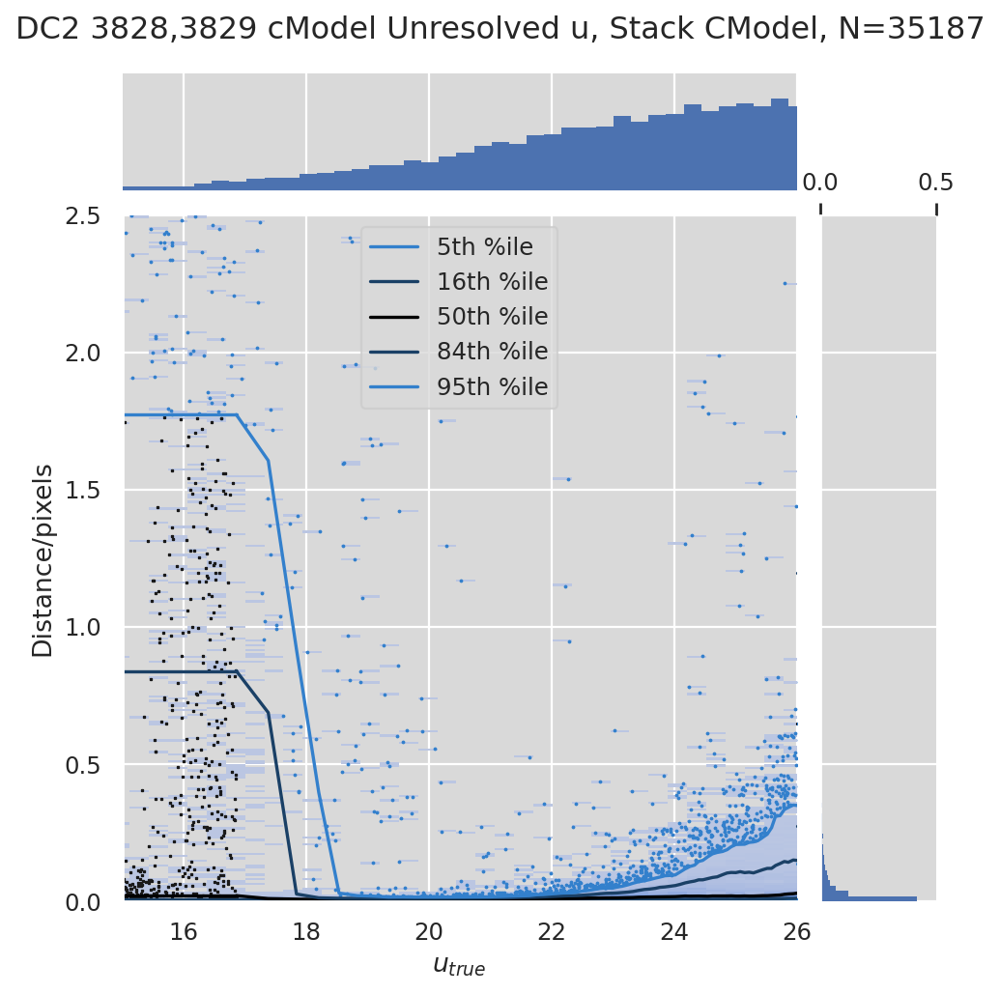

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Unresolved u, Stack CModel


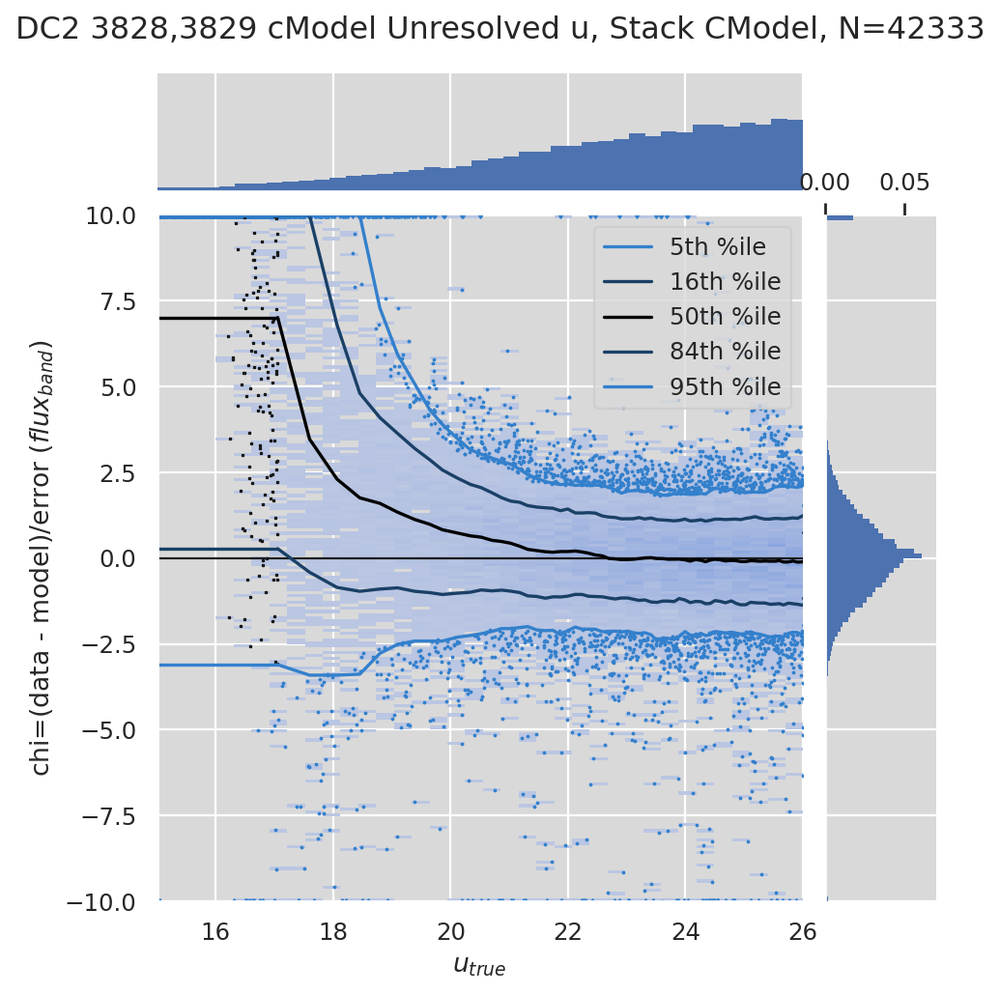

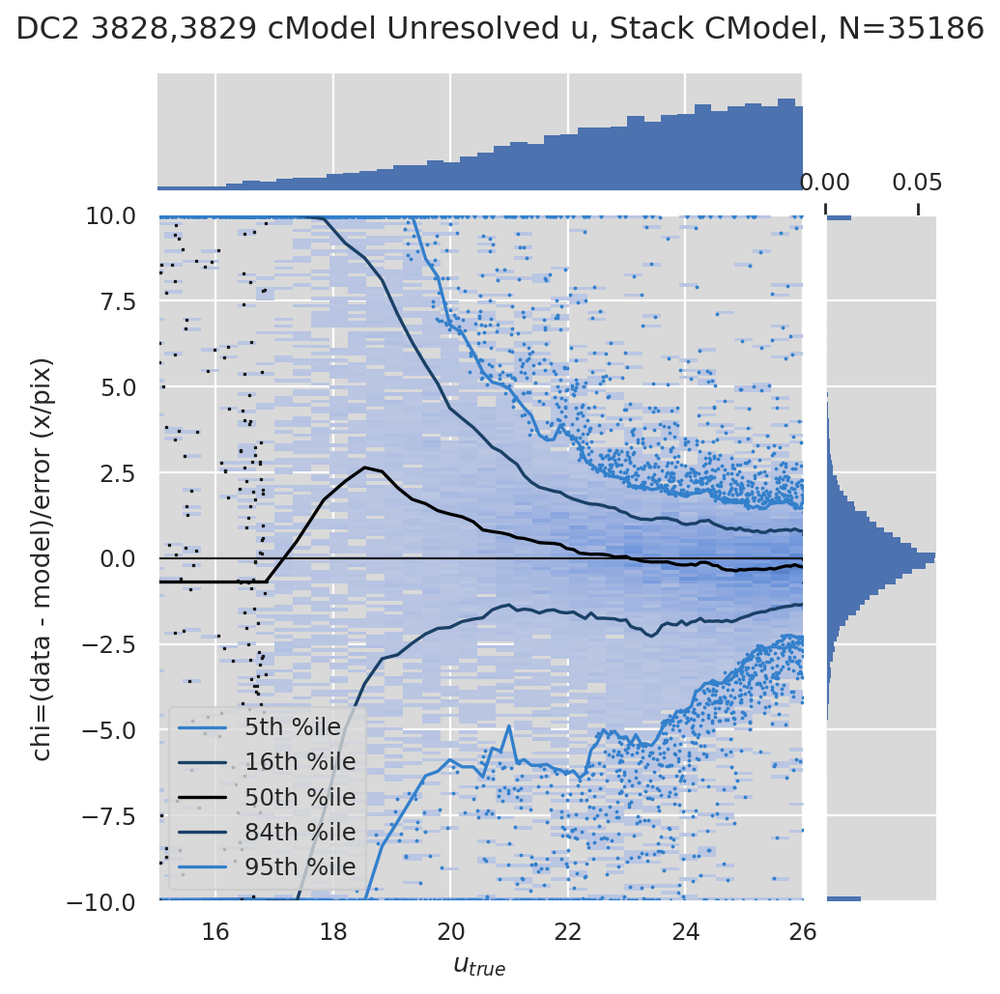

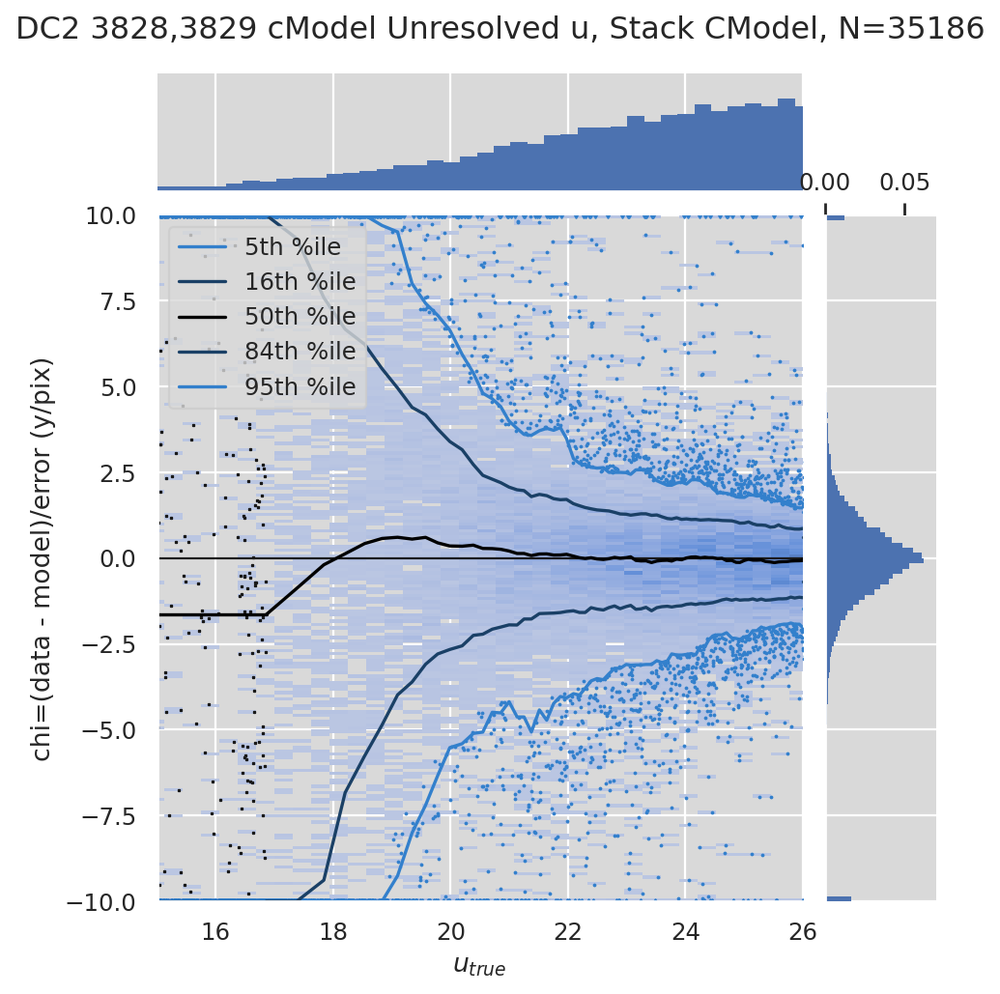

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Unresolved g, Stack CModel


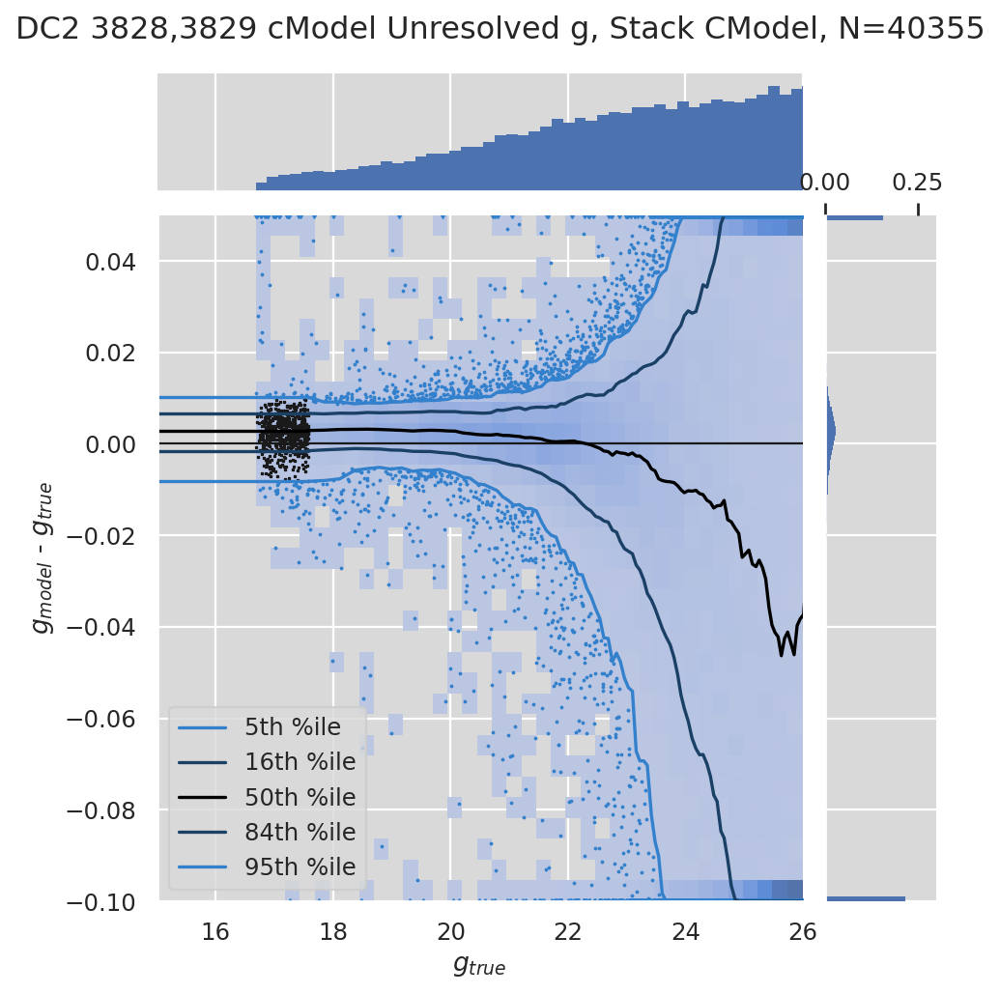

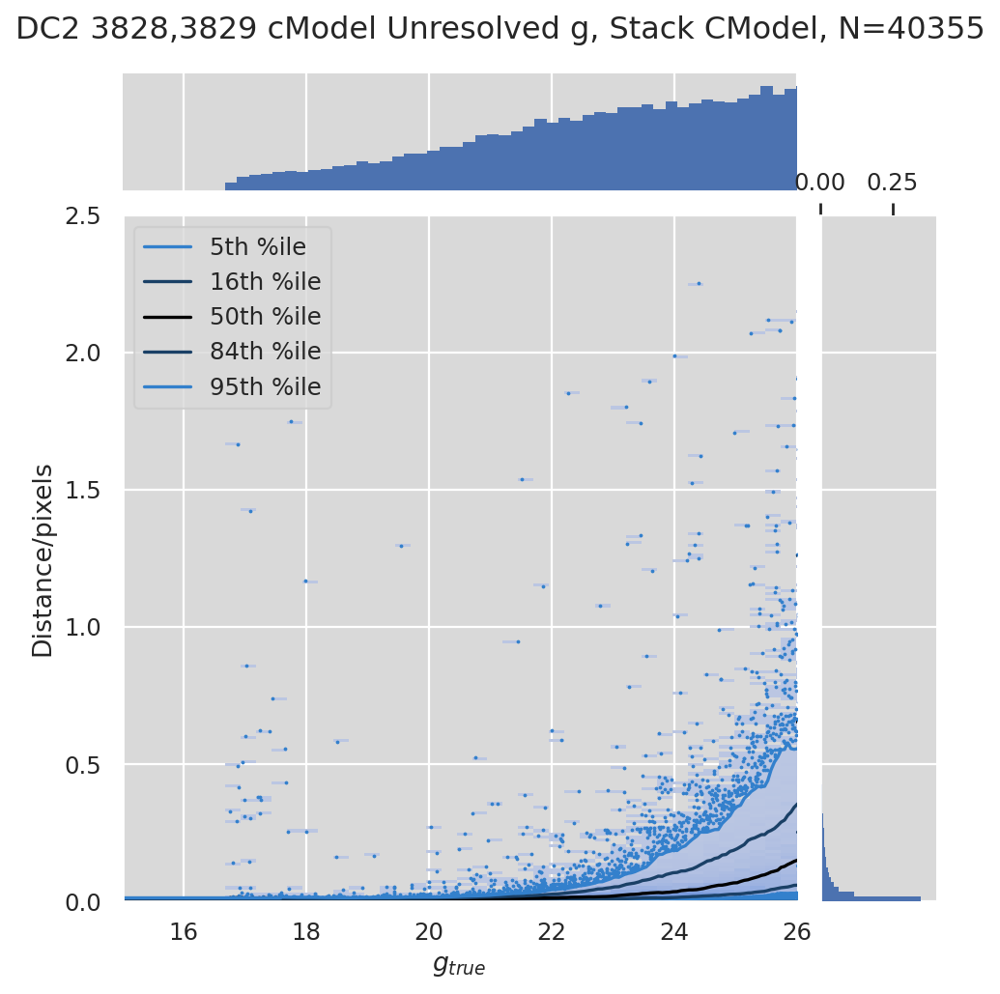

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Unresolved g, Stack CModel


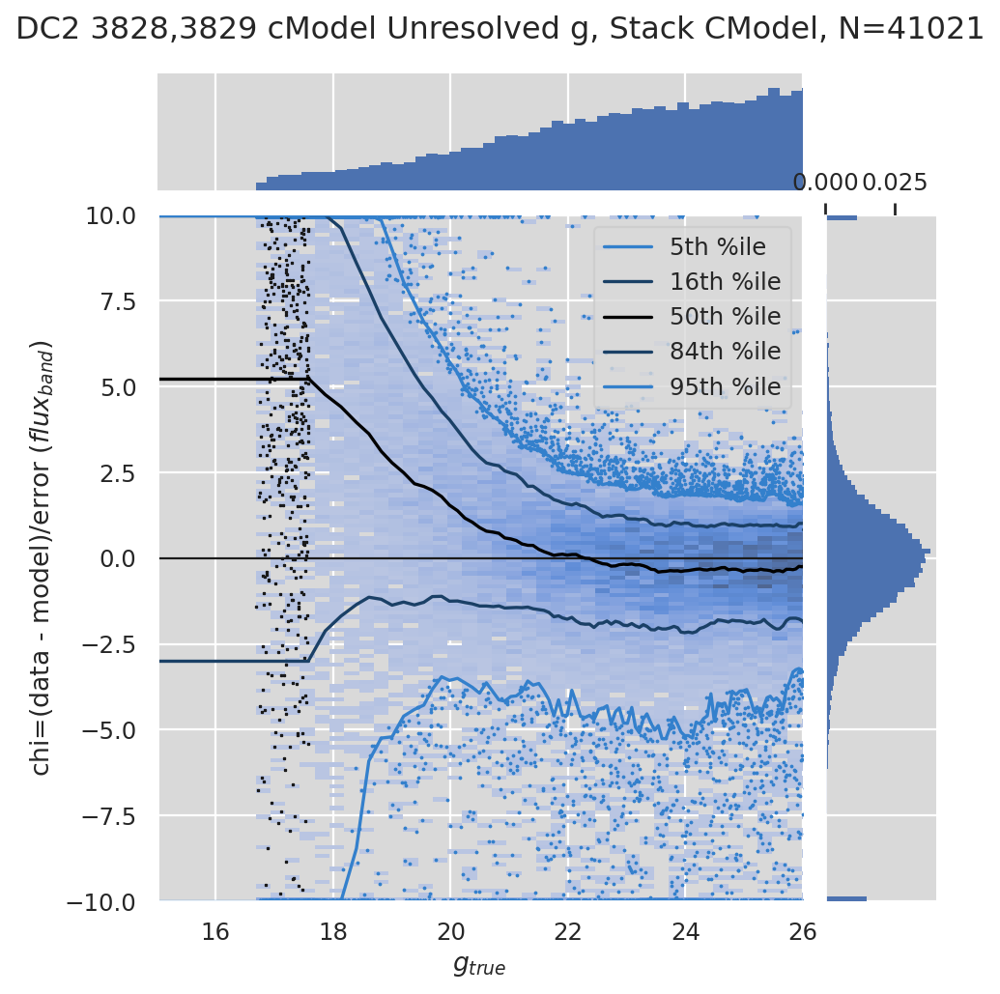

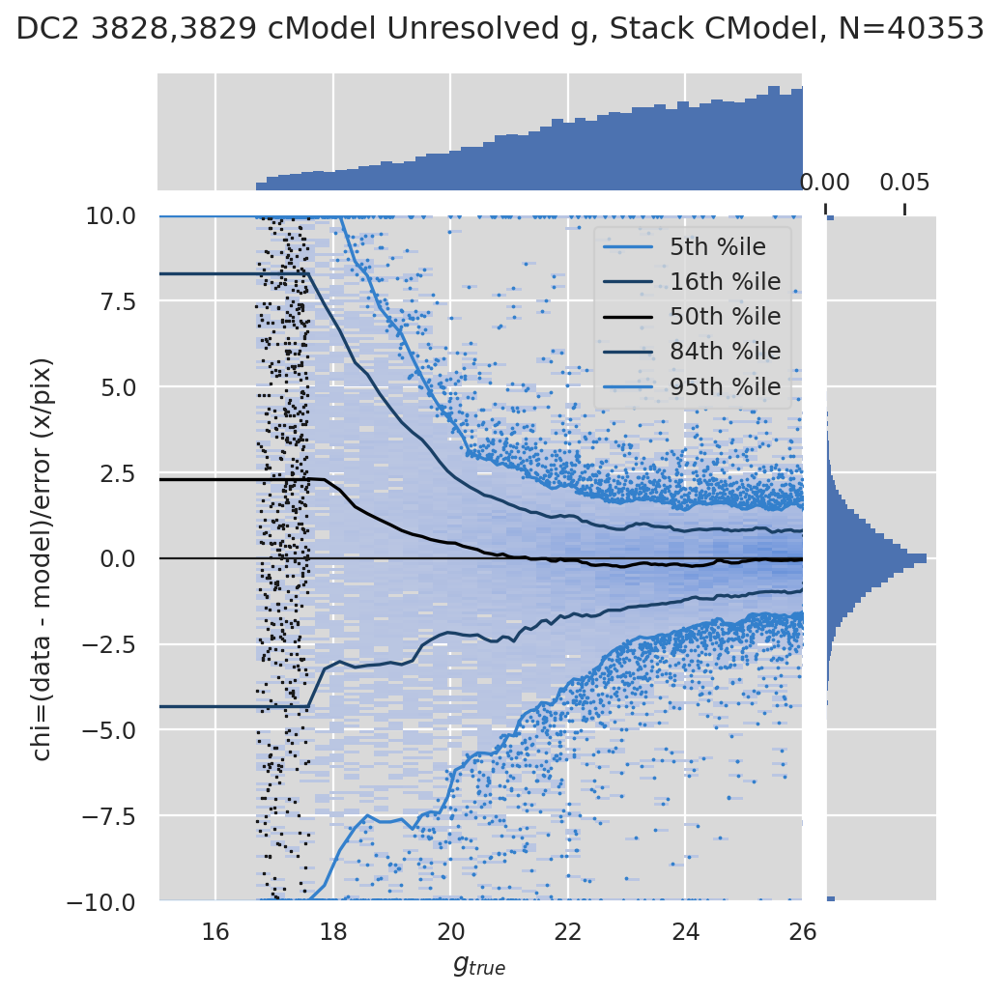

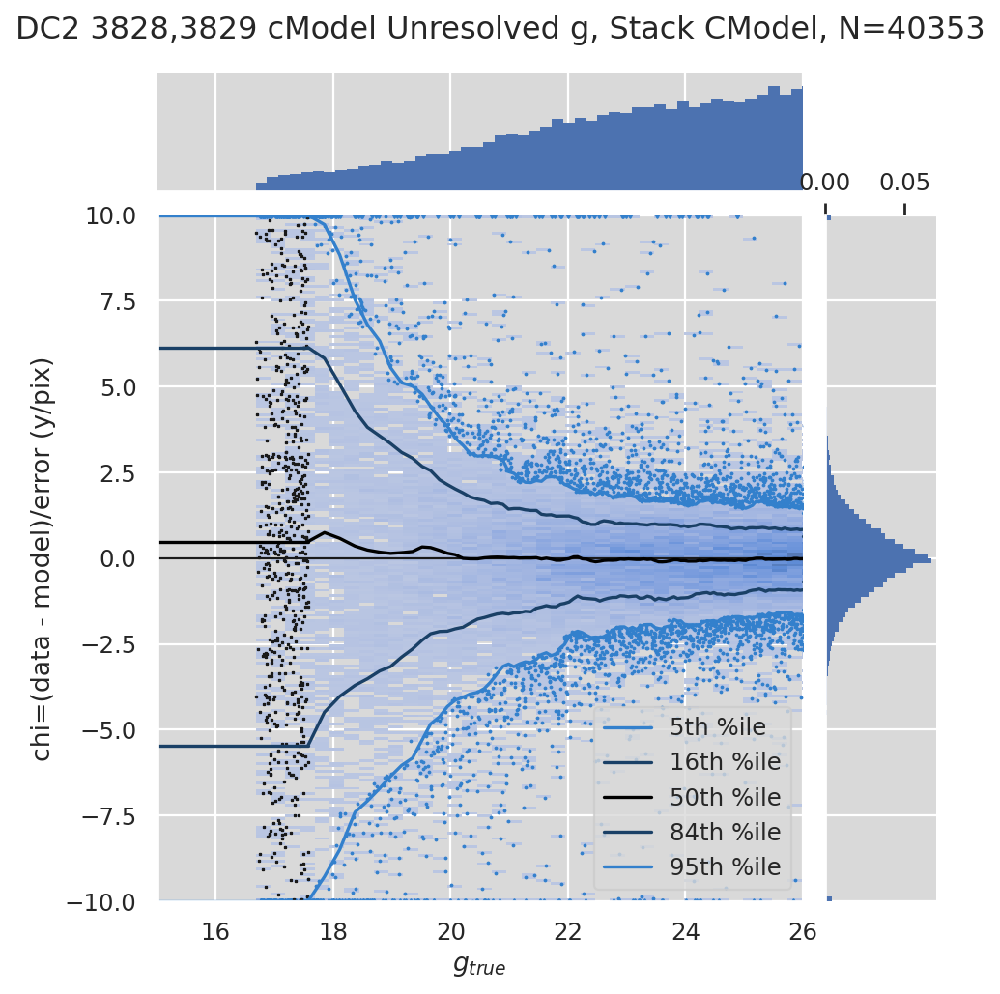

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Unresolved r, Stack CModel


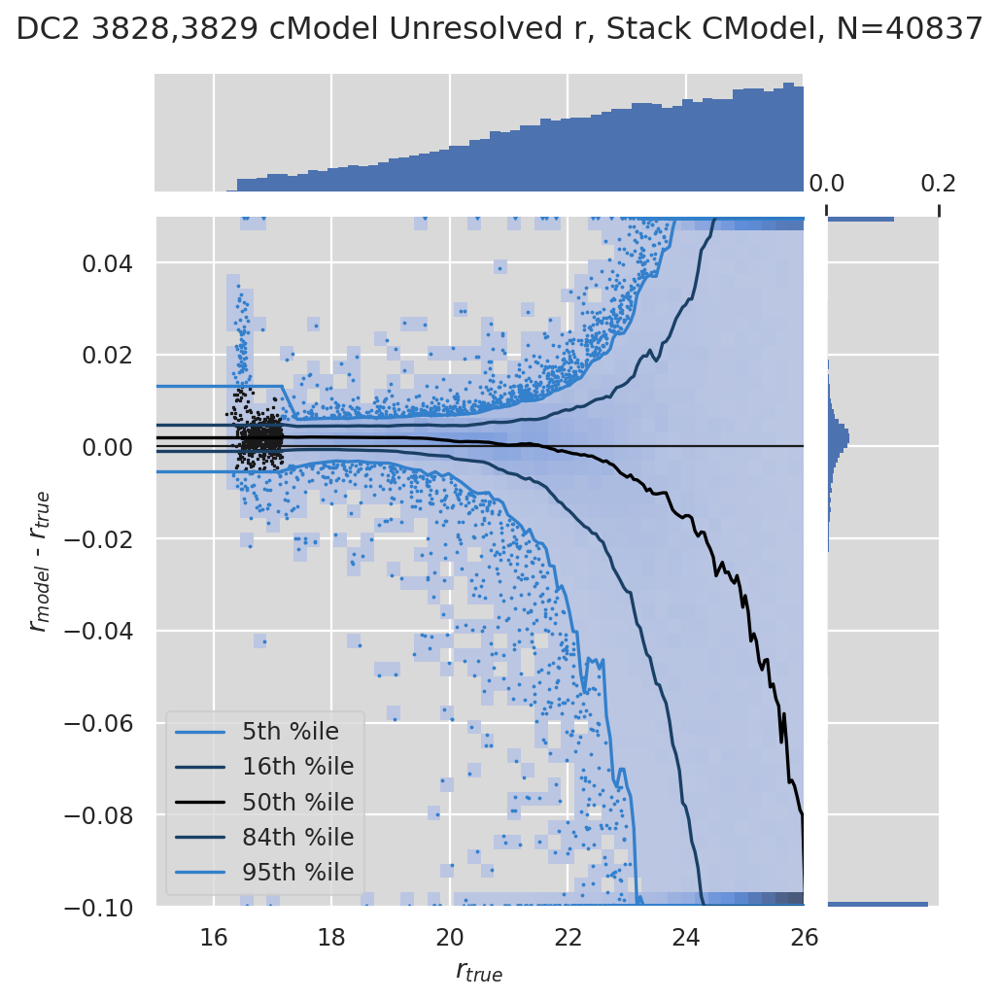

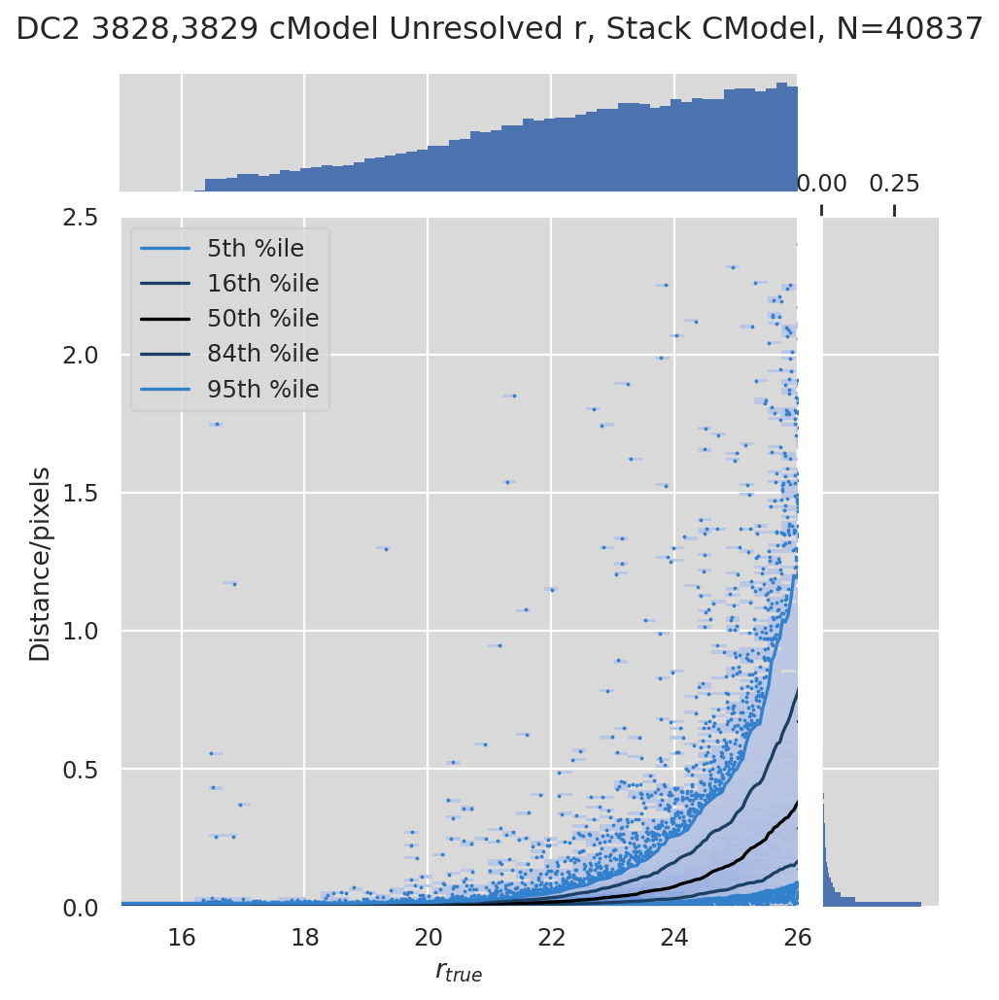

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Unresolved r, Stack CModel


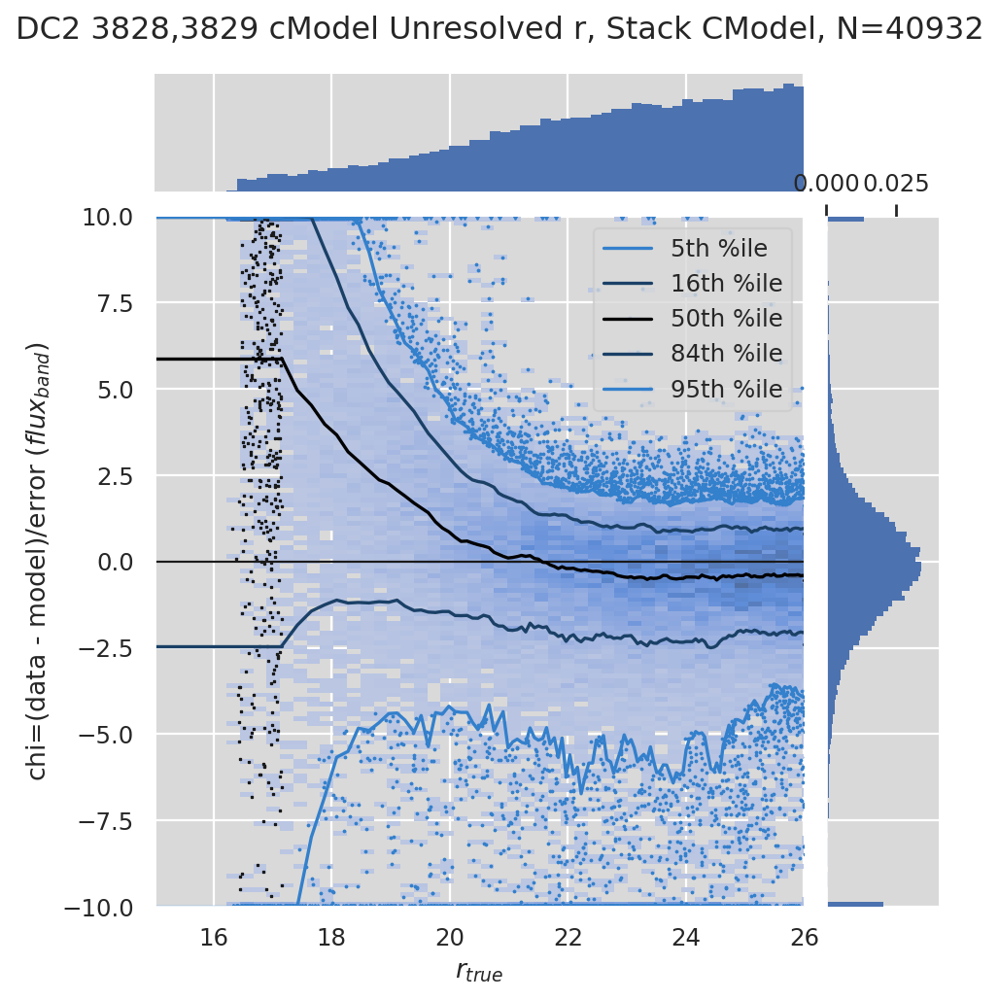

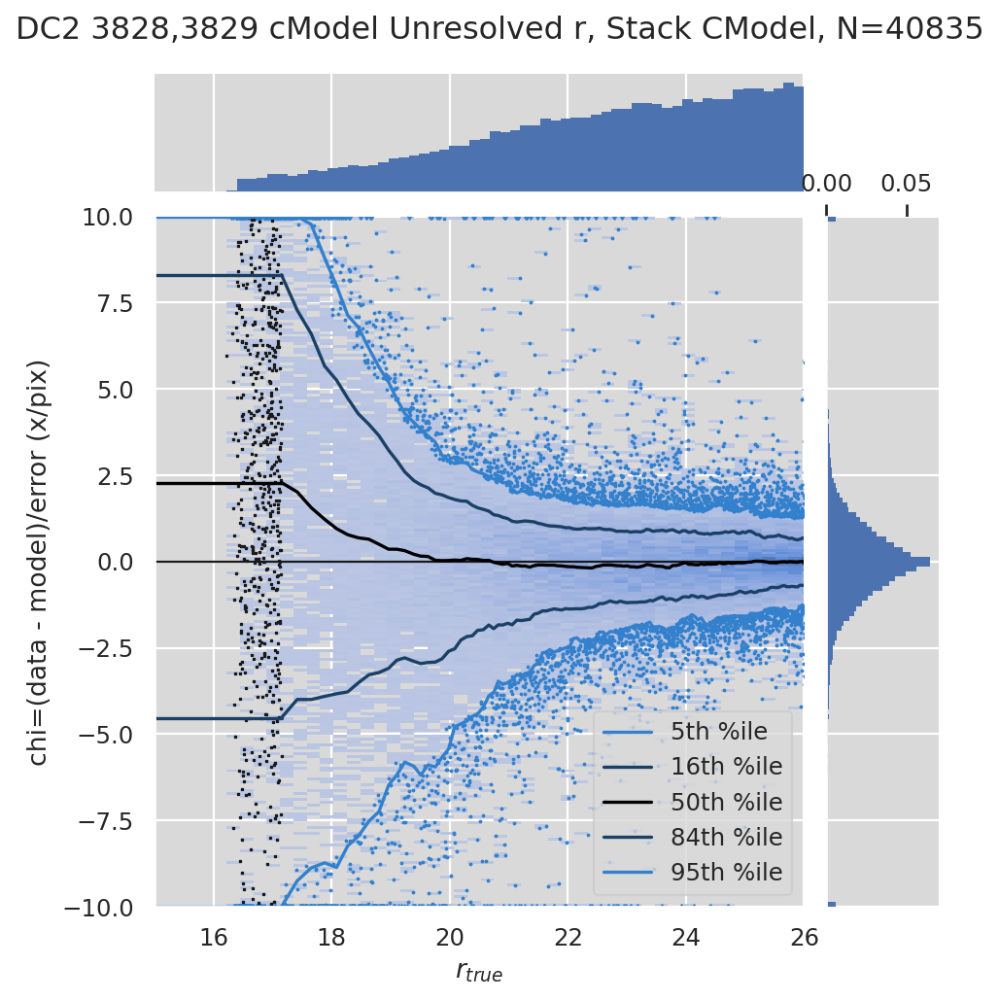

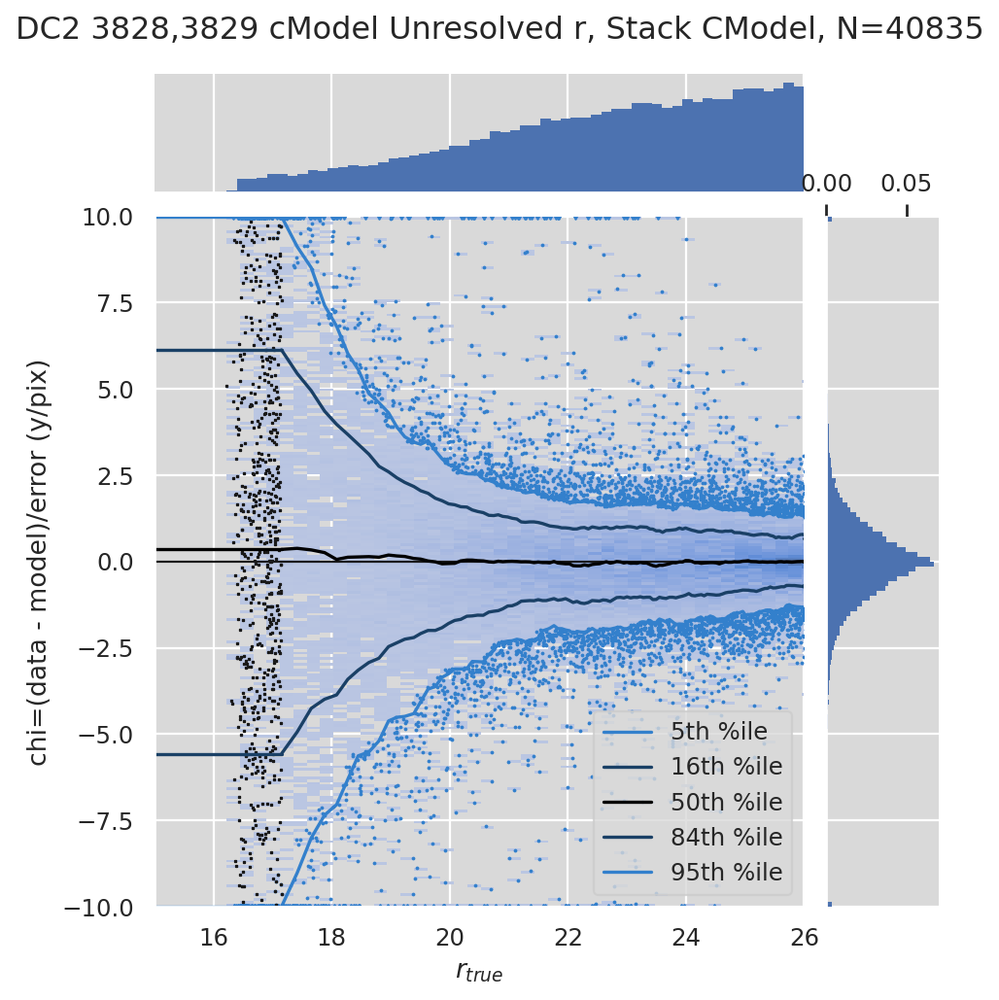

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Unresolved i, Stack CModel


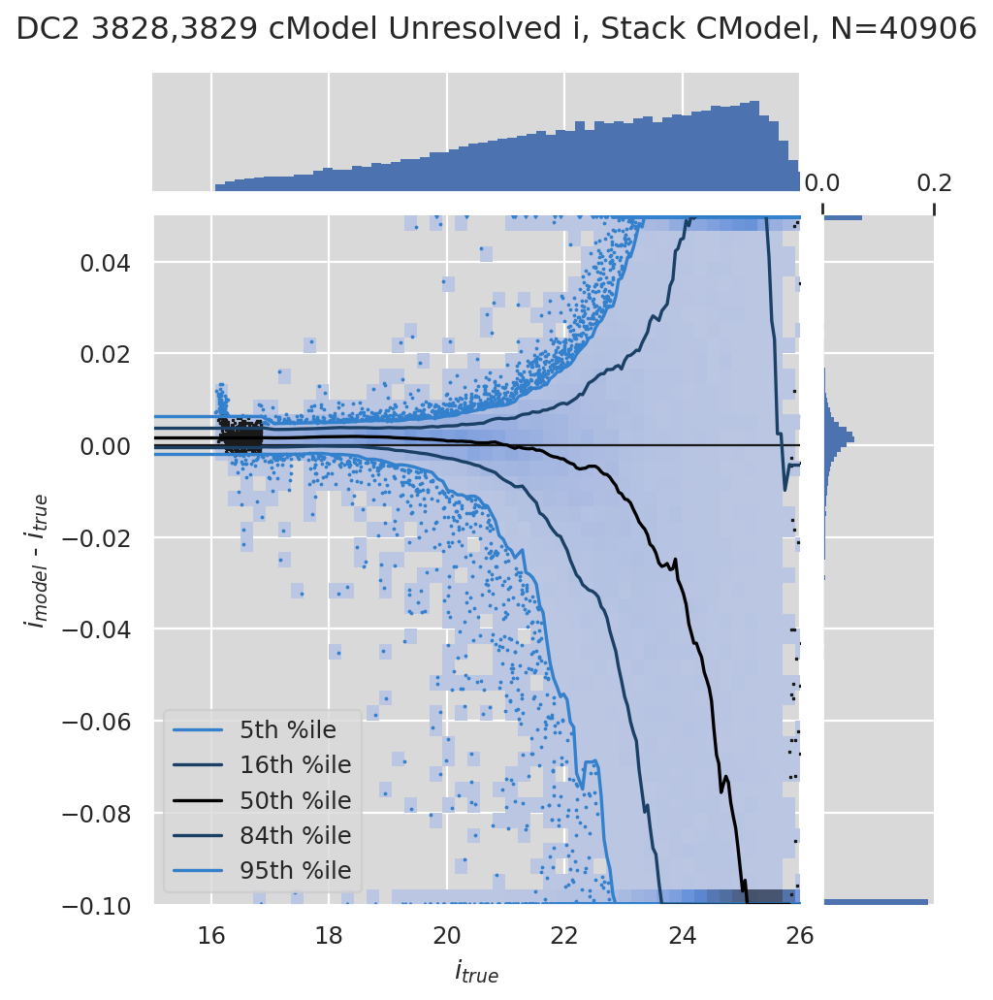

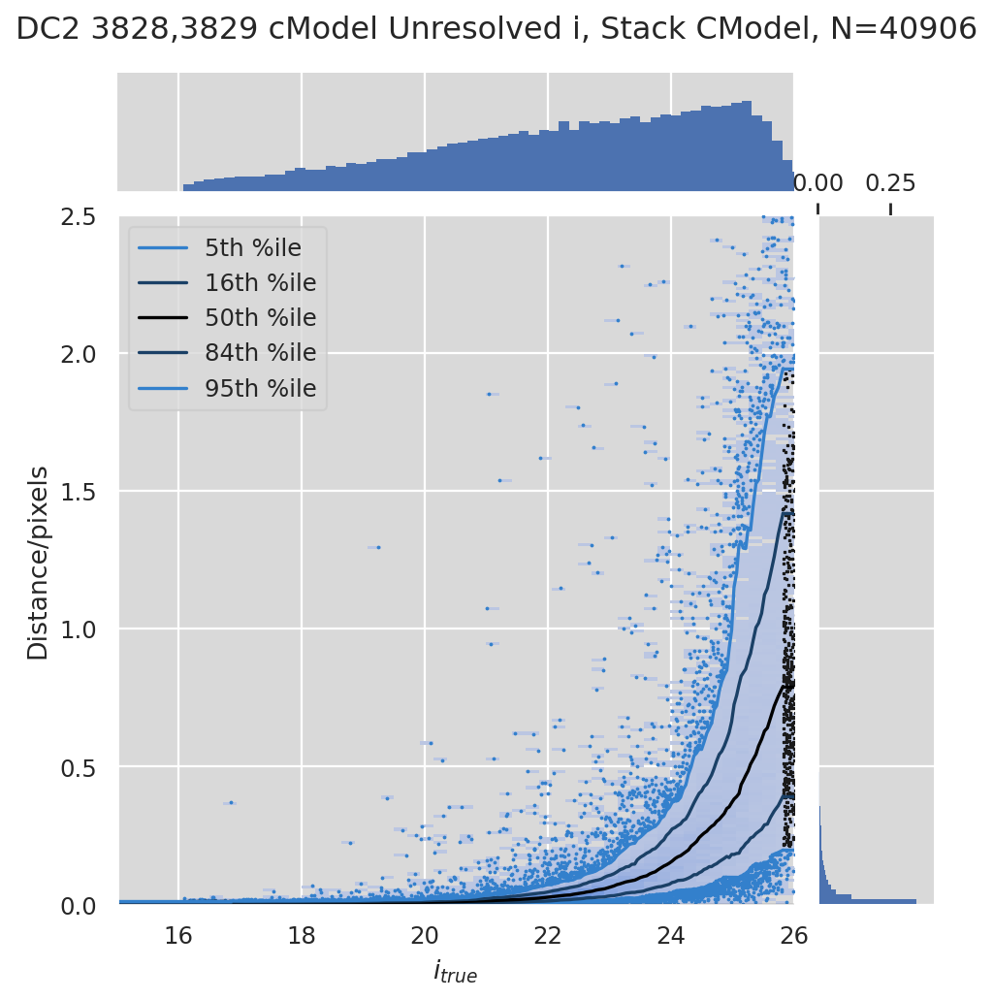

Plotting chis: DC2 3828,3829 cModel Unresolved i, Stack CModel


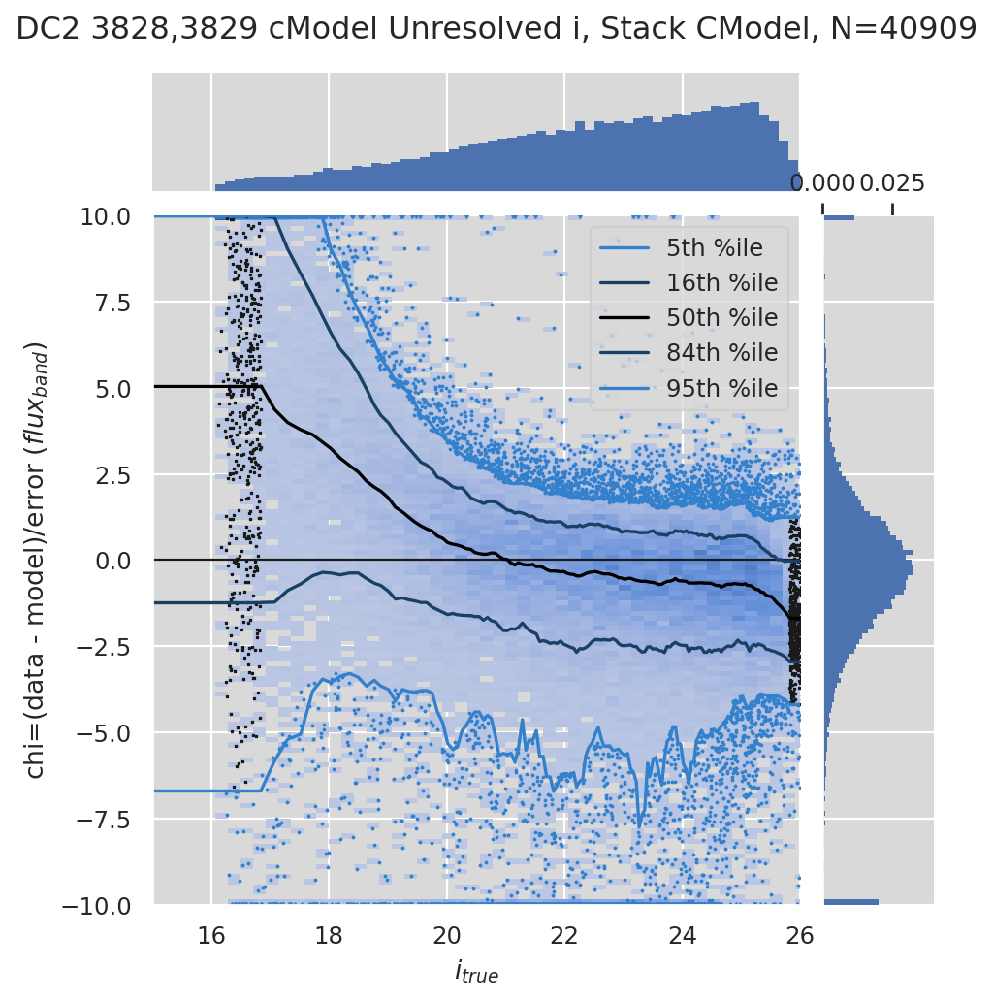

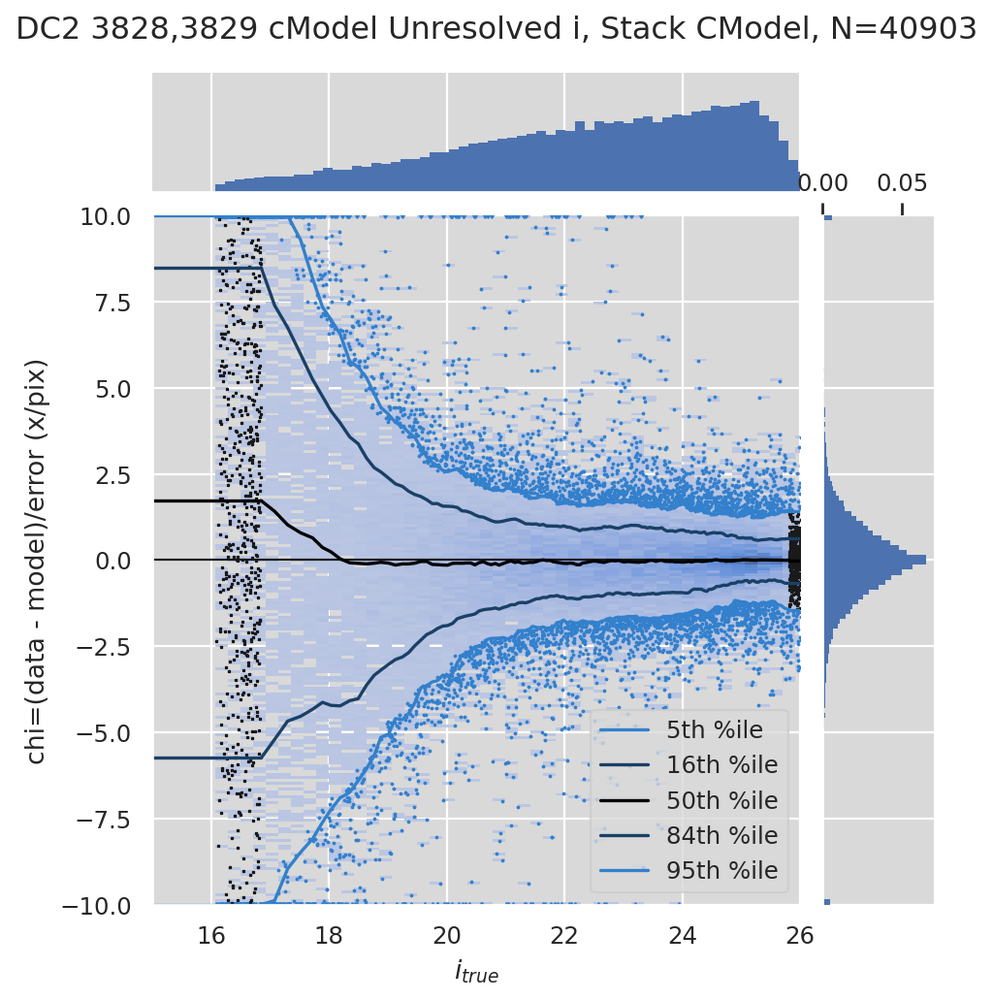

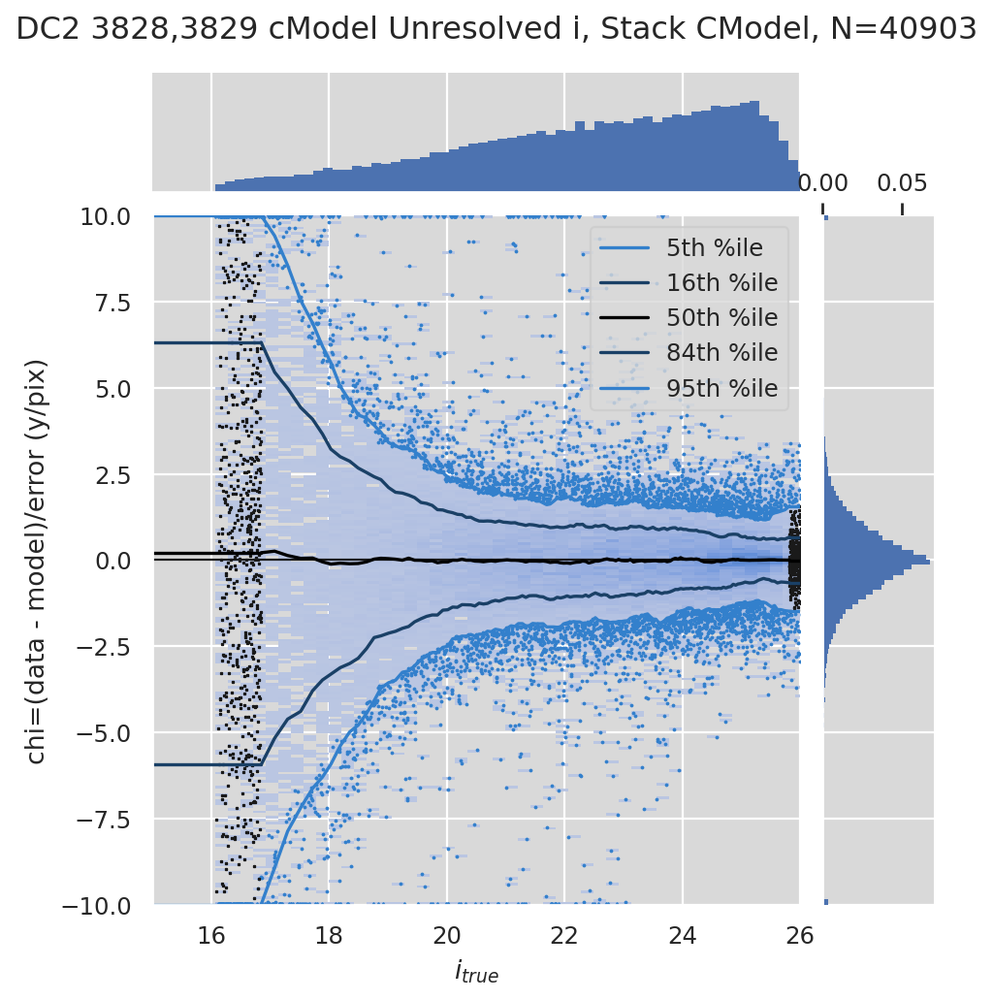

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Unresolved z, Stack CModel


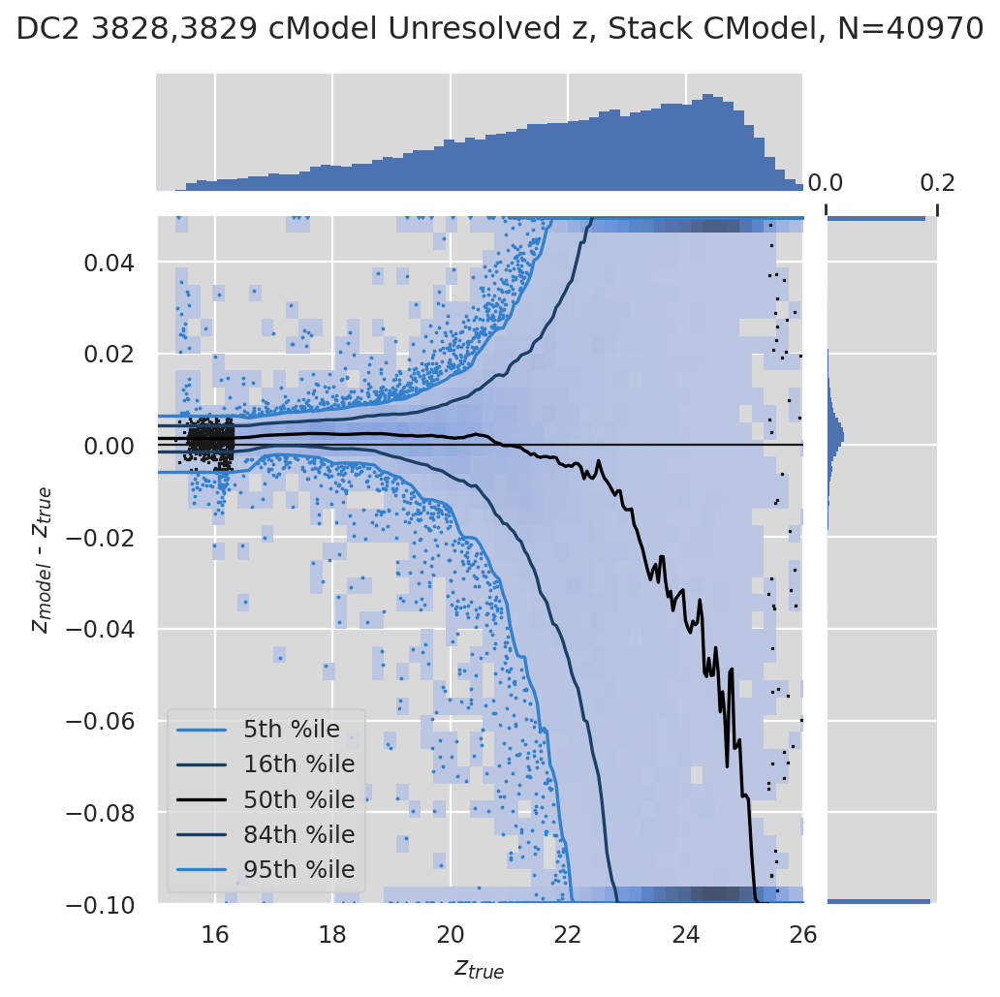

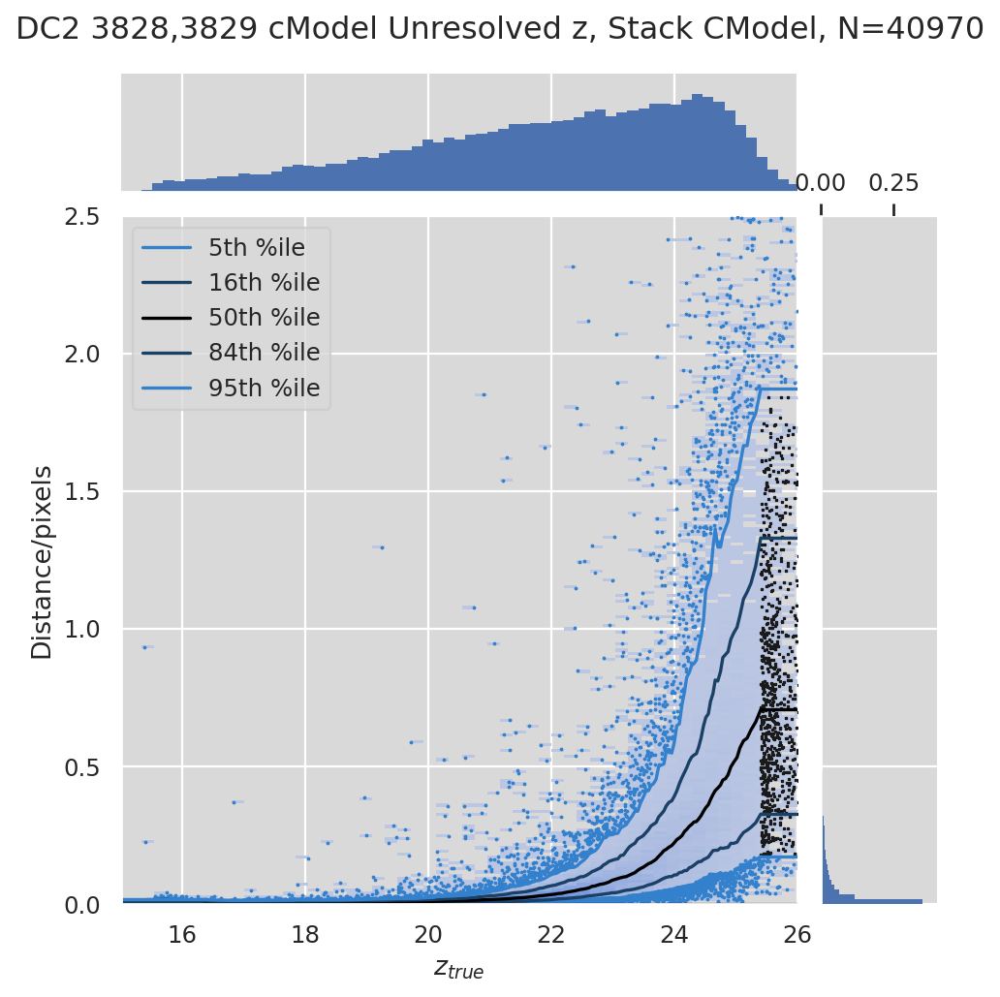

/home/dtaranu/src/mine/modelling_research/plot_matches.py:416: RuntimeWarning: divide by zero encountered in true_divide
  chi = (fluxes - model.get_flux_total(target, band).values)/sigma


Plotting chis: DC2 3828,3829 cModel Unresolved z, Stack CModel


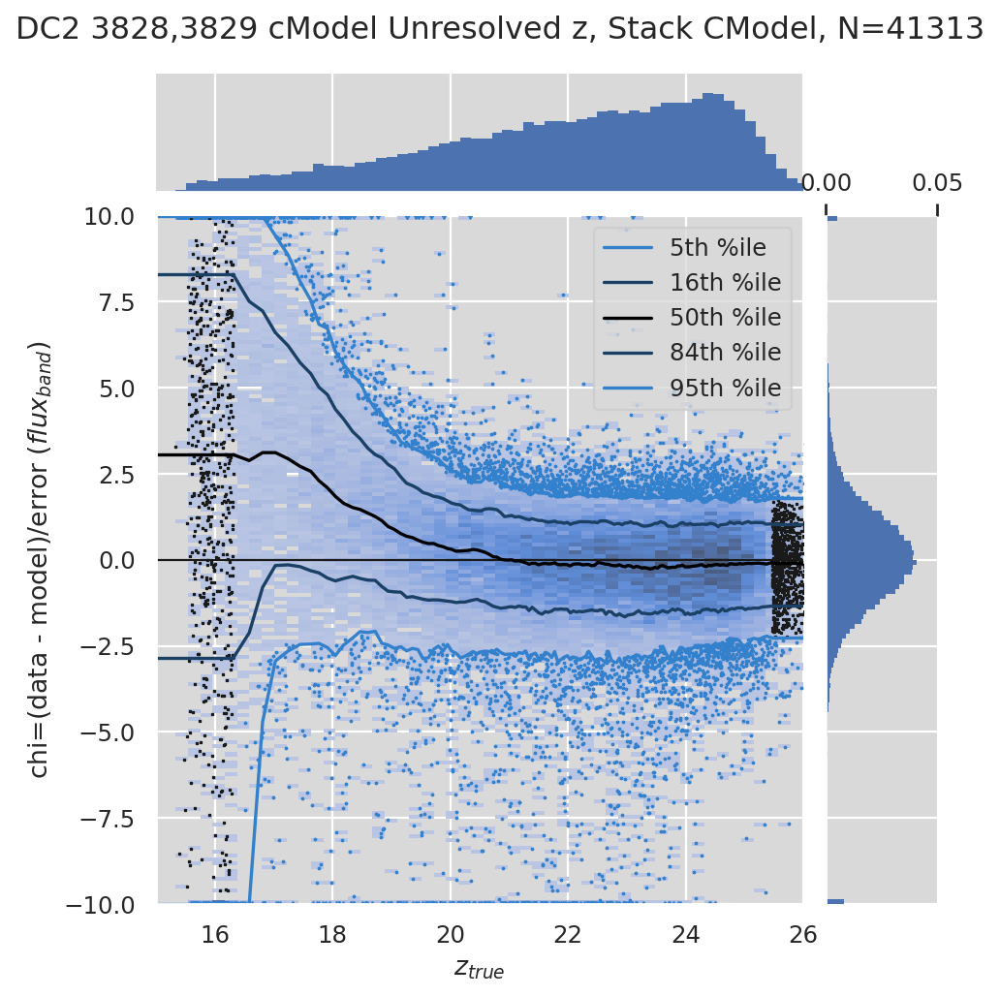

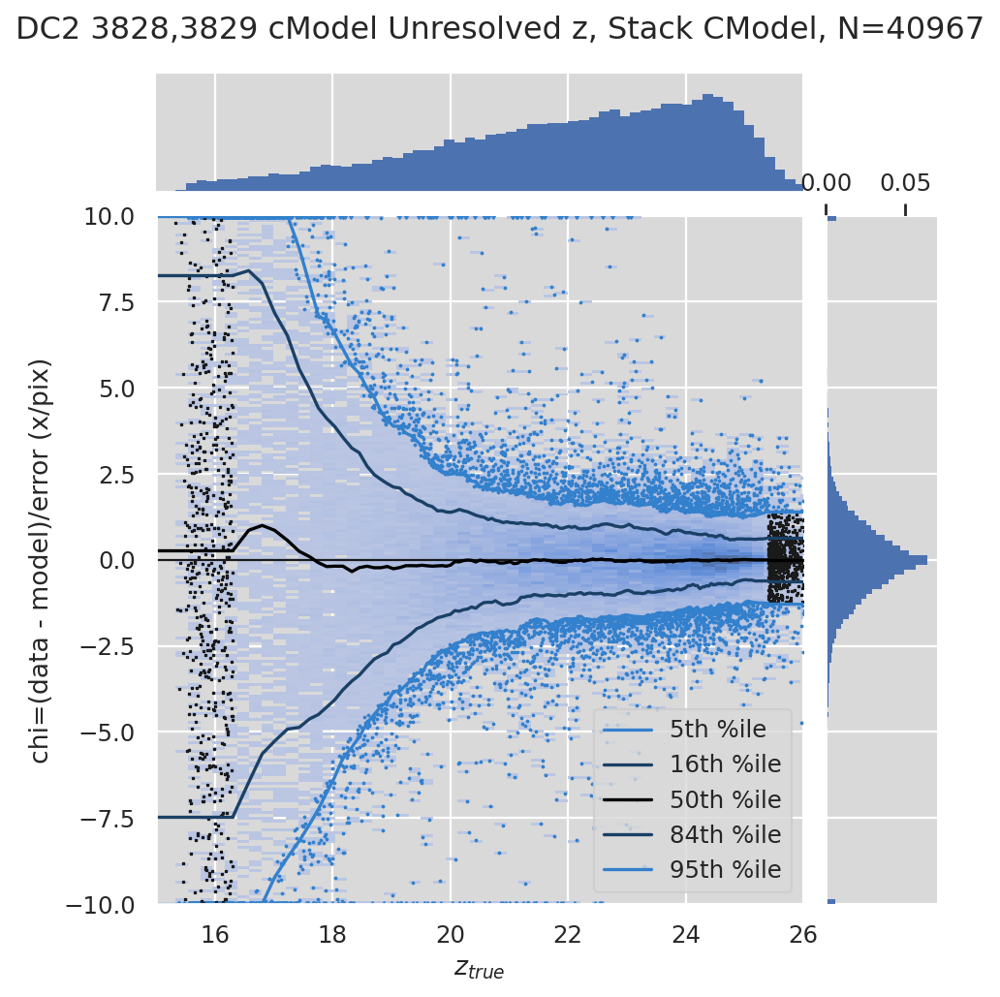

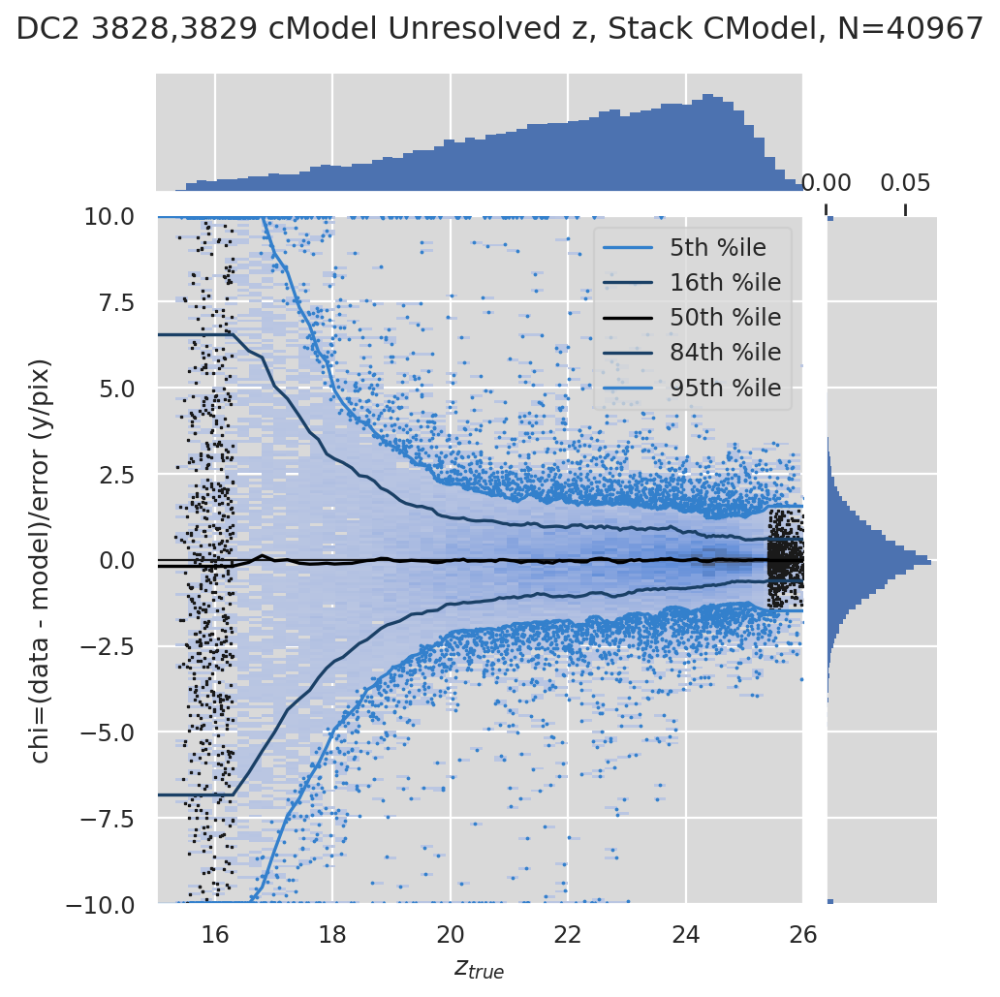

/software/lsstsw/stack_20220525/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


Plotting diffs: DC2 3828,3829 cModel Unresolved y, Stack CModel


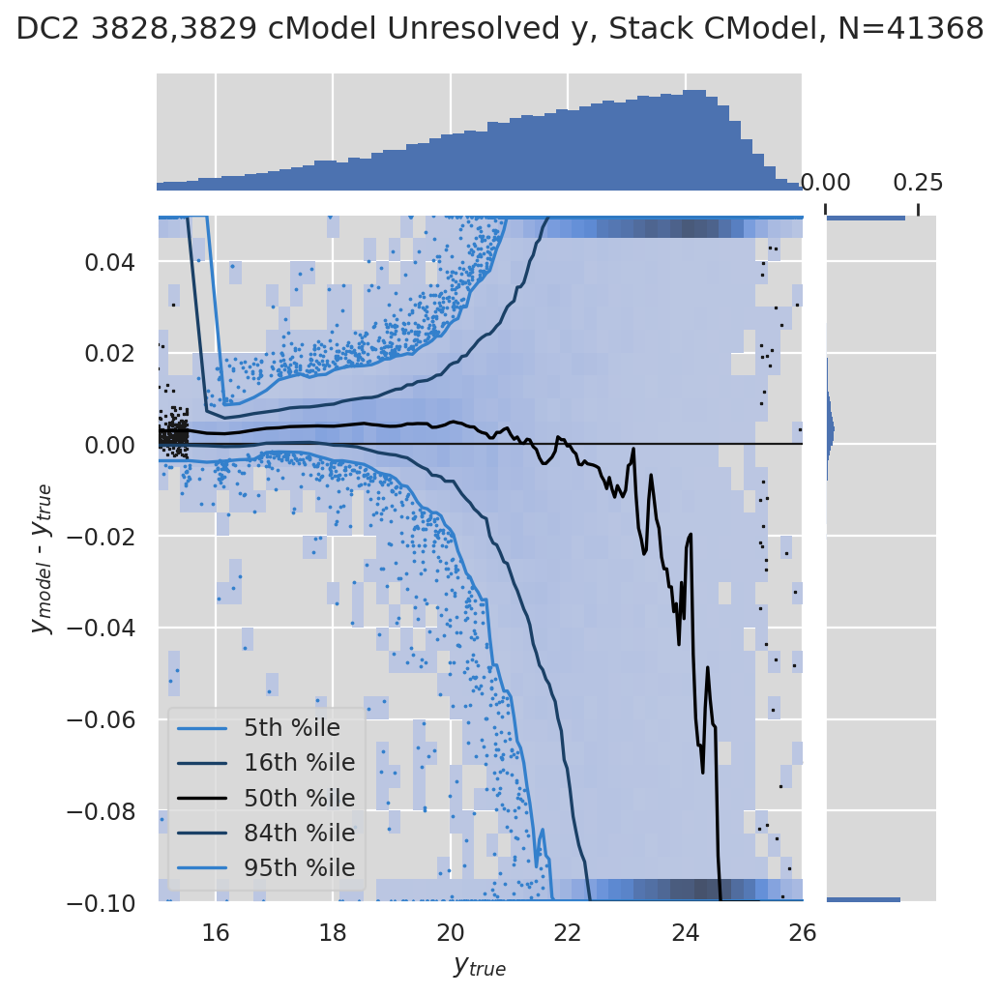

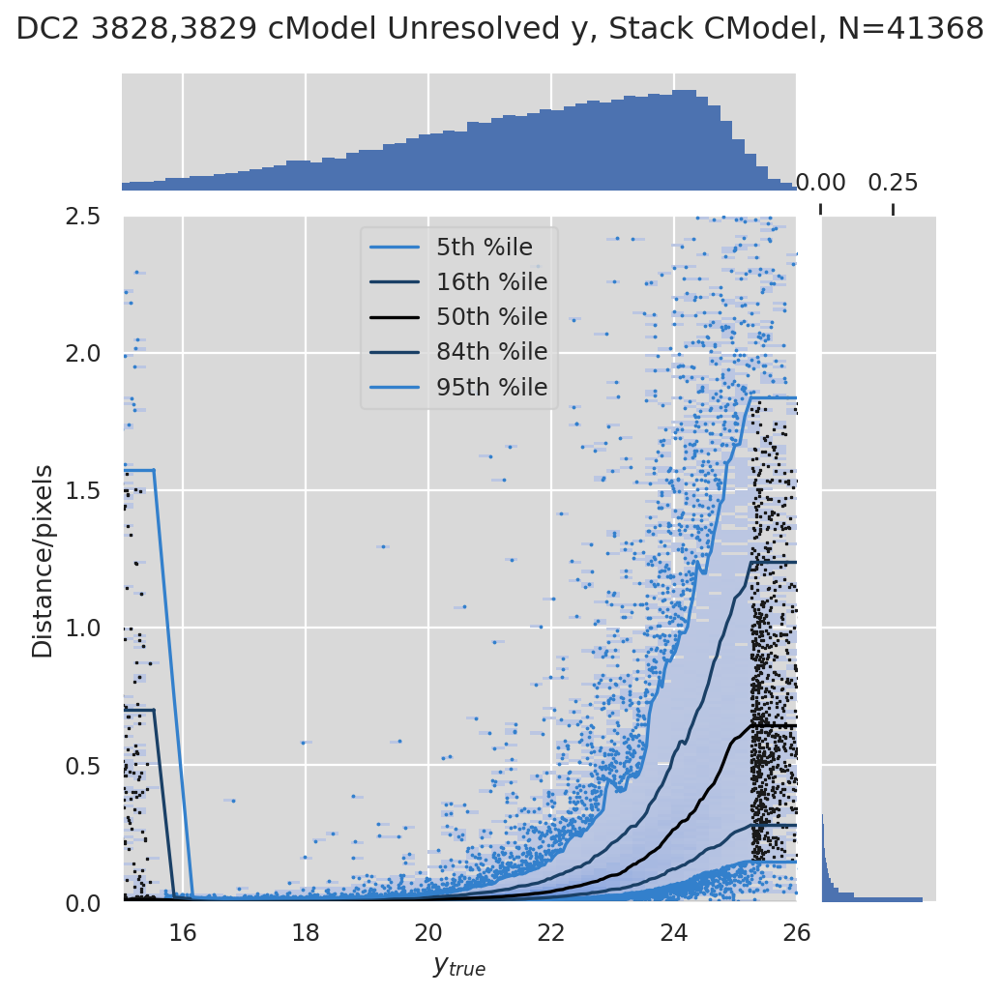

Plotting chis: DC2 3828,3829 cModel Unresolved y, Stack CModel


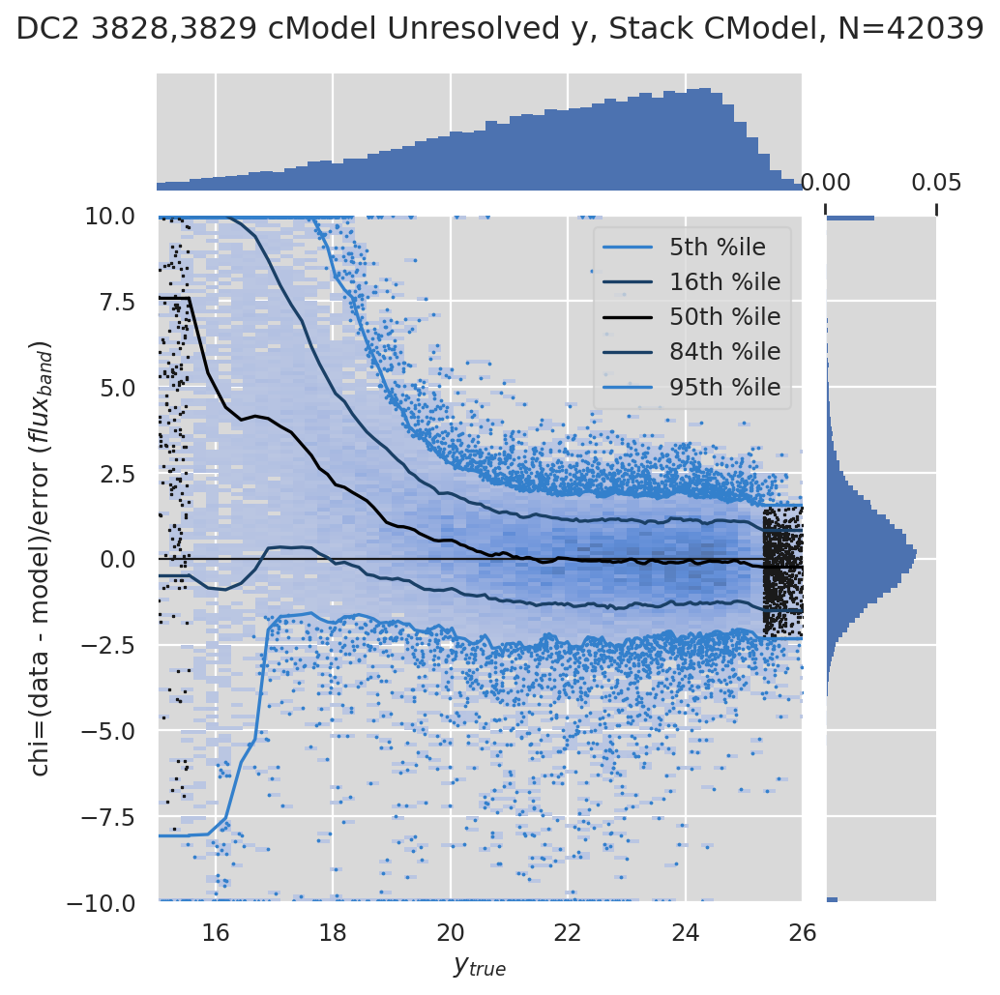

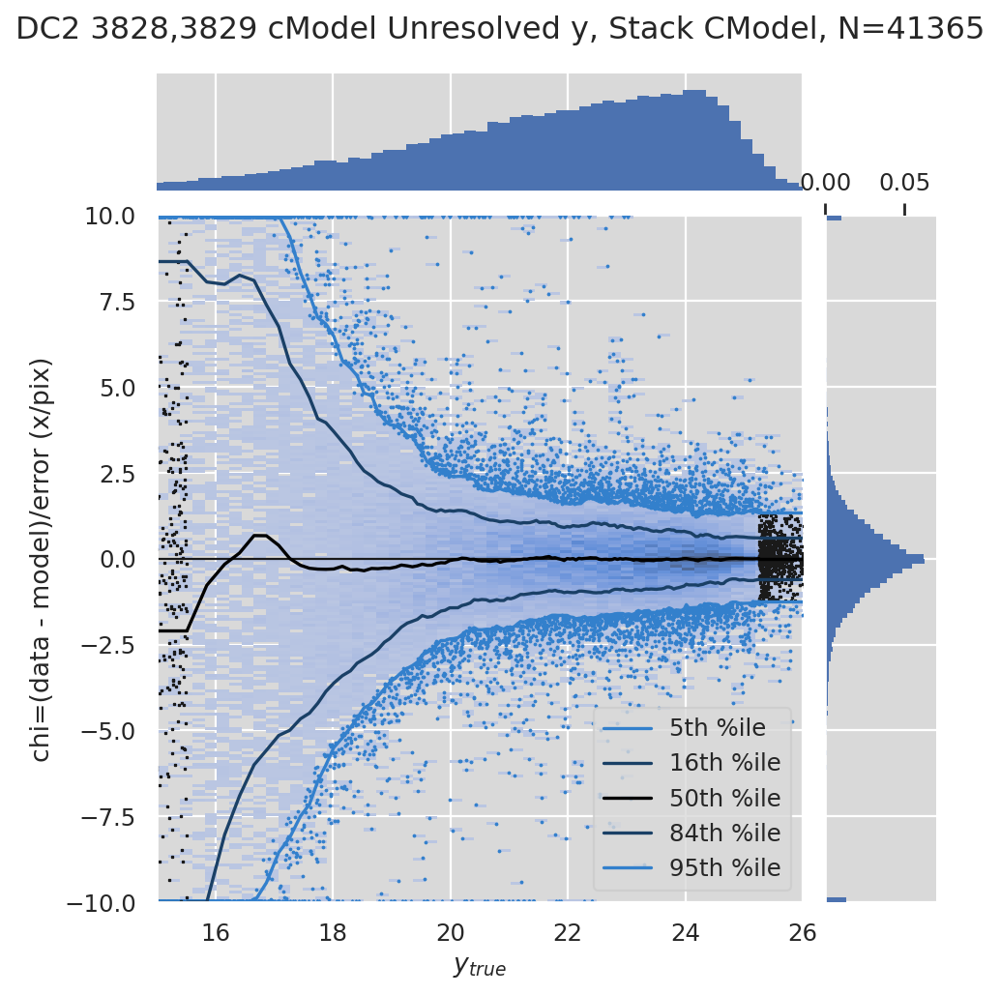

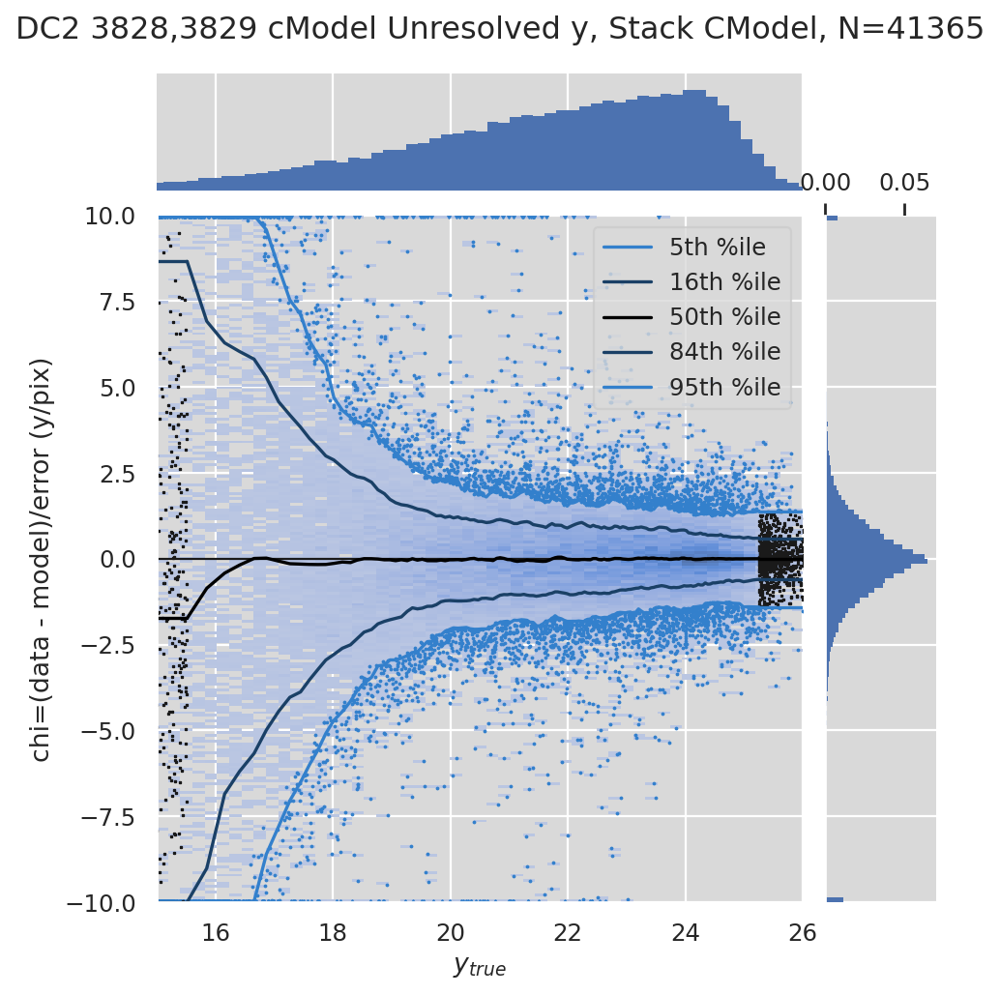

Plotting color diffs: DC2 3828,3829 cModel Unresolved u-g, Stack CModel


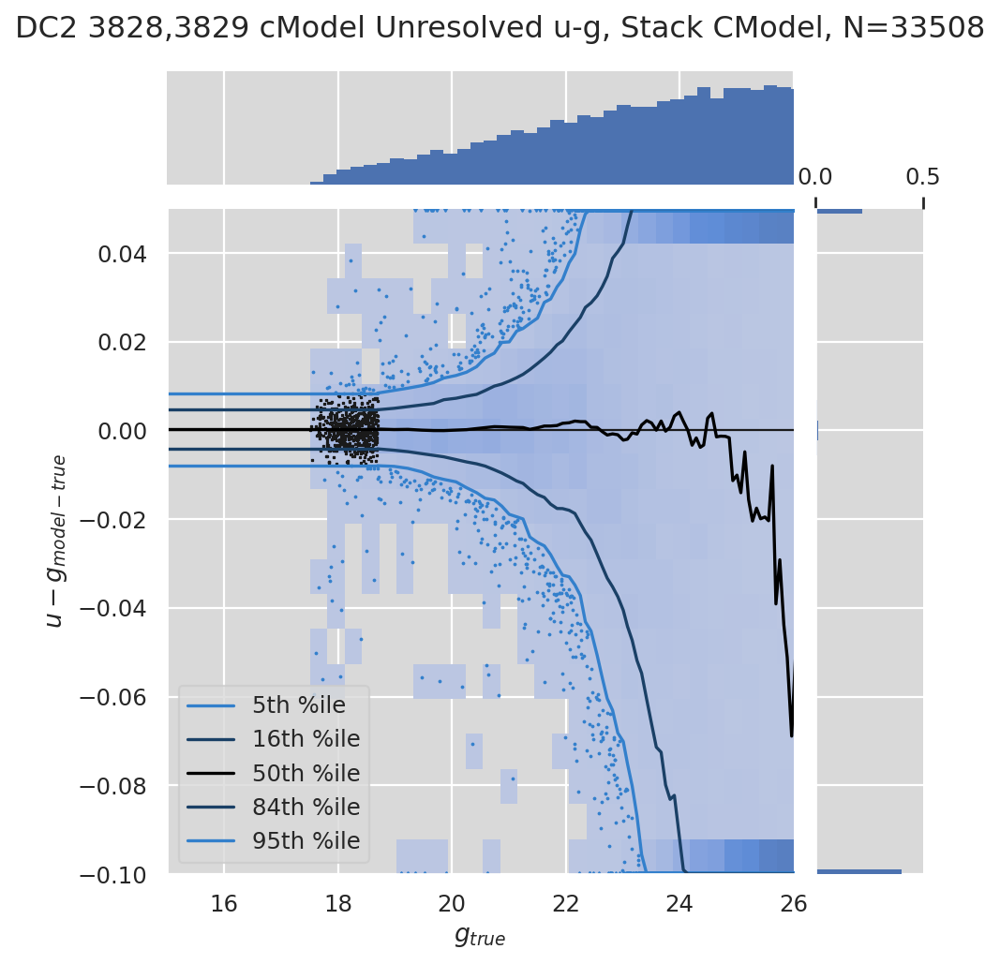

Plotting color chis: DC2 3828,3829 cModel Unresolved u-g, Stack CModel


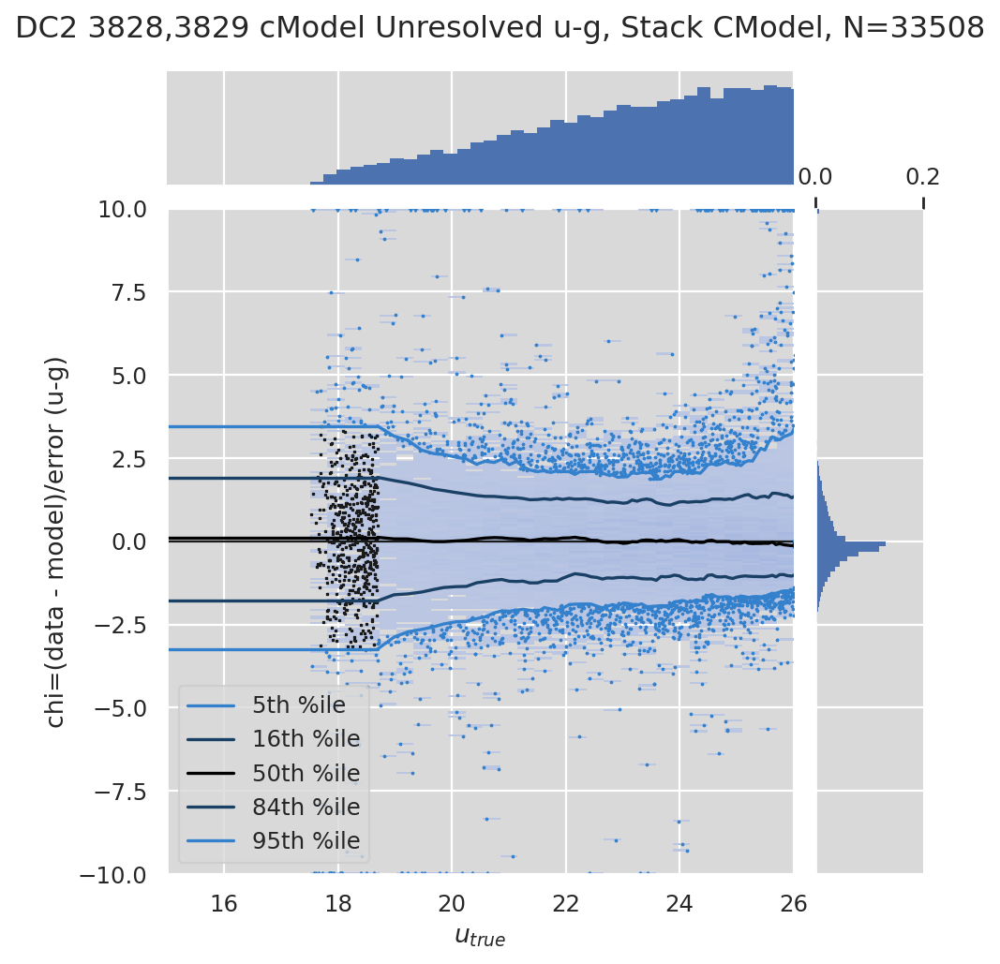

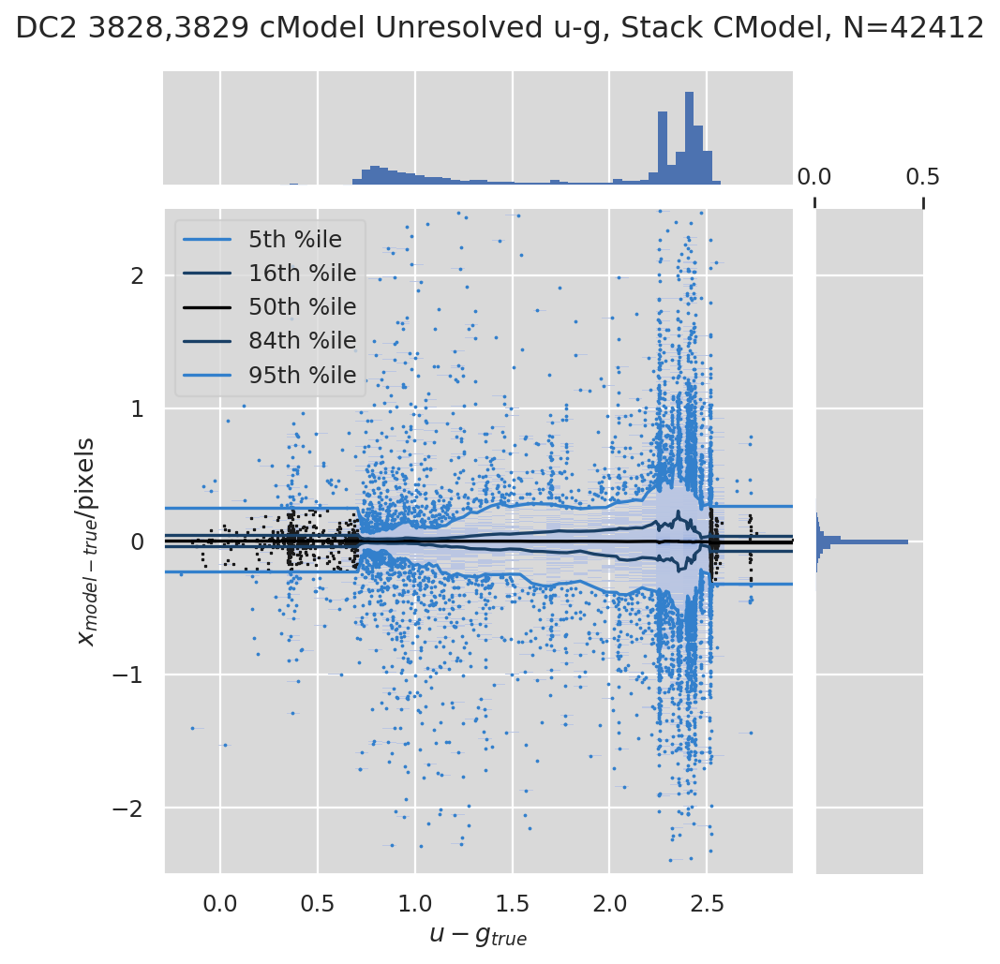

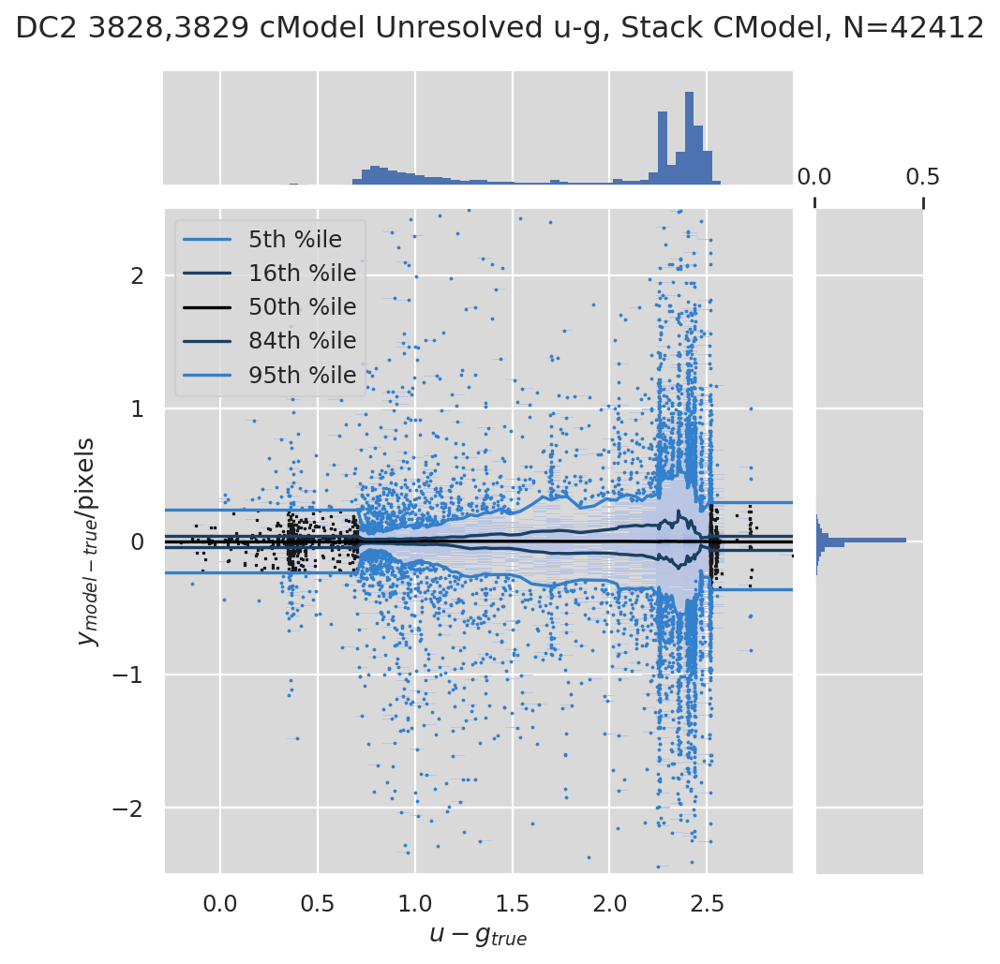

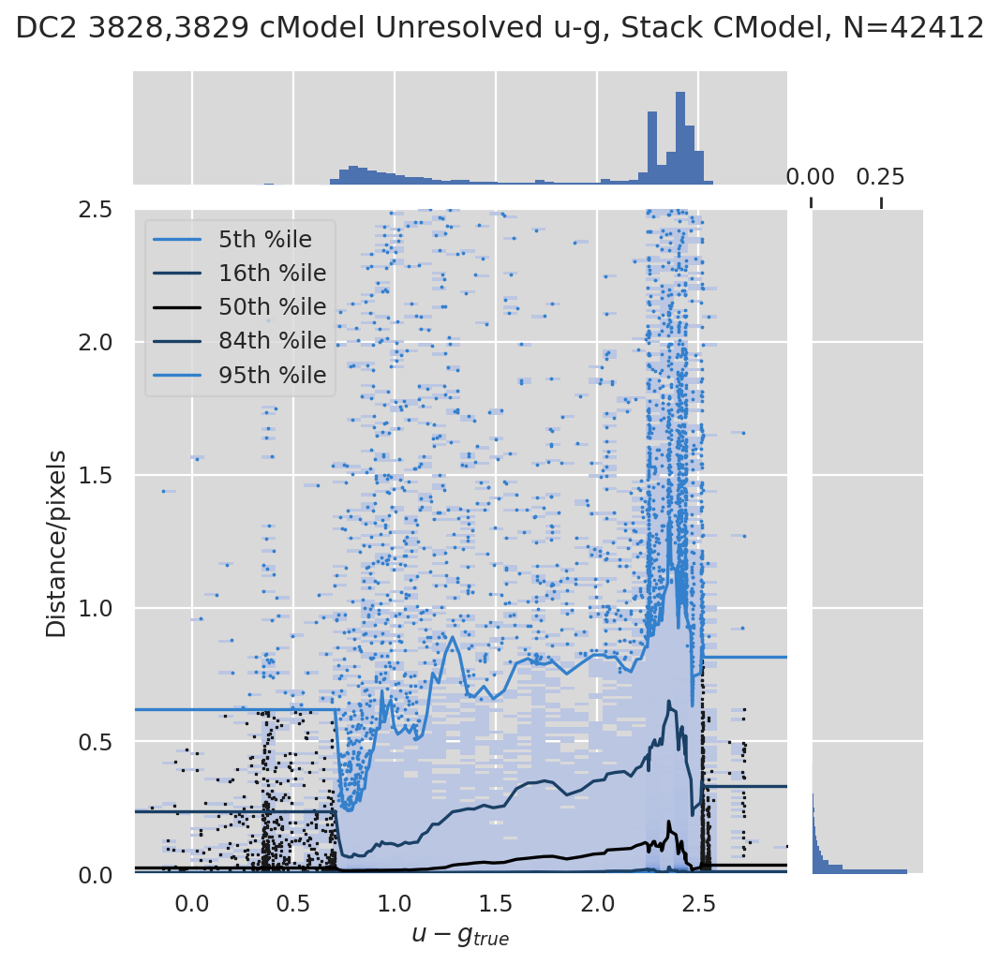

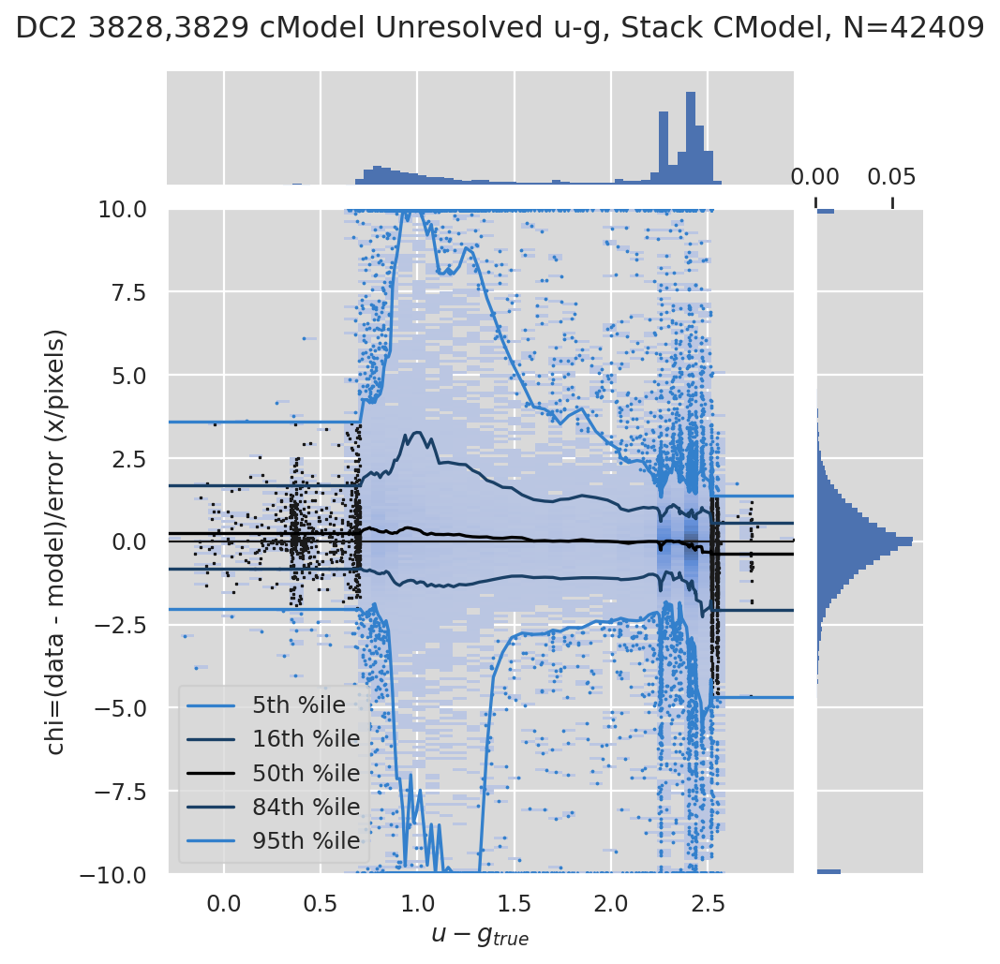

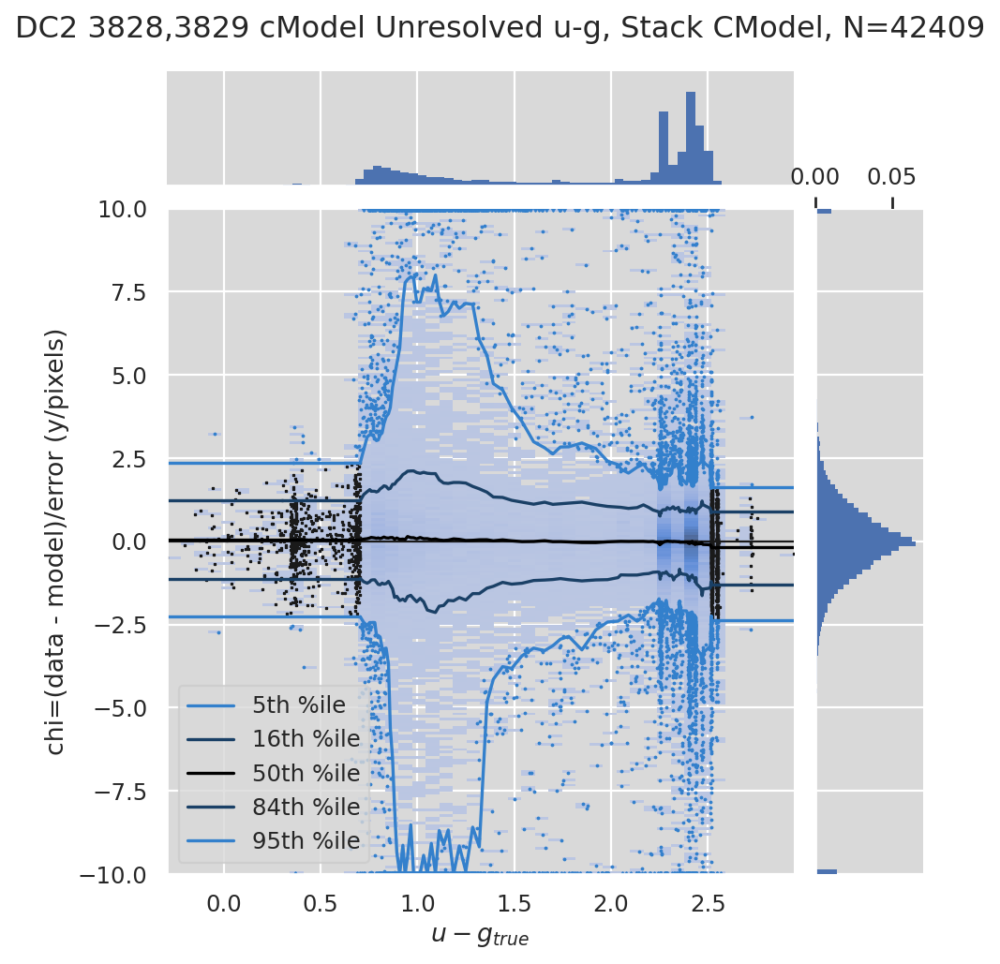

Plotting color diffs: DC2 3828,3829 cModel Unresolved g-r, Stack CModel


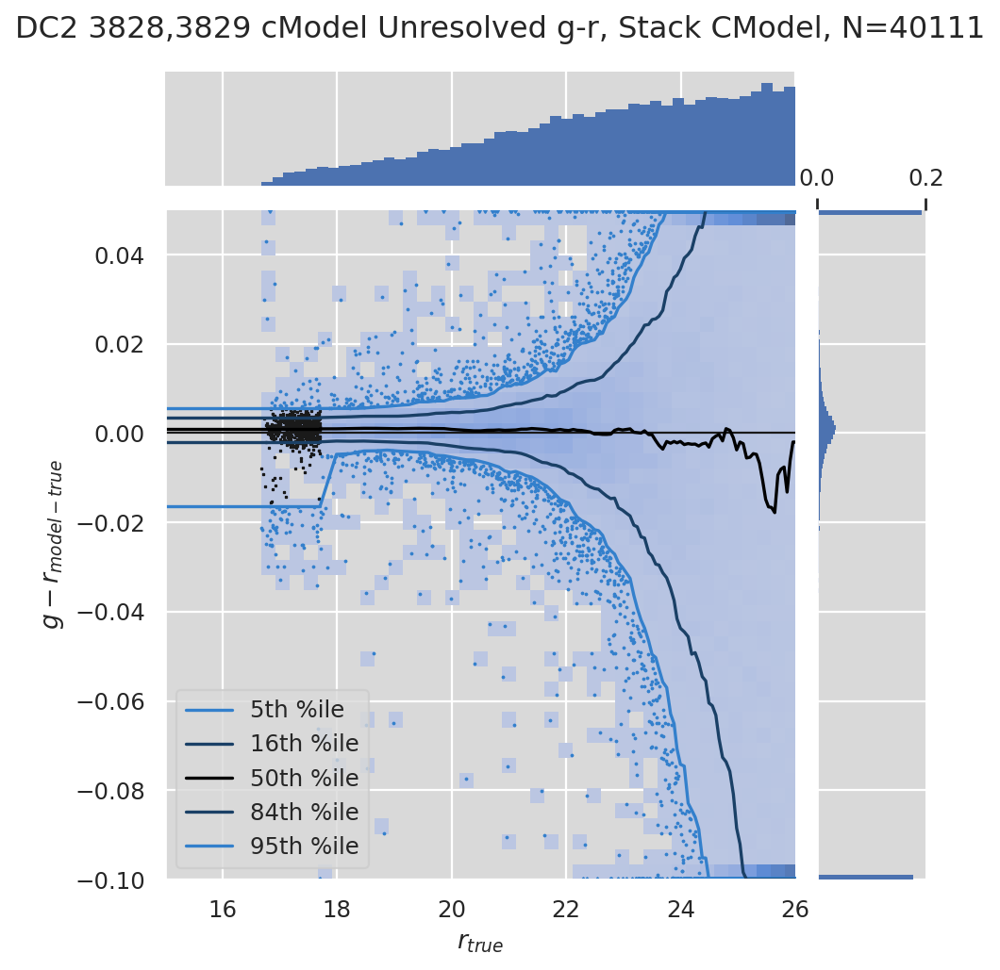

Plotting color chis: DC2 3828,3829 cModel Unresolved g-r, Stack CModel


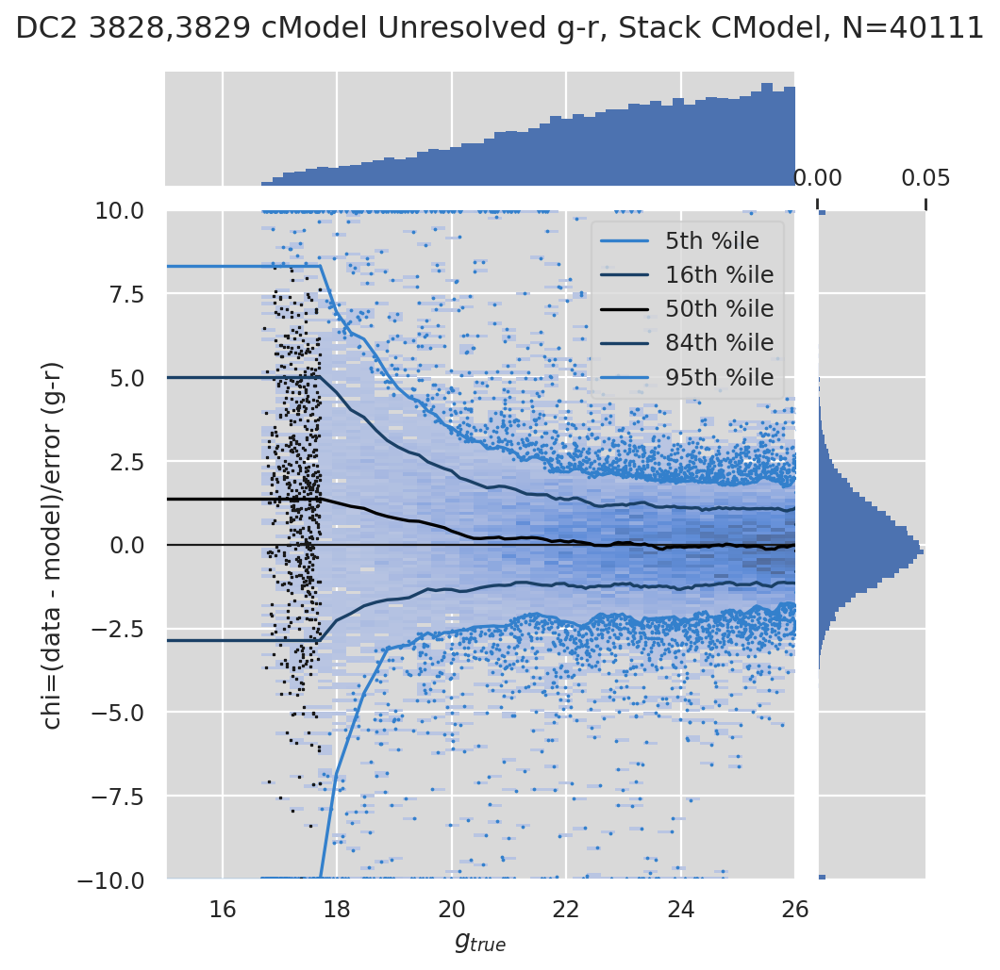

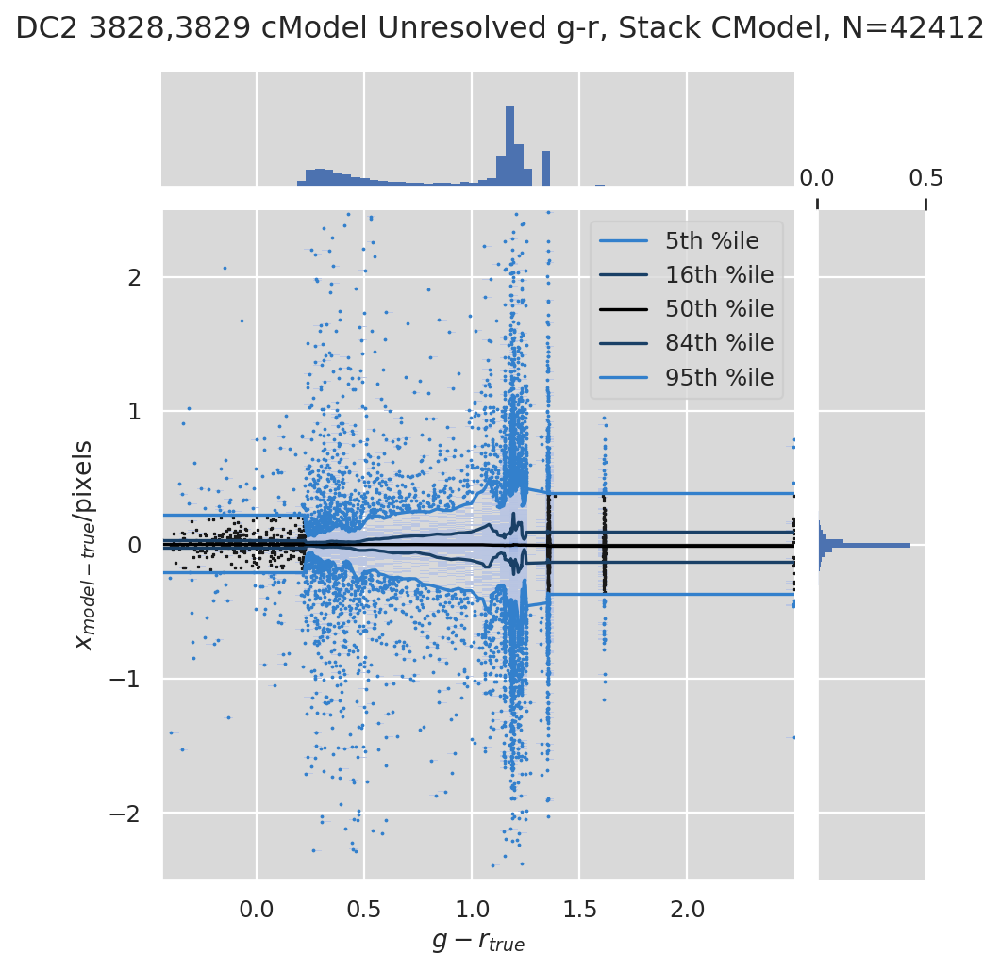

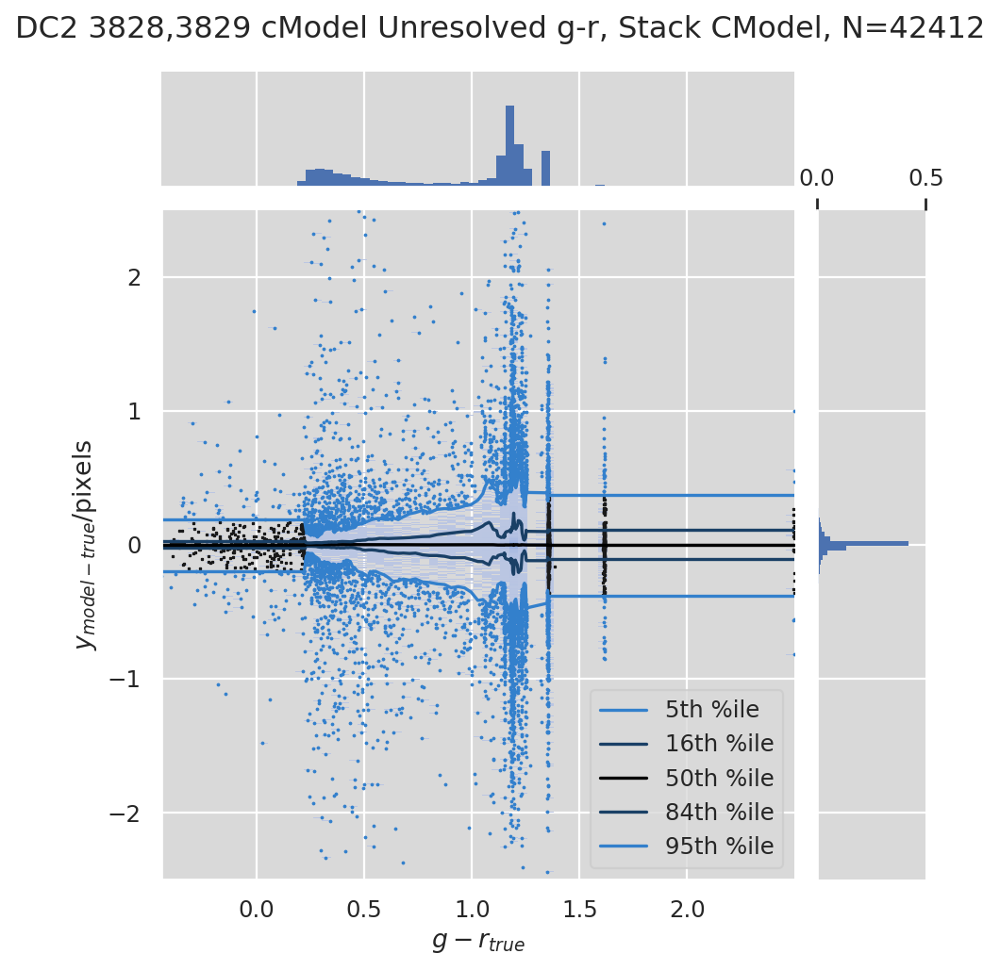

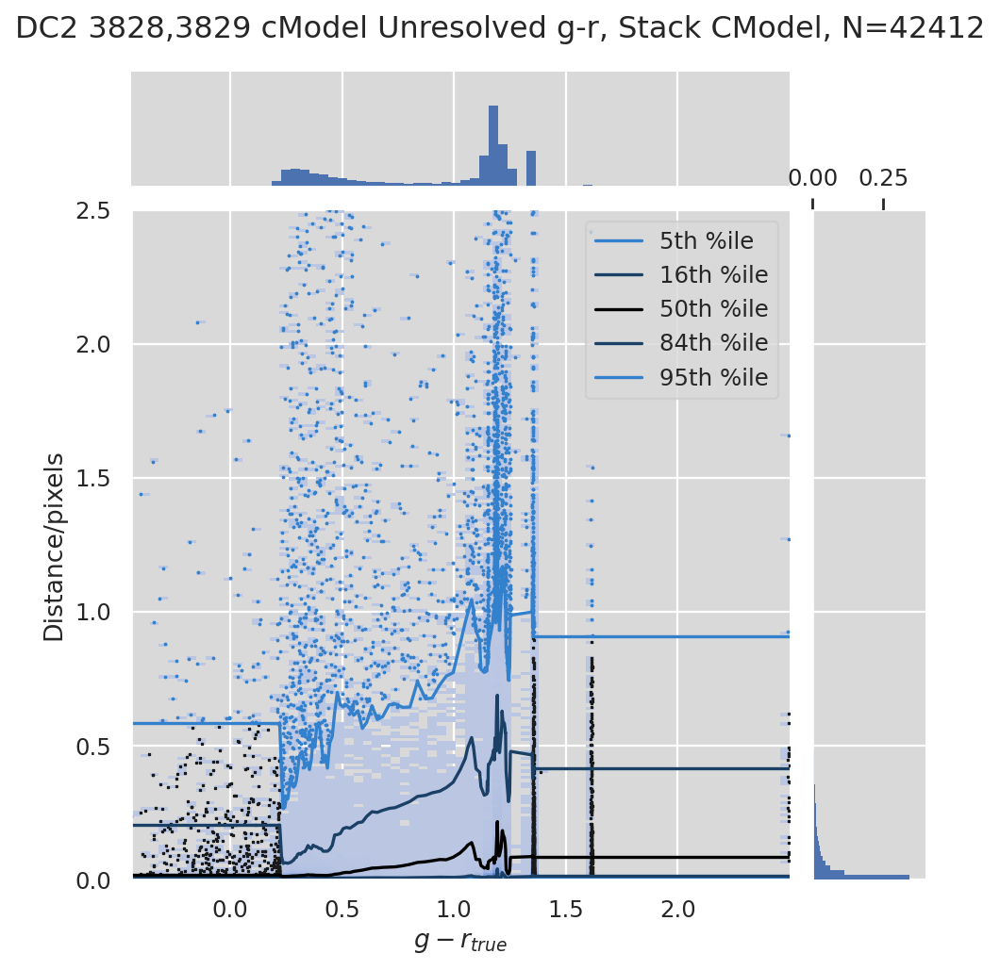

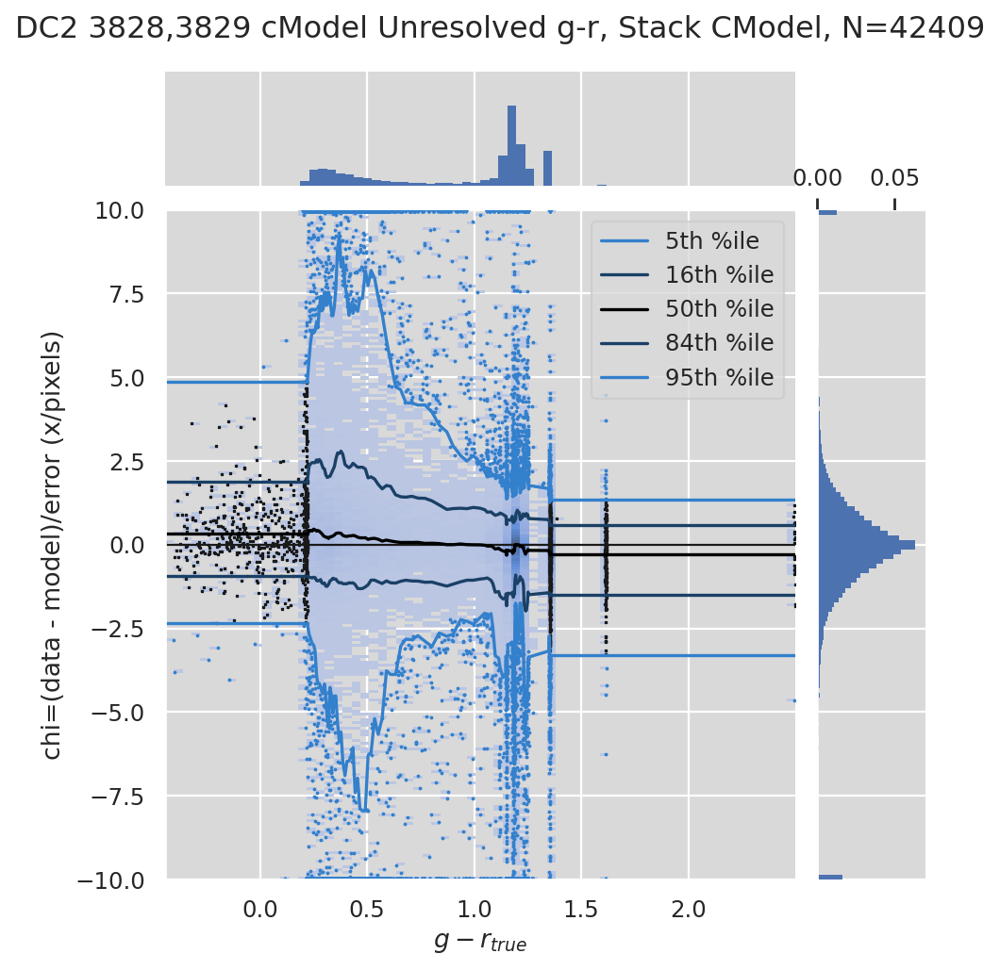

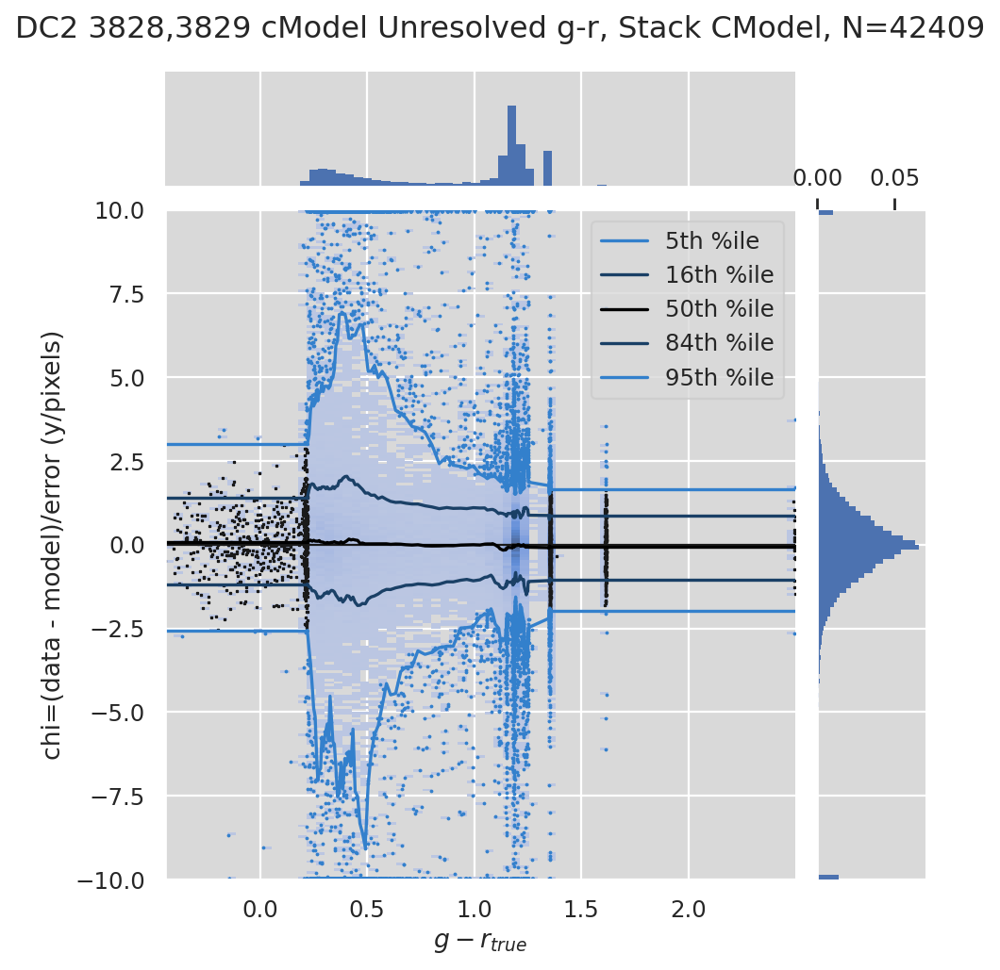

Plotting color diffs: DC2 3828,3829 cModel Unresolved r-i, Stack CModel


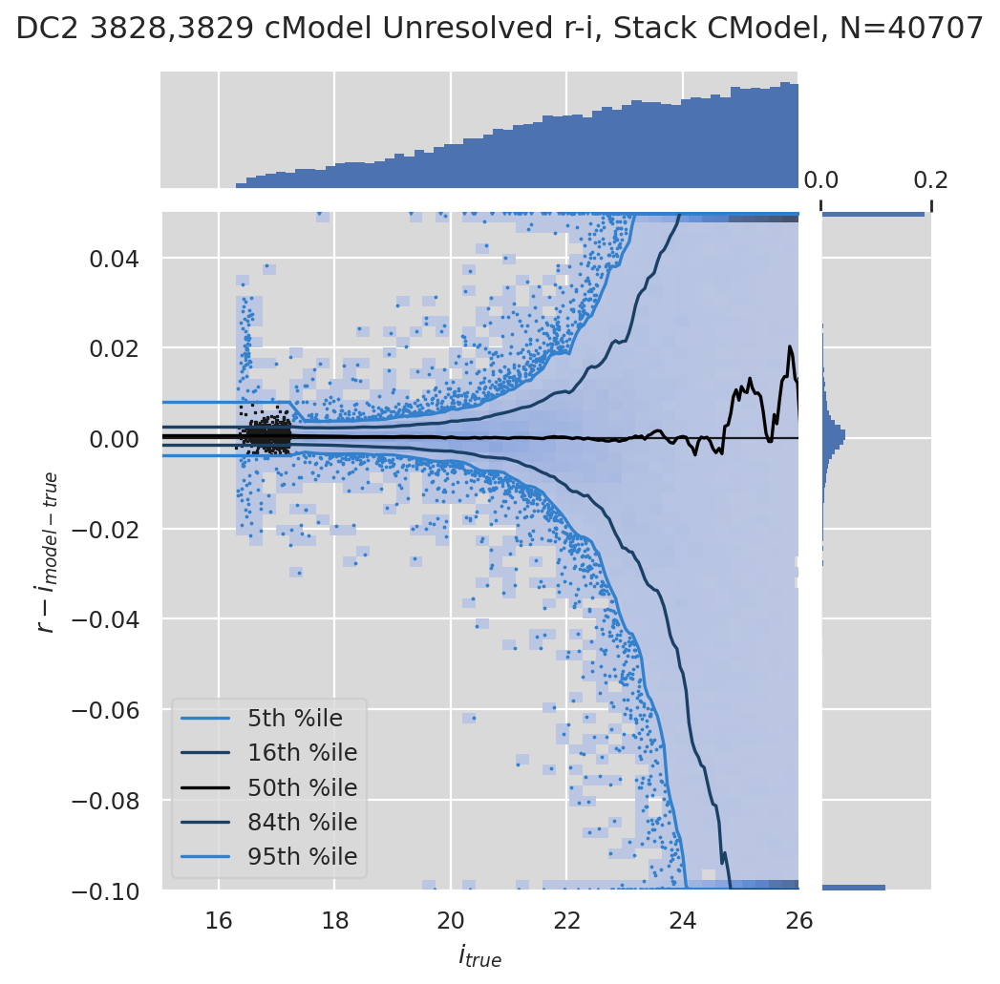

Plotting color chis: DC2 3828,3829 cModel Unresolved r-i, Stack CModel


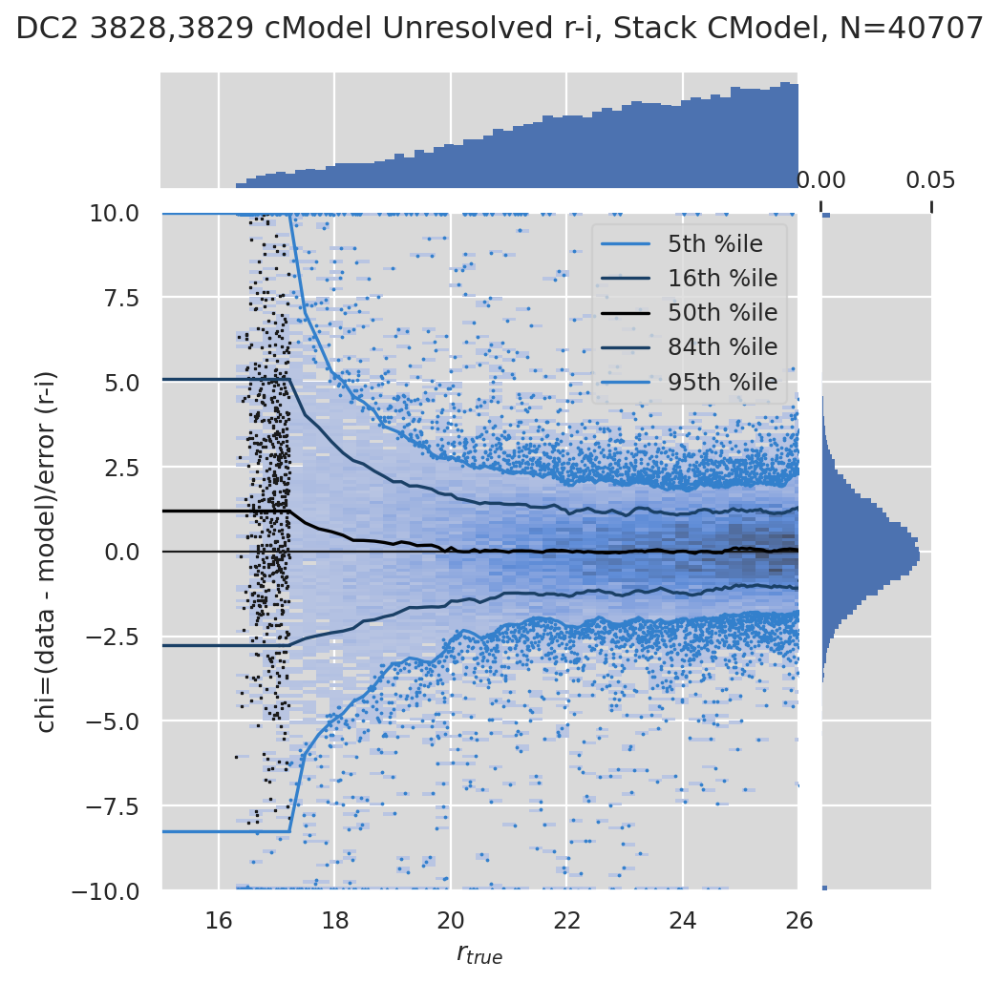

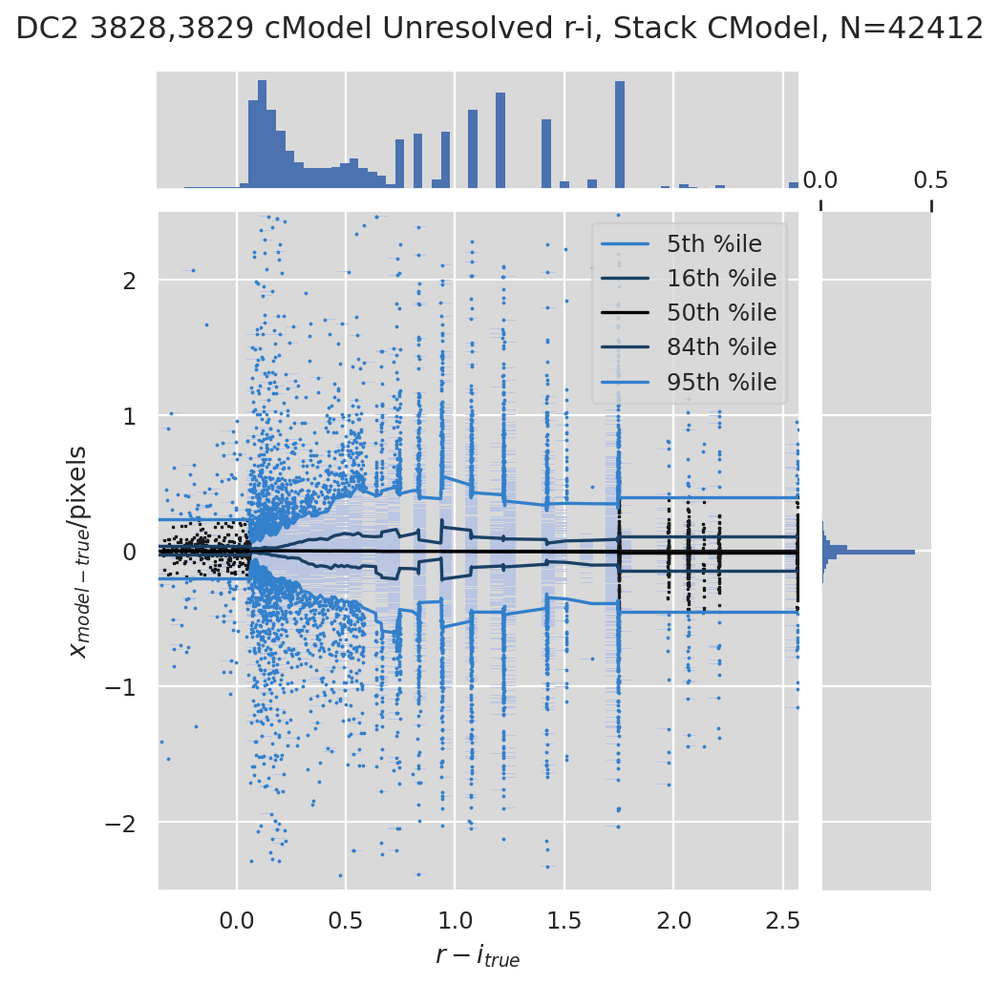

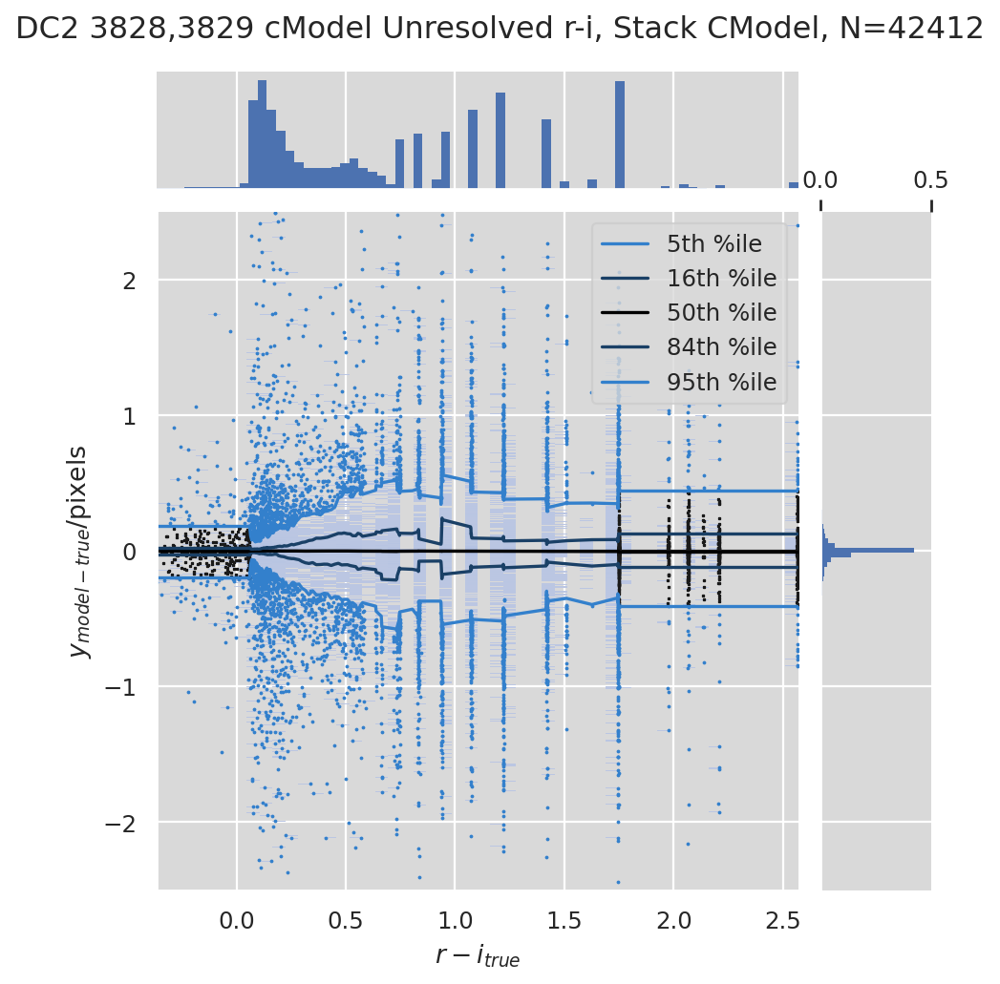

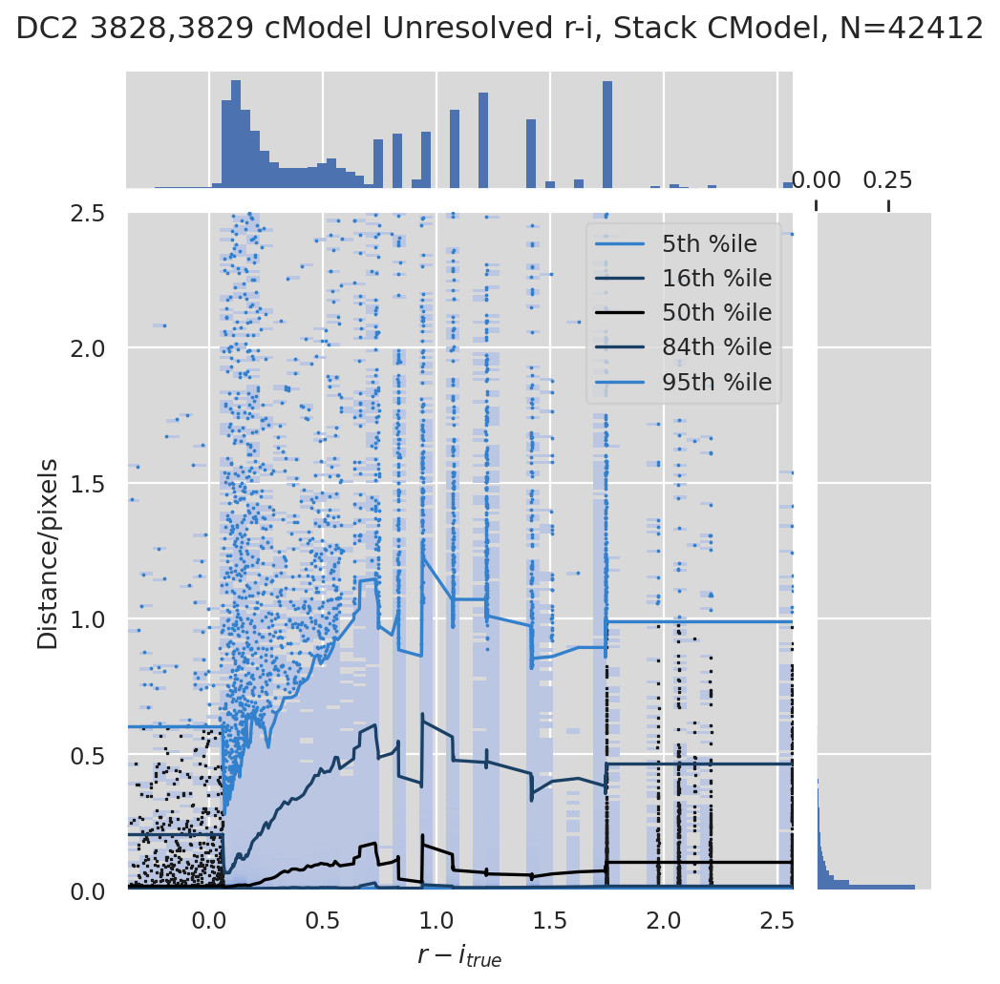

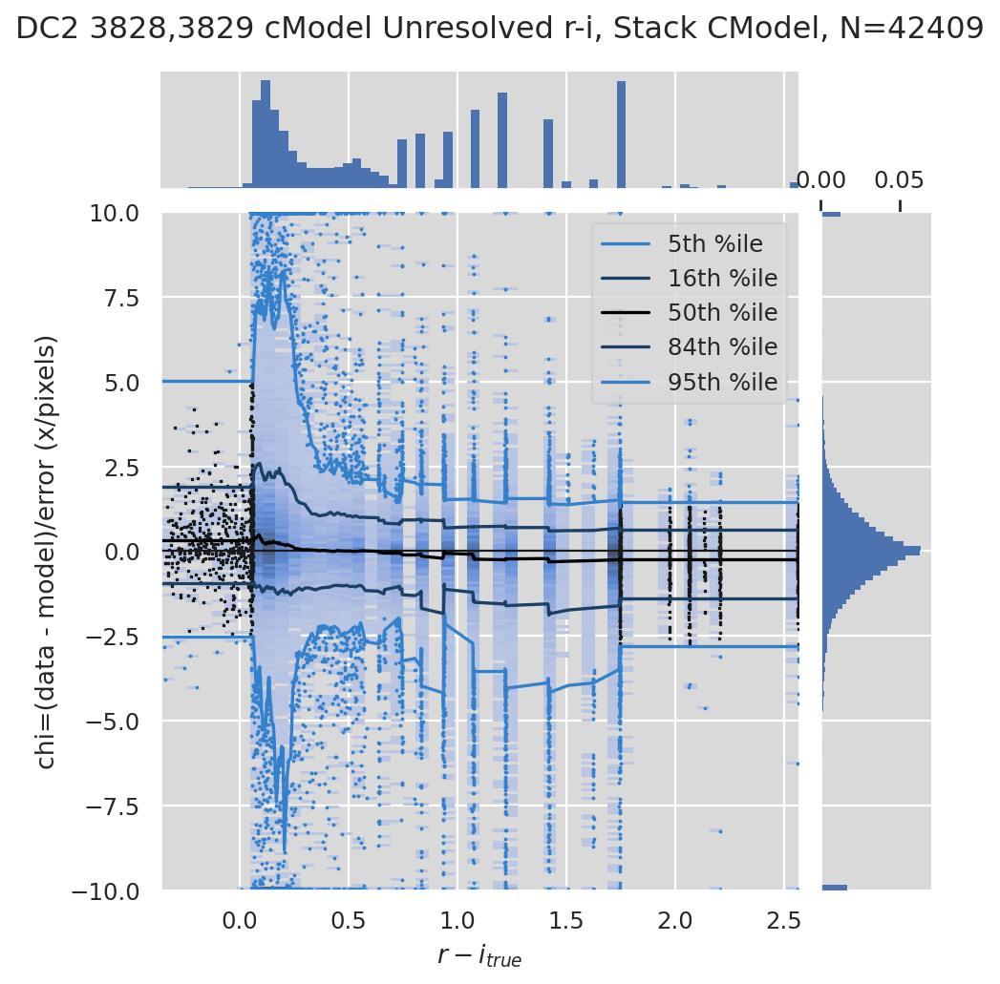

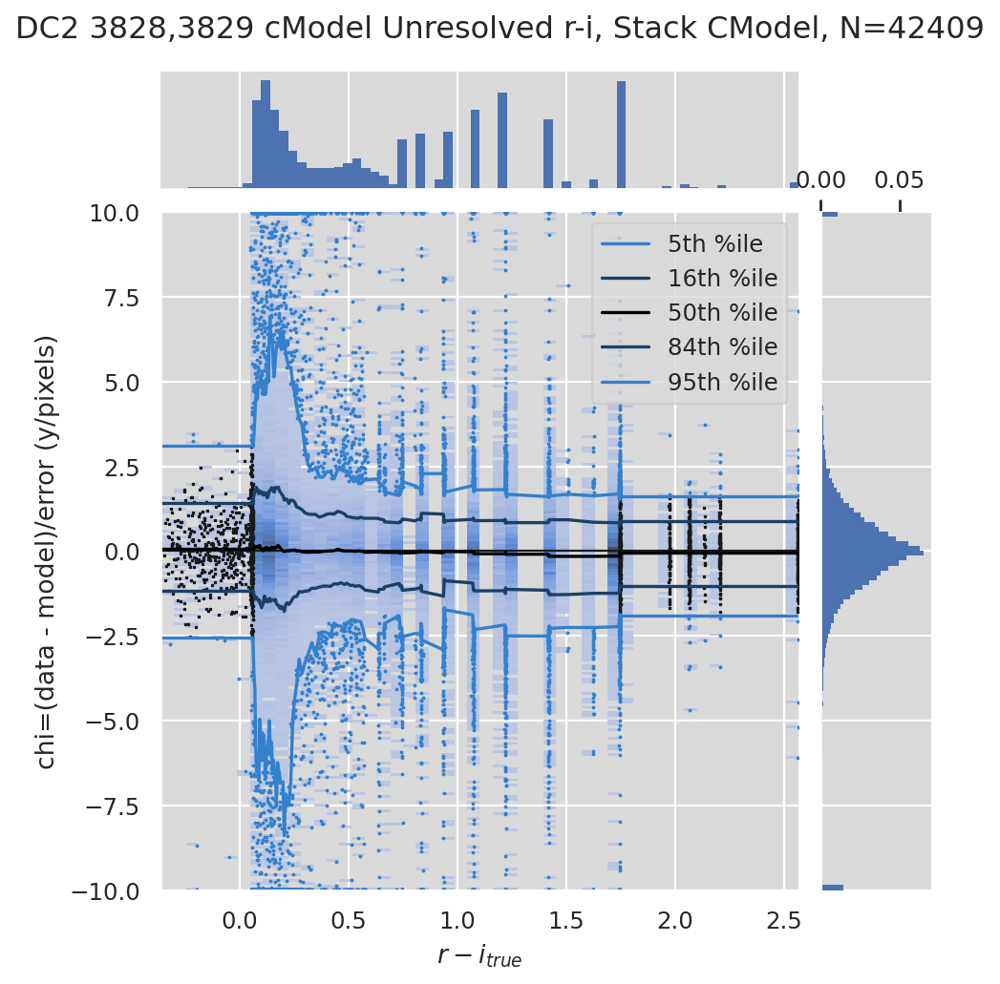

Plotting color diffs: DC2 3828,3829 cModel Unresolved i-z, Stack CModel


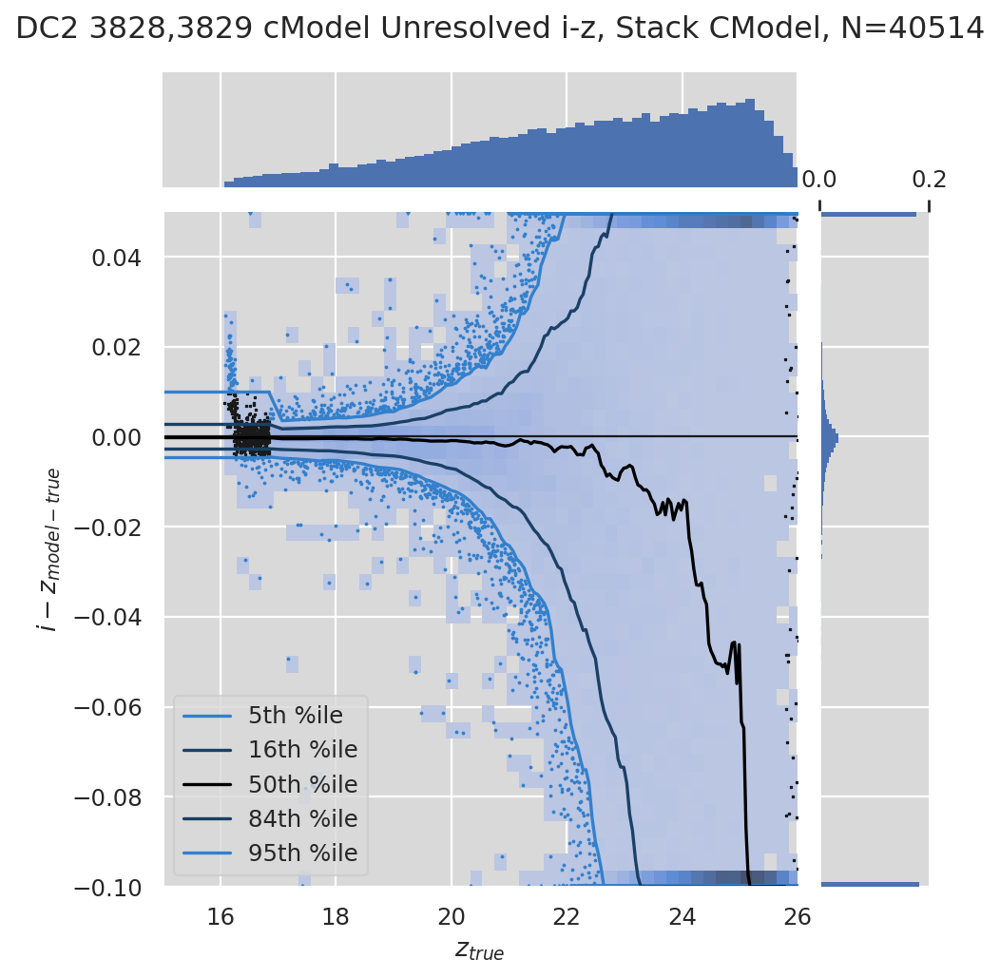

Plotting color chis: DC2 3828,3829 cModel Unresolved i-z, Stack CModel


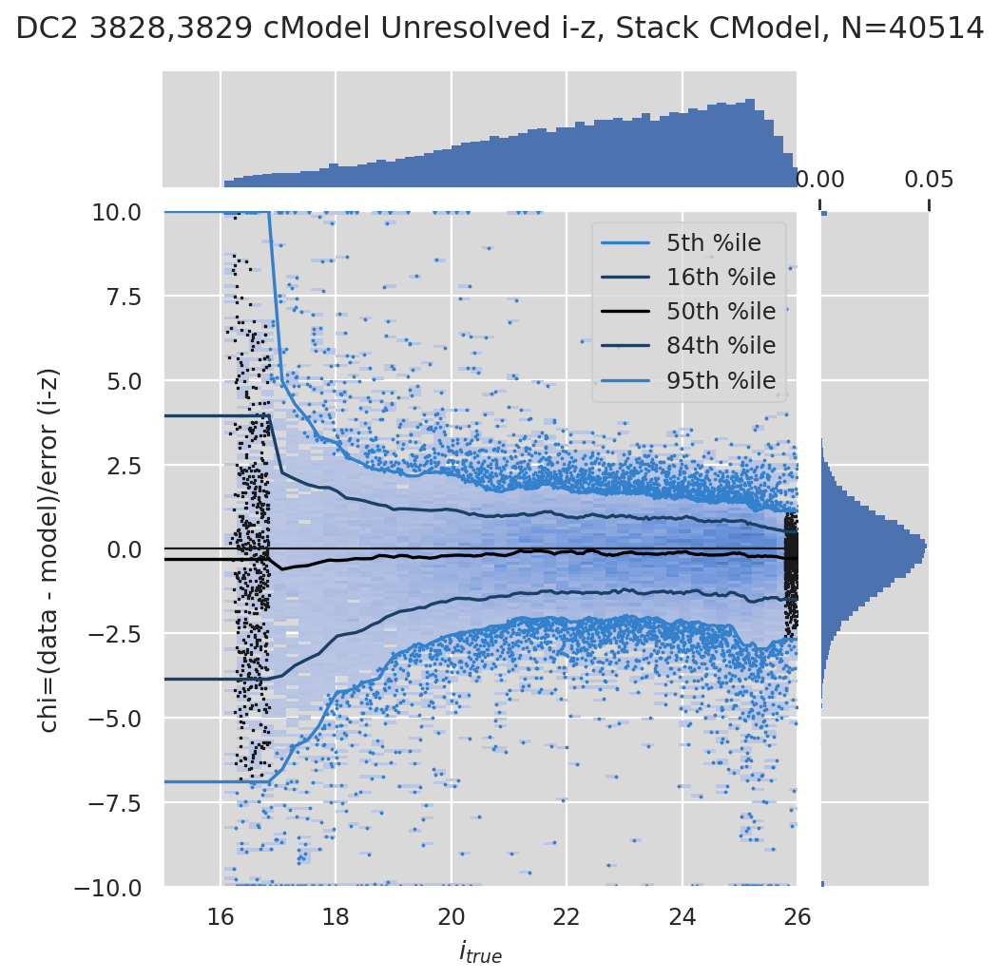

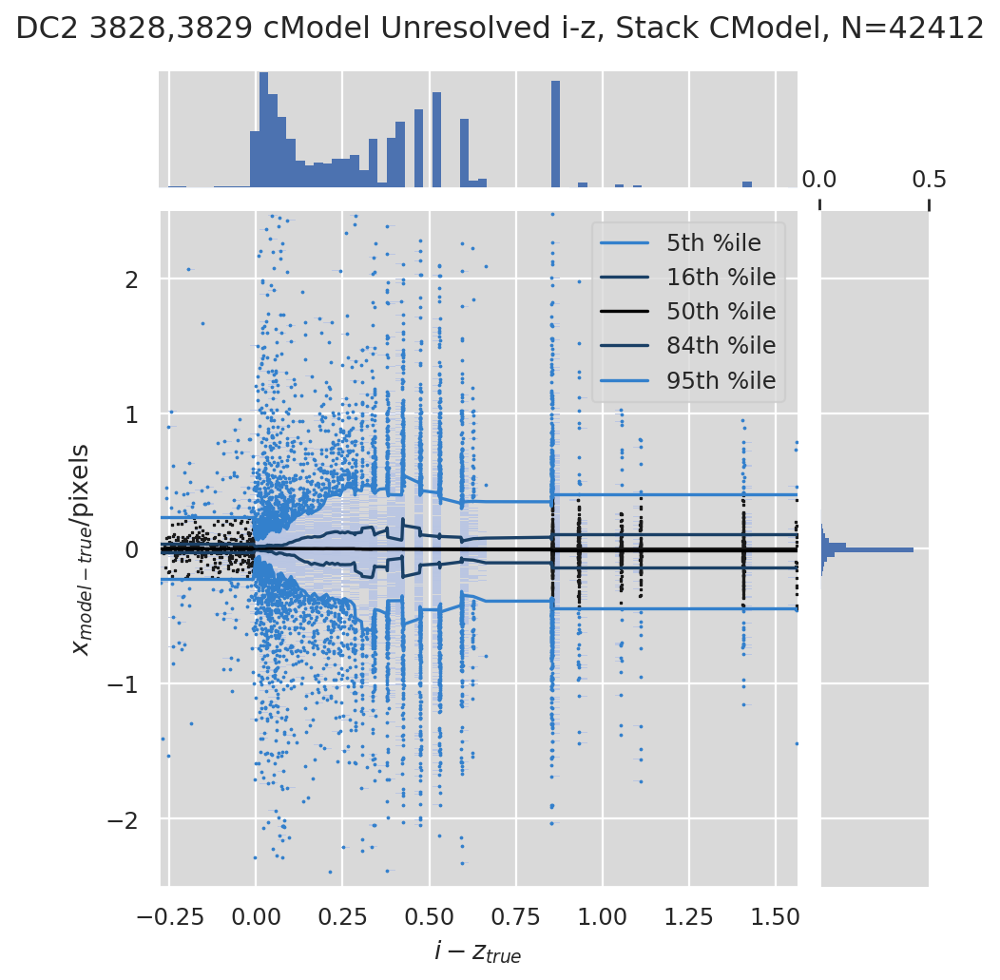

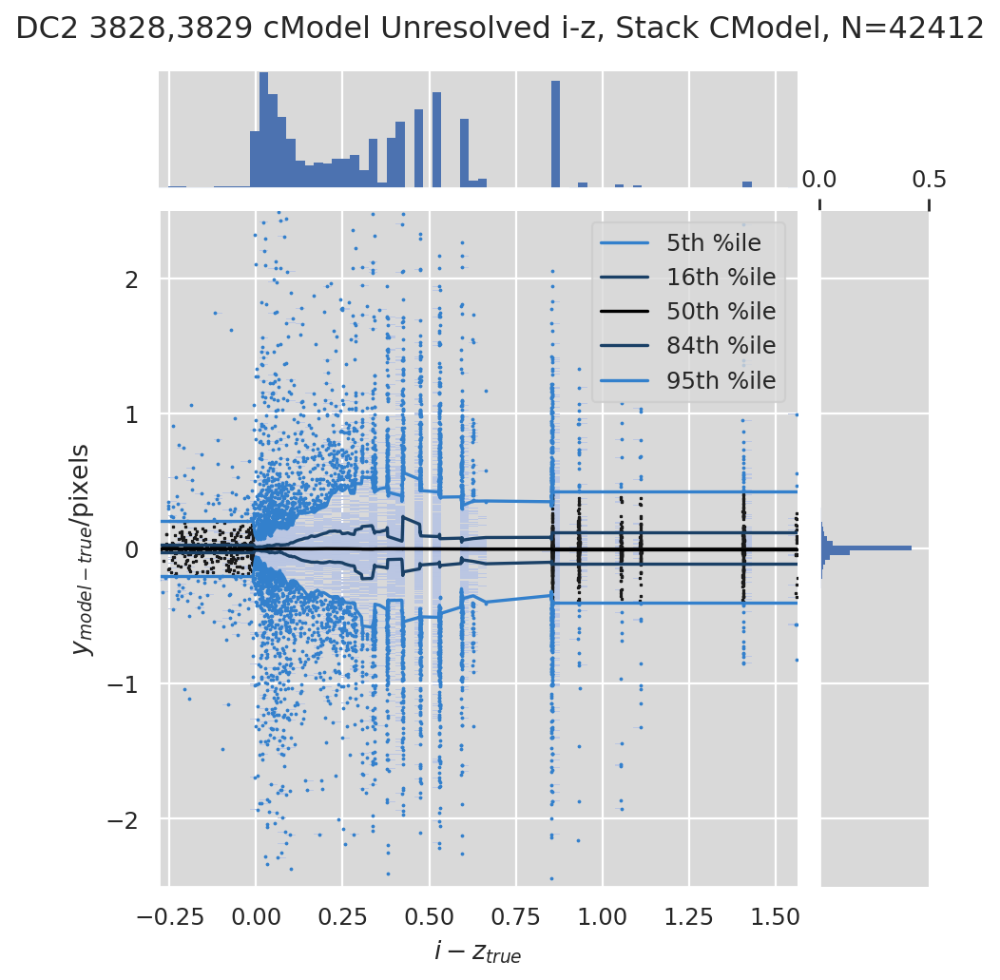

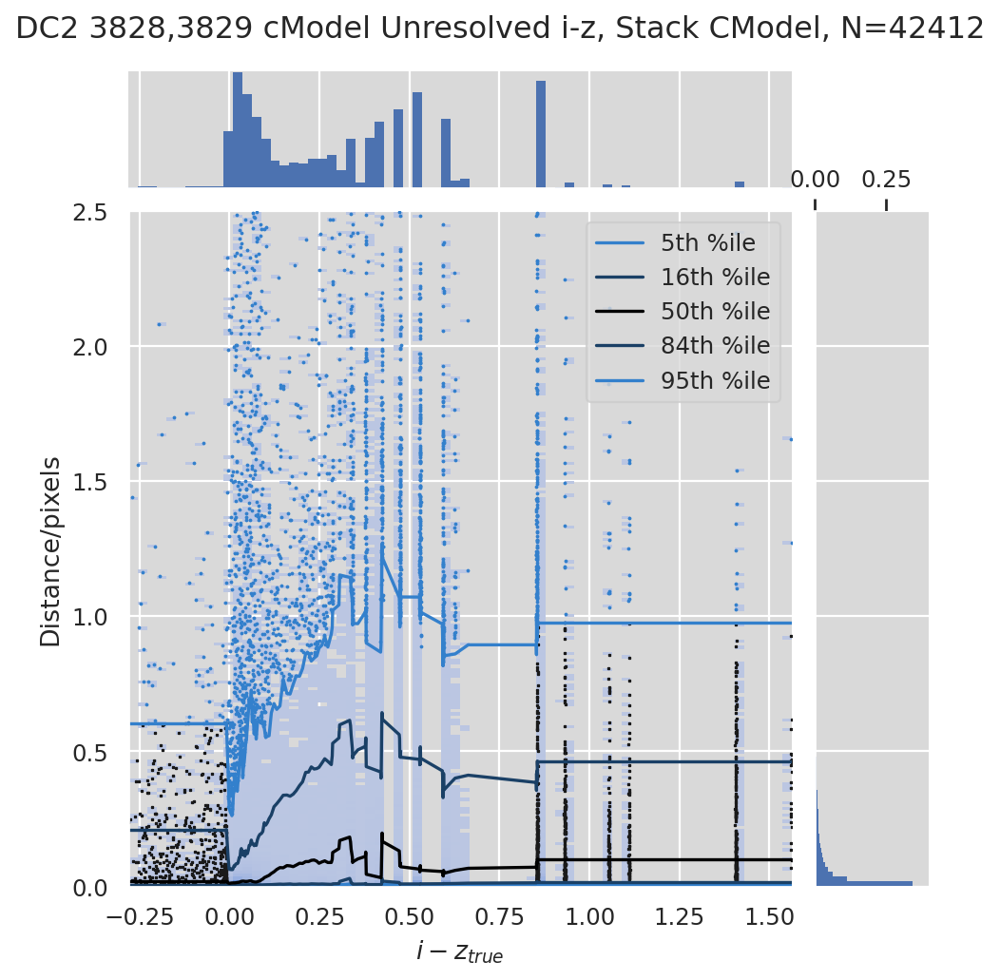

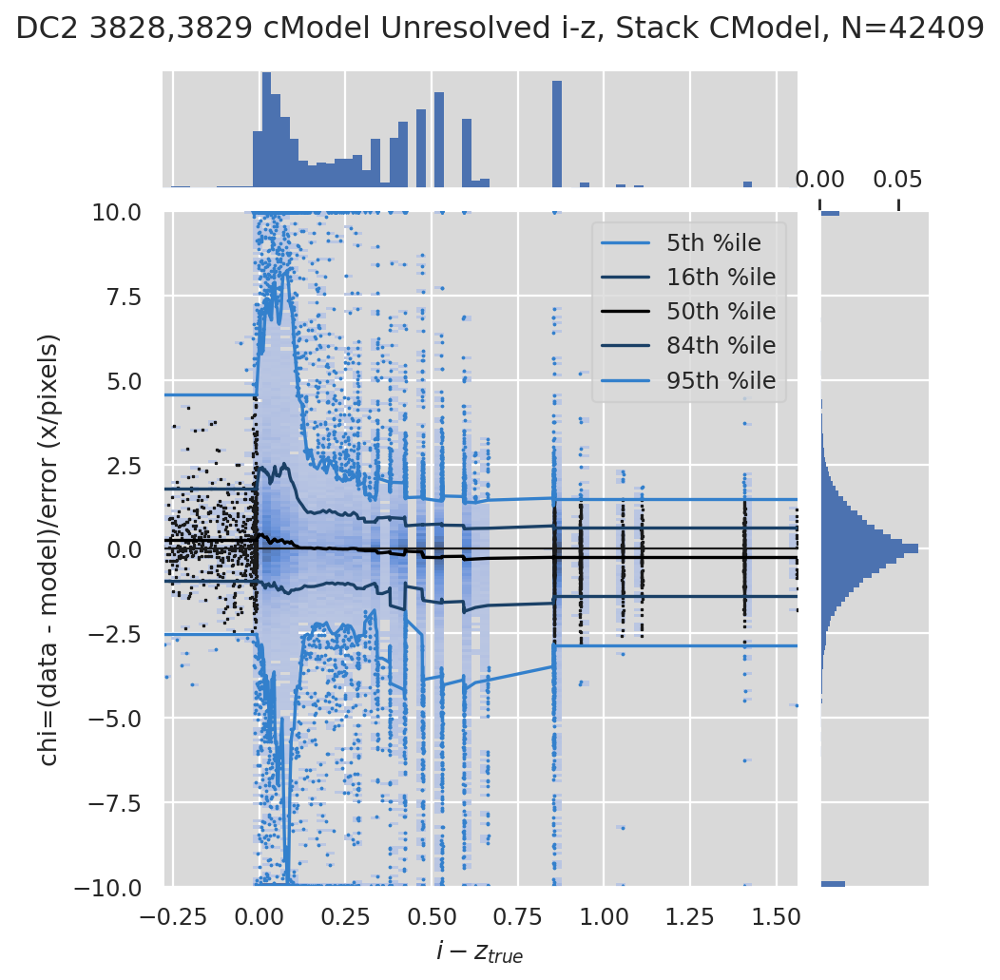

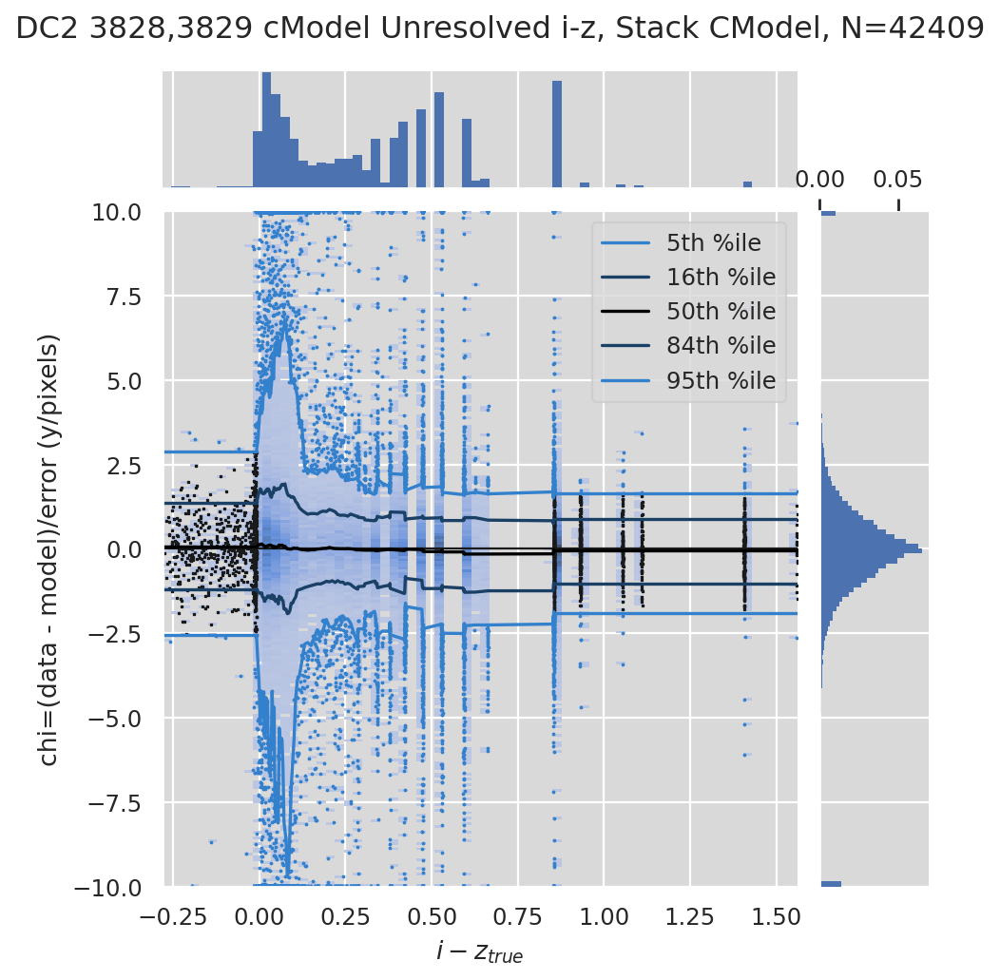

Plotting color diffs: DC2 3828,3829 cModel Unresolved z-y, Stack CModel


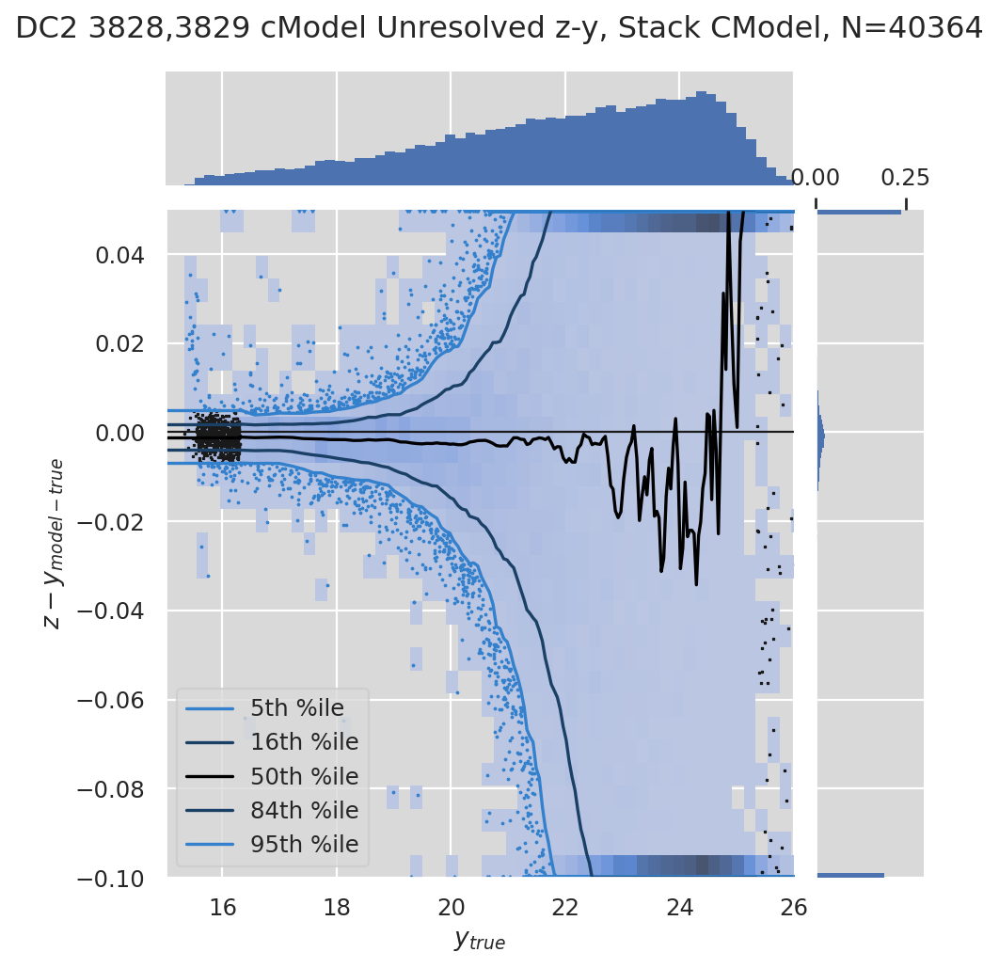

Plotting color chis: DC2 3828,3829 cModel Unresolved z-y, Stack CModel


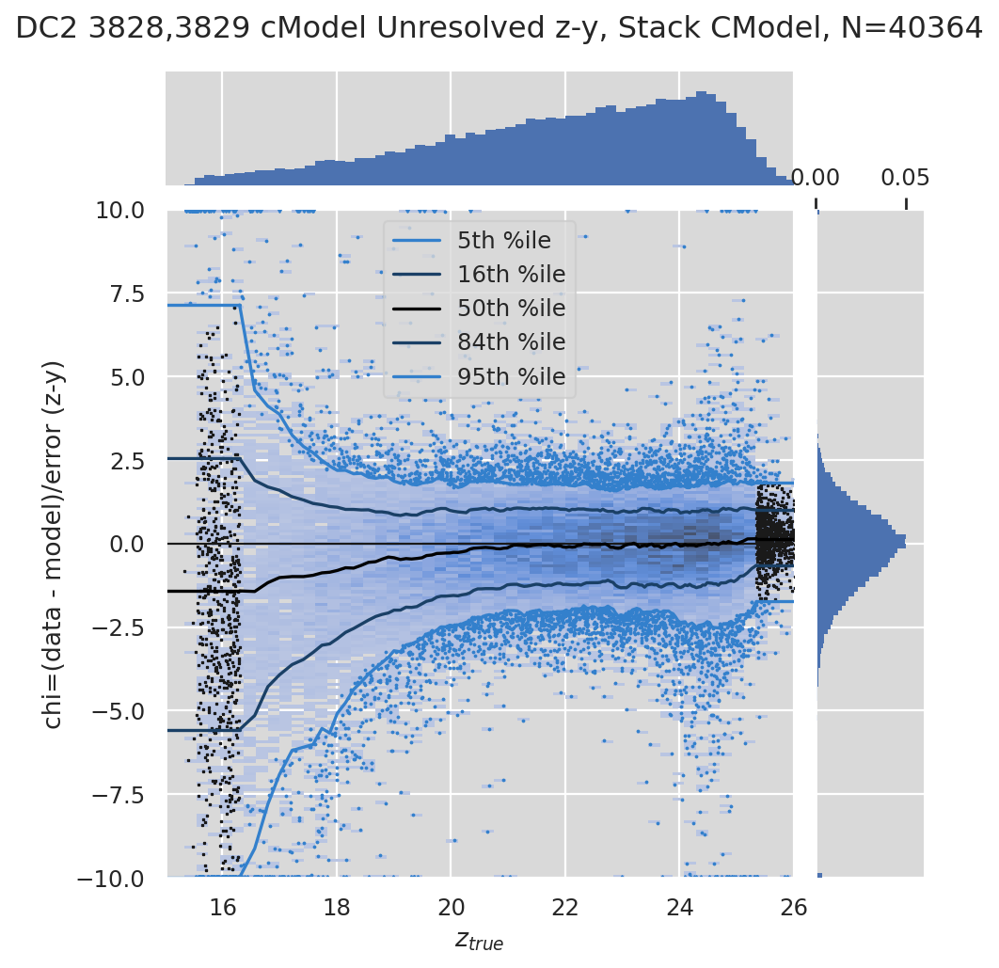

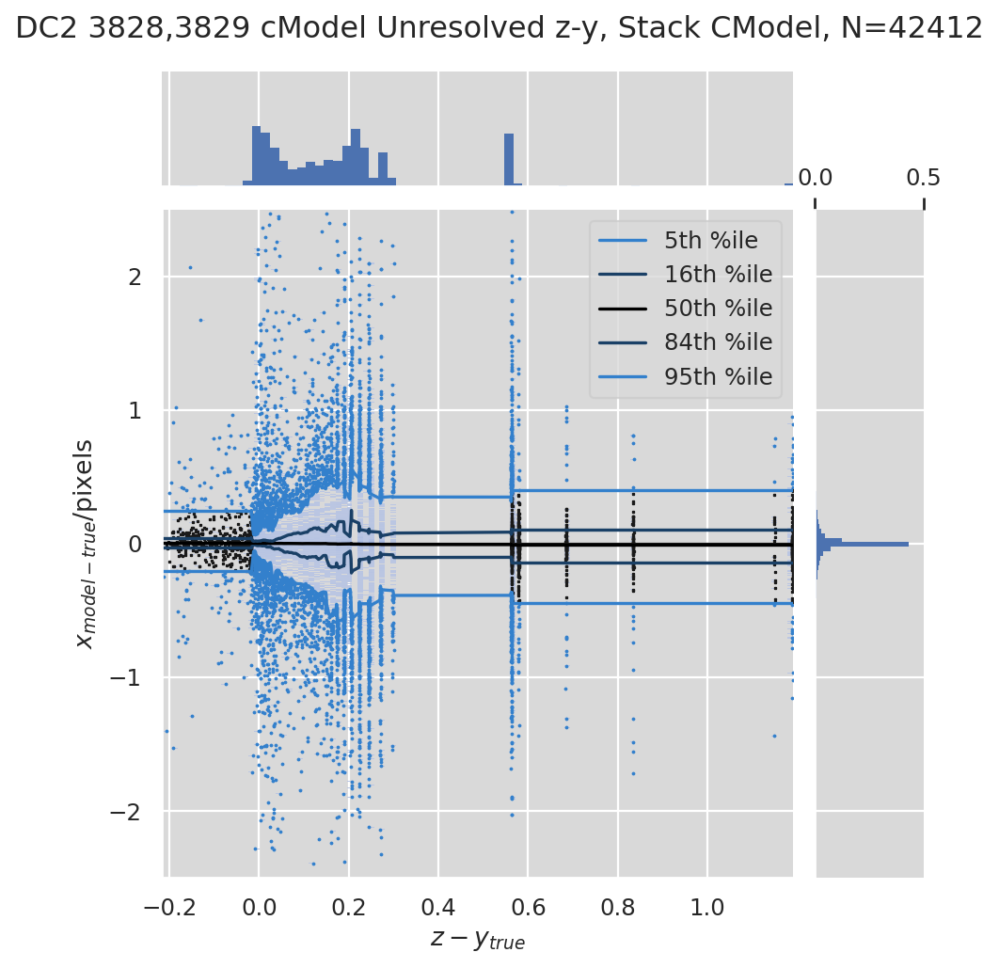

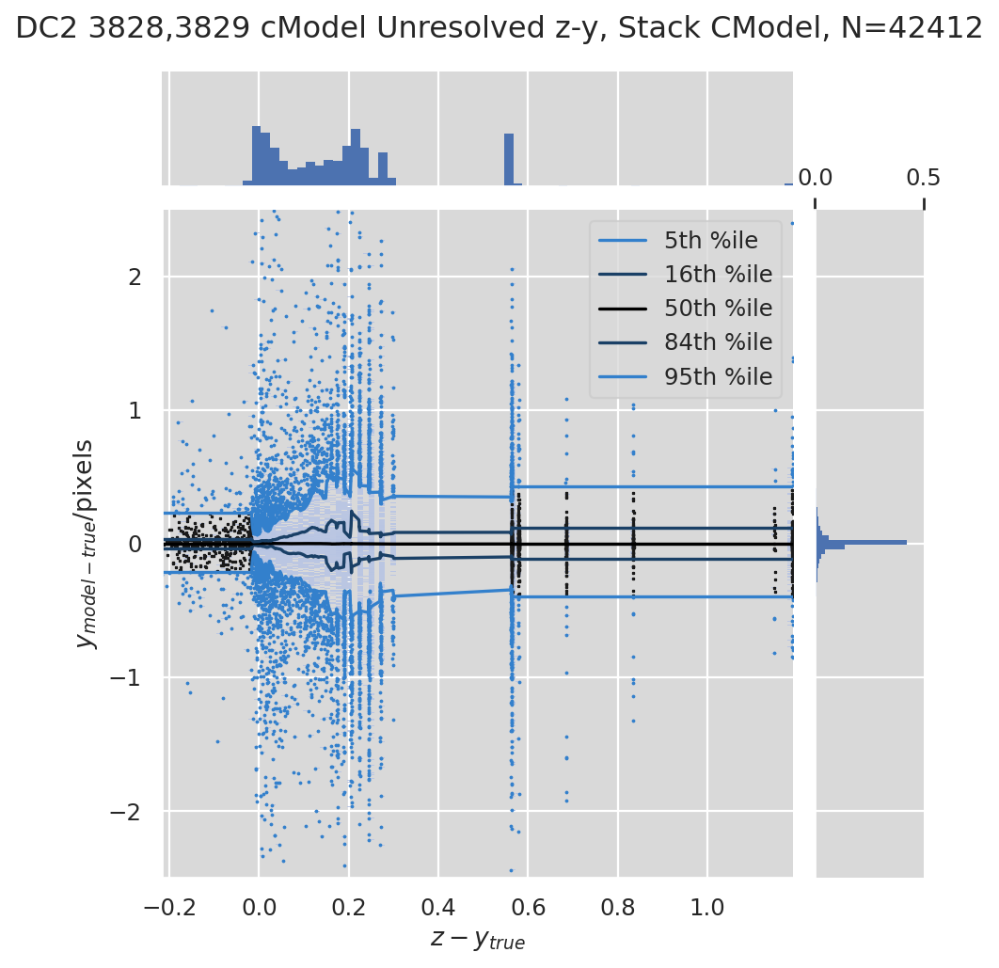

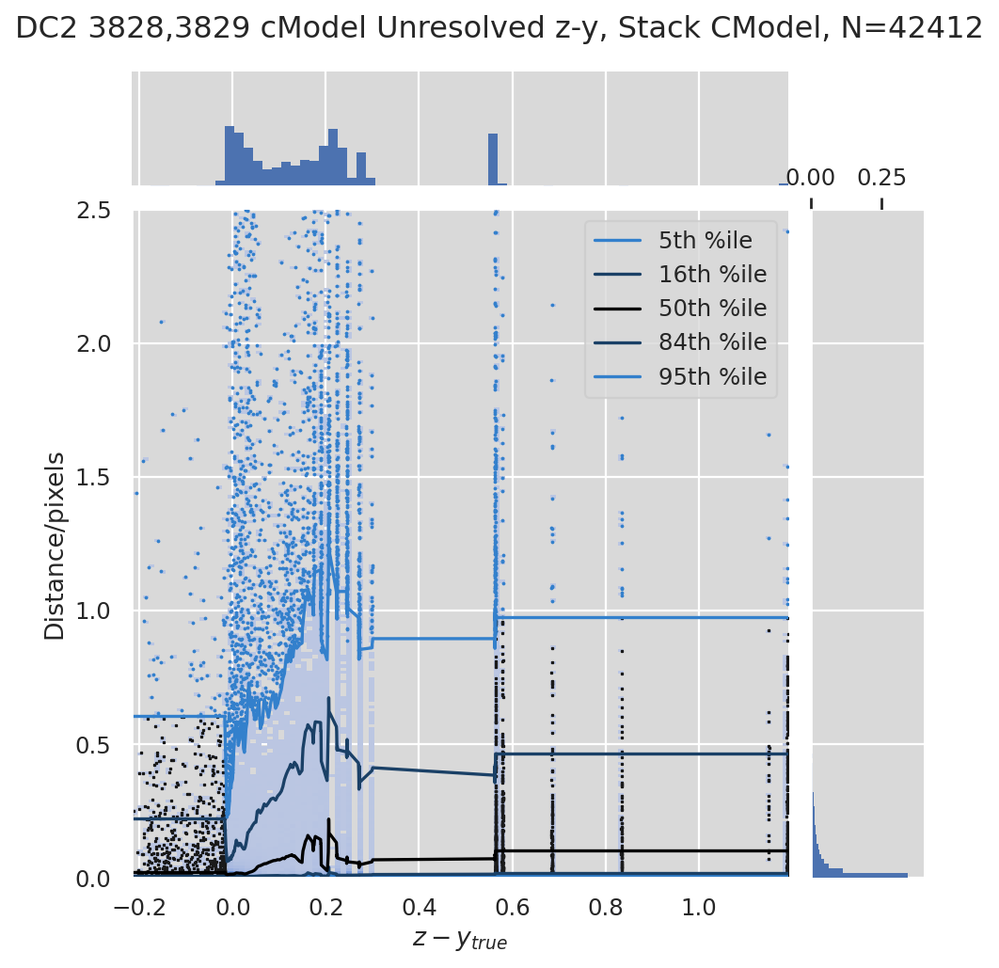

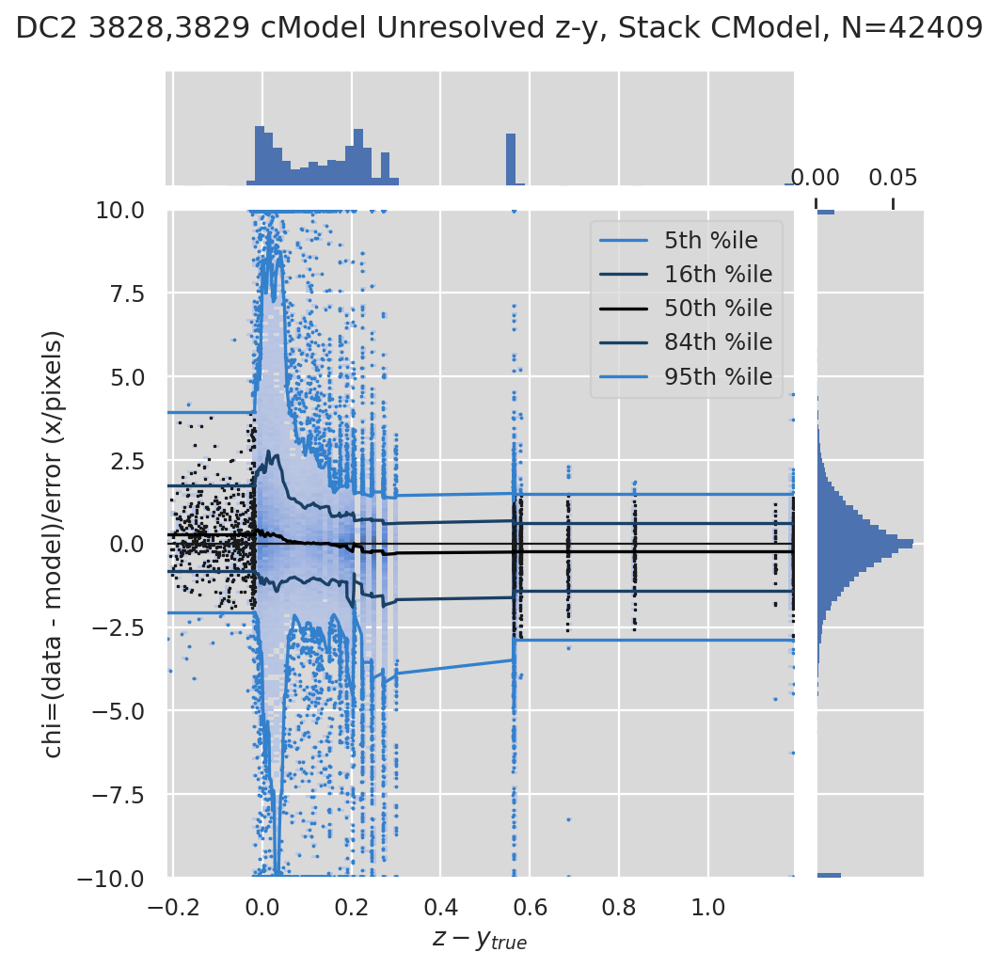

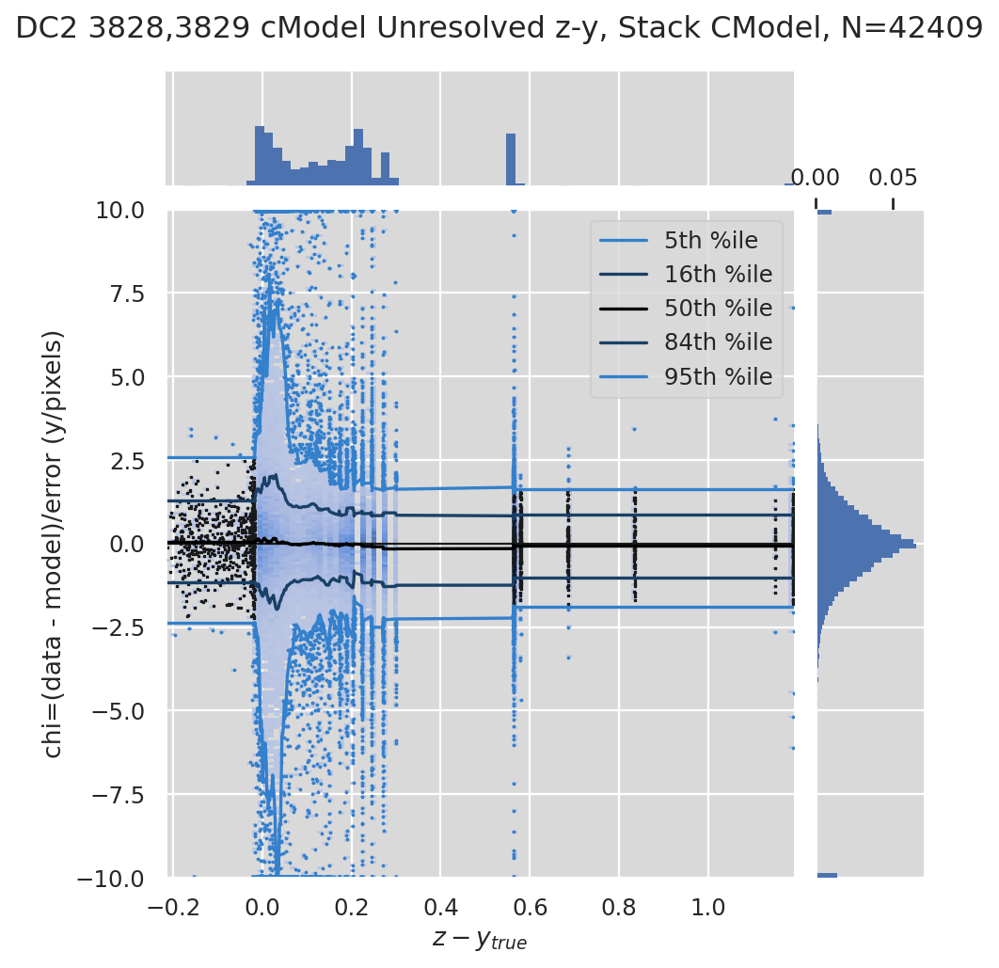

In [9]:
# Plot probable point sources
_ = plot_matches(
    cat_ref_all[select_ref],
    cat_target_all,
    resolved=False,
    plot_chi=True,
    limits_y_diff=lim_y['unresolved'],
    limits_y_color_diff=lim_y['unresolved'],
    **kwargs
)

In [10]:
# Check memory usage

# These are the usual ipython objects, including this one you are creating
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
memusg = list(sorted(
    [
        (x, sys.getsizeof(globals().get(x))) for x in dir()
        if not x.startswith('_') and x not in sys.modules and x not in ipython_vars
    ],
    key=lambda x: x[1], reverse=True
))
print(memusg)

[('cat_ref_all', 1379361873), ('cat_target_all', 681743466), ('select_ref', 9319749), ('select_target', 2913537), ('n_matched', 1104), ('n_obj', 1104), ('kwargs', 640), ('memusg', 472), ('columns_all_target', 344), ('lim_y', 232), ('models', 232), ('columns_all_ref', 184), ('get_xy', 144), ('plot_matches', 144), ('columns_data_ref', 120), ('columns_data_target', 120), ('columns_errors_target', 120), ('columns_fluxes_ref', 120), ('columns_fluxes_target', 120), ('bins', 104), ('bands', 88), ('columns_match_ref', 72), ('dafButler', 72), ('geom', 72), ('mpl', 72), ('mrMeas', 72), ('np', 72), ('pd', 72), ('plt', 72), ('sns', 72), ('column', 69), ('cats_in', 64), ('cats_out', 64), ('weekly', 58), ('ticket', 57), ('match_dist_max', 56), ('tracts', 56), ('model_target', 55), ('name_bands', 55), ('name_skymap', 52), ('band_ref', 50), ('butler', 48), ('skymap', 48), ('idx', 28), ('mag_plot_min', 28), ('match_max', 28), ('n_bins', 28), ('n_finite_min', 28), ('n_matched_uniq', 28), ('n_target', 28